In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import xgboost as xgb
from xgboost import XGBClassifier, XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import tqdm
import seaborn as sn
import umap
from sklearn.decomposition import PCA
from sklearn import datasets
from sklearn.decomposition import PCA
import umap
import matplotlib.pyplot as plt
import shap
from sklearn.preprocessing import StandardScaler
from anndata import AnnData
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
import shap
from sklearn.preprocessing import MinMaxScaler
import scipy.stats as stats
import scanpy as sc
import scipy

/Users/lim/opt/anaconda3/envs/bruce/lib/python3.8/site-packages/xgboost/compat.py:31: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


### https://satijalab.org/seurat/archive/v3.0/immune_alignment.html
### https://www.nature.com/articles/nbt.4096


In [2]:
meta = pd.read_csv('Stim_Unstim/meta_data_seruat.csv')

In [3]:
meta

,Unnamed: 0,orig.ident,nCount_RNA,nFeature_RNA,stim,integrated_snn_res.0.5,seurat_clusters
0,AAACATACATTTCC.1,IMMUNE_CTRL,3017,877,CTRL,0,0
1,AAACATACCAGAAA.1,IMMUNE_CTRL,2481,713,CTRL,0,0
2,AAACATACCTCGCT.1,IMMUNE_CTRL,3420,850,CTRL,0,0
3,AAACATACCTGGTA.1,IMMUNE_CTRL,3156,1109,CTRL,11,11
4,AAACATACGATGAA.1,IMMUNE_CTRL,1868,634,CTRL,2,2
...,...,...,...,...,...,...,...
13994,TTTGCATGAACGAA.1,IMMUNE_STIM,5577,1237,STIM,8,8
13995,TTTGCATGACGTAC.1,IMMUNE_STIM,1364,536,STIM,2,2
13996,TTTGCATGCCTGTC.1,IMMUNE_STIM,2114,817,STIM,4,4
13997,TTTGCATGCTAAGC.1,IMMUNE_STIM,1522,523,STIM,1,1


In [4]:
control = pd.read_csv('Stim_unstim/immune_control.txt',delimiter='\t')
stimulated = pd.read_csv('Stim_unstim/immune_control.txt',delimiter='\t')

In [5]:
meta['Unnamed: 0'] = meta['Unnamed: 0'].str[:14]
control.columns = pd.Series(control.columns).str[:14]
stimulated.columns = pd.Series(stimulated.columns).str[:14]

In [6]:
control_cells = np.intersect1d(np.array(meta[meta['orig.ident'] == 'IMMUNE_CTRL']['Unnamed: 0']),np.array(control.columns))
control_df = control[control_cells]
stim_cells = np.intersect1d(np.array(meta[meta['orig.ident'] == 'IMMUNE_CTRL']['Unnamed: 0']),np.array(stimulated.columns))
stimulated_df = stimulated[stim_cells]
print(control_df.shape,stimulated_df.shape)

(35635, 6548) (35635, 6548)


In [7]:
control_labels = np.array(meta[meta['orig.ident'] == 'IMMUNE_CTRL']['seurat_clusters'])
stimulated_labels = np.array(meta[meta['orig.ident'] == 'IMMUNE_CTRL']['seurat_clusters'])
print(control_labels.shape,stimulated_labels.shape)

(6548,) (6548,)


In [8]:
adata_ctrl = sc.AnnData(control_df.T)
adata_stim = sc.AnnData(stimulated_df.T)

### Preprocessing 

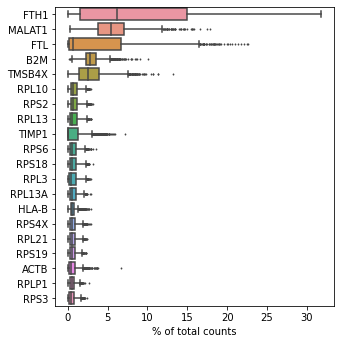

In [9]:
sc.pl.highest_expr_genes(adata_ctrl, n_top=20, )

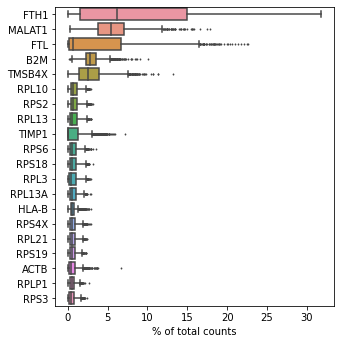

In [10]:
sc.pl.highest_expr_genes(adata_stim, n_top=20, )

In [11]:
sc.pp.filter_cells(adata_ctrl, min_genes=200)
sc.pp.filter_genes(adata_ctrl, min_cells=3)

is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.
is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


In [12]:
sc.pp.filter_cells(adata_stim, min_genes=200)
sc.pp.filter_genes(adata_stim, min_cells=3)

is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.
is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


In [13]:
adata_ctrl.var['mt'] = adata_ctrl.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_ctrl, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [14]:
adata_stim.var['mt'] = adata_stim.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata_stim, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.


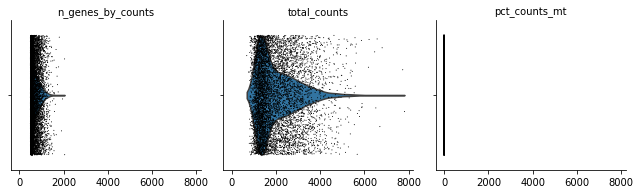

In [15]:
sc.pl.violin(adata_ctrl, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.


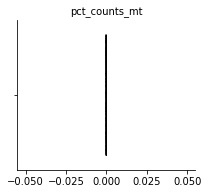

In [16]:
sc.pl.violin(adata_ctrl, ['pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.


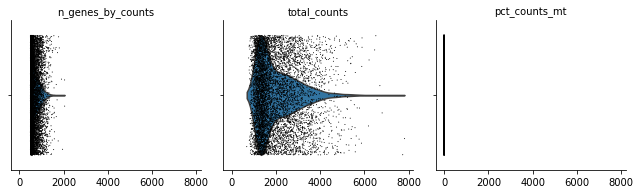

In [17]:
sc.pl.violin(adata_stim, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

Vertical orientation ignored with only `x` specified.
Vertical orientation ignored with only `x` specified.


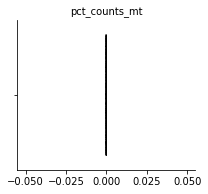

In [18]:
sc.pl.violin(adata_stim, ['pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [19]:
sc.pp.normalize_total(adata_ctrl, target_sum=1e4)
sc.pp.log1p(adata_ctrl)
sc.pp.highly_variable_genes(adata_ctrl, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pp.normalize_total(adata_stim, target_sum=1e4)
sc.pp.log1p(adata_stim)
sc.pp.highly_variable_genes(adata_stim, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [20]:
print('Number of HVG in control : {}'.format(np.sum(adata_ctrl.var.highly_variable)))

Number of HVG in control : 2093


In [21]:
print('Number of HVG in control : {}'.format(np.sum(adata_stim.var.highly_variable)))

Number of HVG in control : 2093


In [22]:
tmp = len(np.intersect1d(adata_ctrl.var.index[adata_ctrl.var.highly_variable],adata_stim.var.index[adata_stim.var.highly_variable]))
print('Number of intersection HVG  : {}'.format(tmp))

Number of intersection HVG  : 2093


In [23]:
union_hvg = np.union1d(adata_ctrl.var.index[adata_ctrl.var.highly_variable],adata_stim.var.index[adata_stim.var.highly_variable])

In [24]:
print('Number of union HVG  : {}'.format(len(union_hvg)))

Number of union HVG  : 2093


In [25]:
a,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
b,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)

union_hvg = np.intersect1d(a,b)
_,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
_,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)
adata_hvg_ctrl = adata_ctrl[:, idx_ctrl]
adata_hvg_stim = adata_stim[:, idx_stim]
print(adata_hvg_ctrl.shape,adata_hvg_stim.shape)

is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093)


In [26]:
union_hvg

array(['AARSD1', 'ABCA5', 'ABCB1', ..., 'ZSCAN18', 'ZWILCH', 'ZWINT'],
      dtype=object)

In [27]:
a

array(['AARSD1', 'ABCA5', 'ABCB1', ..., 'ZSCAN18', 'ZWILCH', 'ZWINT'],
      dtype=object)

In [28]:
a = adata_hvg_stim.X.flatten()
med = np.median(np.array(a)[np.array([i for i,v in enumerate(a) if v > 0])])
med

2.0610242

In [29]:
def eval_score_sq(vector1,vector2):
    w = ((vector1 + vector2)**2)/np.sum((vector1 + vector2)**2)
    diff = np.abs(vector1 - vector2)
    prod = w*diff
    score = np.around(np.sum(prod),2)
    return score

def eval_score_sum(vector1,vector2):
    diff = np.abs(vector1 - vector2)
    score = np.around(np.sum(diff),3)
    return score

def eval_score_v2(shap1,shap2):
    size1 = len(shap1)
    size2 = len(shap2)
    scores = []
    for i in range(1000):
        rand1=np.random.randint(size1)
        rand2=np.random.randint(size2)
        vector1=shap1[rand1,:]
        vector2=shap2[rand2,:]
        
        w = ((vector1 + vector2)**2)/np.sum((vector1 + vector2)**2)
        diff = np.abs(vector1 - vector2)
        prod = w*diff
        score = np.around(np.sum(prod),2)
        scores.append(score)
    avg_score = np.around(np.mean(scores),2)
    return avg_score

In [30]:
# Simulation

In [31]:
np.random.normal(0, 0)

0.0

In [33]:
non_hvg_idx = []
list_genes = list(adata_ctrl.var.index)
for i in np.setxor1d(adata_ctrl.var.index,union_hvg):
    idx = np.where(np.array(list_genes) == i)[0][0]
    non_hvg_idx.append(idx)

In [34]:
ordered_genes = list(union_hvg) + list(np.setxor1d(adata_ctrl.var.index,union_hvg))

is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


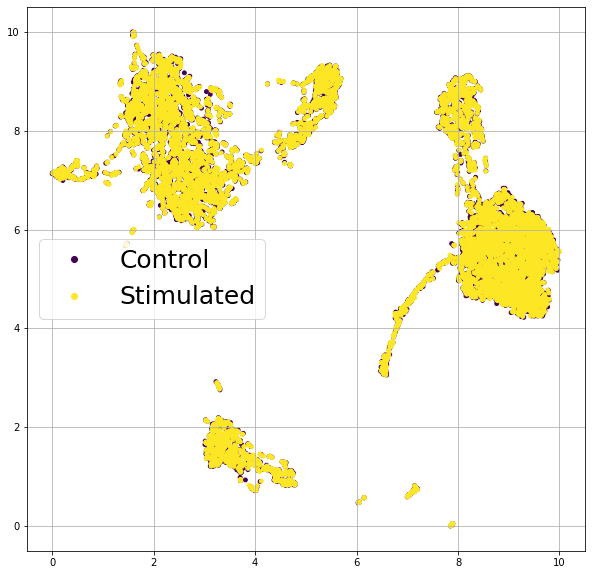

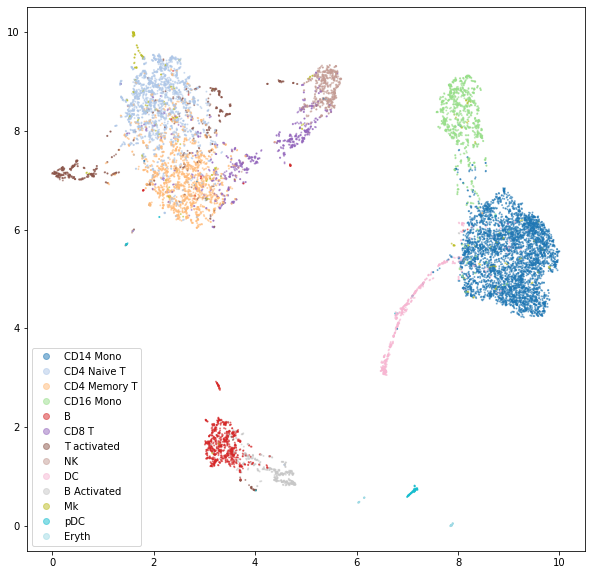

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13016/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


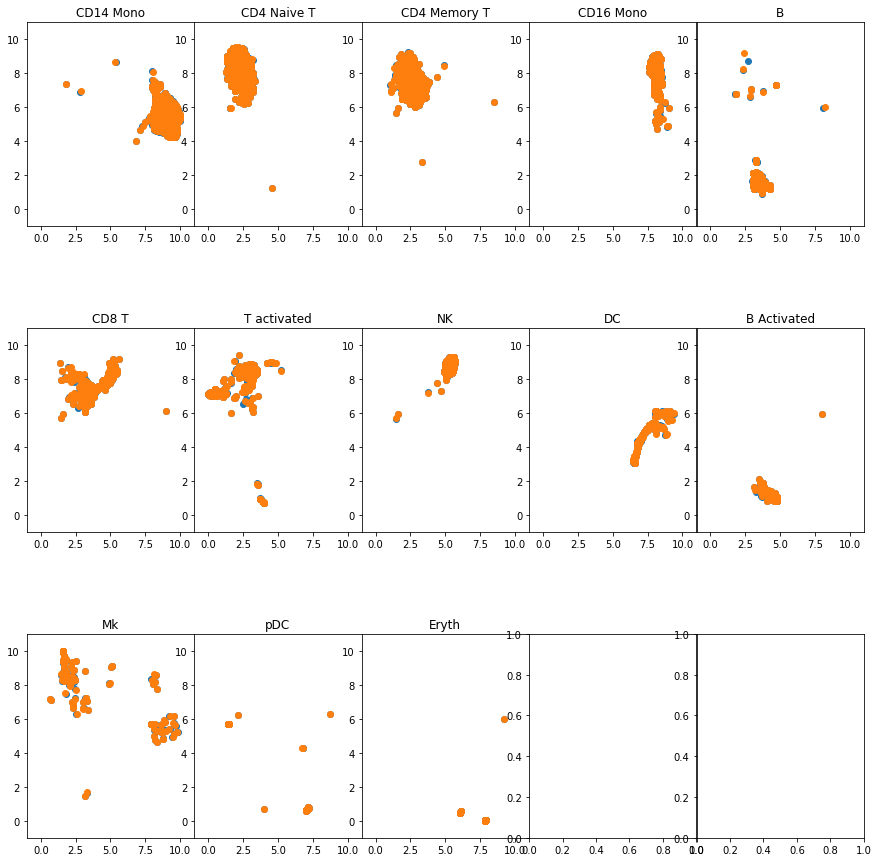

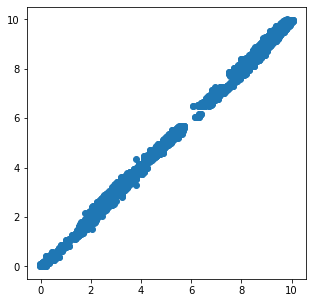

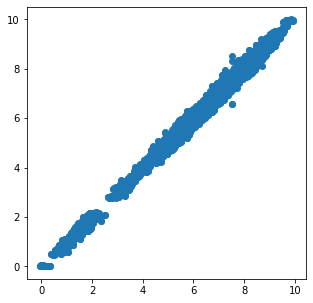

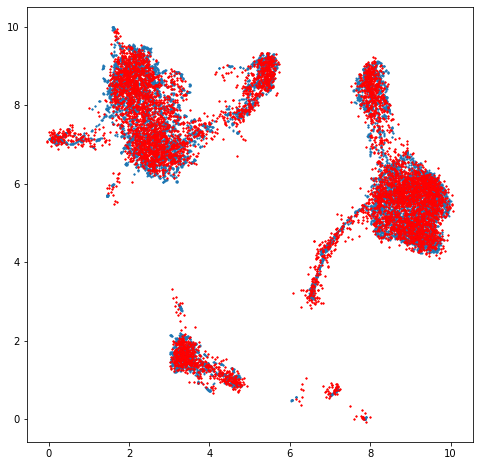

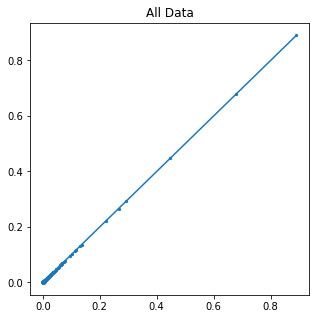

...

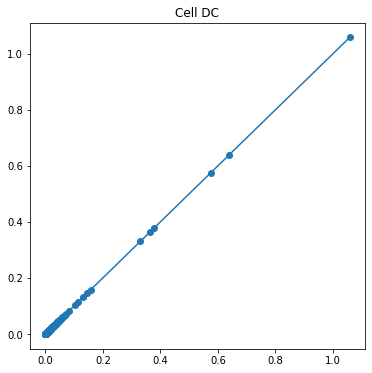

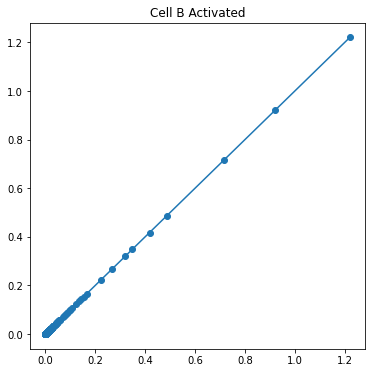

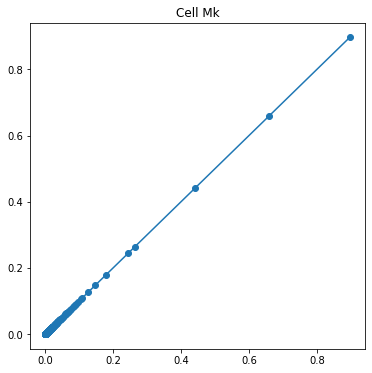

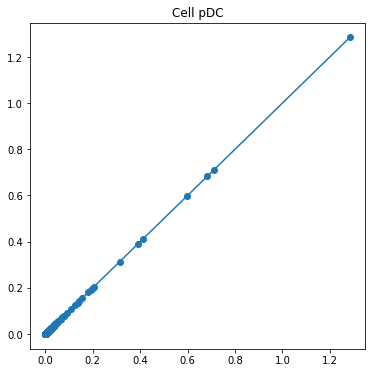

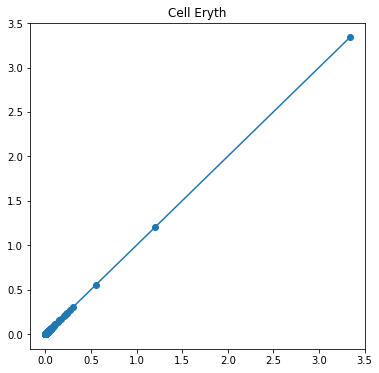

-------------------------------------------------------------------
5


Transforming to str index.


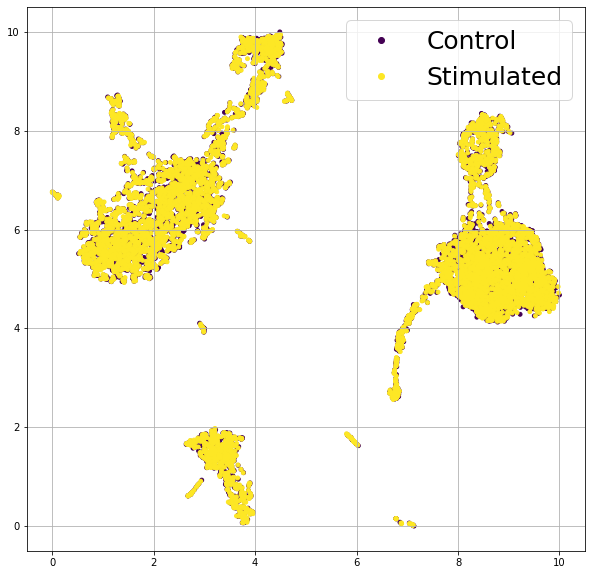

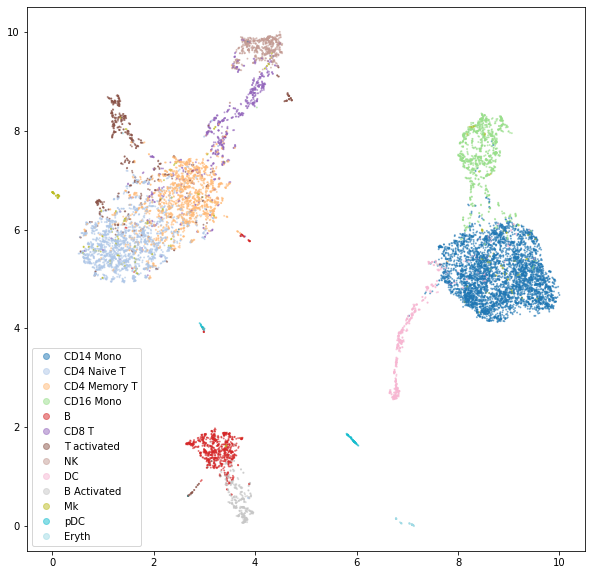

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13077/13096 [02:10<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


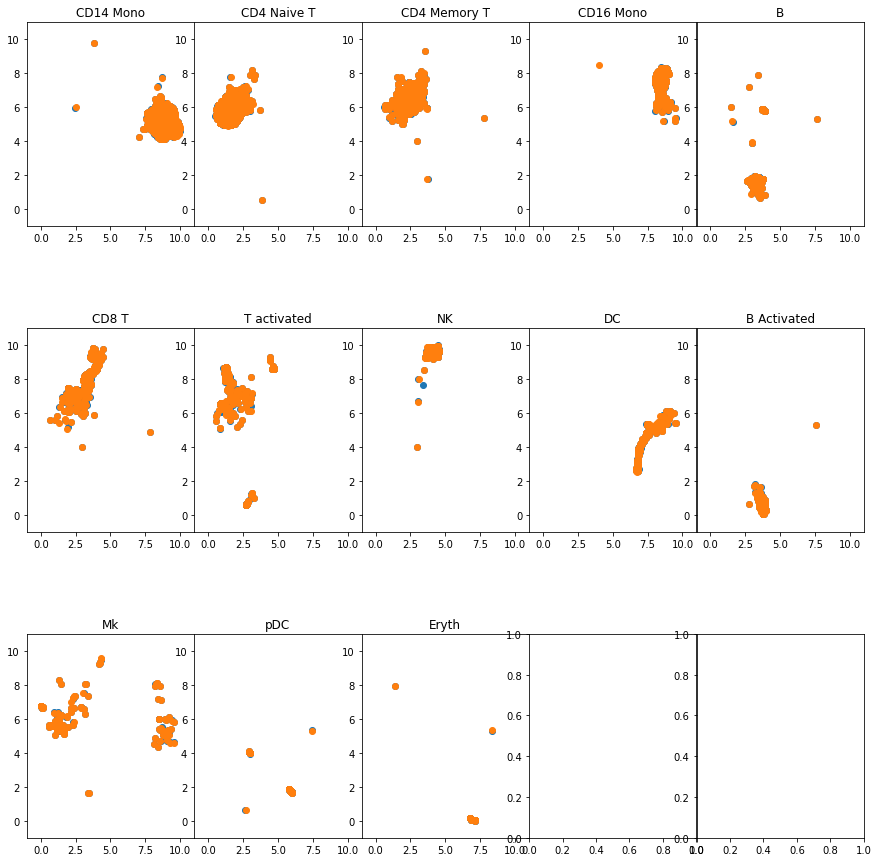

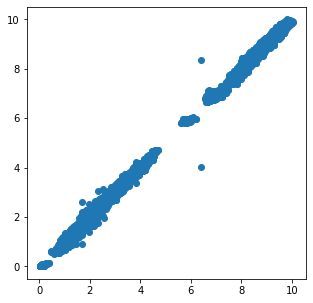

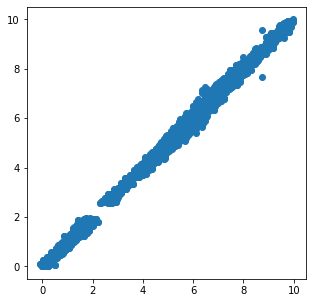

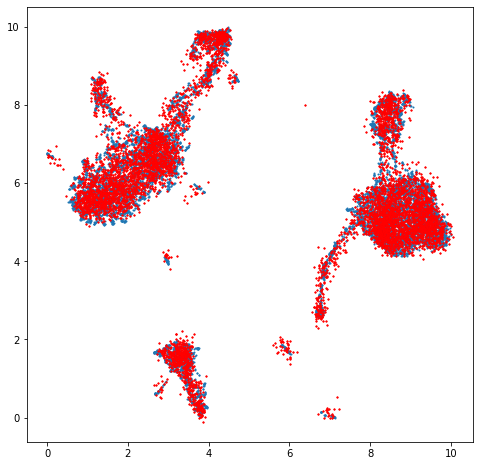

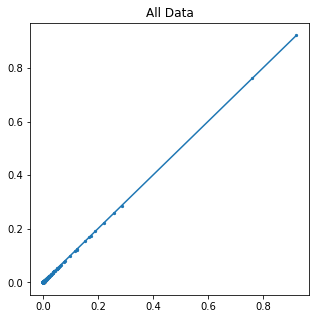

...

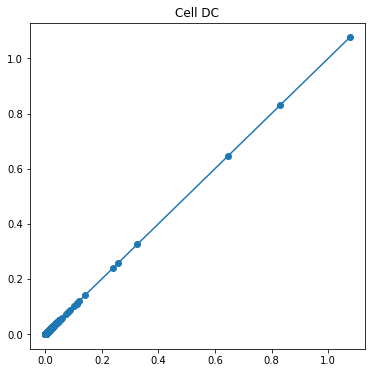

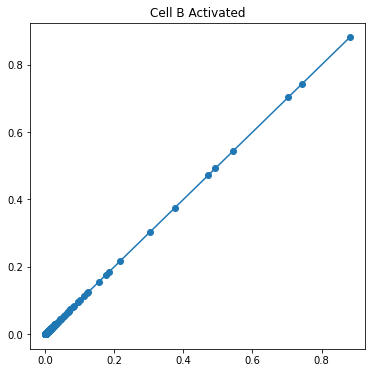

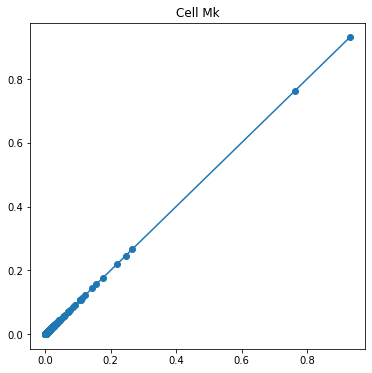

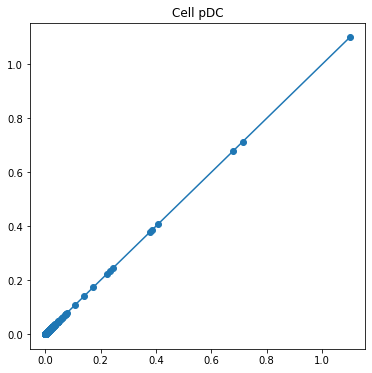

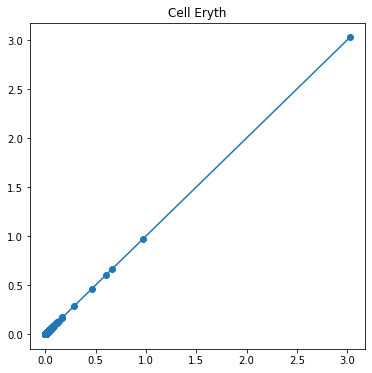

-------------------------------------------------------------------
10


Transforming to str index.


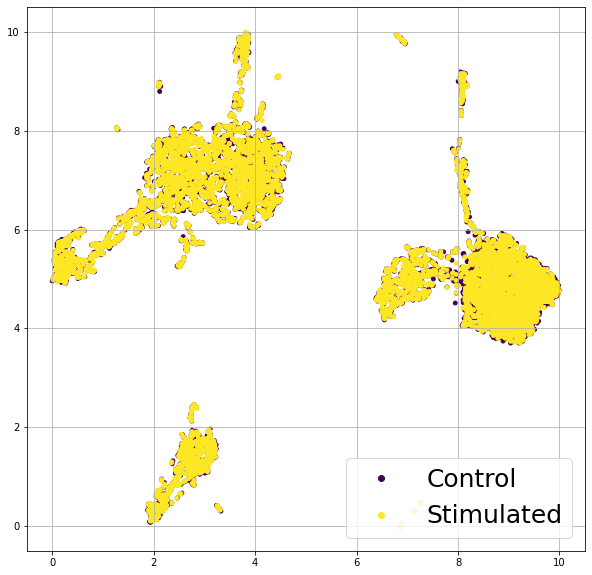

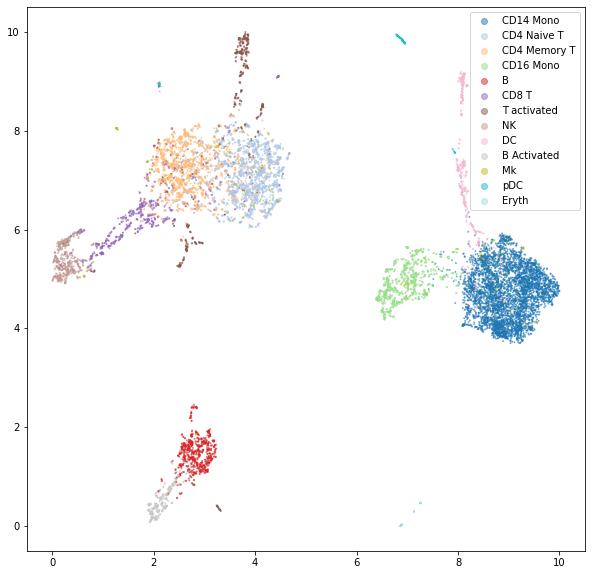

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13023/13096 [02:08<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


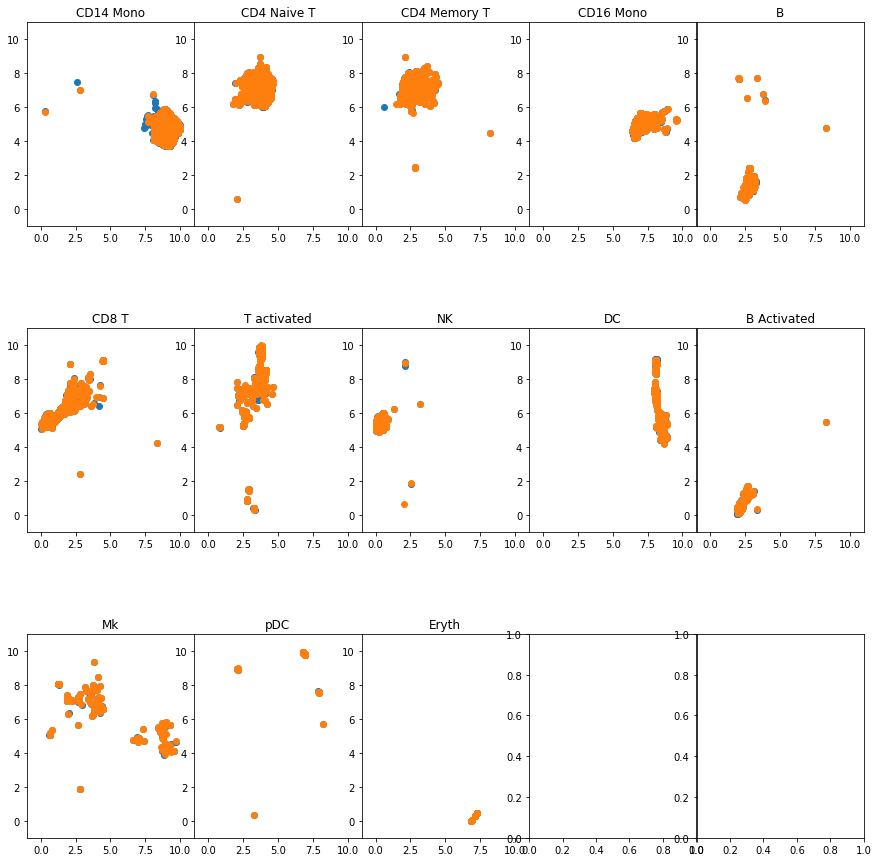

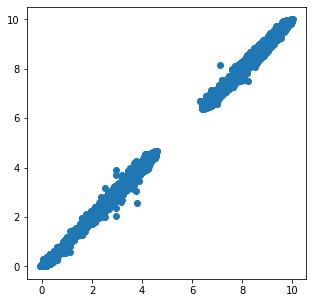

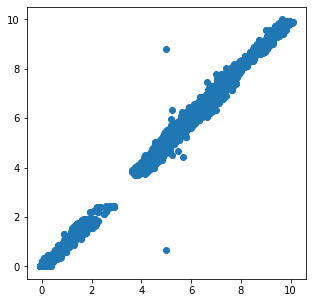

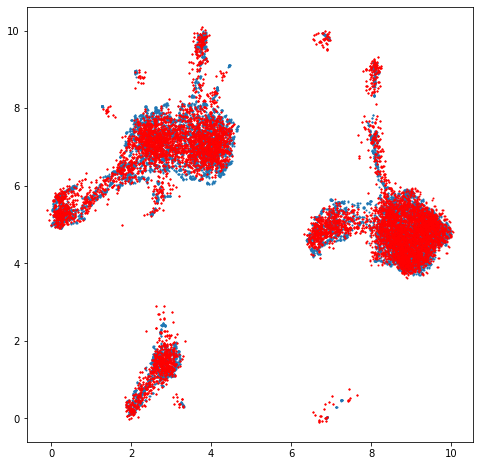

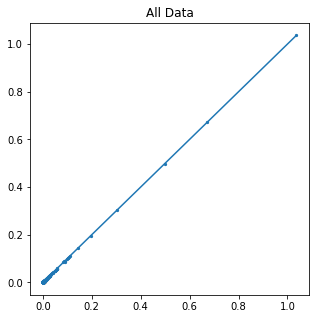

...

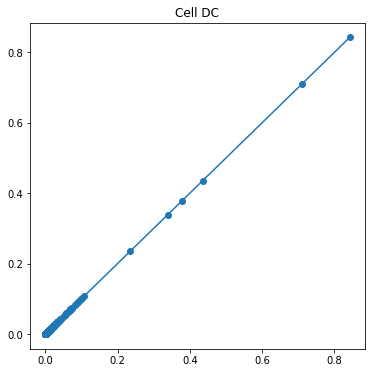

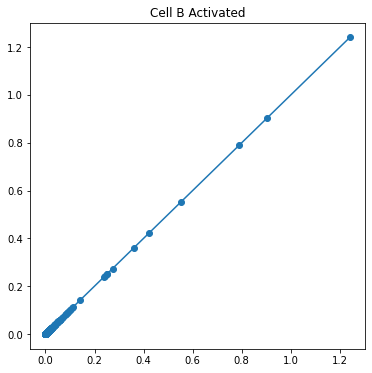

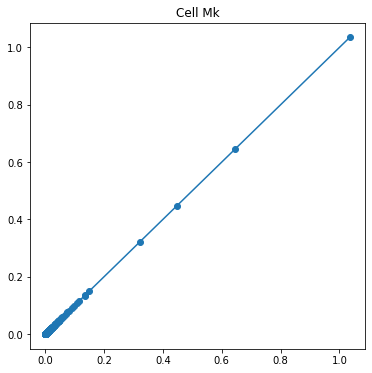

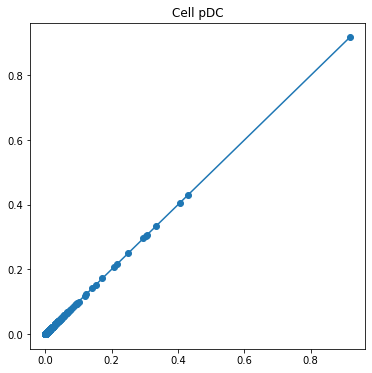

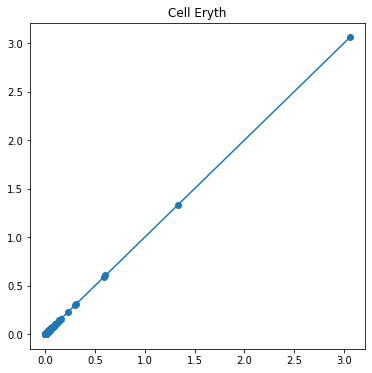

-------------------------------------------------------------------
15


Transforming to str index.


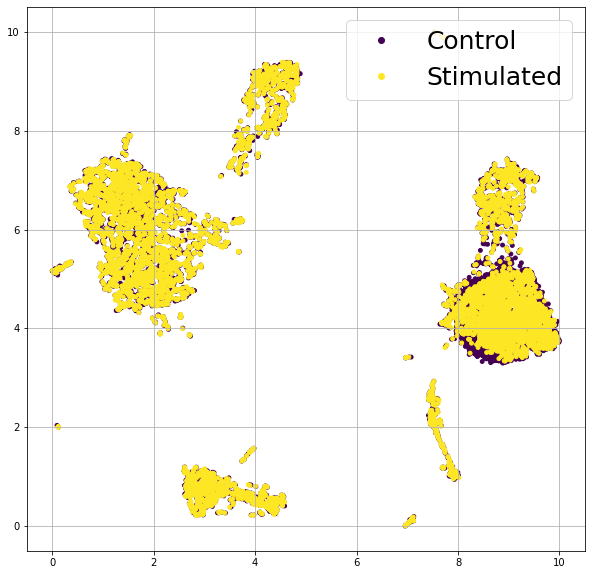

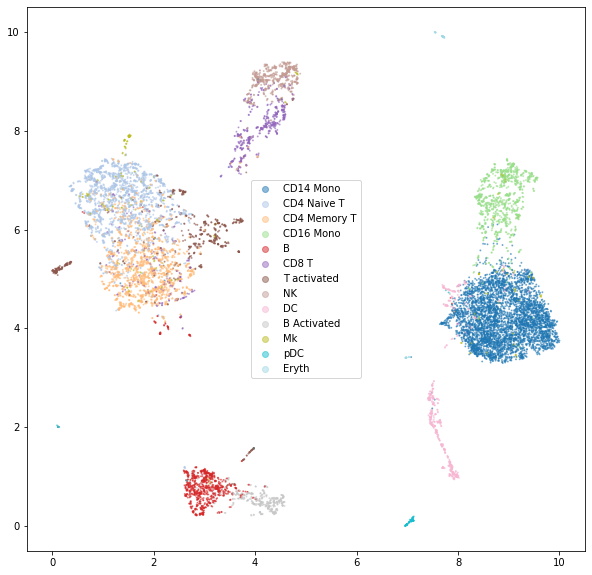

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13030/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


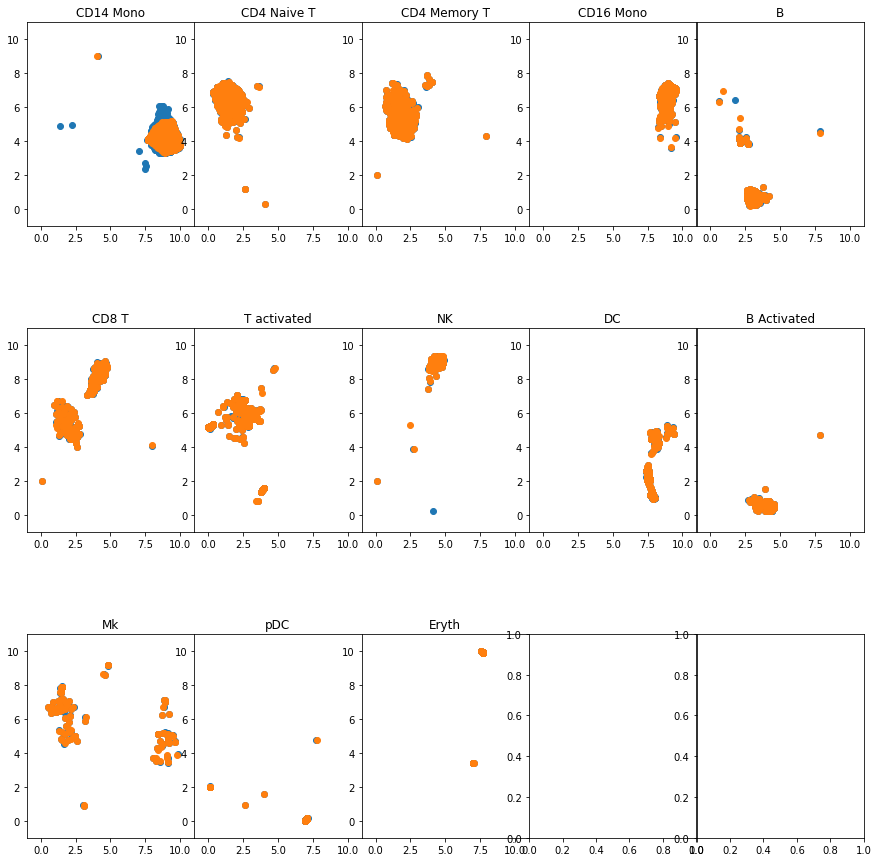

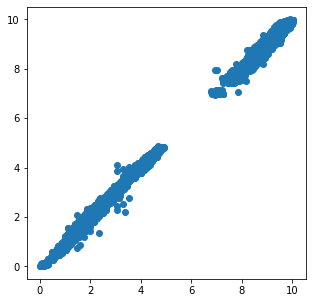

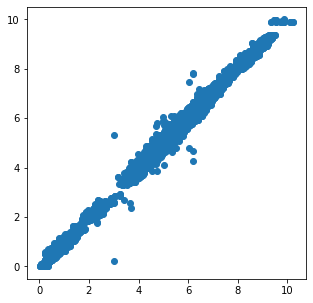

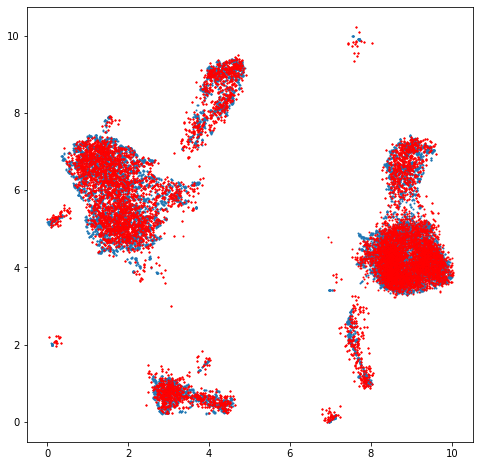

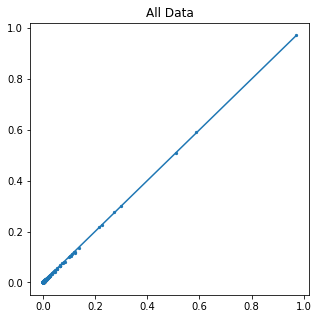

...

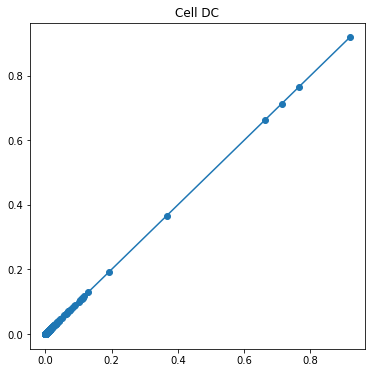

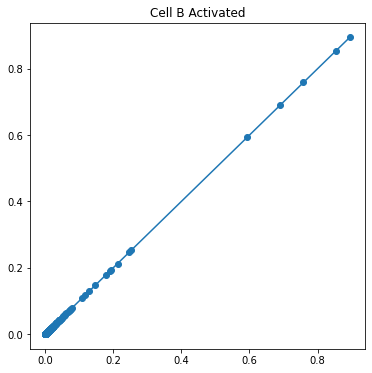

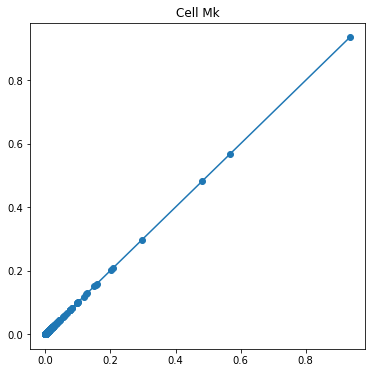

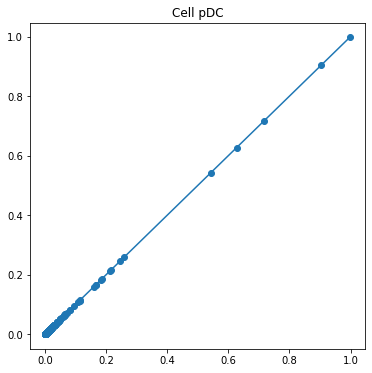

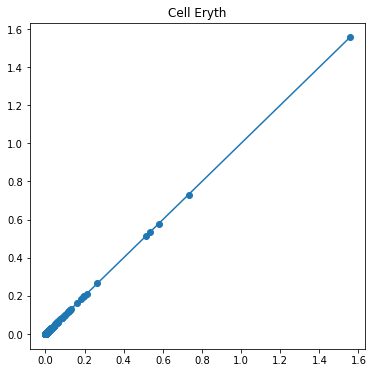

-------------------------------------------------------------------
20


Transforming to str index.


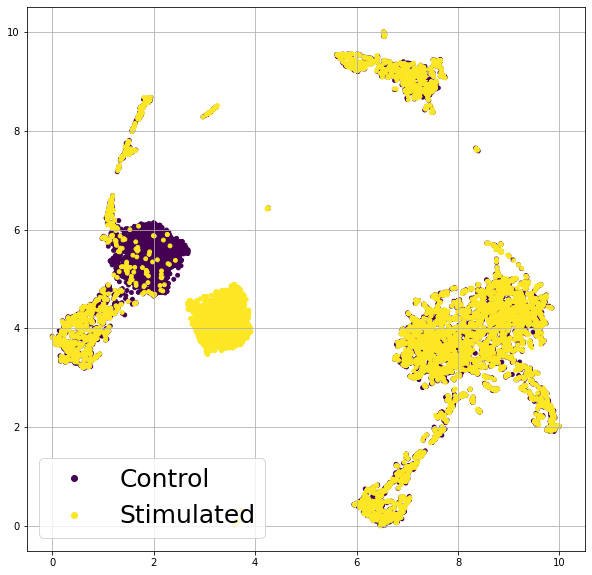

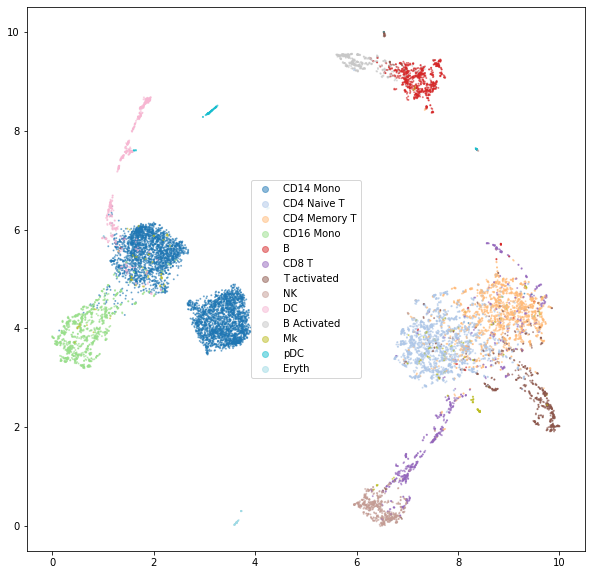

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13032/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


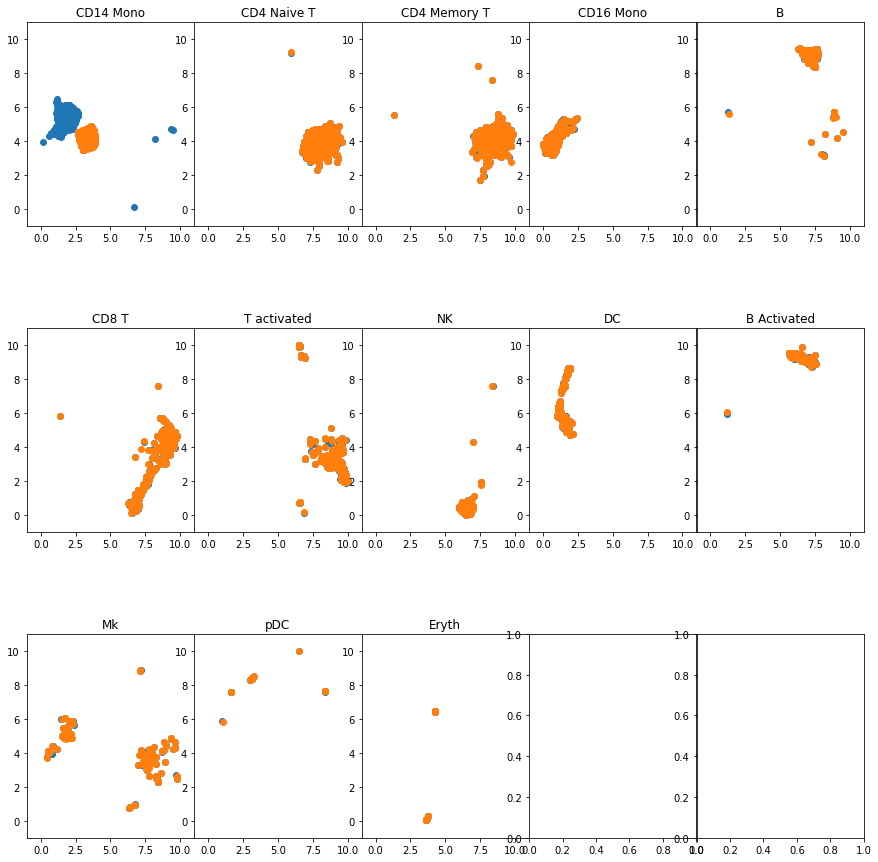

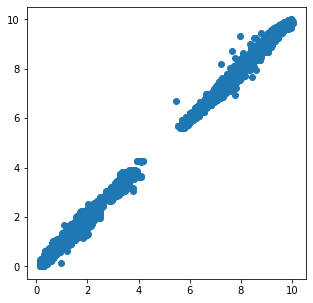

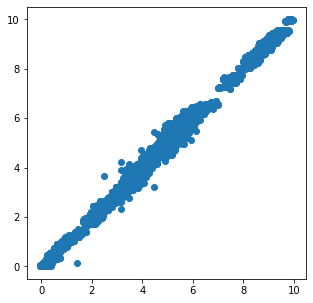

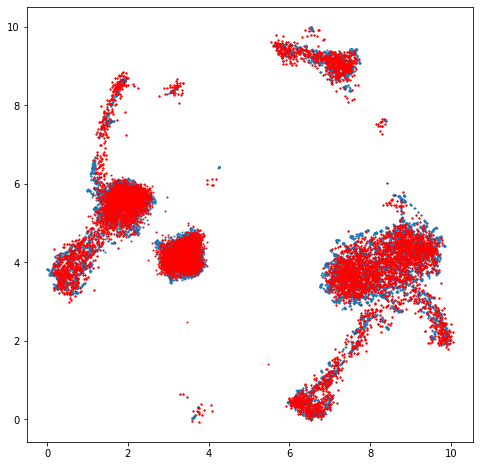

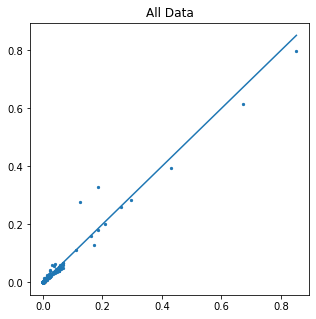

...

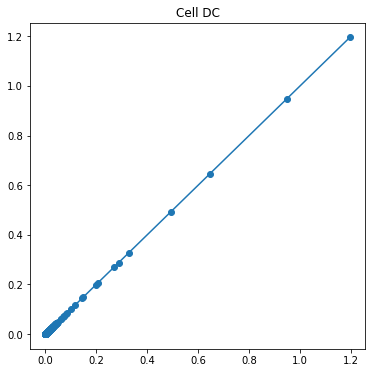

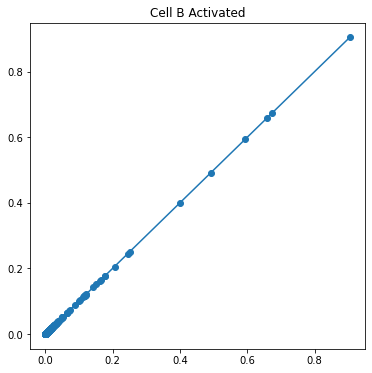

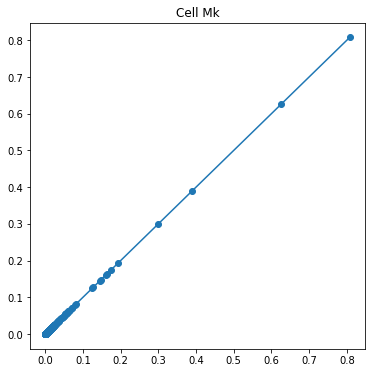

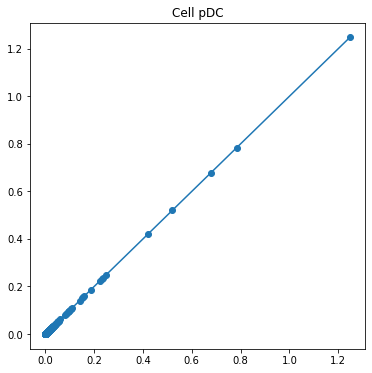

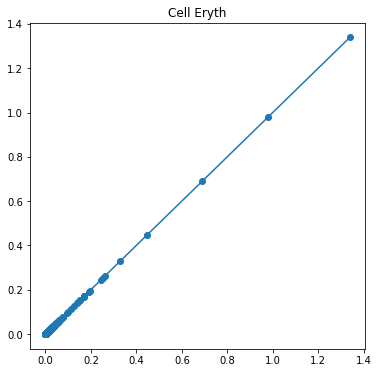

-------------------------------------------------------------------
25


Transforming to str index.


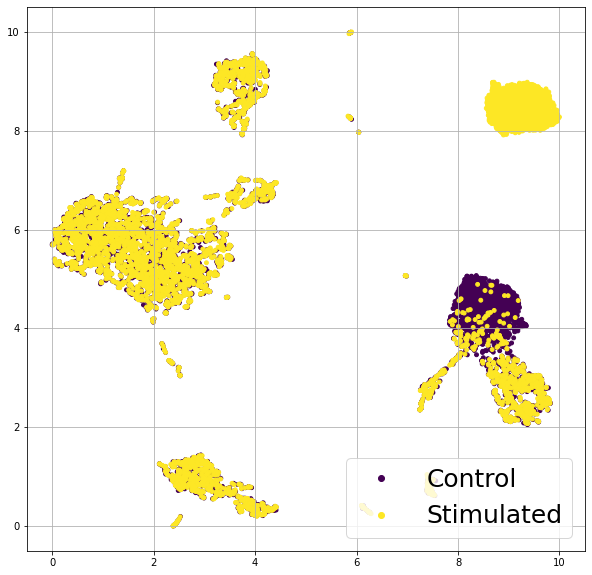

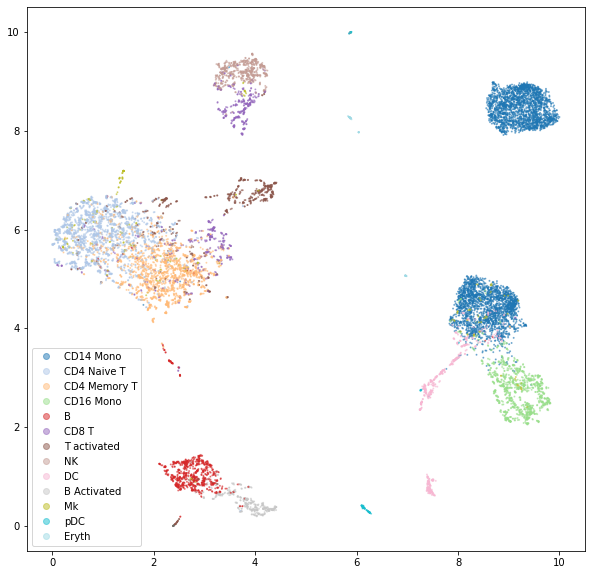

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13078/13096 [02:13<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


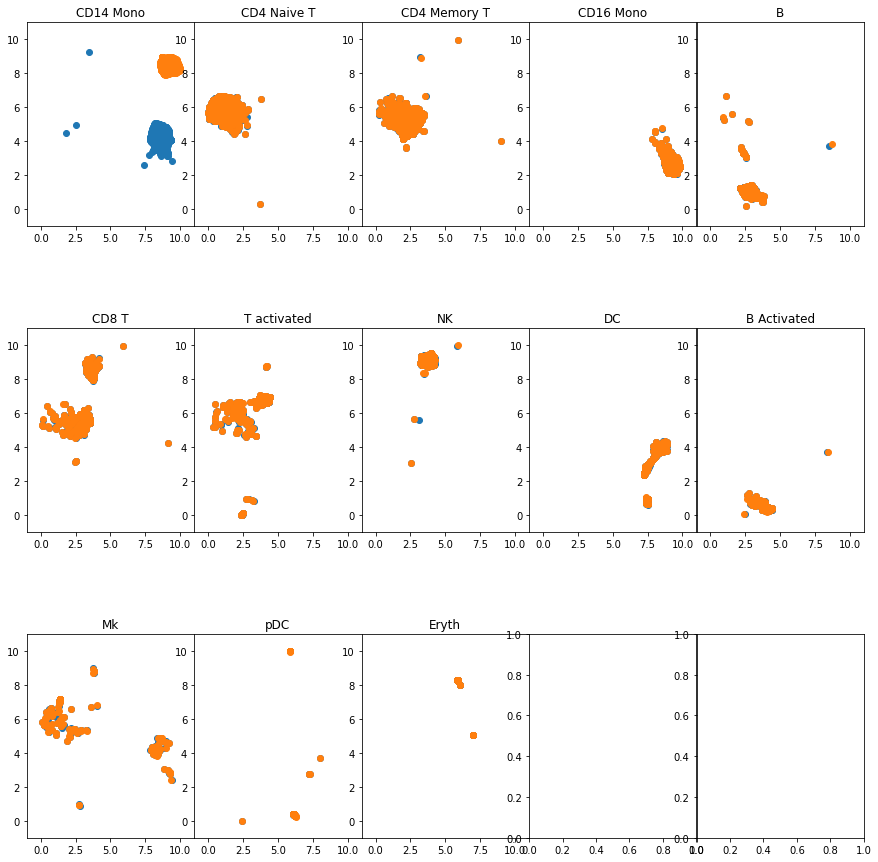

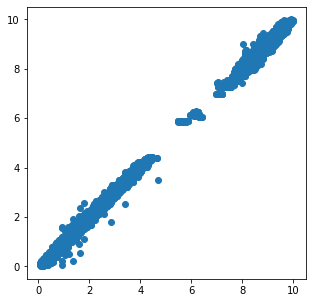

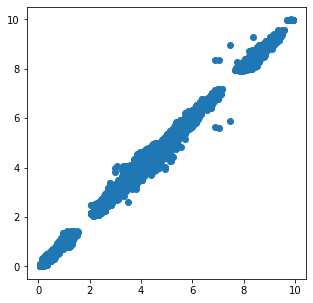

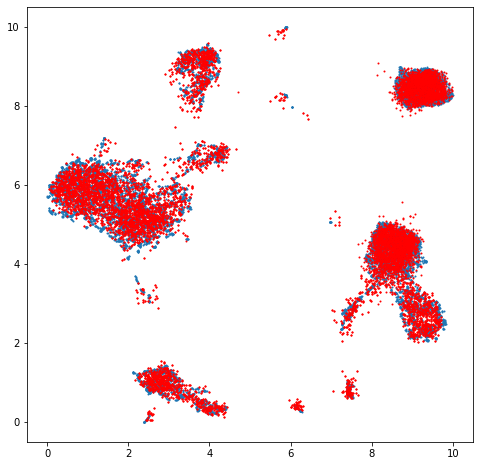

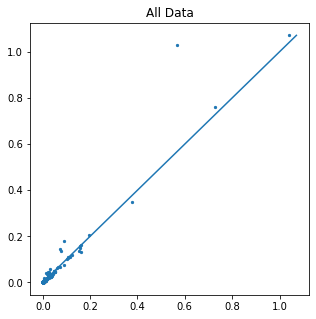

...

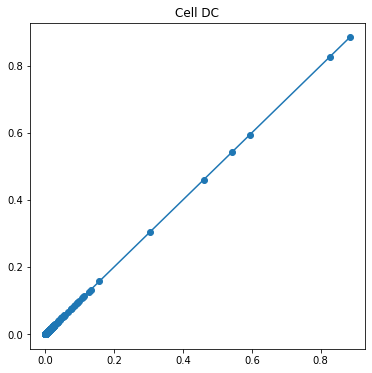

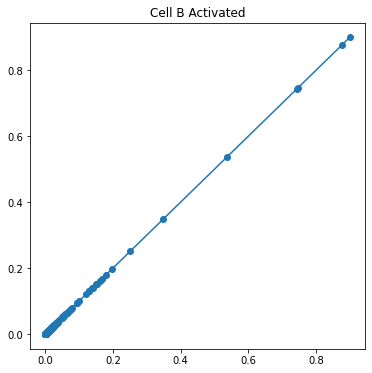

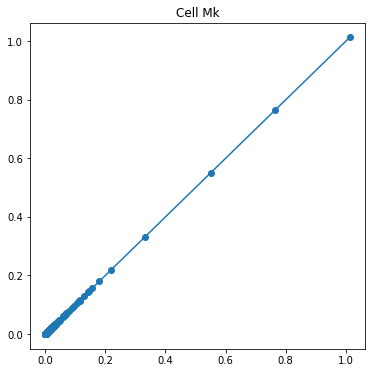

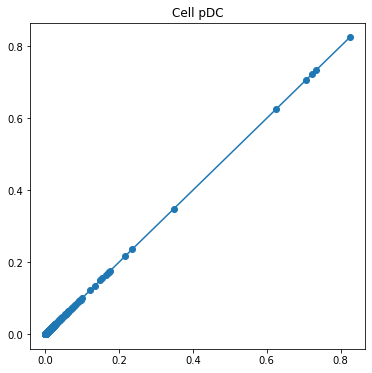

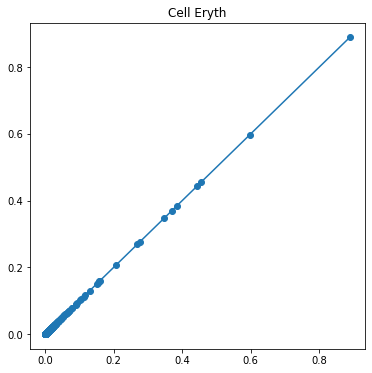

-------------------------------------------------------------------
30


Transforming to str index.


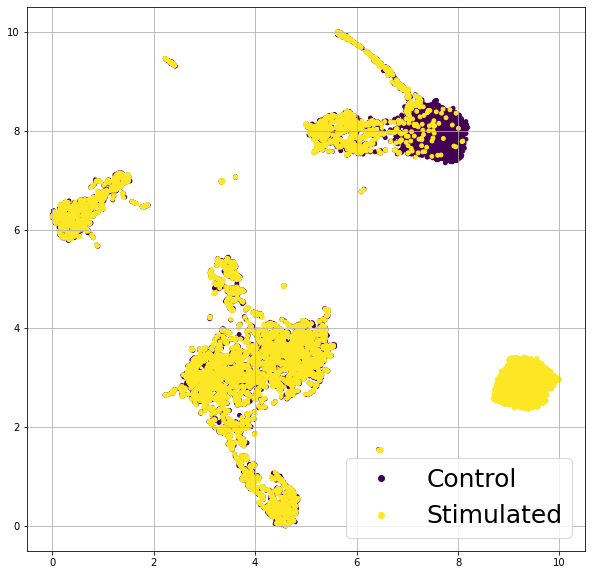

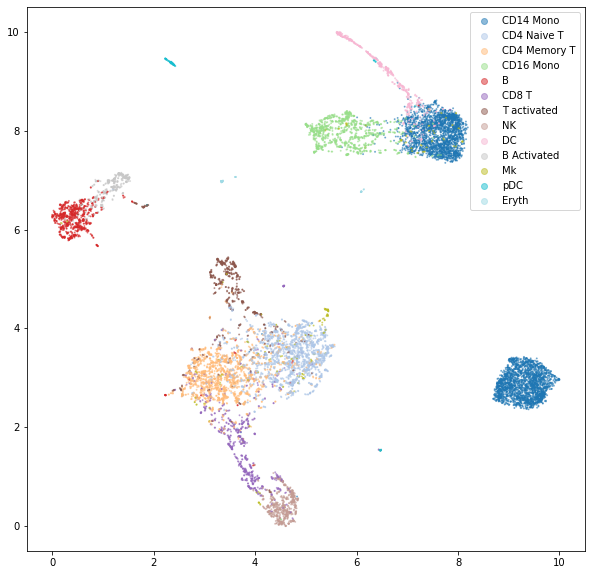

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13011/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


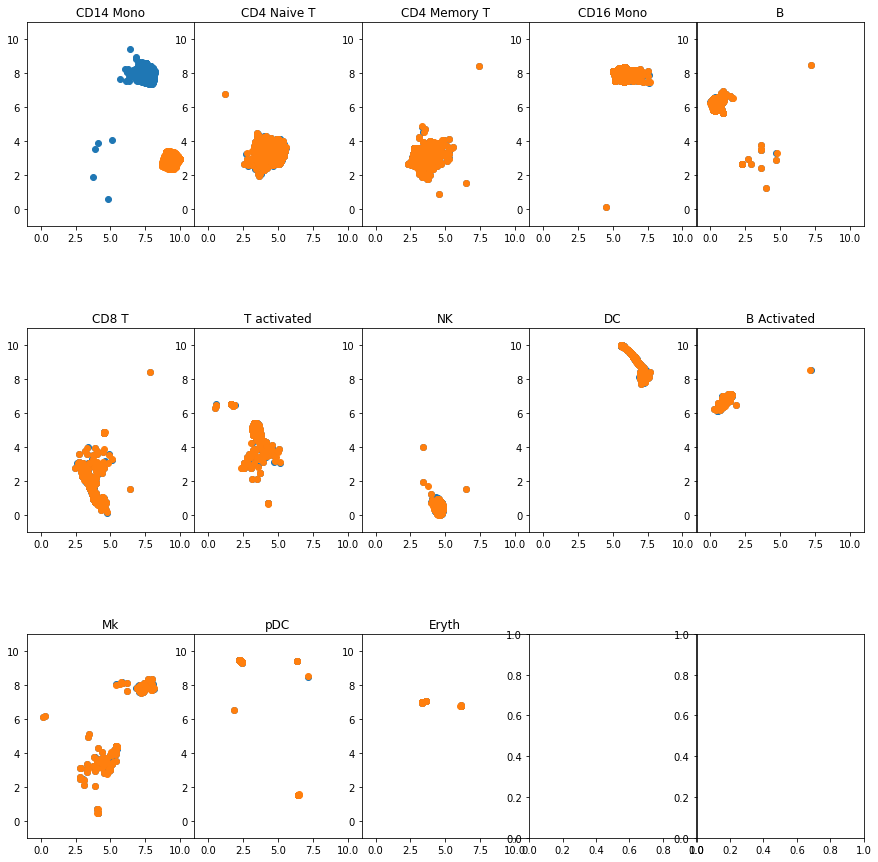

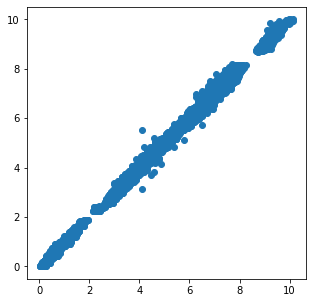

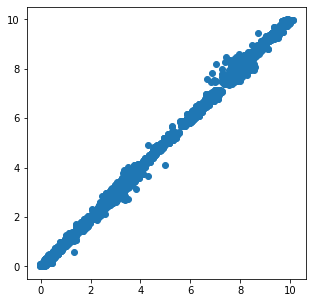

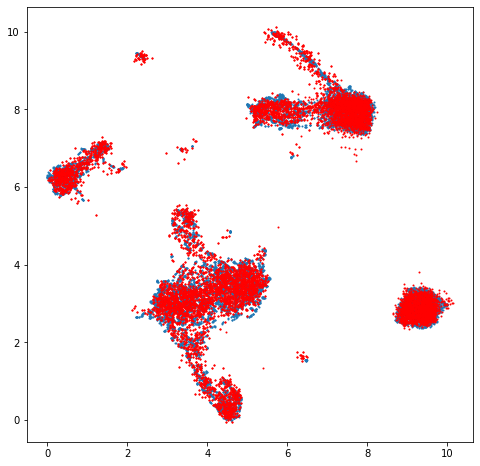

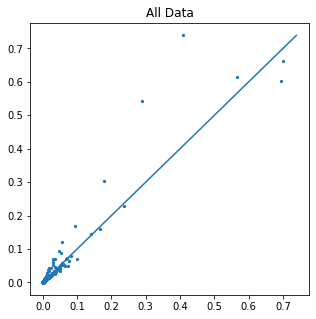

...

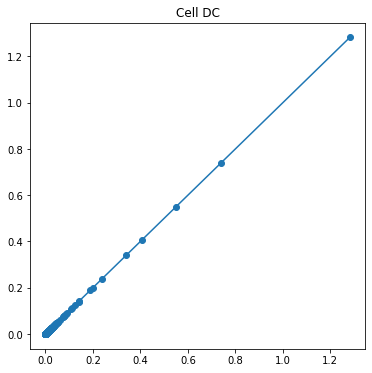

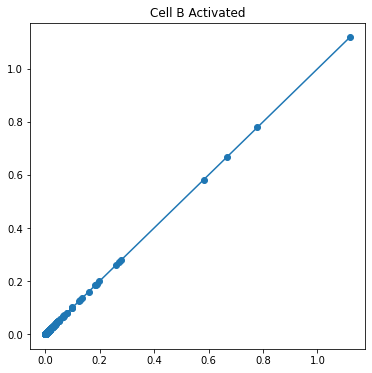

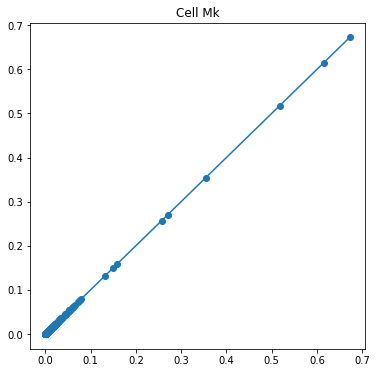

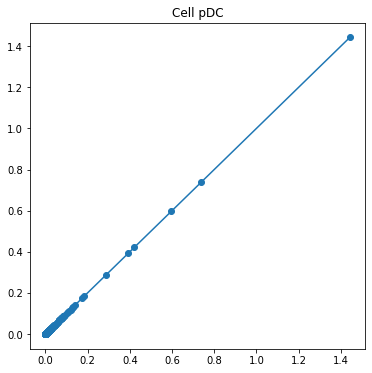

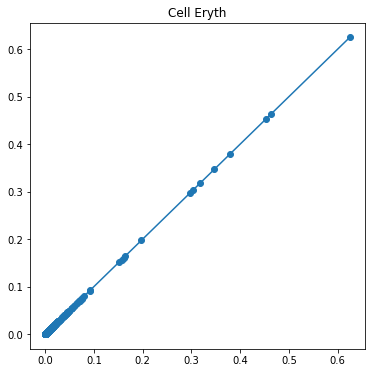

-------------------------------------------------------------------
35


Transforming to str index.


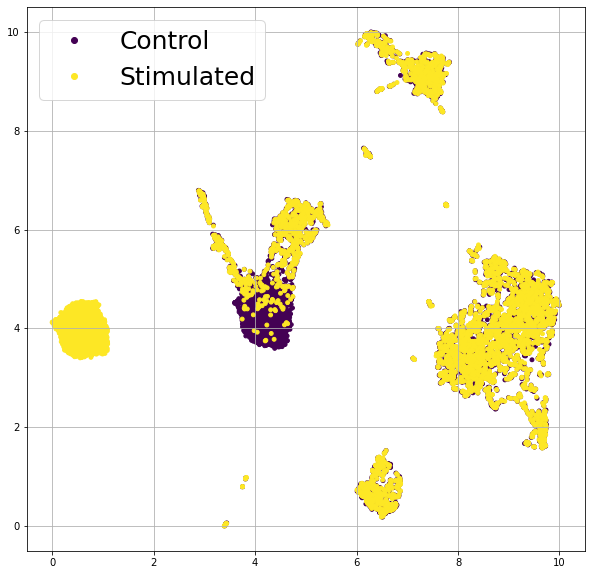

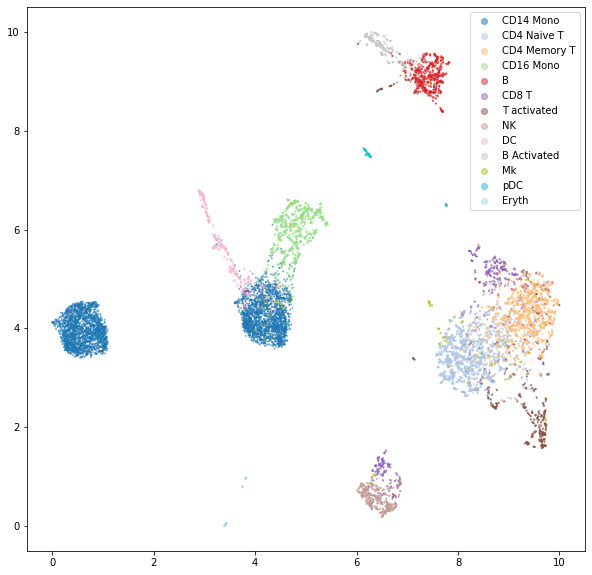

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 12991/13096 [02:02<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


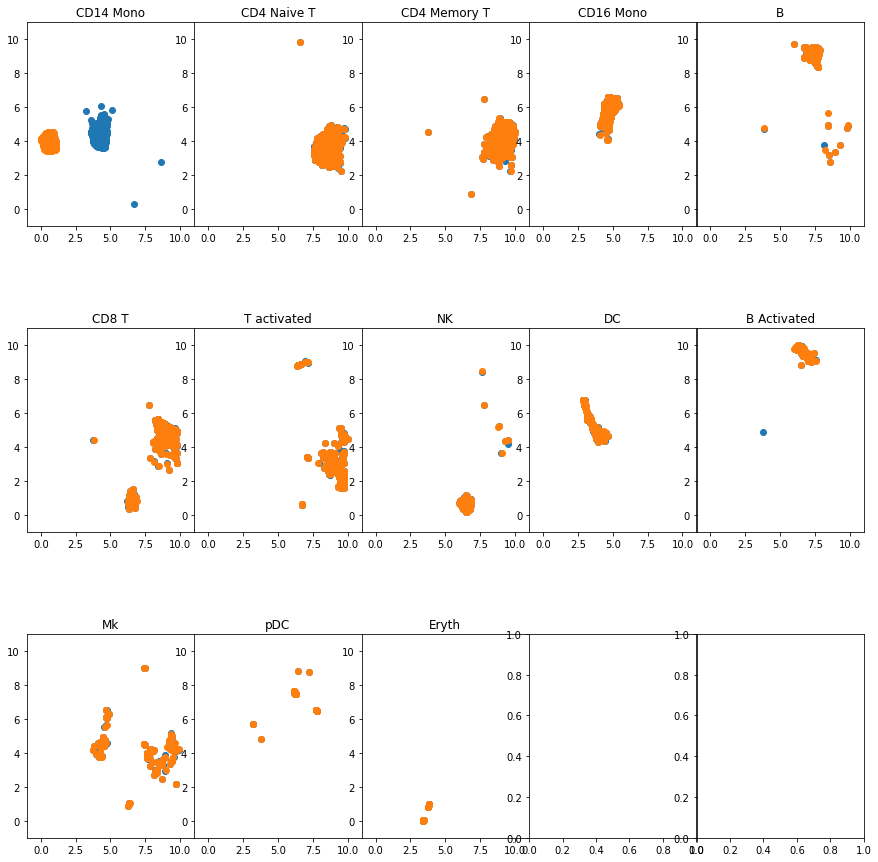

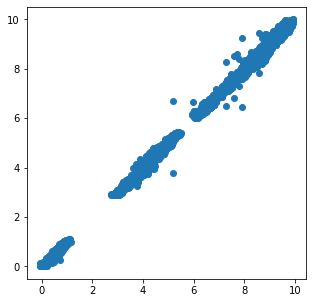

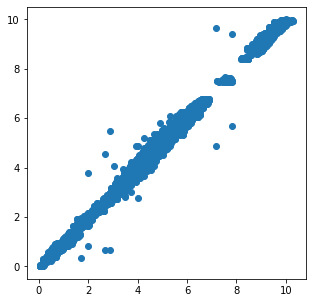

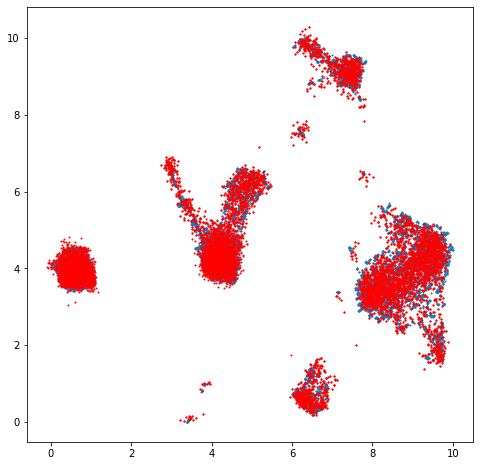

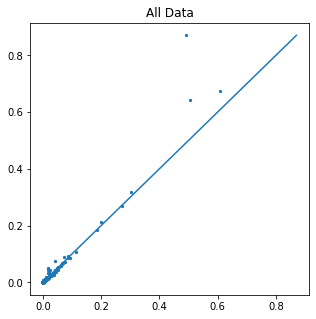

...

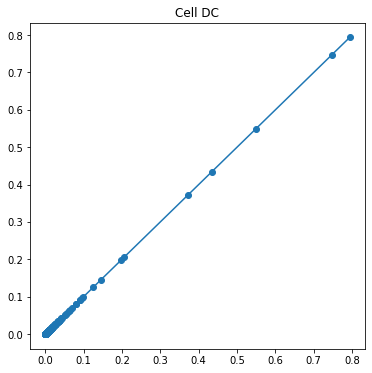

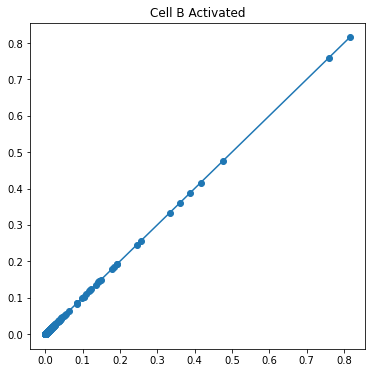

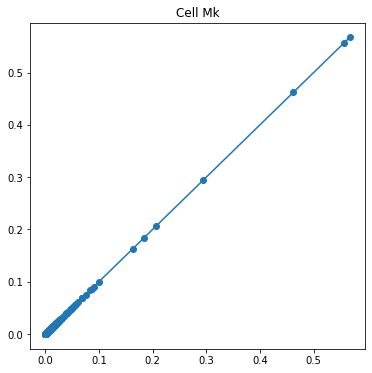

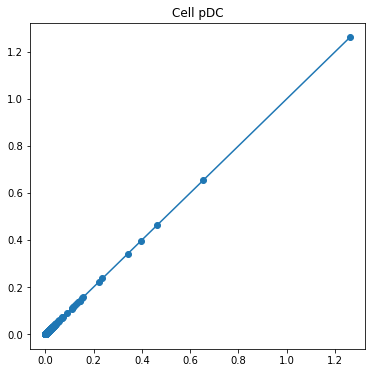

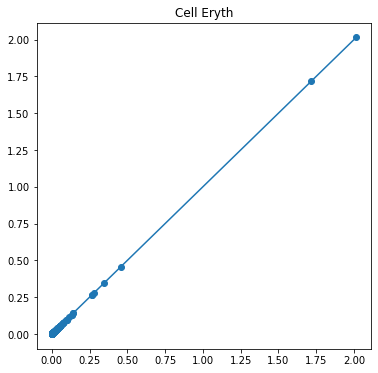

-------------------------------------------------------------------
40


Transforming to str index.


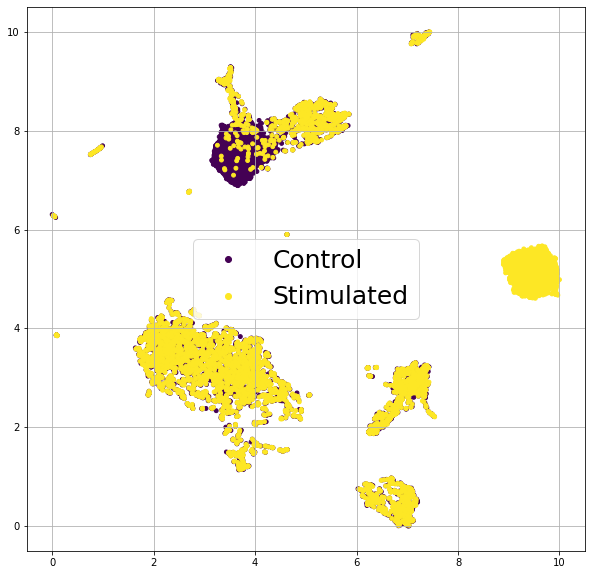

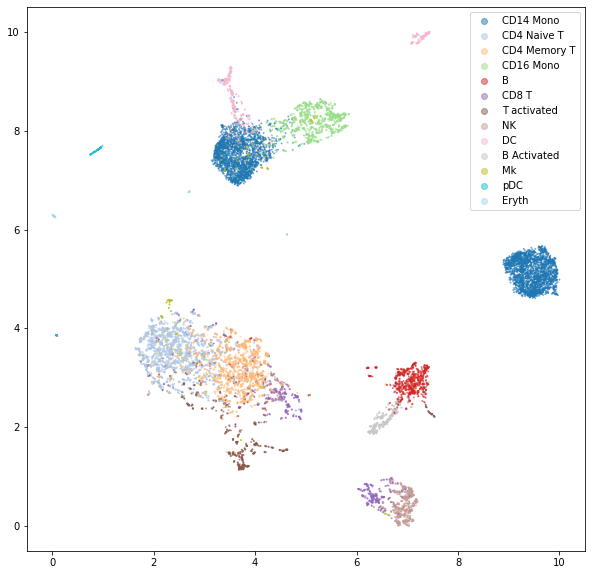

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13031/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


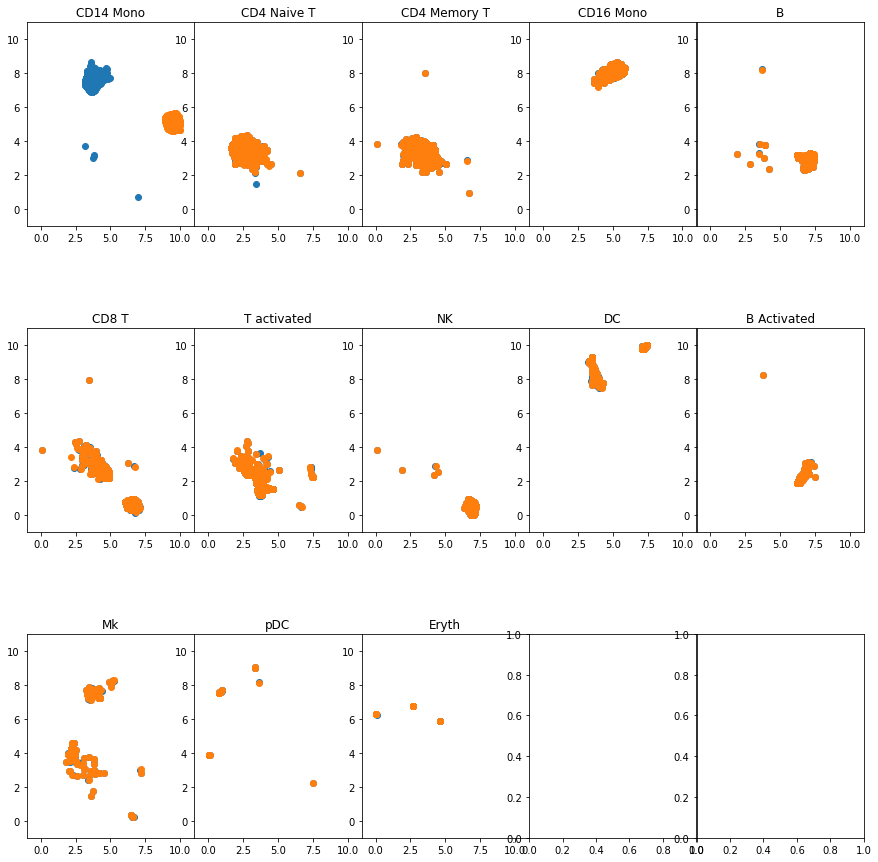

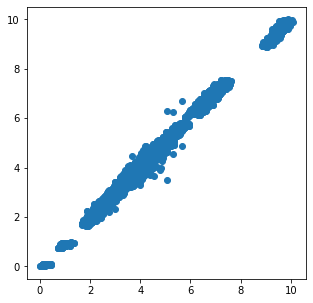

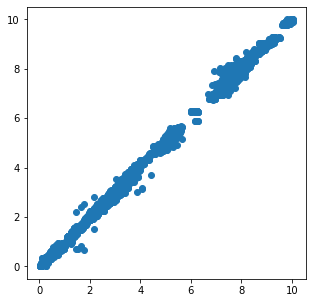

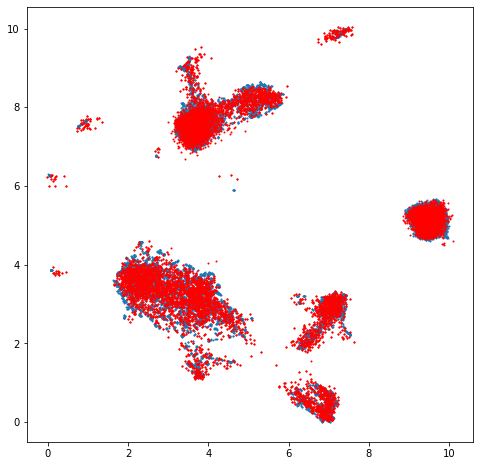

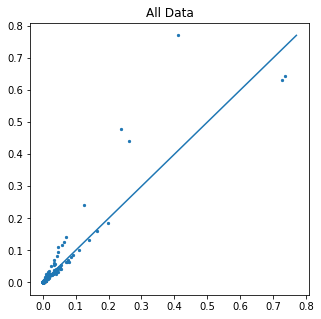

...

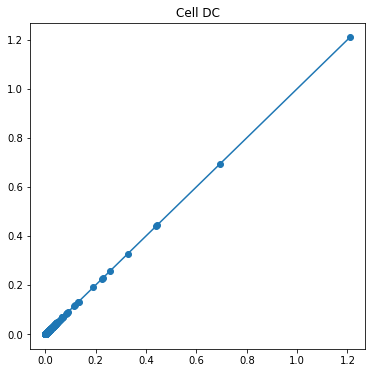

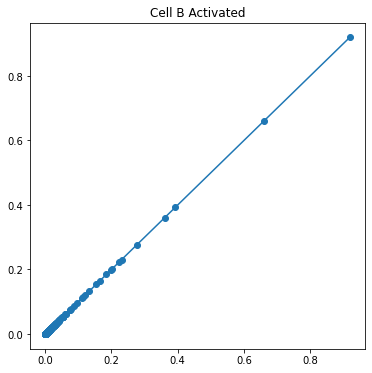

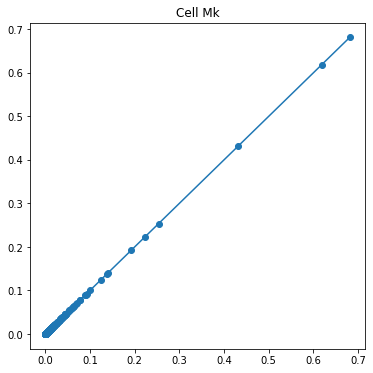

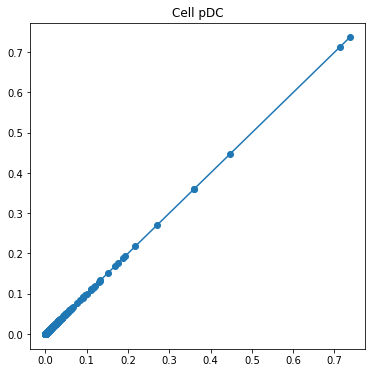

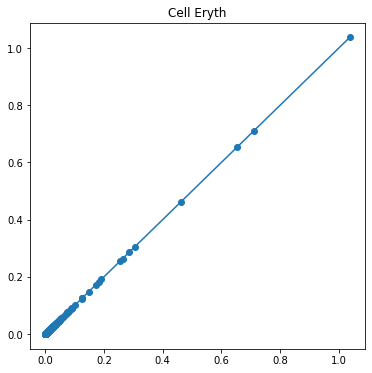

-------------------------------------------------------------------
45


Transforming to str index.


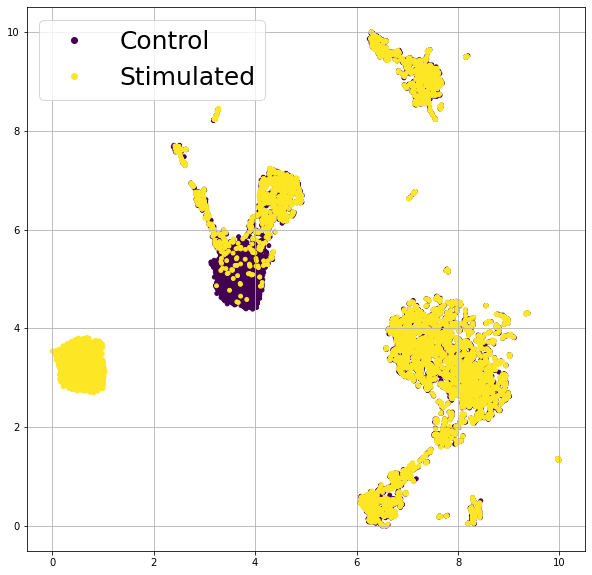

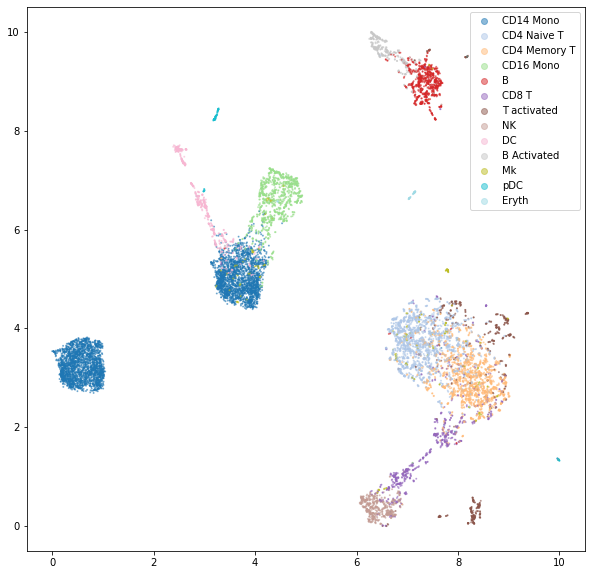

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13087/13096 [02:06<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


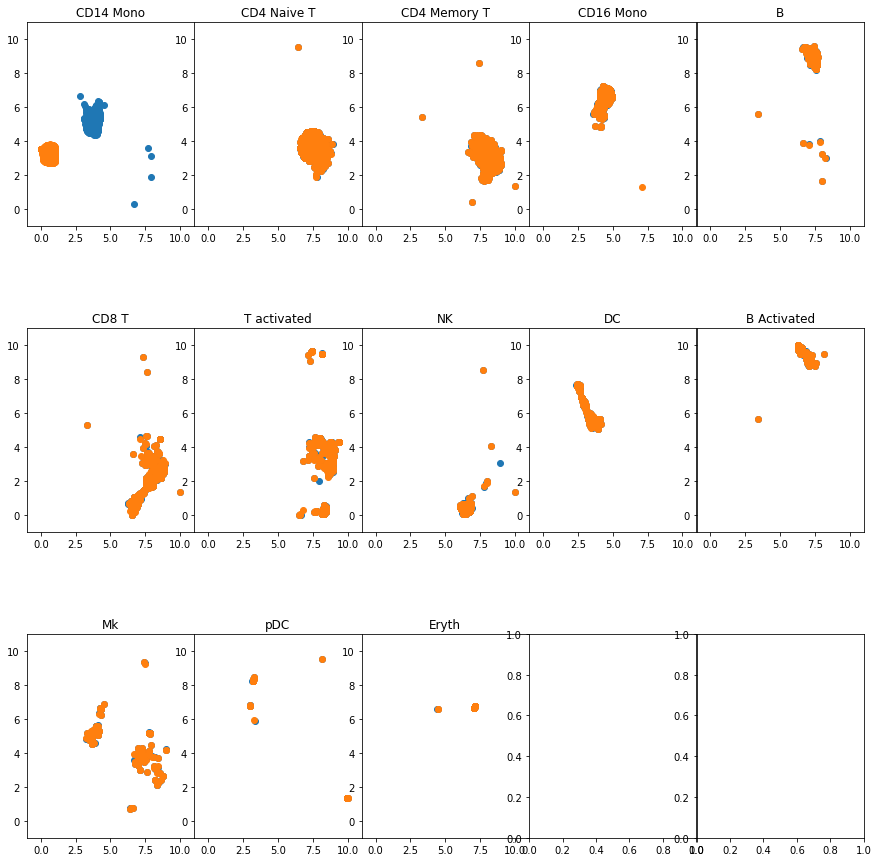

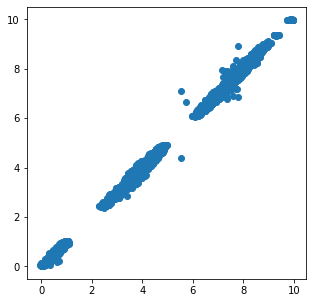

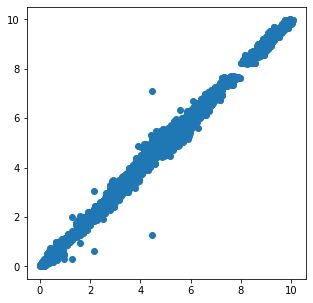

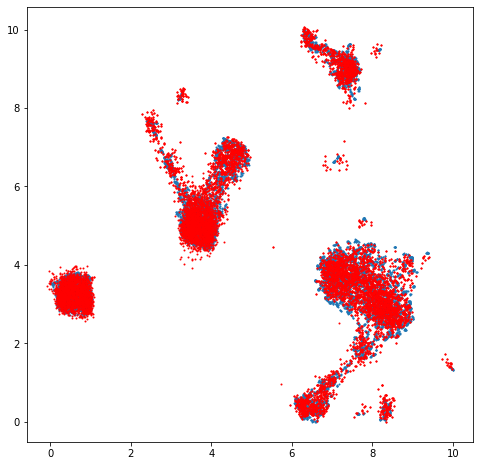

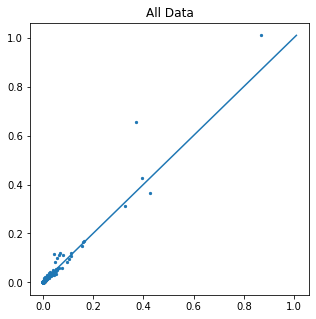

...

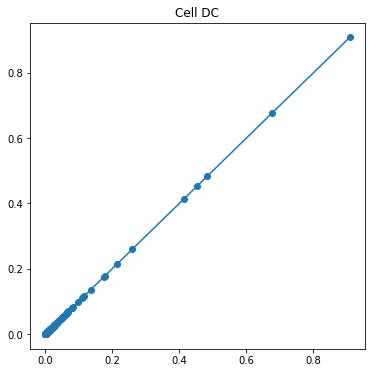

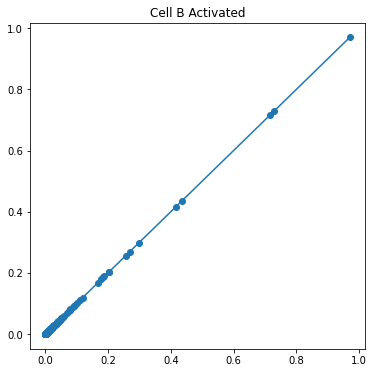

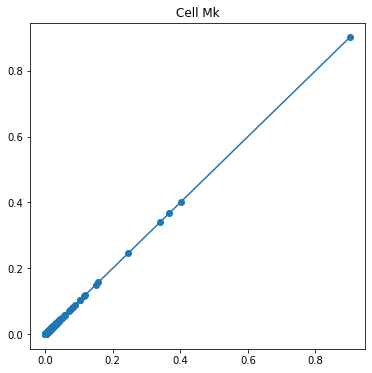

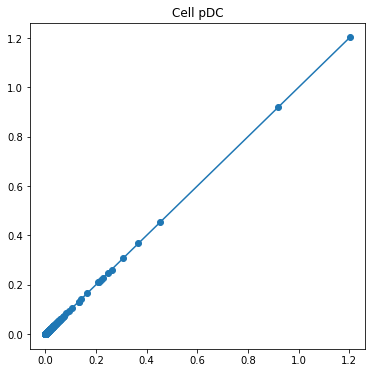

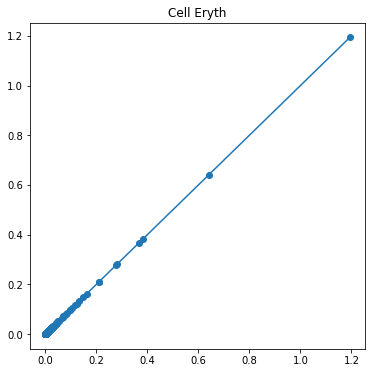

-------------------------------------------------------------------
50


Transforming to str index.


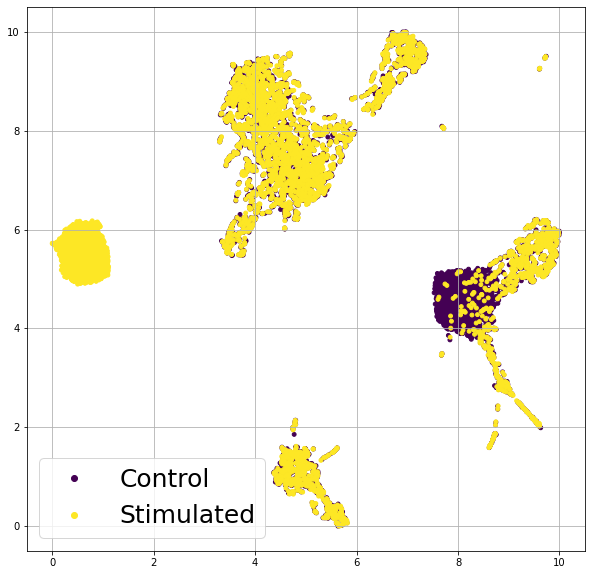

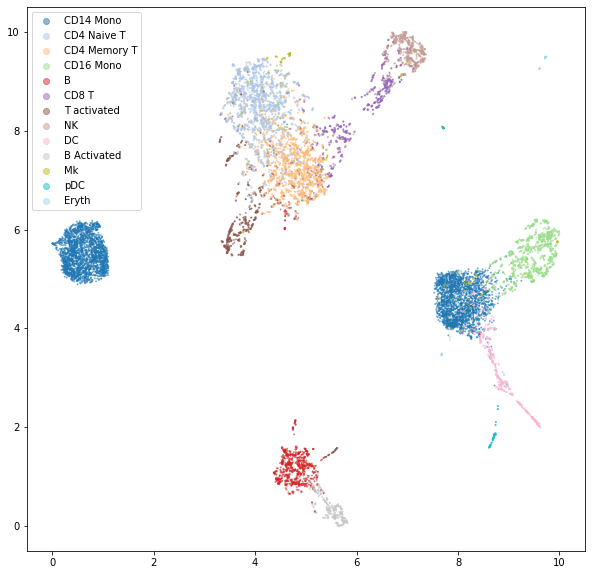

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13011/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


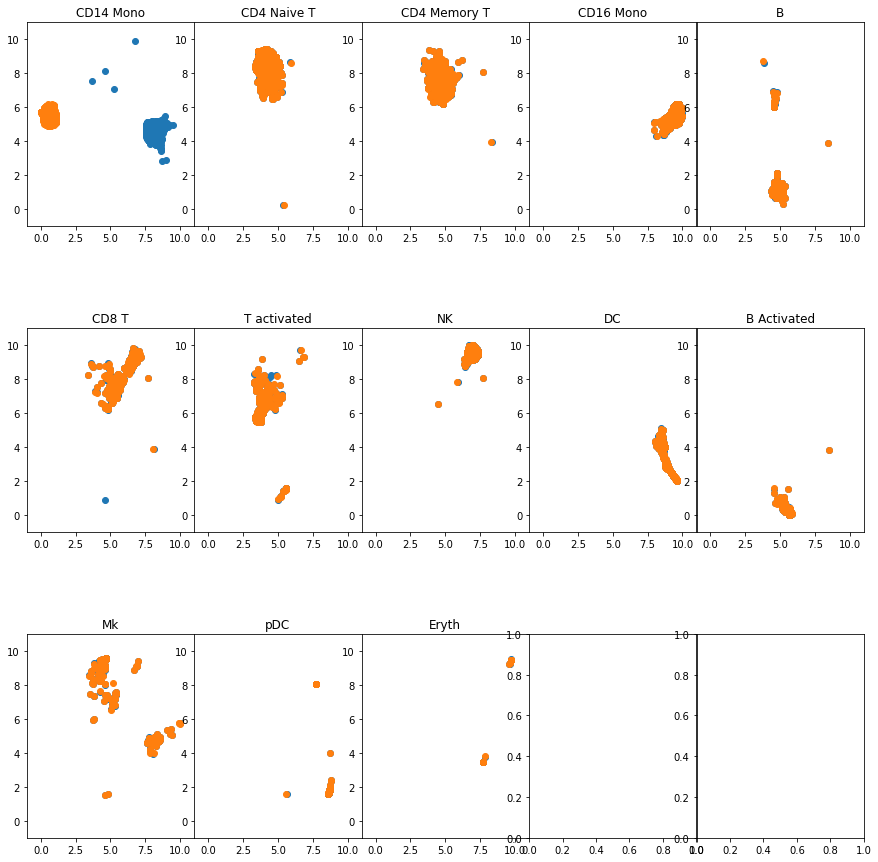

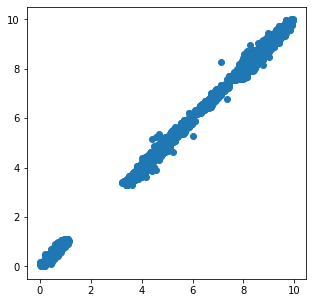

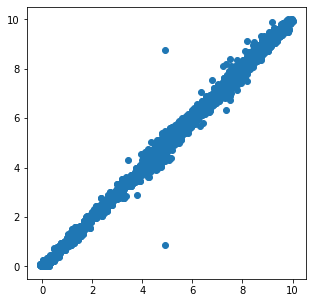

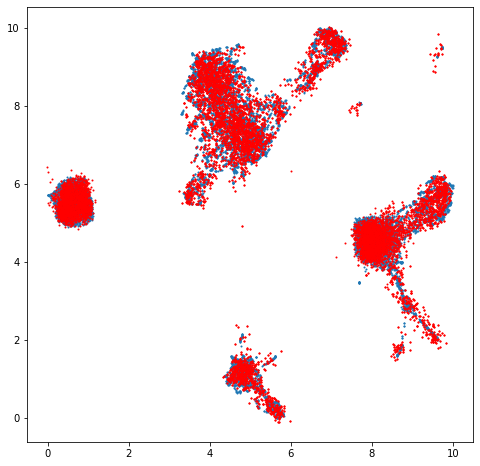

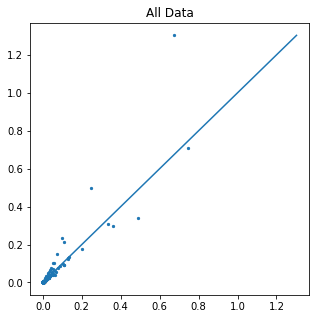

...

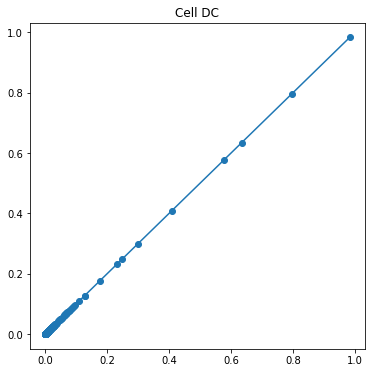

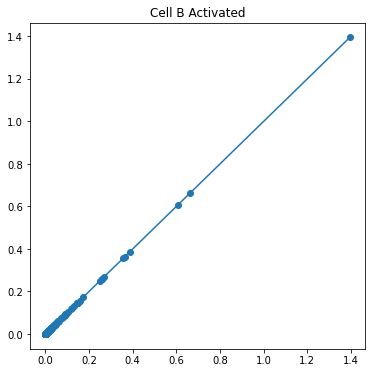

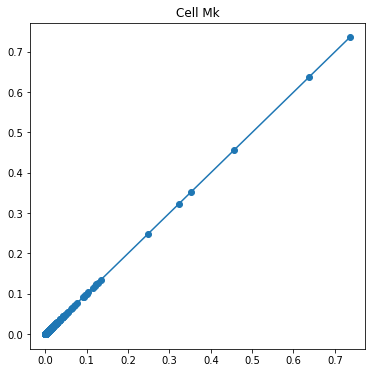

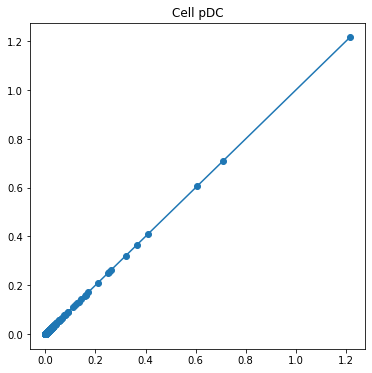

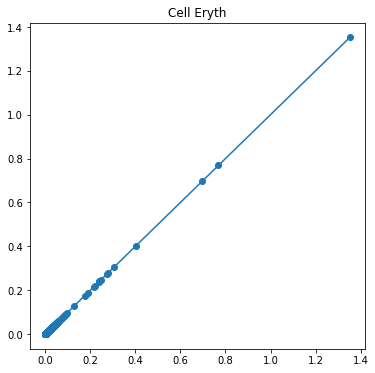

-------------------------------------------------------------------


In [36]:
a,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
b,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)

union_hvg = np.intersect1d(a,b)
_,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
_,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)
adata_hvg_ctrl = adata_ctrl[:, idx_ctrl]
adata_hvg_stim = adata_stim[:, idx_stim]
adata_non_hvg_ctrl = adata_ctrl[:, np.array(non_hvg_idx)]
adata_non_hvg_stim = adata_stim[:, np.array(non_hvg_idx)]
print(adata_hvg_ctrl.shape,adata_hvg_stim.shape,adata_non_hvg_ctrl.shape,adata_non_hvg_stim.shape)

non_hvg = np.vstack((np.array(adata_non_hvg_ctrl.X),np.array(adata_non_hvg_stim.X)))
hvg = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
tmp_combined_df = np.hstack((hvg,non_hvg))
tmp_combined_df = pd.DataFrame(tmp_combined_df,columns=ordered_genes)

META_SCORES = []
META_GENES = []
CHANGED_GENES = []

for num_genes in [1,5,10,15,20,25,30,35,40,45,50]:
    print(num_genes)
    tmp_df = pd.DataFrame(adata_hvg_stim.X)

    #num_genes = 50
    gene_idx = np.random.randint(2093,size=num_genes)
    CHANGED_GENES.append(union_hvg[gene_idx])
    cd14_idx = np.where(control_labels == 0)[0]

    tmp_df = pd.DataFrame(adata_hvg_stim.X)
    for idx in gene_idx:
        for cd14 in cd14_idx:
            tmp_df.iloc[cd14,idx] = tmp_df.iloc[cd14,idx] + np.random.normal(1, 0.1) #+ med/50

    adata_hvg_stim = sc.AnnData(tmp_df)

    ##  STIM vs. UNSTIM STARTING POINT
    
    combined = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
    combined_df = pd.DataFrame(combined,columns=union_hvg)
    combined_df

    # PCA TRANSFORMATION
    pca = PCA(n_components=50)
    pca_emb = pca.fit_transform(combined_df)

    # UMAP TRANSFORMATION
    reducer = umap.UMAP(random_state=42)
    embedding = reducer.fit_transform(pca_emb)

    #Scaling so that min and max alwasys be 0 and 10 for both x and y axis
    scaler = MinMaxScaler()
    embedding = 10*scaler.fit_transform(embedding)

    c = [0 for i in range(adata_hvg_ctrl.shape[0])] + [1 for i in range(adata_hvg_stim.shape[0])]
    classes = ['Control','Stimulated']

    fig, ax = plt.subplots(figsize=(10,10))
    scatter = ax.scatter(embedding[:,0],embedding[:,1],c=c, s=15)
    plt.legend(handles=scatter.legend_elements()[0], labels=classes,fontsize=25)
    plt.grid(True)

    cell_classes = ["CD14 Mono","CD4 Naive T", "CD4 Memory T","CD16 Mono","B","CD8 T","T activated","NK","DC","B Activated", 
        "Mk", "pDC", "Eryth", "Mono/Mk Doublets"]

    seurat_labels = list(control_labels) + list(stimulated_labels)
    fig, ax = plt.subplots(figsize=(10,10))
    scatter = ax.scatter(embedding[:,0],embedding[:,1],c=seurat_labels, alpha = 0.5, s=1, cmap='tab20')
    plt.legend(handles=scatter.legend_elements()[0], labels=cell_classes)
    plt.show()
    ctrl_emb = embedding[:len(control_labels),:]
    stim_emb = embedding[len(control_labels):,:]

    ctrl_emb_pca = pca_emb[:len(control_labels),:]
    stim_emb_pca = pca_emb[len(control_labels):,:]

    unq_labels = np.unique(control_labels)
    fig, axs = plt.subplots(3,5, figsize=(15, 15), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace = .5, wspace=.001)

    axs = axs.ravel()

    for label in unq_labels:
        tmp_ctrl=ctrl_emb[control_labels == label,:]
        tmp_stim=stim_emb[stimulated_labels == label,:]

        axs[label].scatter(tmp_ctrl[:,0],tmp_ctrl[:,1])
        axs[label].scatter(tmp_stim[:,0],tmp_stim[:,1])
        axs[label].set_xlim(np.min(embedding,axis=0)[0]-1, np.max(embedding,axis=0)[0]+1)
        axs[label].set_ylim(np.min(embedding,axis=0)[1]-1, np.max(embedding,axis=0)[1]+1)
        axs[label].set_title(cell_classes[label])

    ### Fitting XGBoost with the bigger gene list 
    non_hvg = np.vstack((np.array(adata_non_hvg_ctrl.X),np.array(adata_non_hvg_stim.X)))
    hvg = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
    tmp_combined_df = np.hstack((hvg,non_hvg))
    tmp_combined_df = pd.DataFrame(tmp_combined_df,columns=ordered_genes)
    
    X = tmp_combined_df
    y0 = embedding[:,0]
    X_train, X_test, y_train, y_test = train_test_split(X.values, y0, test_size=0.2, random_state=5)

    model_x = XGBRegressor()
    model_x.fit(X.values, y0)

    predicted_x = model_x.predict(X.values)
    plt.figure(figsize=(5,5))
    plt.scatter(predicted_x, y0)
    mean_squared_error(predicted_x, y0)

    y1 = embedding[:,1]
    X_train, X_test, y_train, y_test = train_test_split(X.values, y1, test_size=0.2, random_state=5)

    model_y = XGBRegressor()
    model_y.fit(X.values, y1)
    predicted_y = model_y.predict(X.values)
    plt.figure(figsize=(5,5))
    plt.scatter(predicted_y, y1)
    mean_squared_error(predicted_y, y1)

    _, _, _, real_y = train_test_split(X.values, embedding, test_size=0.2, random_state=5)
    plt.figure(figsize=(8,8))
    plt.scatter(y0,y1,s=1)
    plt.scatter(predicted_x,predicted_y,c='r',s=1)

    # SHAP ANALYSIS on X
    explainer = shap.TreeExplainer(model_x,X.values)
    shap_value_x = explainer.shap_values(X.values)

    # # SHAP ANALYSIS on Y
    explainer = shap.TreeExplainer(model_y,X.values)
    shap_value_y = explainer.shap_values(X.values)

    comb_shap_values = np.sqrt((shap_value_x**2 + shap_value_y**2))
    print(comb_shap_values.shape)

    batch1_shap = comb_shap_values[:len(control_labels),:]
    batch2_shap = comb_shap_values[len(control_labels):,:]
    print(batch1_shap.shape, batch2_shap.shape)

    mean_feature1 = np.mean(batch1_shap,axis=0)
    mean_feature2 = np.mean(batch2_shap,axis=0)
    diag = np.linspace(0,np.max(np.concatenate([mean_feature1,mean_feature2])))
    plt.figure(figsize=(5,5))
    plt.scatter(mean_feature1,mean_feature2,s=5)
    plt.plot(diag,diag)
    plt.title('All Data')
    eval_score_sum(mean_feature1,mean_feature2)


    # Per Different Labels

    cell_num = []
    for label in unq_labels:
        a=np.sum(control_labels == label)
        b=np.sum(stimulated_labels == label)
        cell_num.append(min(a,b))
    print(cell_num)
    cell_orders = unq_labels[np.argsort(-1*np.array(cell_num))]

    fig, axs = plt.subplots(3,5, figsize=(15, 15), facecolor='w', edgecolor='k')
    fig.subplots_adjust(hspace = .3, wspace=.2)
    axs = axs.ravel()
    scores_stunst1 = []
    for ct,label in enumerate(cell_orders):
        tmp_batch1_shap = batch1_shap[control_labels == label, :]
        tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]
        #print(len(tmp_batch1_shap),len(tmp_batch2_shap))

        tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
        tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

        score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
        scores_stunst1.append(score)
        cap = max(np.max(tmp_mean_feature1), np.max(tmp_mean_feature2)) + 0.3
        diag = np.linspace(0,cap)
        axs[ct].scatter(tmp_mean_feature1,tmp_mean_feature2)
        axs[ct].plot(diag,diag)
        axs[ct].set_xlim(0,cap)
        axs[ct].set_ylim(0,cap)
        axs[ct].set_title(cell_classes[label]+' \n ' + str(score),fontsize=15)

    axs[13].set_axis_off()
    axs[14].set_axis_off()
    META_SCORES.append(scores_stunst1)
    from tqdm import tqdm

    comb_label = list(control_labels) + list(stimulated_labels)

#     LABEL_SCORES_COMB = []
#     for label in tqdm(cell_orders):
#         label_score = []
#         for i in range(100):
#             tmp_batch = comb_shap_values[np.array(comb_label) == label, :]

#             tmp_batch1_shap = tmp_batch[np.random.randint(0, tmp_batch.shape[0],int(tmp_batch.shape[0]/2)),:]
#             tmp_batch2_shap = tmp_batch[np.random.randint(0, tmp_batch.shape[0],int(tmp_batch.shape[0]/2)),:]

#             tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
#             tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

#             score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
#             label_score.append(score)
#         LABEL_SCORES_COMB.append(label_score)

#     ct = 0

#     fig, axs = plt.subplots(3,5, figsize=(15, 10), facecolor='w', edgecolor='k')
#     fig.subplots_adjust(hspace = .5, wspace=.4)
#     axs = axs.ravel()

#     for scores in LABEL_SCORES_COMB:
#         axs[ct].hist(scores)
#         tmp = scores + [scores_stunst1[ct]]
#         zscores = stats.zscore(tmp)
#         p_values = 1 - scipy.special.ndtr(zscores)
#         axs[ct].set_title('{} \n p_val:{}'.format(cell_classes[cell_orders[ct]],'{:.1e}'.format(p_values[-1])),fontsize=20)
#     #     axs[ct].set_title('{} \n p_val:{}'.format(cell_classes[cell_orders[ct]],str(p_values[-1])[:5]),fontsize=18)

#         axs[ct].set_xlim([min(scores),scores_stunst1[ct] + 0.2])
#         axs[ct].axvline(scores_stunst1[ct], color='r', linestyle='dashed', linewidth=3)
#         ct += 1

#     axs[13].set_axis_off()
#     axs[14].set_axis_off()

#     mean_perms = []
#     for scores in LABEL_SCORES_COMB:
#         mean_perms.append(np.nanmean(scores))

#     fig, axs = plt.subplots(3,5, figsize=(15, 10), facecolor='w', edgecolor='k')
#     fig.subplots_adjust(hspace = .5, wspace=.4)
#     axs = axs.ravel()
#     scores_stunst1 = []
#     for ct,label in enumerate(cell_orders):
#         tmp_batch1_shap = batch1_shap[control_labels == label, :]
#         tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]
#         #print(len(tmp_batch1_shap),len(tmp_batch2_shap))

#         tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
#         tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

#         score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
#         #scores_stunst1.append(score)
#         cap = max(np.max(tmp_mean_feature1), np.max(tmp_mean_feature2)) + 0.3
#         diag = np.linspace(0,cap)
#         axs[ct].scatter(tmp_mean_feature1,tmp_mean_feature2)
#         axs[ct].plot(diag,diag)
#         axs[ct].set_xlim(0,cap)
#         axs[ct].set_ylim(0,cap)
#         axs[ct].set_title(cell_classes[label]+'\n' + str(np.round(score-mean_perms[ct],2)),fontsize=22)
#         scores_stunst1.append(score-mean_perms[ct])
#     axs[13].set_axis_off()
#     axs[14].set_axis_off()
    #META_SCORES.append(scores_stunst1)
    unq_labels = np.unique(control_labels)
    scores = []
    gene_ranks = []
    for label in unq_labels:

        tmp_batch1_shap = batch1_shap[control_labels == label, :]
        tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]

        tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
        tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)
        diag = np.linspace(0,np.max(np.concatenate([tmp_mean_feature1, tmp_mean_feature2])))
        plt.figure(figsize=(6,6))
        plt.scatter(tmp_mean_feature1,tmp_mean_feature2)
        plt.plot(diag,diag)
        plt.title('Cell {}'.format(cell_classes[label]))
        plt.show()

        diff = np.abs(tmp_mean_feature1 + tmp_mean_feature2)
        score_by_feat = np.around(np.sum(diff),3)
        scores.append(score_by_feat)

        #print('TOP DIFFERENTIAL GENES : {}'.format(intersect[np.argsort(np.abs(tmp_mean_feature1 + tmp_mean_feature2))[-25:]]))
        
        if label == 0:
            gene_ranks.append(np.array(ordered_genes)[np.argsort(np.abs(tmp_mean_feature1 + tmp_mean_feature2))])
    META_GENES.append(gene_ranks)
    print('-------------------------------------------------------------------')

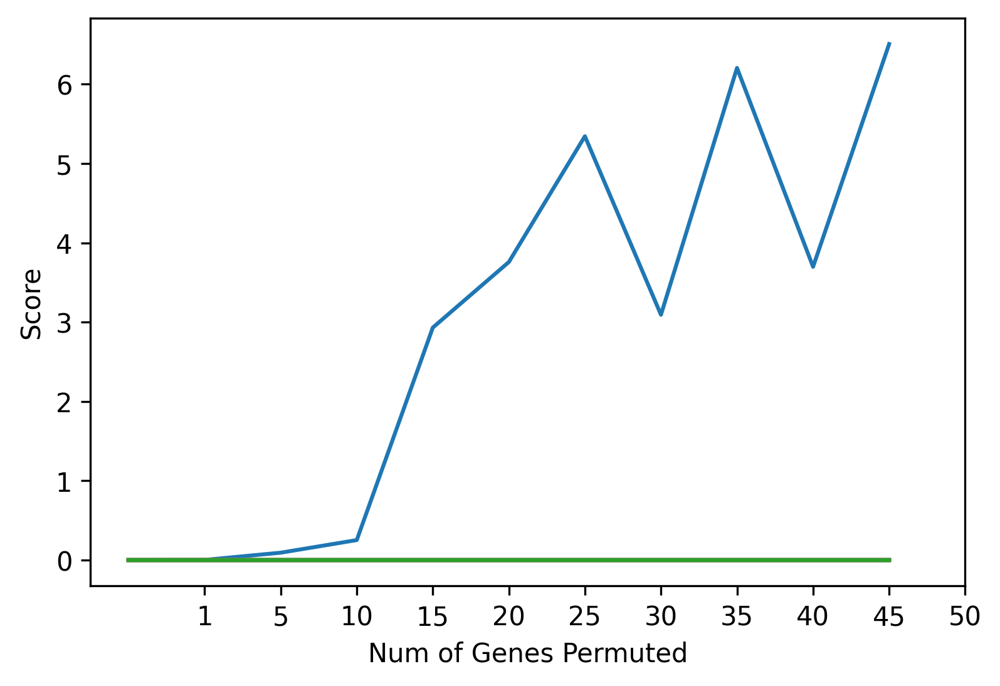

In [70]:
plt.figure(dpi=300)
for i in range(13):
    plt.plot(np.array(META_SCORES)[:,i])
plt.ylabel('Score')
plt.xticks(np.arange(len(RANKS))+1,[1,5,10,15,20,25,30,35,40,45,50])
plt.xlabel('Num of Genes Permuted')
plt.show()


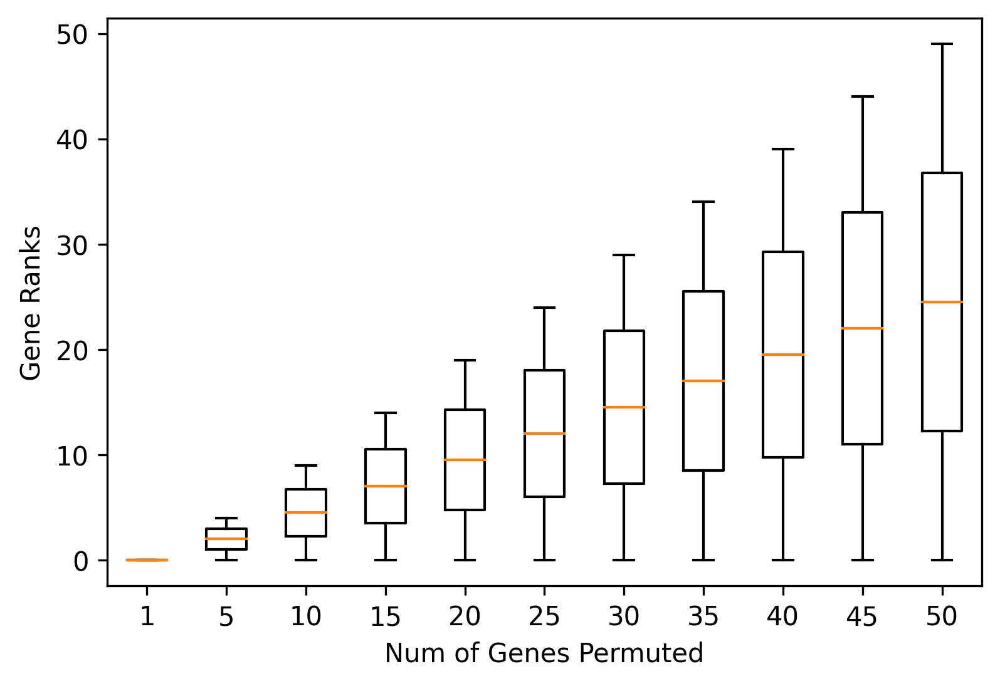

In [66]:
RANKS = []
for meta_genes, changed_genes in zip(META_GENES,CHANGED_GENES):
    b=np.intersect1d(np.array(meta_genes),np.array(changed_genes),return_indices=True)
    ranks = b[2]
    RANKS.append(ranks)
plt.figure(dpi=300)
plt.boxplot(RANKS)
plt.ylabel('Gene Ranks')
plt.xticks(np.arange(len(RANKS))+1,[1,5,10,15,20,25,30,35,40,45,50])
plt.xlabel('Num of Genes Permuted')
plt.show()

is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)


is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


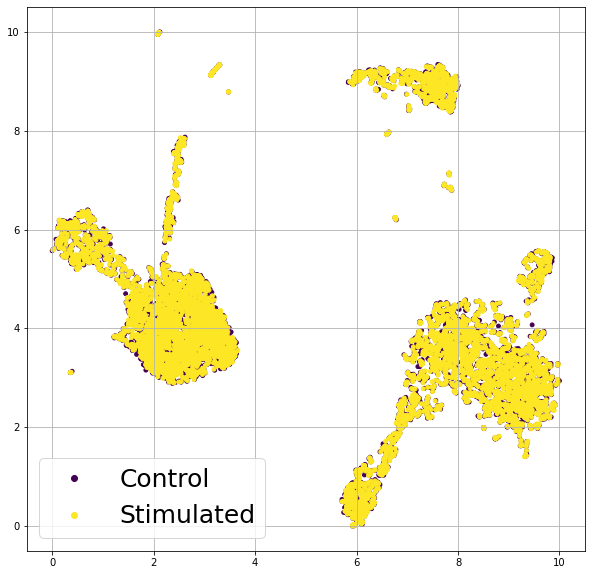

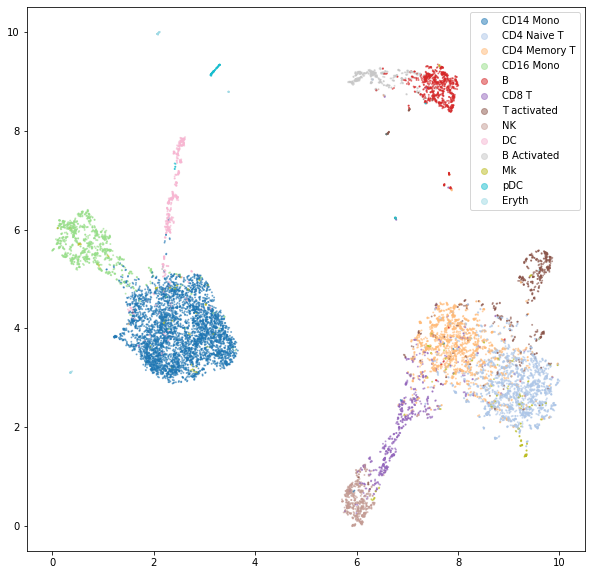

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13012/13096 [02:10<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


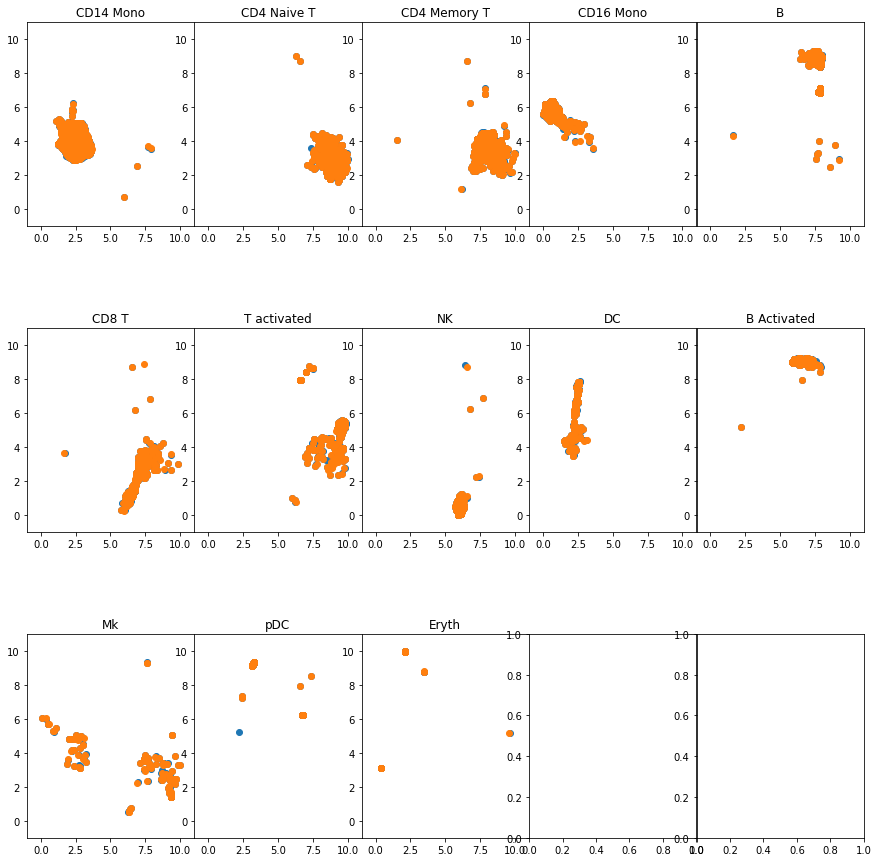

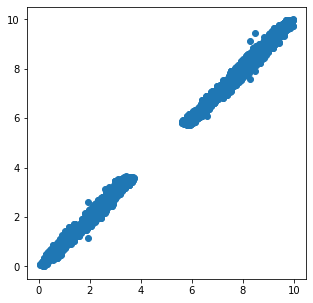

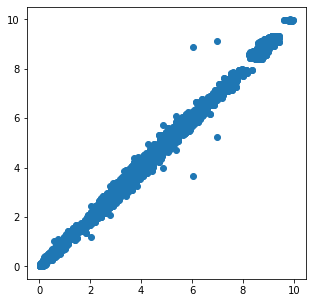

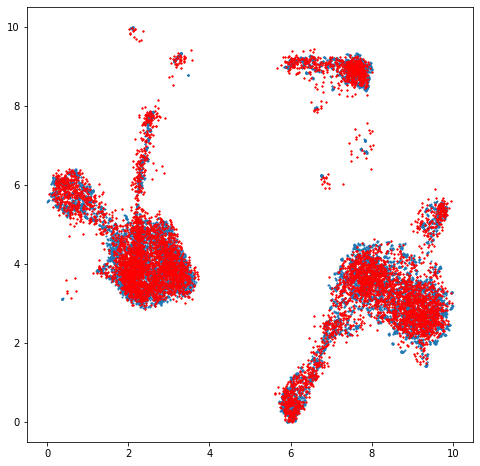

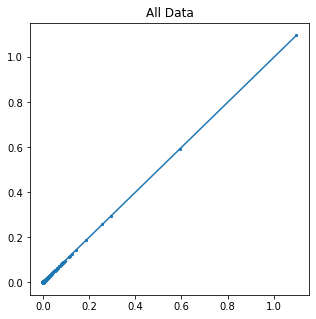

...

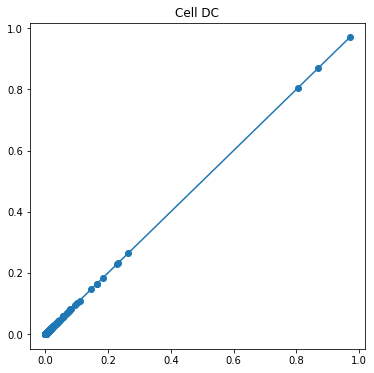

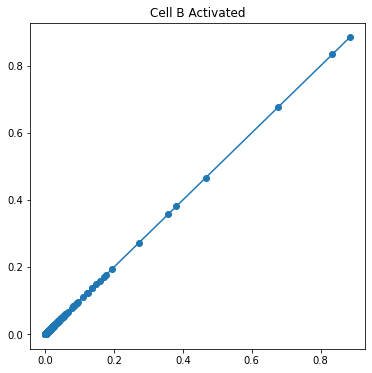

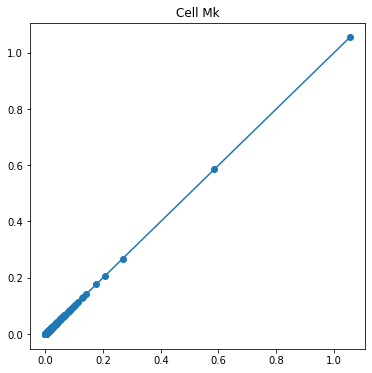

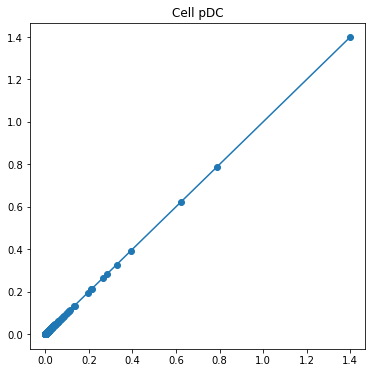

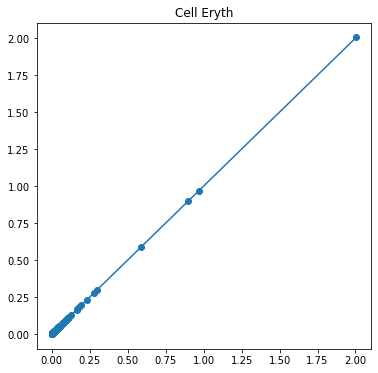

-------------------------------------------------------------------
5


Transforming to str index.


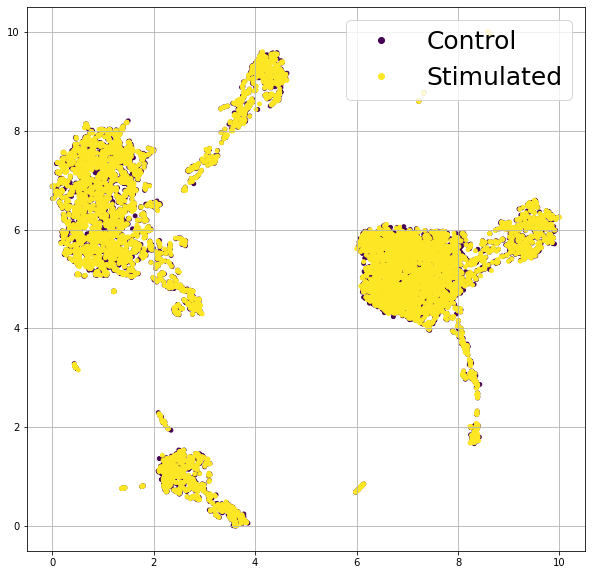

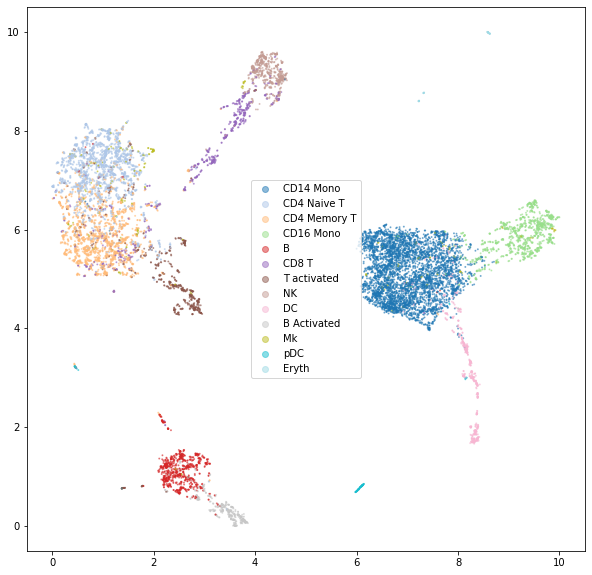

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 12995/13096 [02:06<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


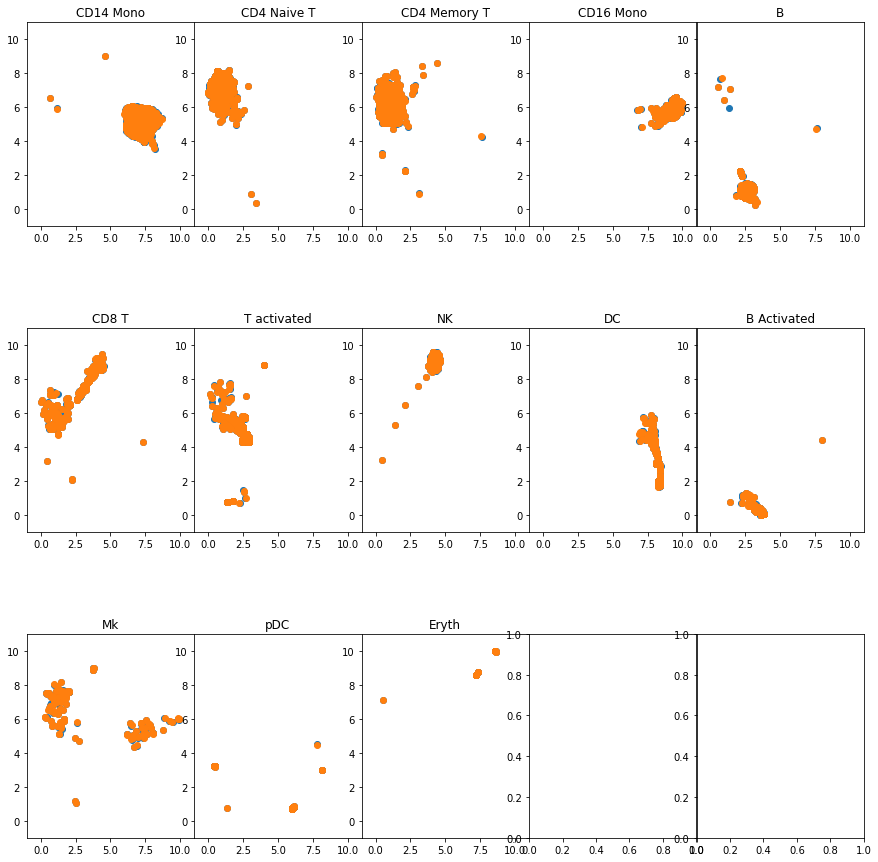

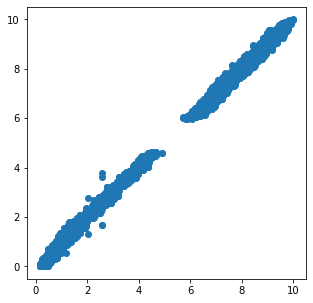

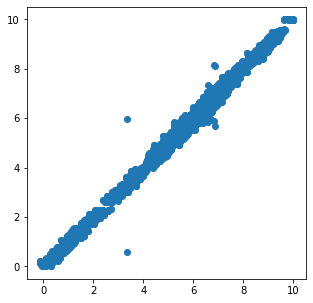

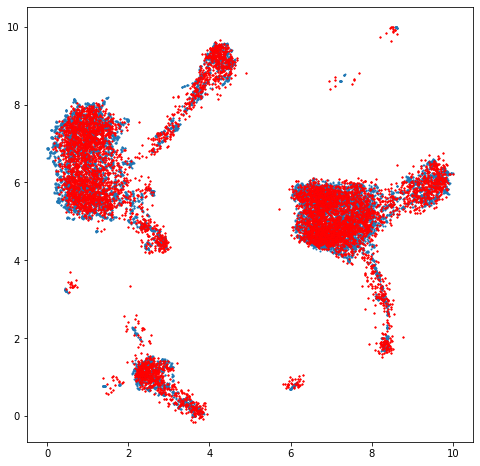

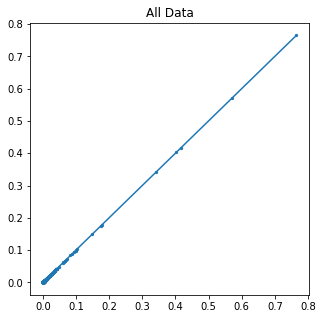

...

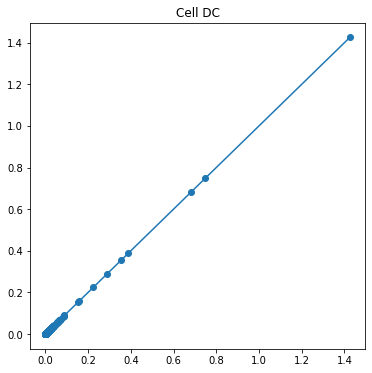

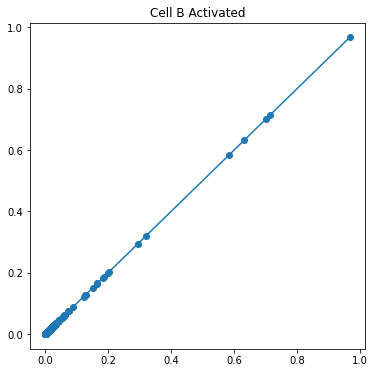

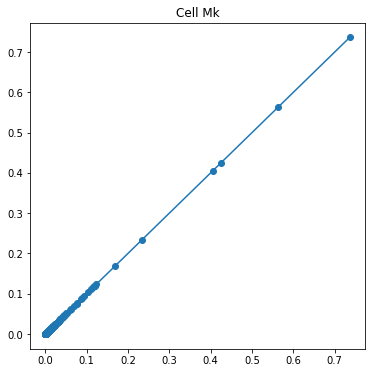

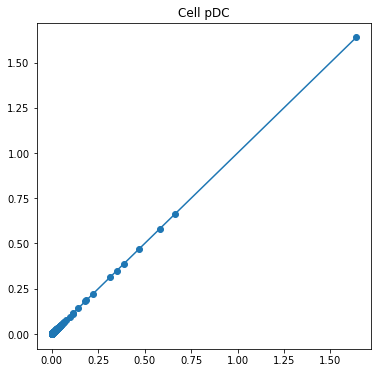

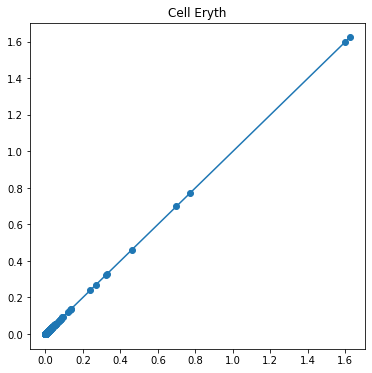

-------------------------------------------------------------------
10


Transforming to str index.


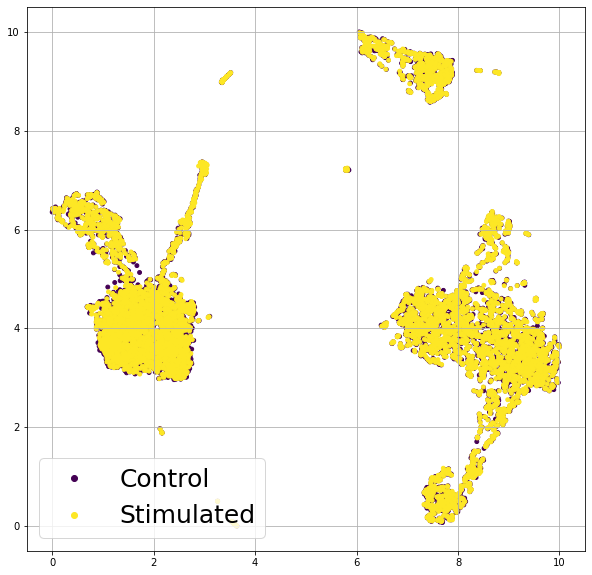

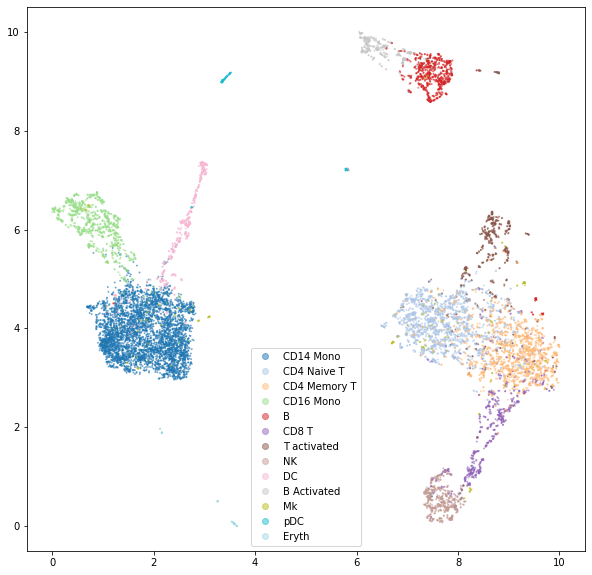

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13073/13096 [02:06<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


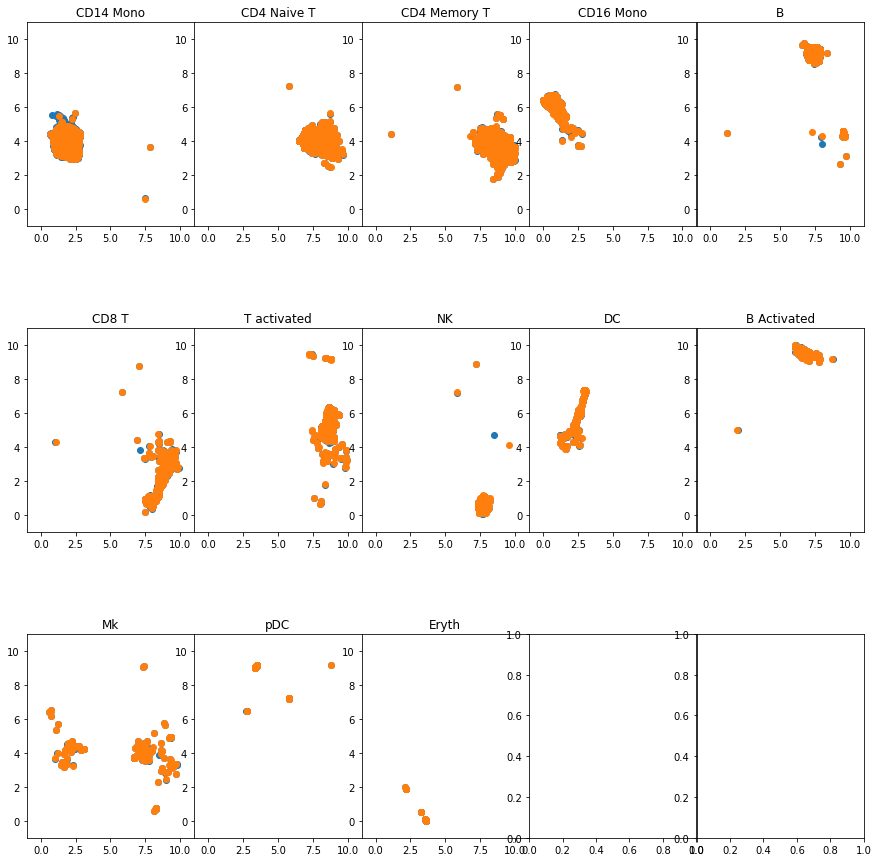

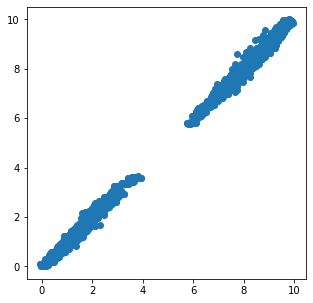

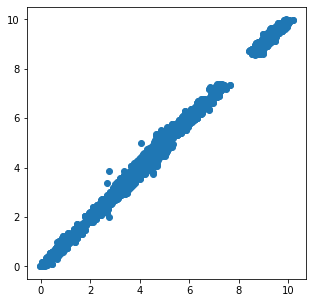

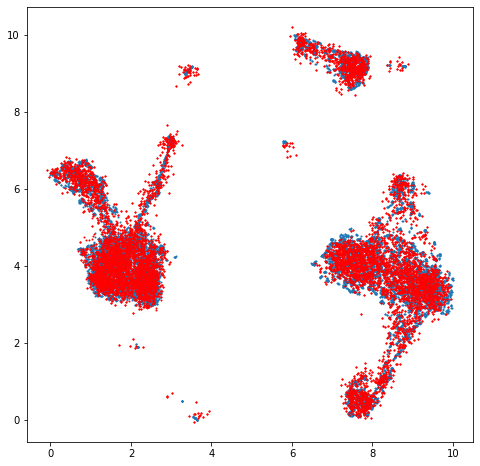

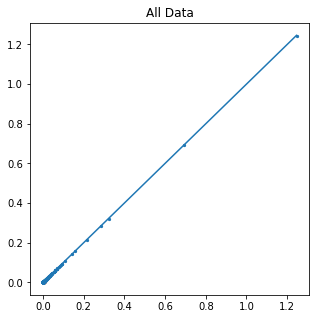

...

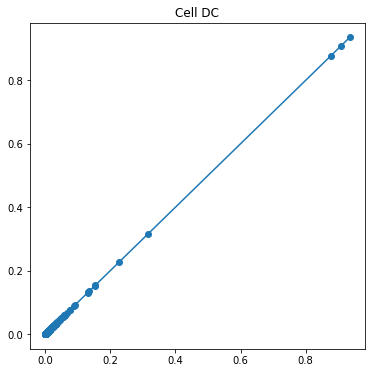

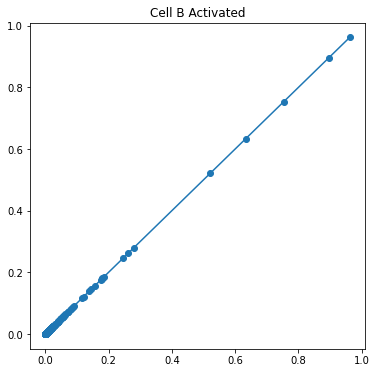

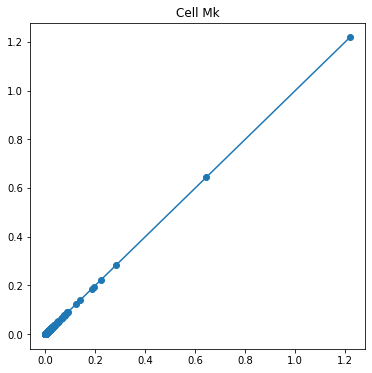

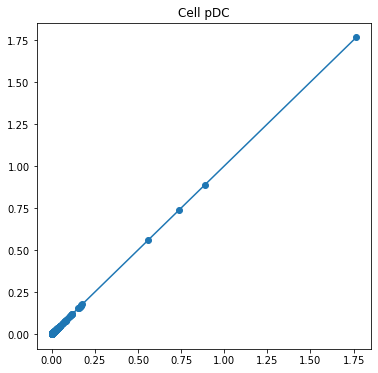

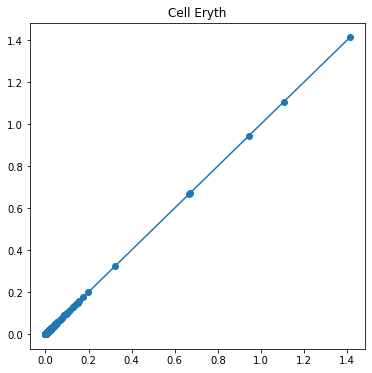

-------------------------------------------------------------------
15


Transforming to str index.


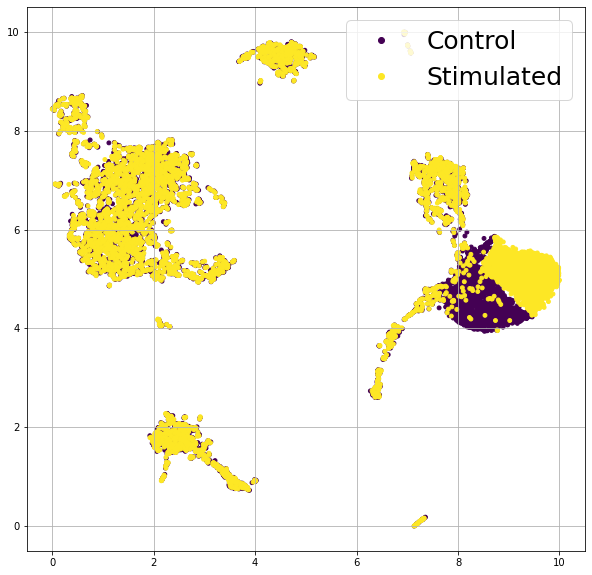

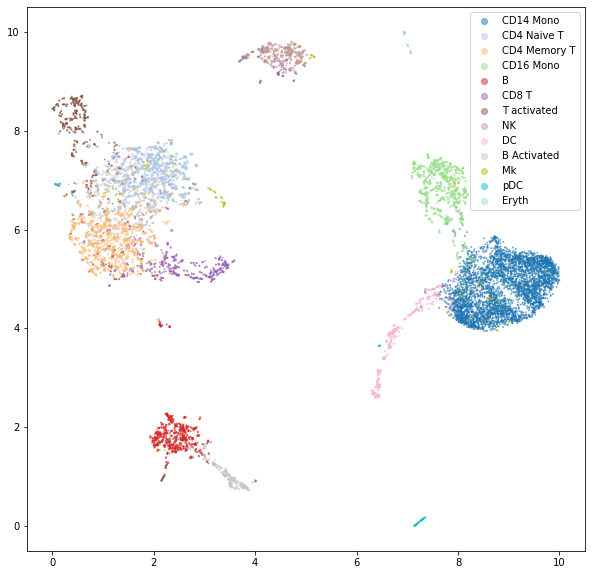

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13084/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


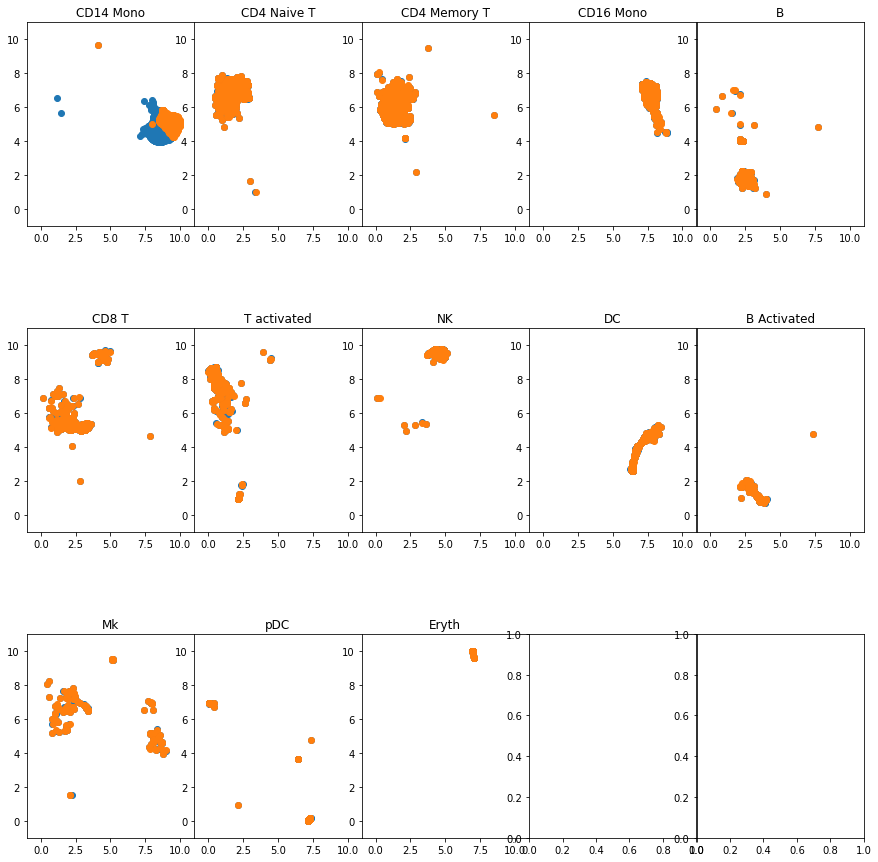

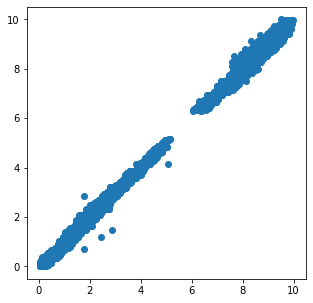

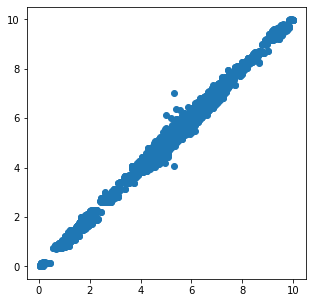

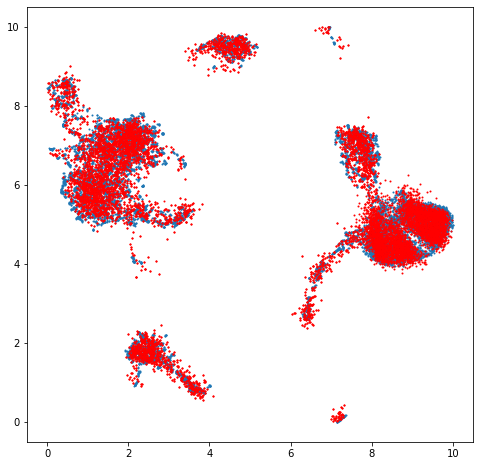

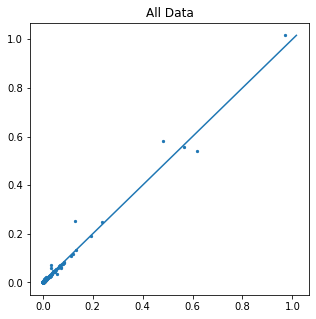

...

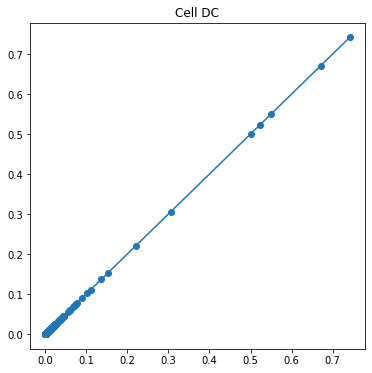

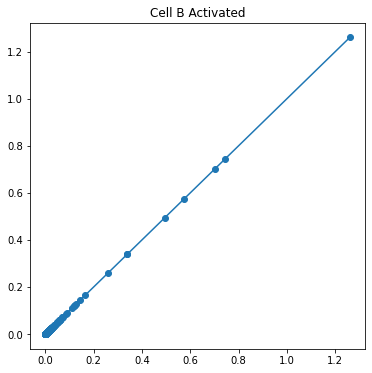

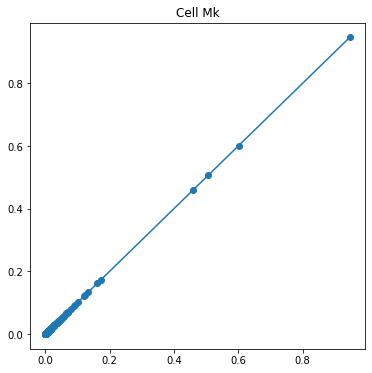

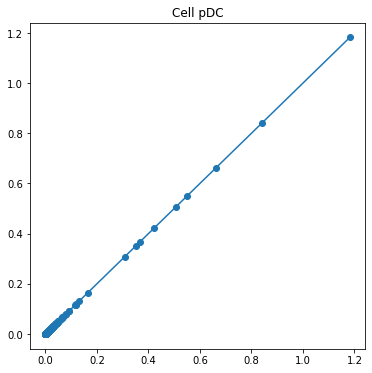

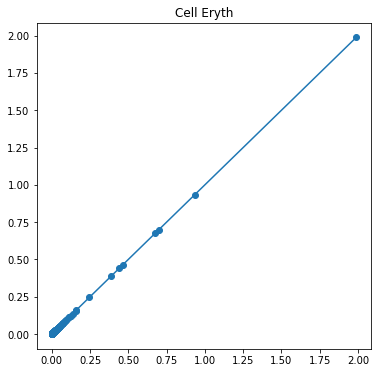

-------------------------------------------------------------------
20


Transforming to str index.


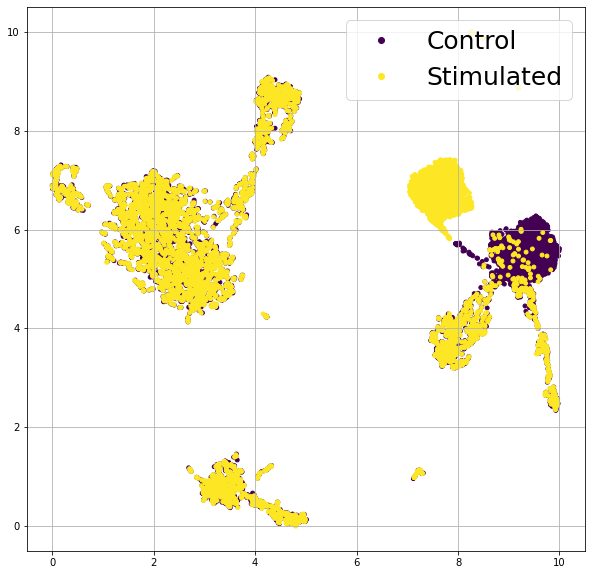

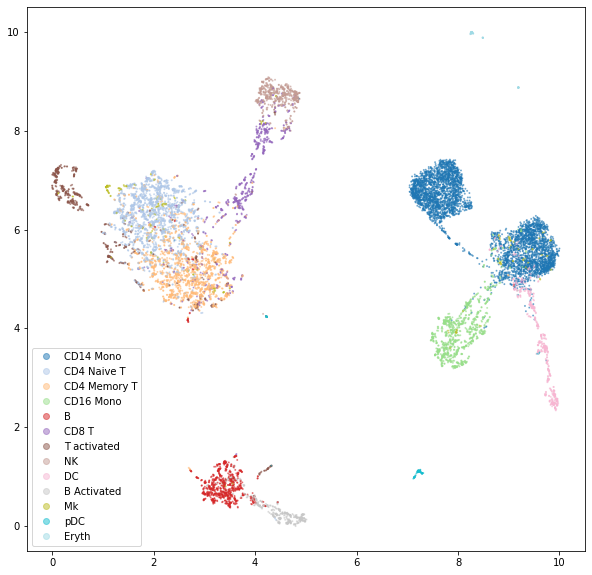

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13076/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


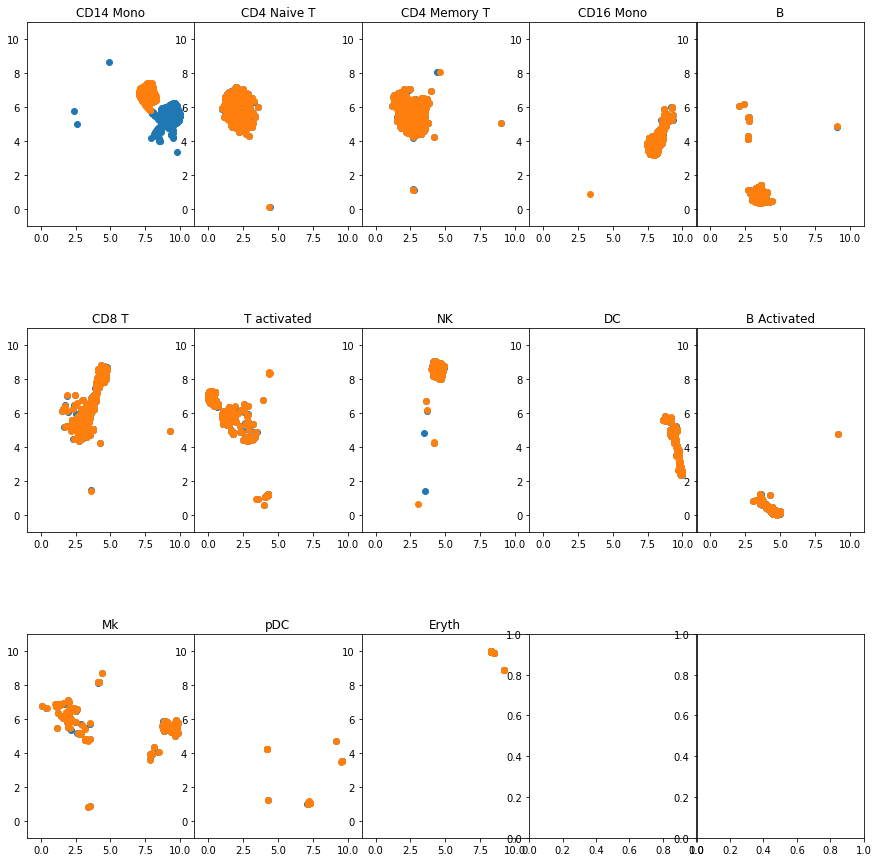

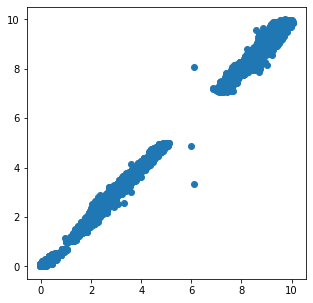

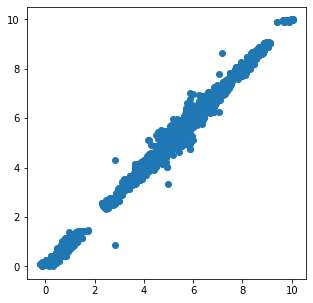

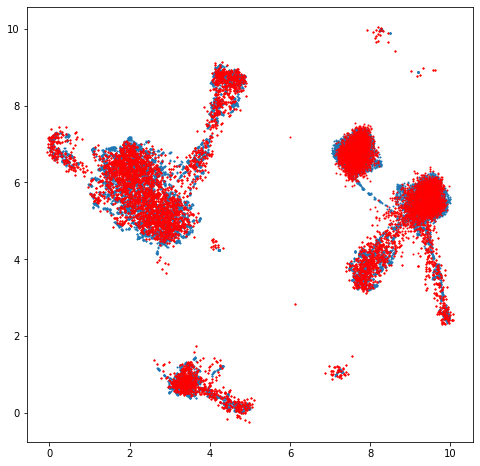

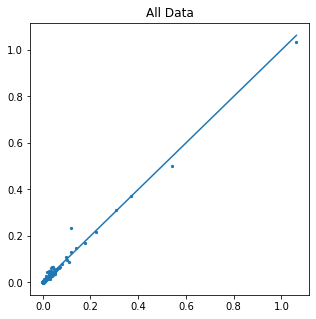

...

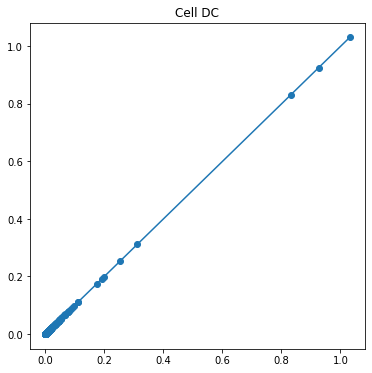

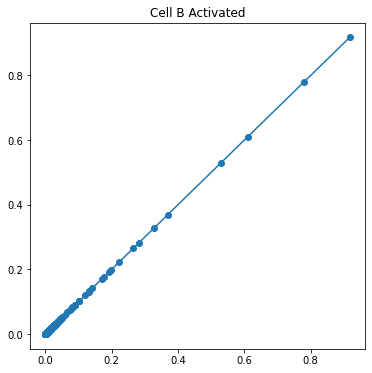

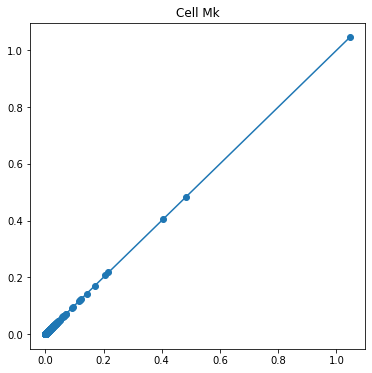

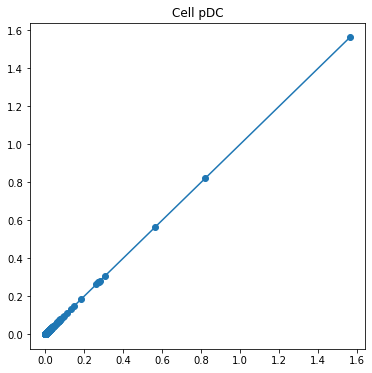

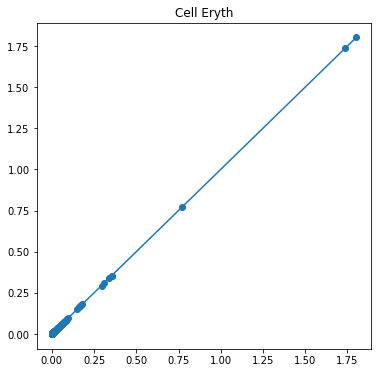

-------------------------------------------------------------------
25


Transforming to str index.


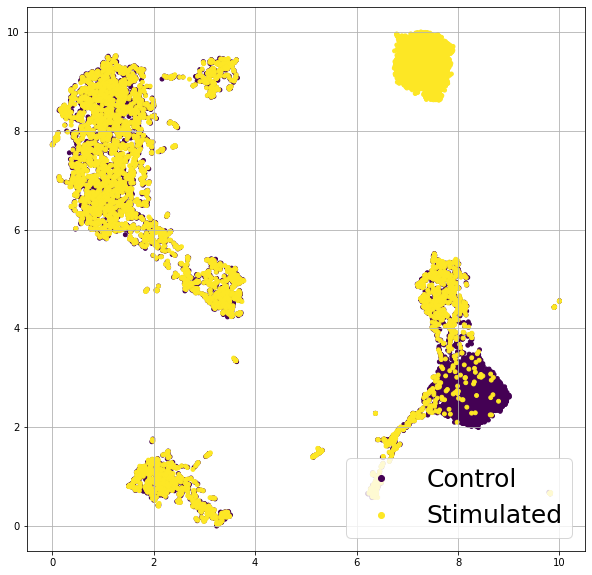

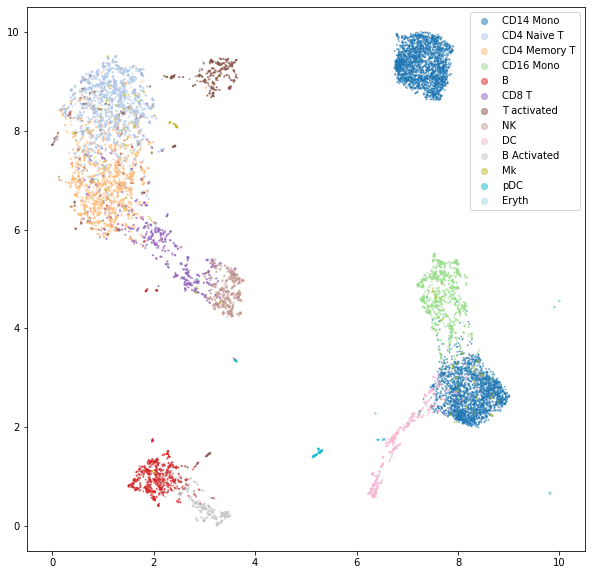

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13025/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


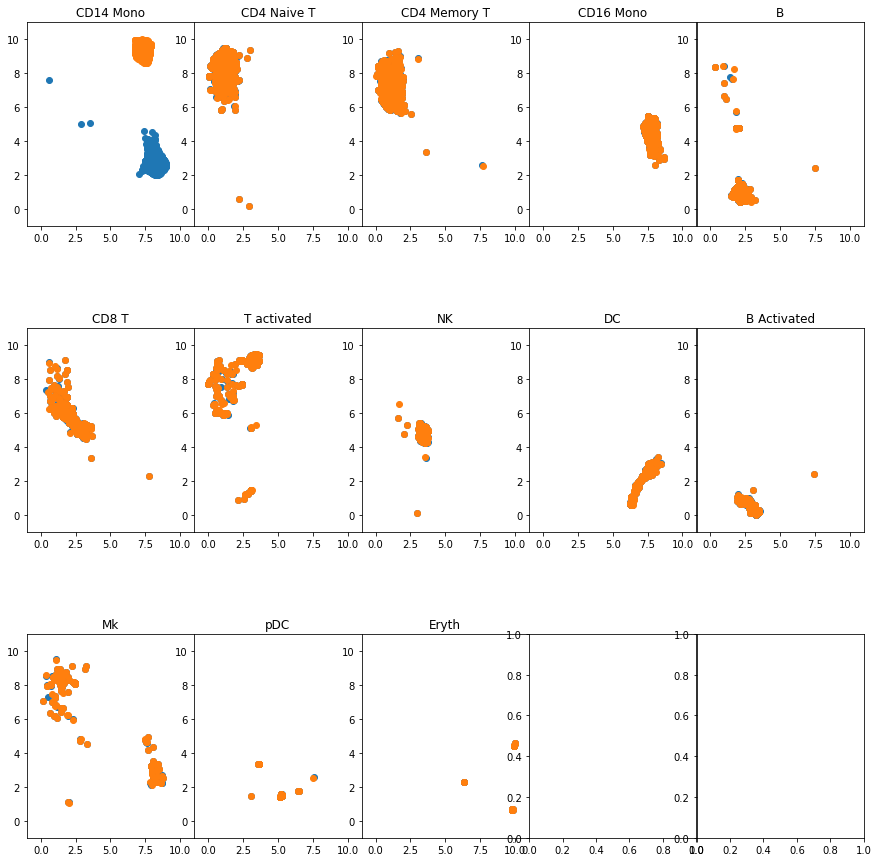

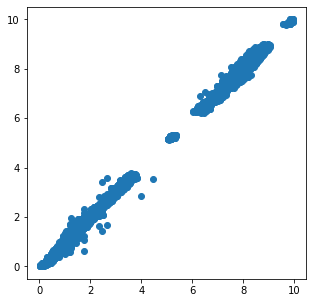

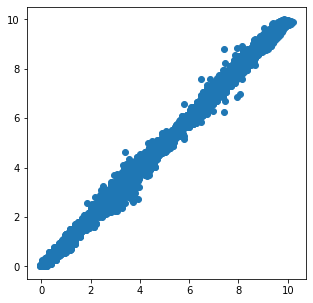

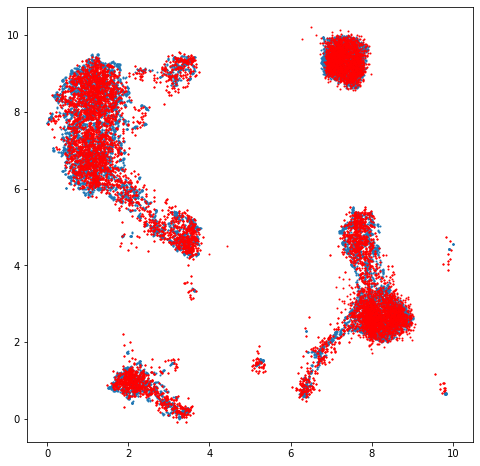

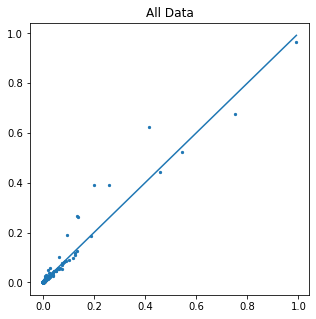

...

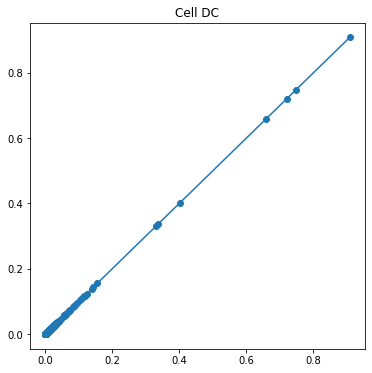

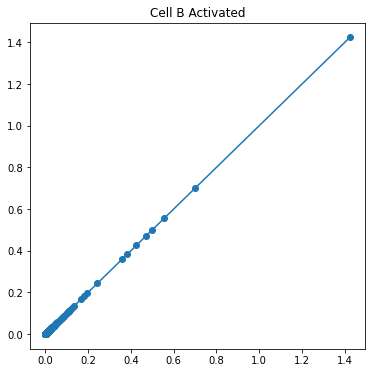

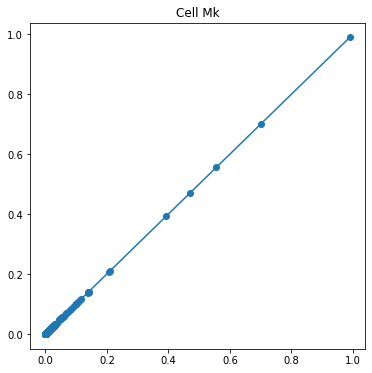

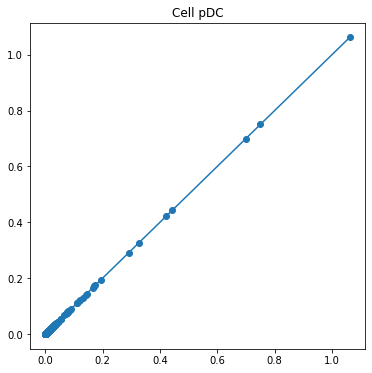

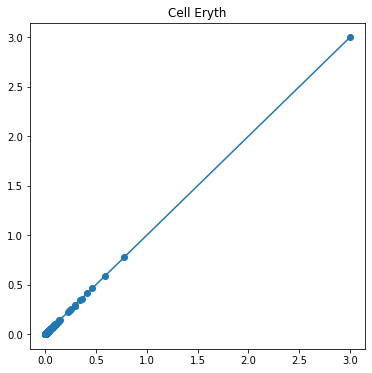

-------------------------------------------------------------------
30


Transforming to str index.


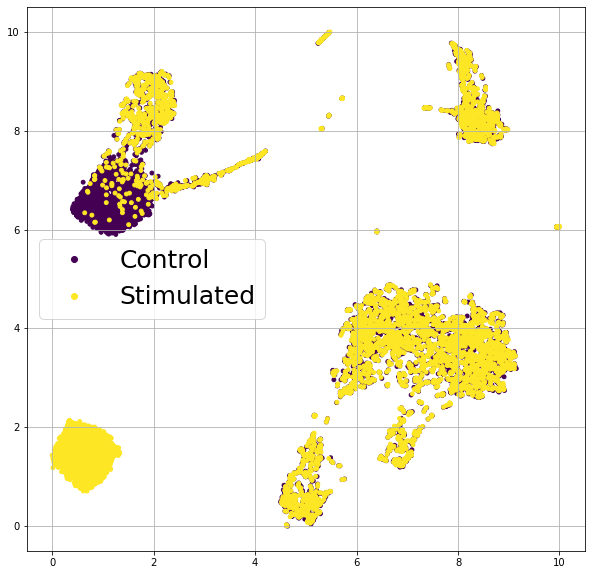

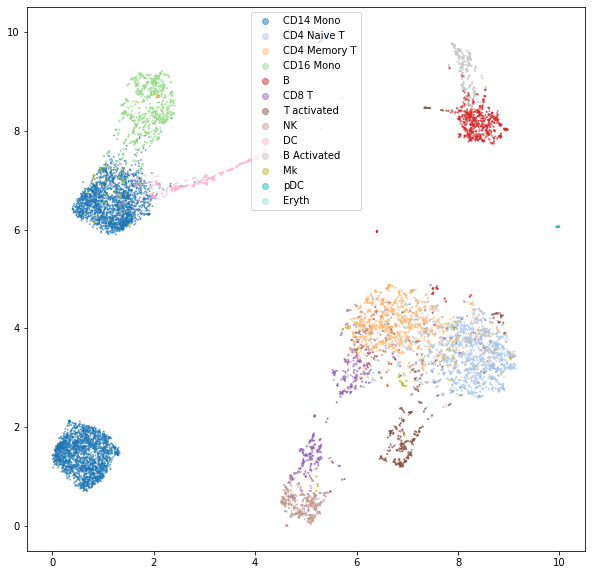

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13037/13096 [02:10<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


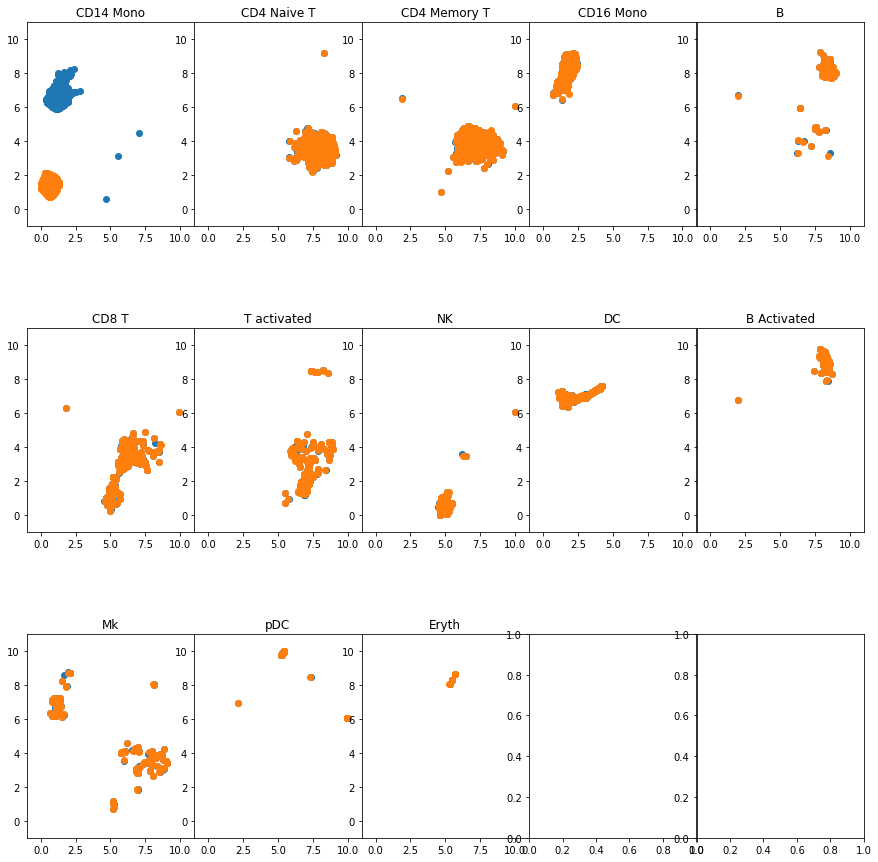

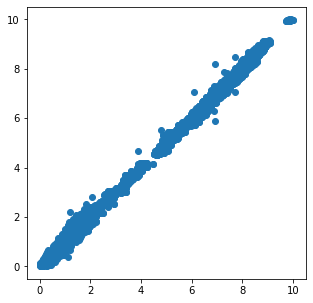

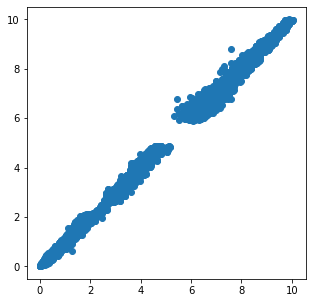

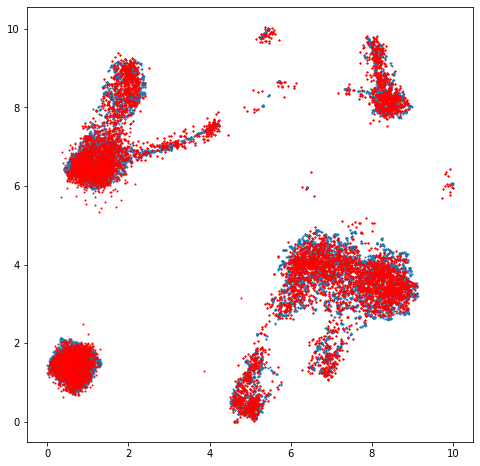

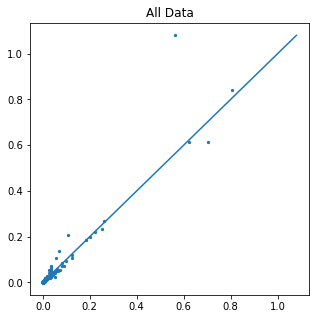

...

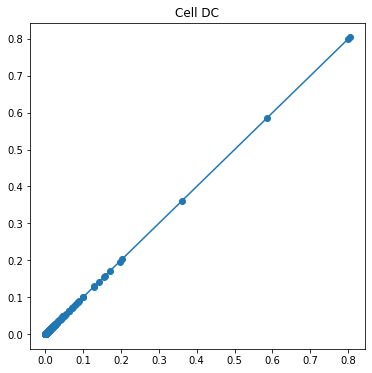

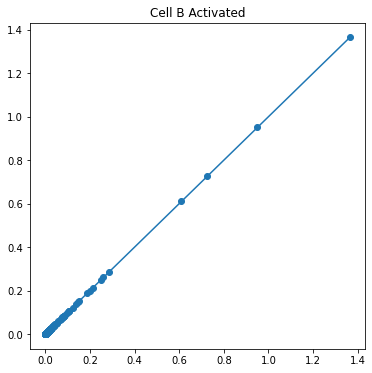

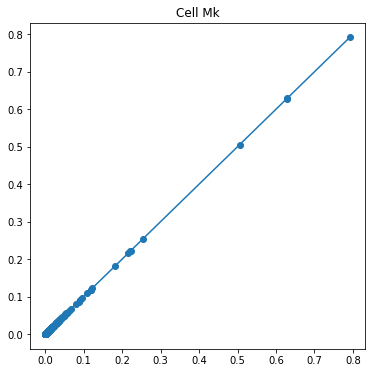

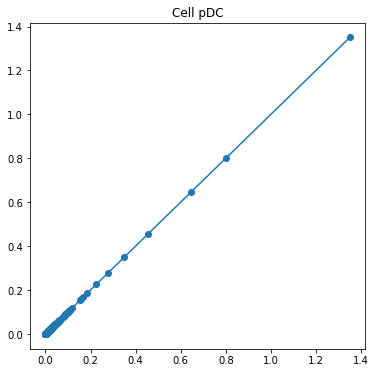

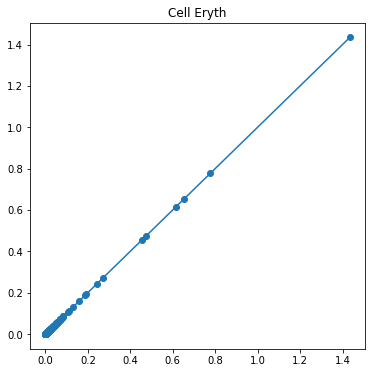

-------------------------------------------------------------------
35


Transforming to str index.


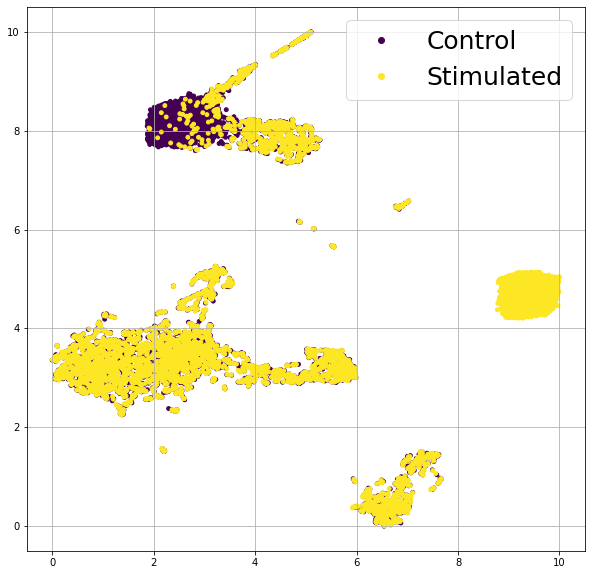

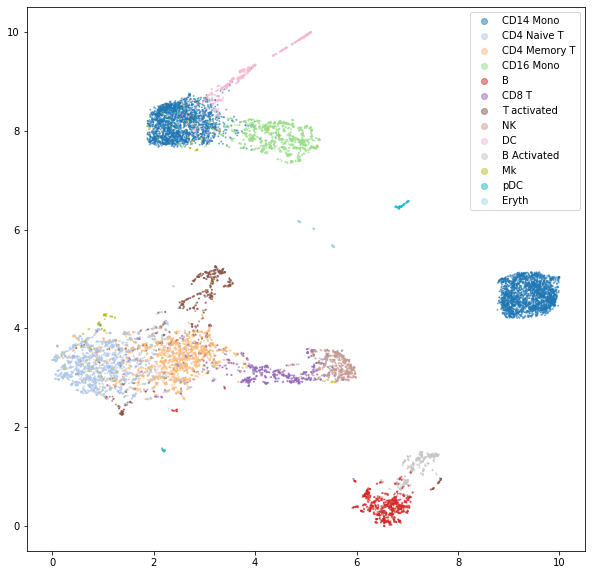

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13024/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


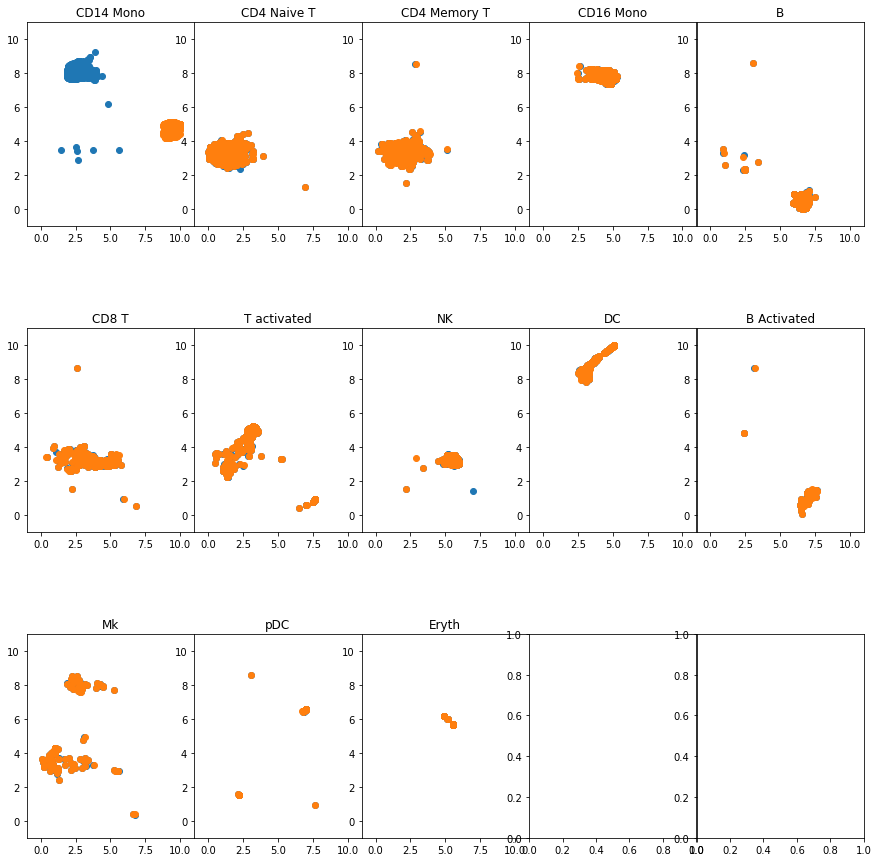

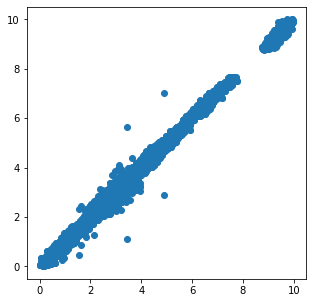

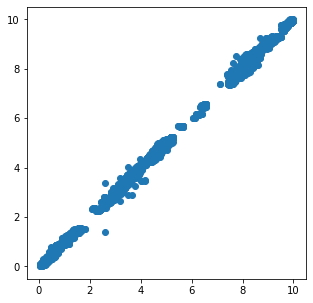

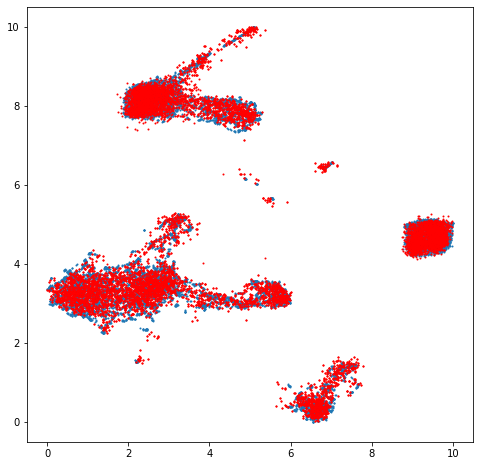

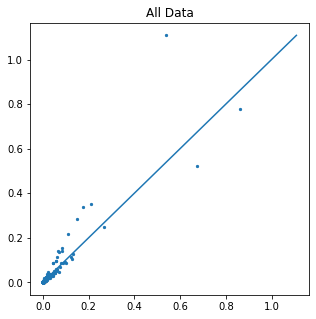

...

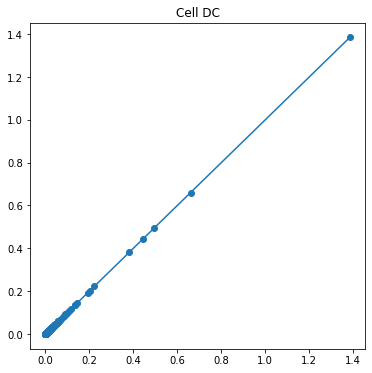

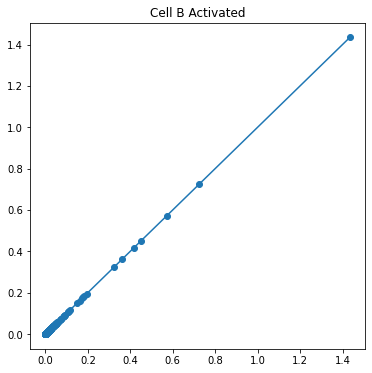

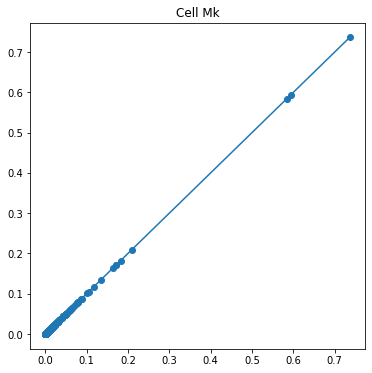

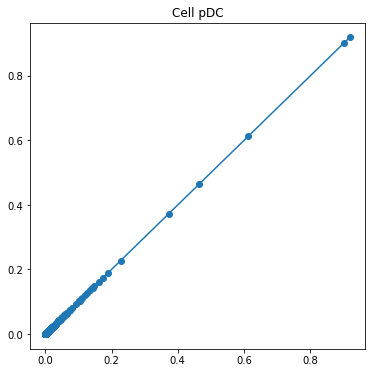

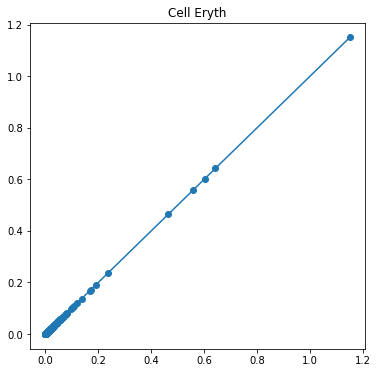

-------------------------------------------------------------------
40


Transforming to str index.


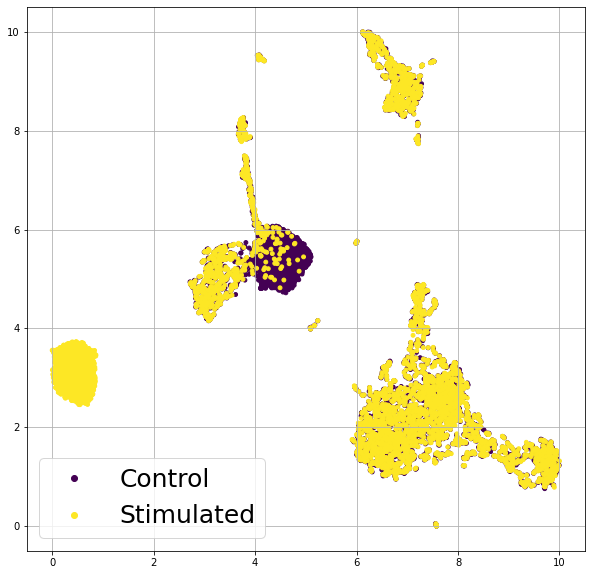

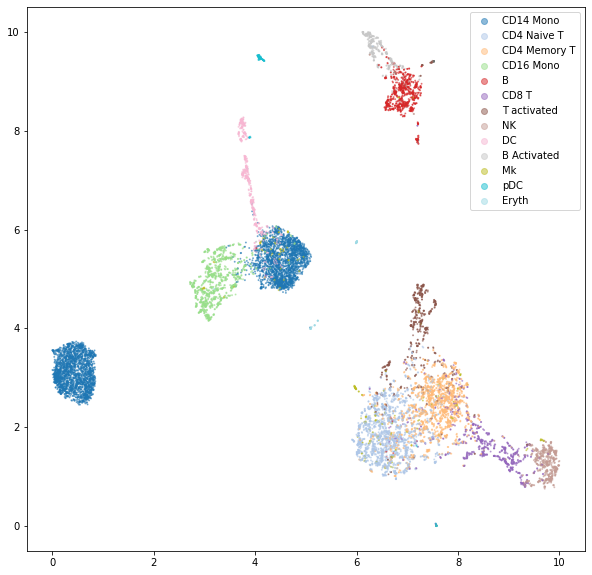

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13084/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


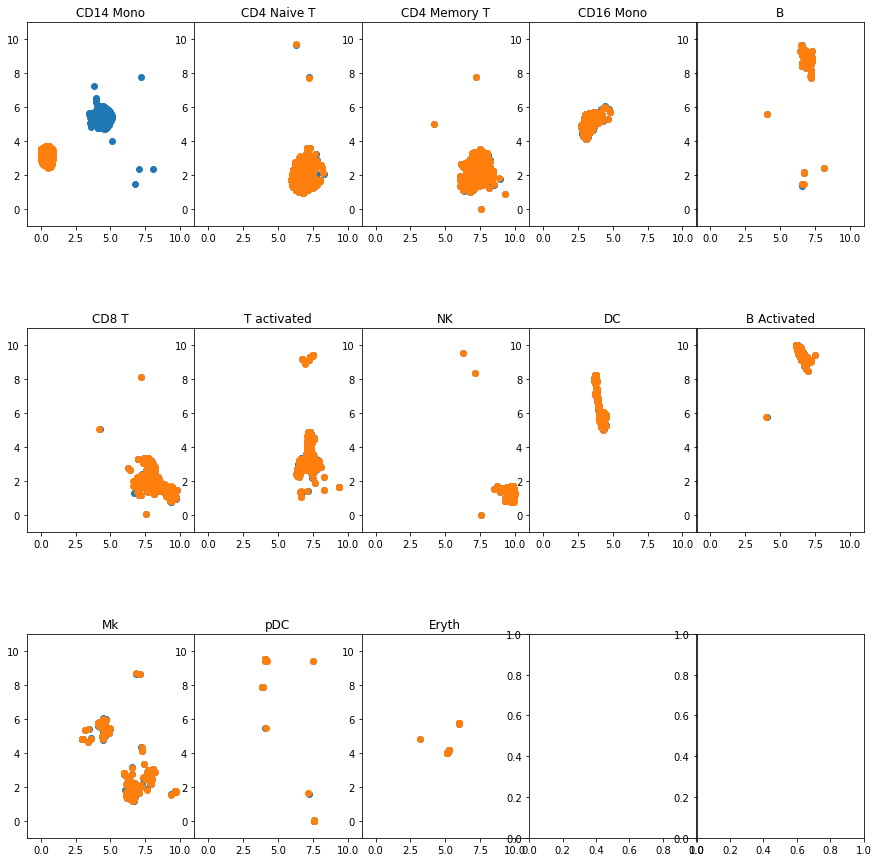

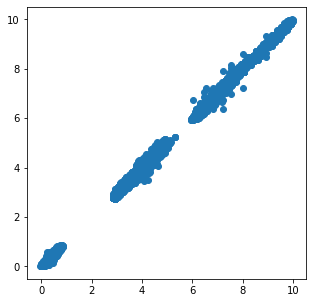

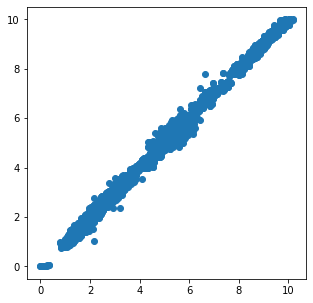

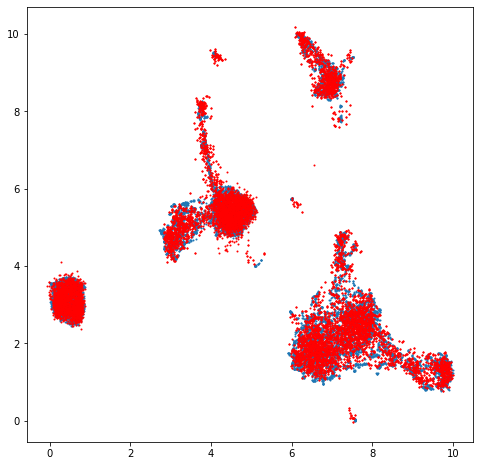

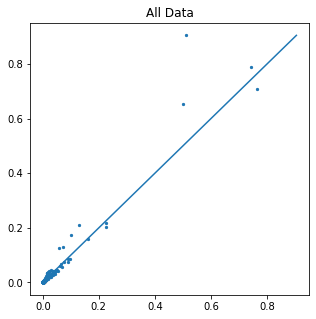

...

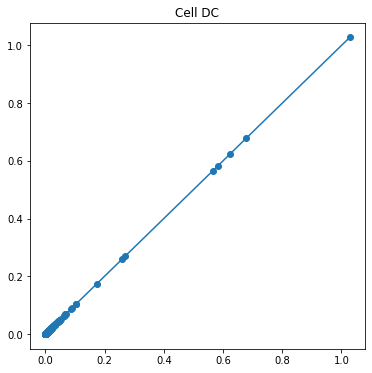

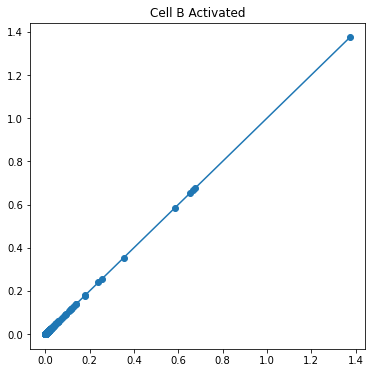

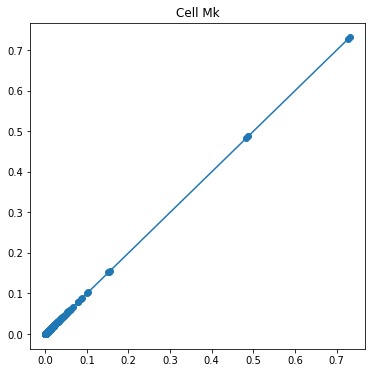

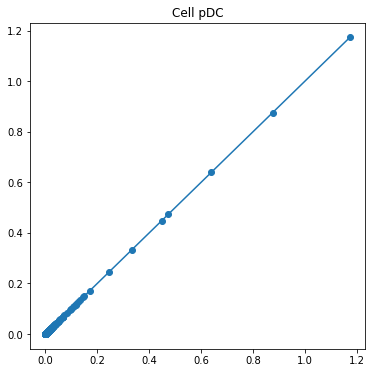

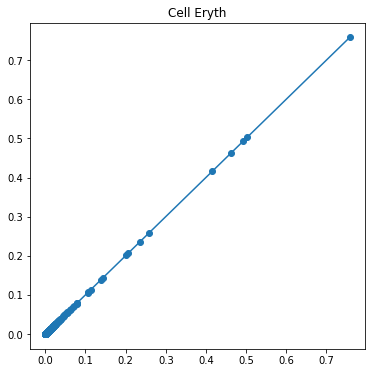

-------------------------------------------------------------------
45


Transforming to str index.


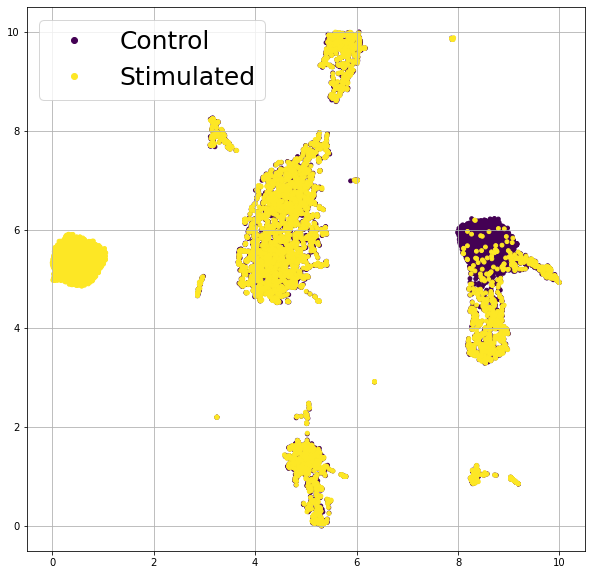

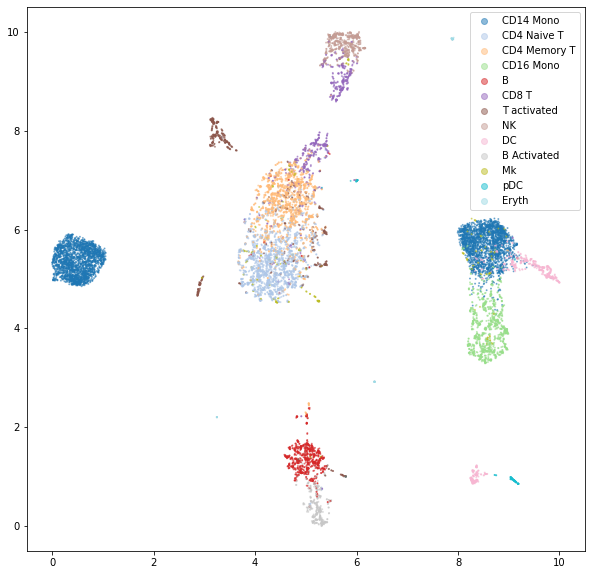

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13071/13096 [02:06<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


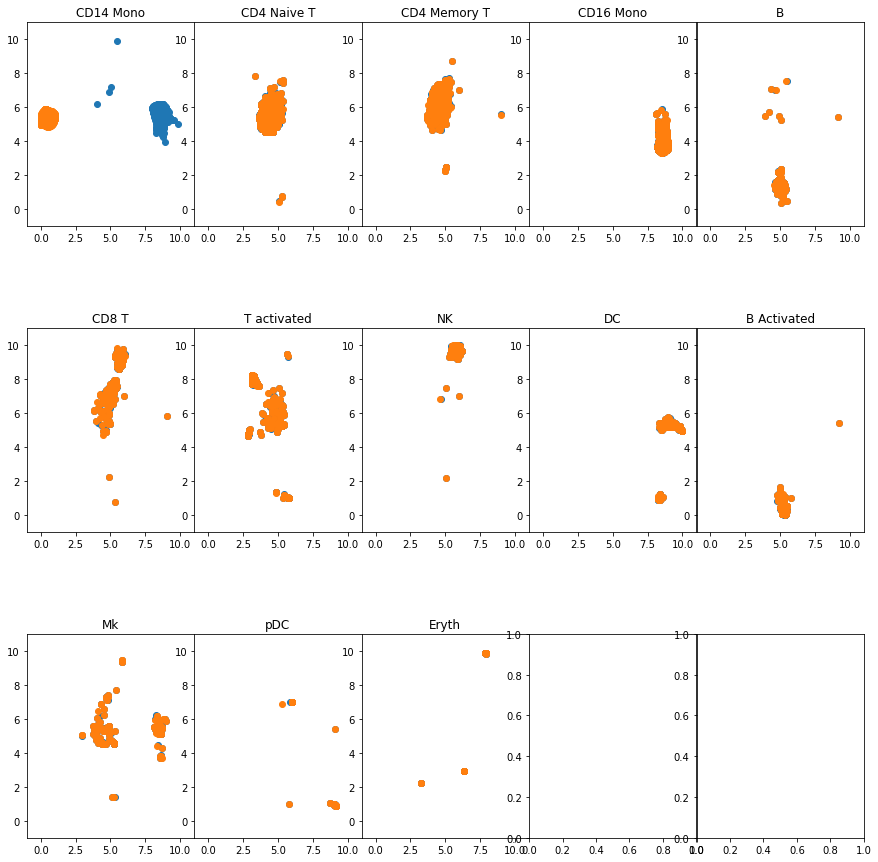

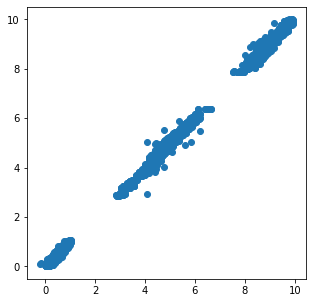

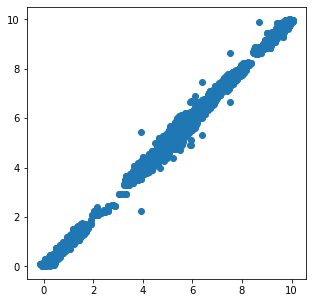

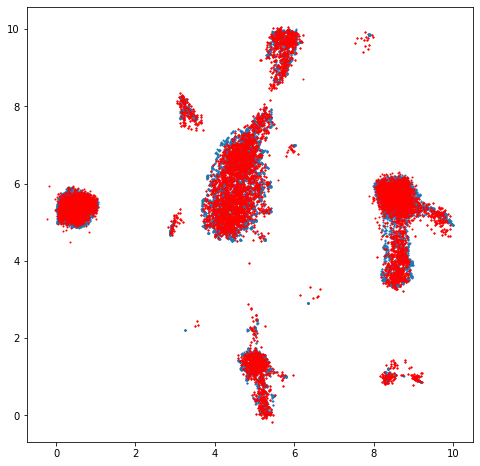

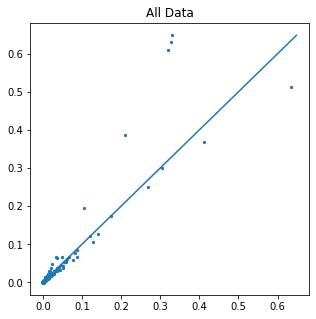

...

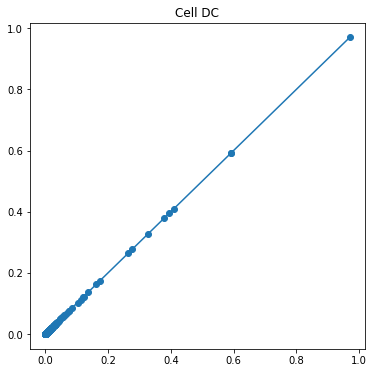

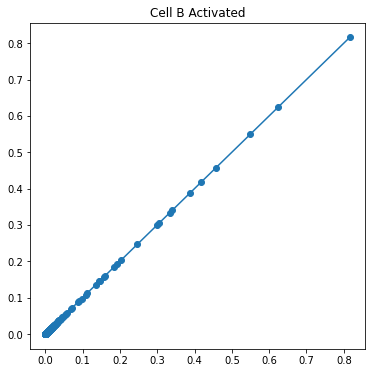

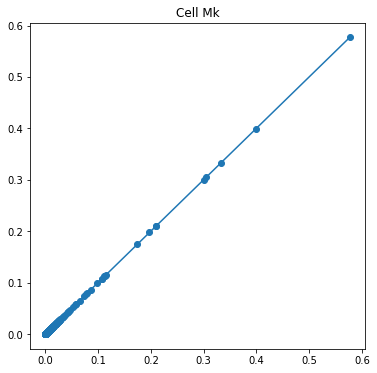

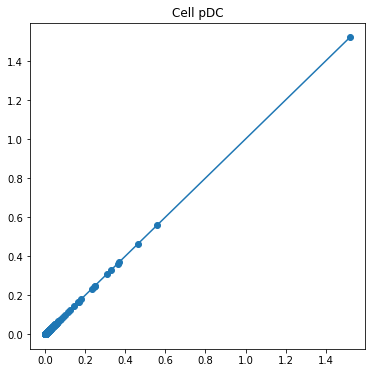

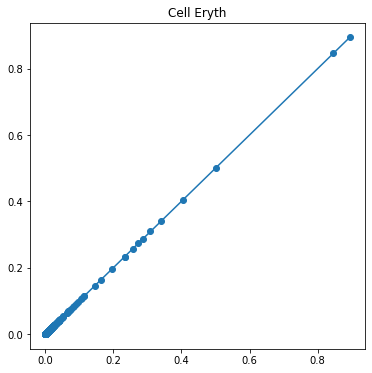

-------------------------------------------------------------------
50


Transforming to str index.


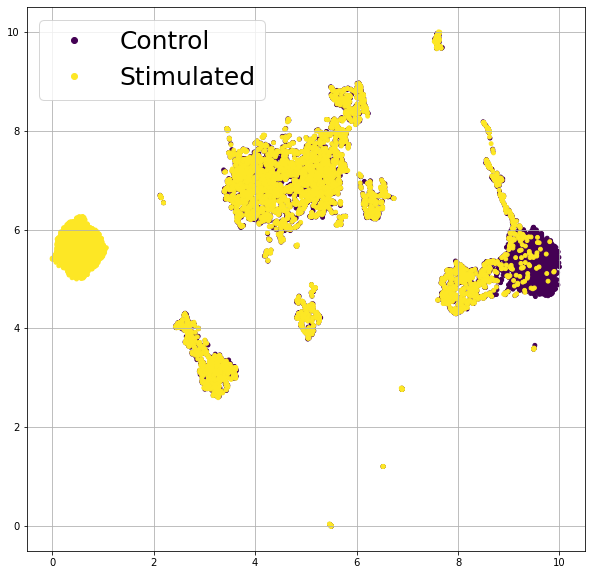

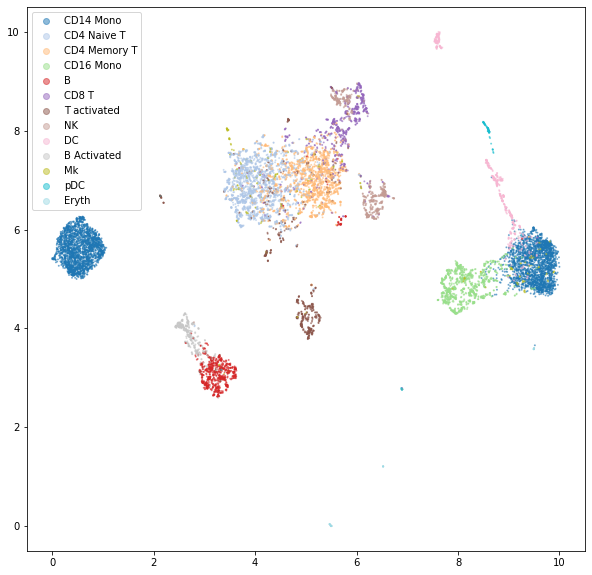

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13072/13096 [02:06<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


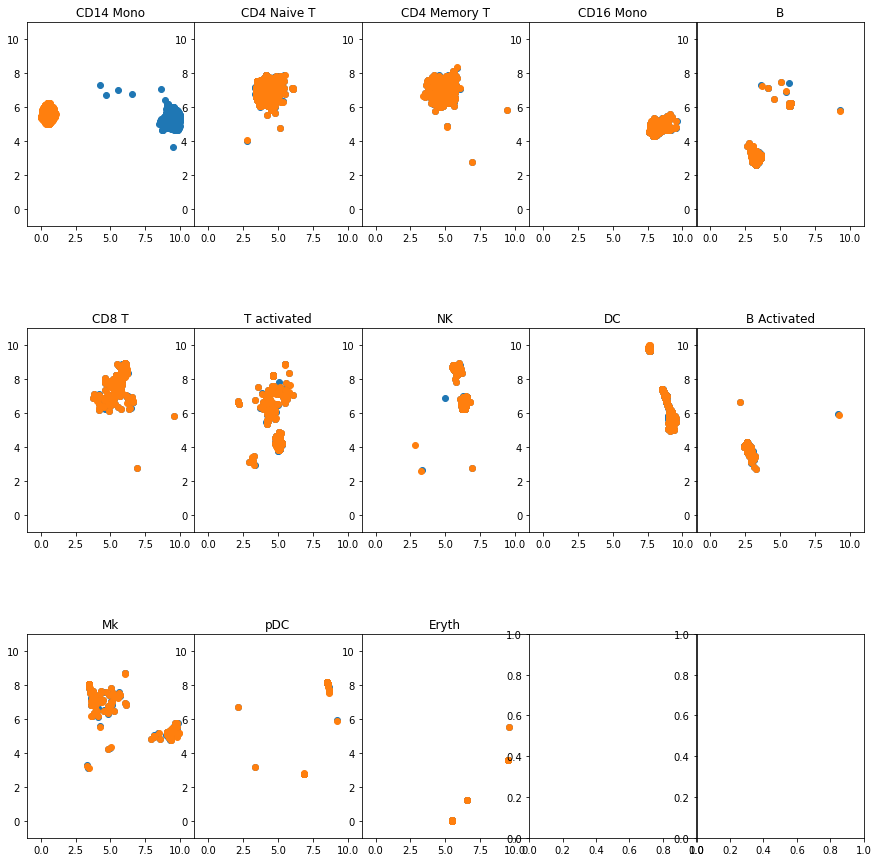

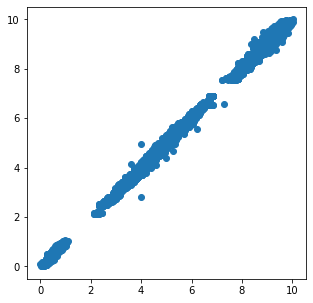

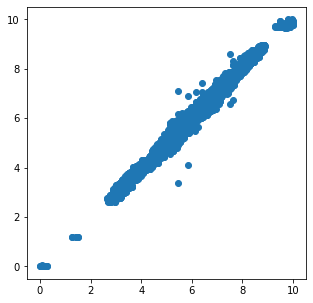

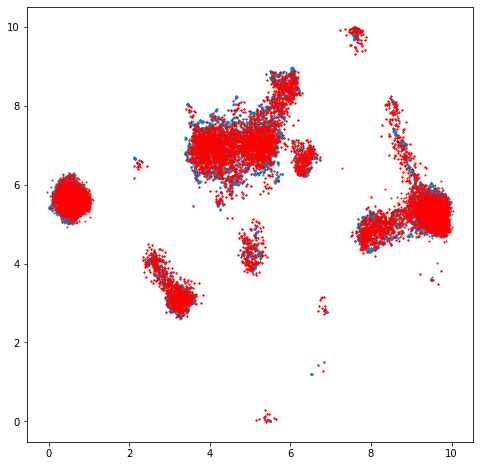

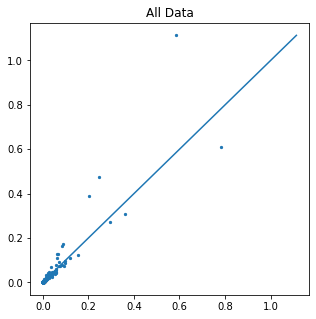

...

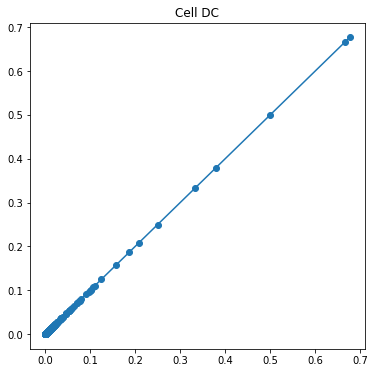

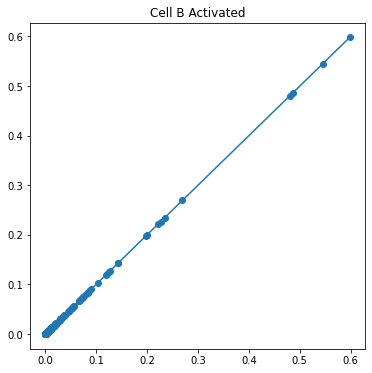

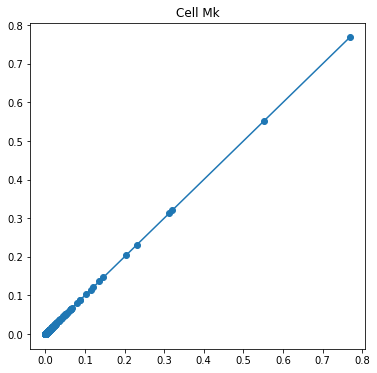

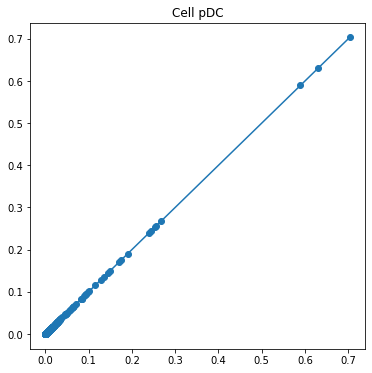

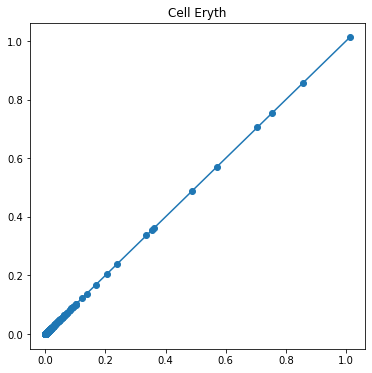

-------------------------------------------------------------------


is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


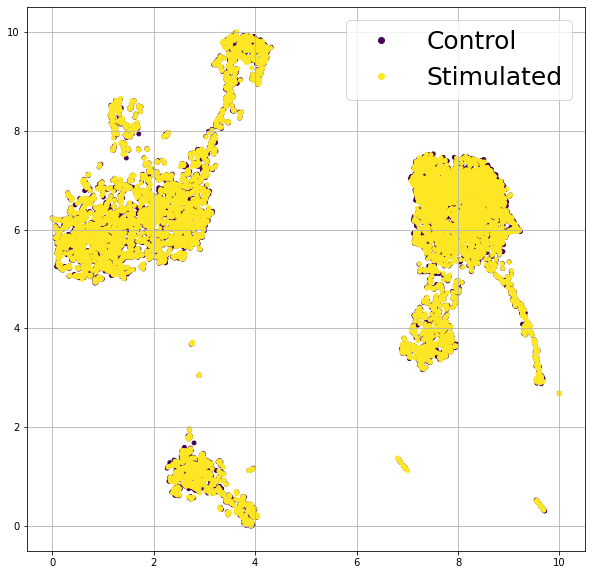

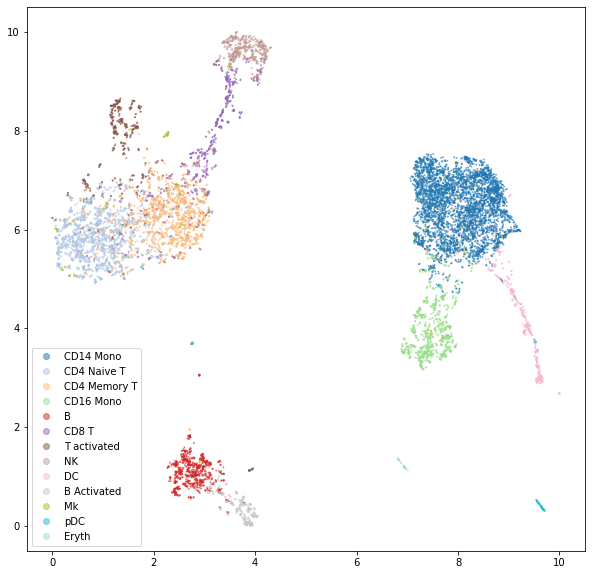

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13094/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


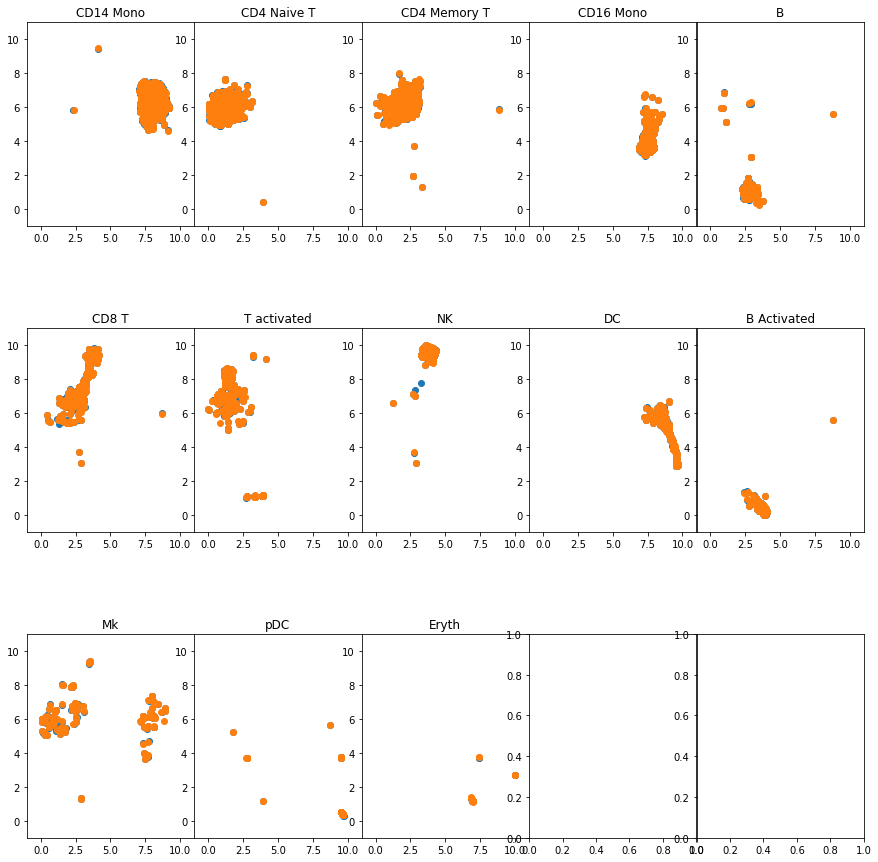

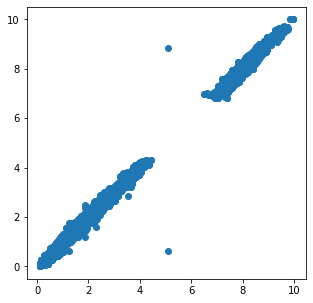

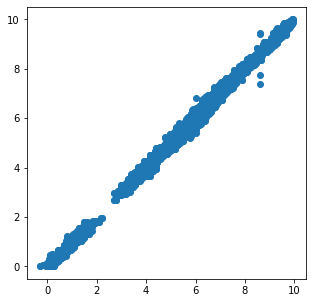

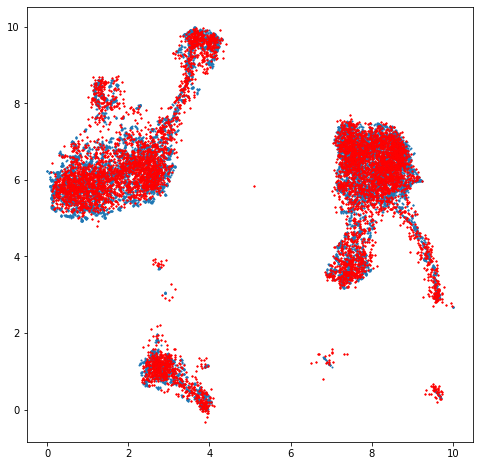

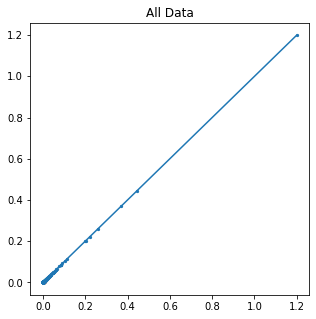

...

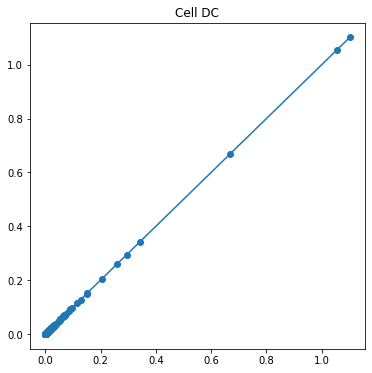

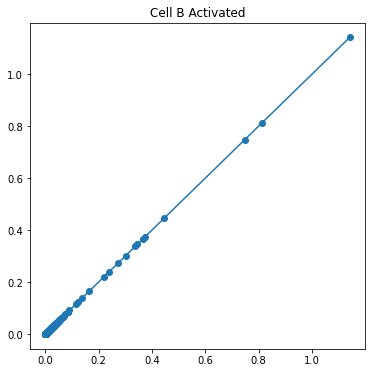

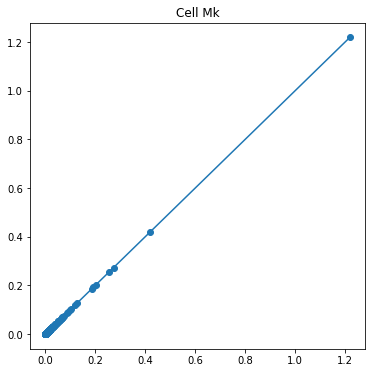

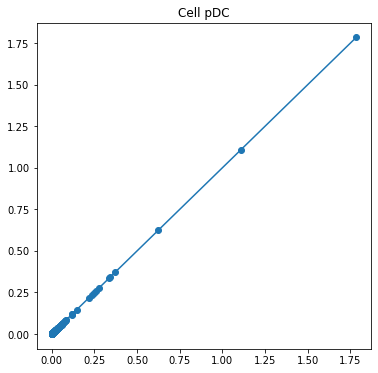

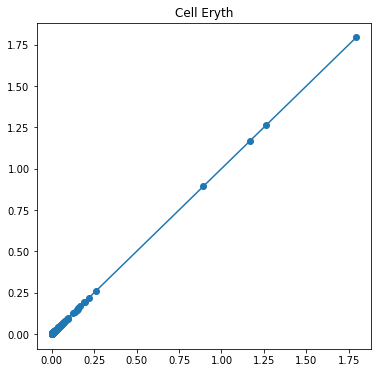

-------------------------------------------------------------------
5


Transforming to str index.


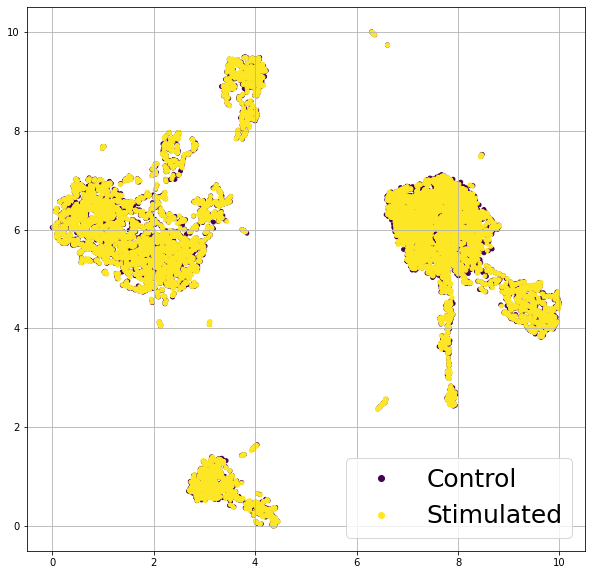

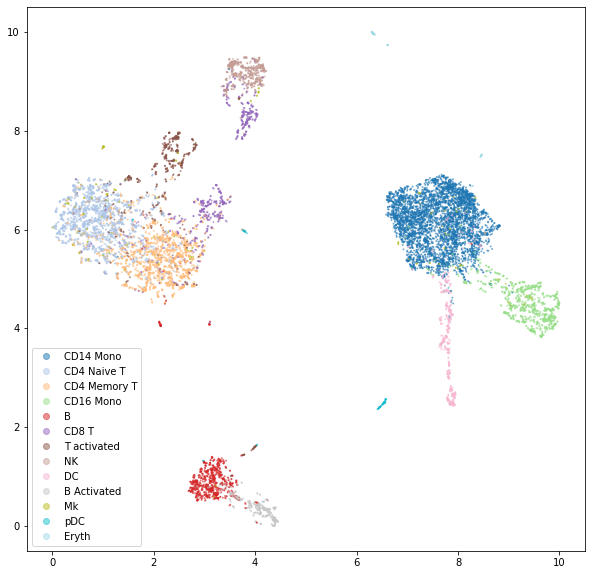

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13062/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


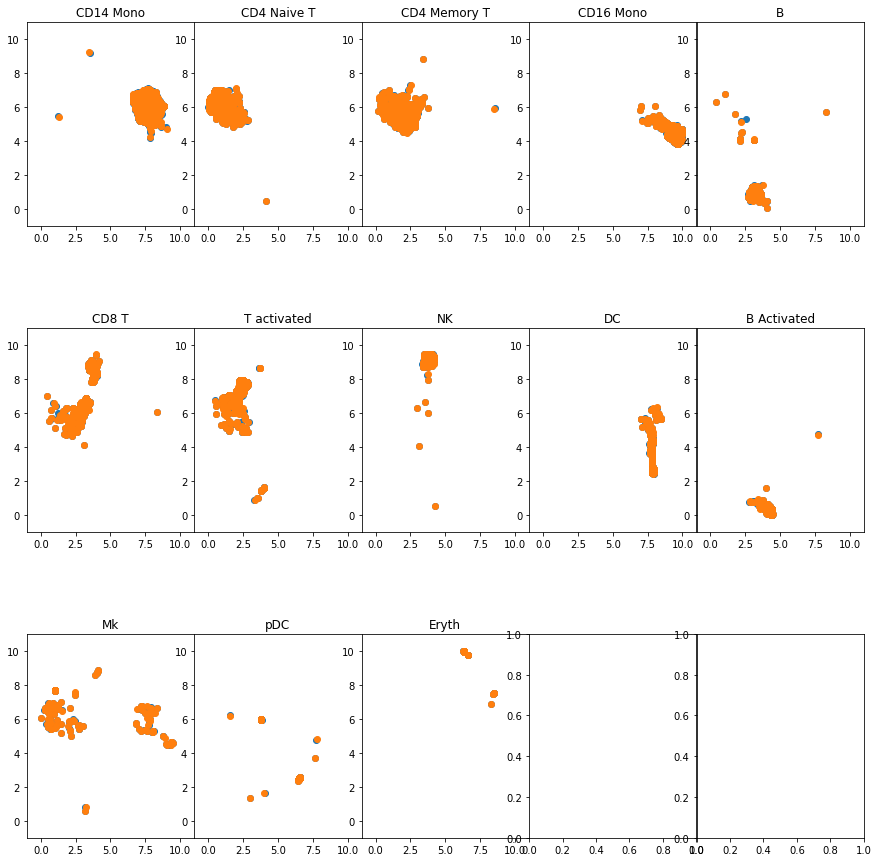

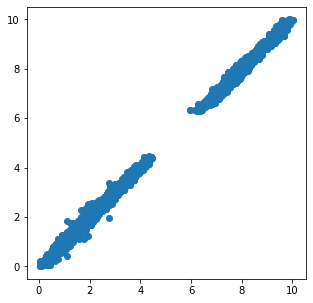

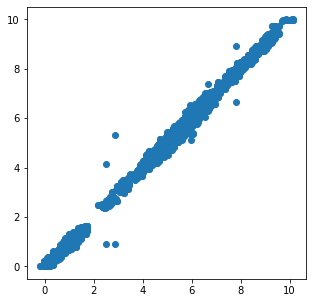

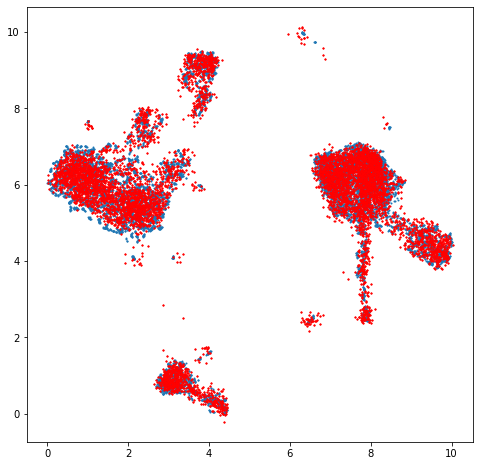

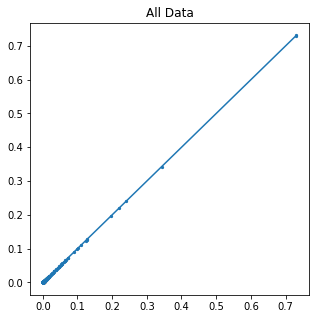

...

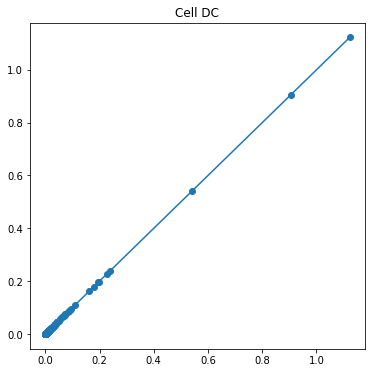

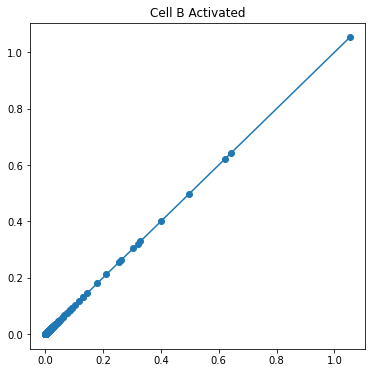

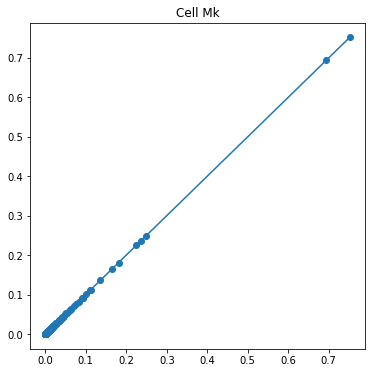

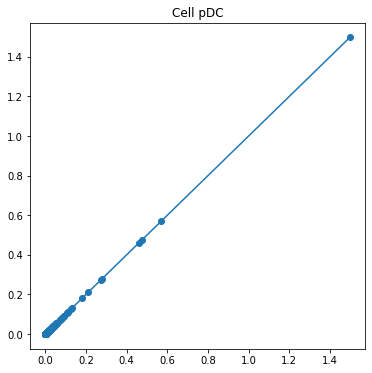

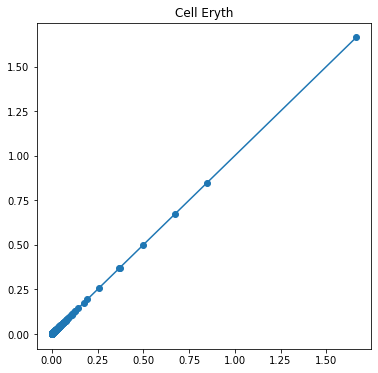

-------------------------------------------------------------------
10


Transforming to str index.


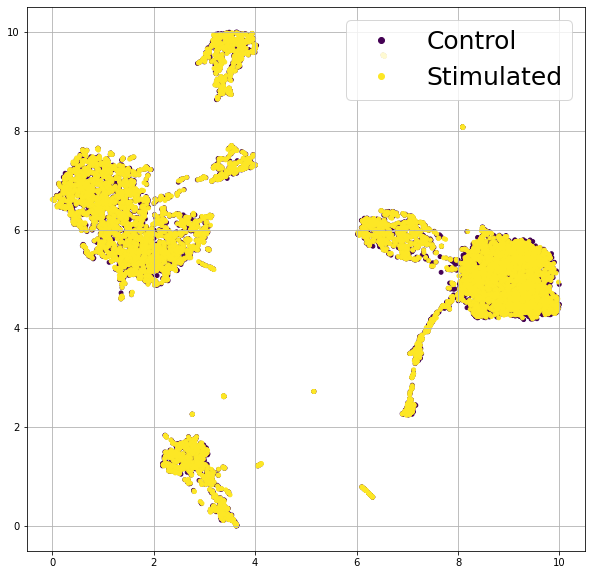

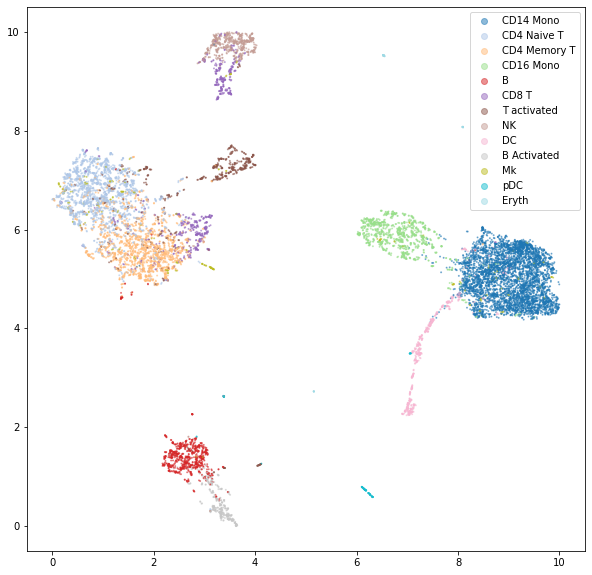

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13095/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


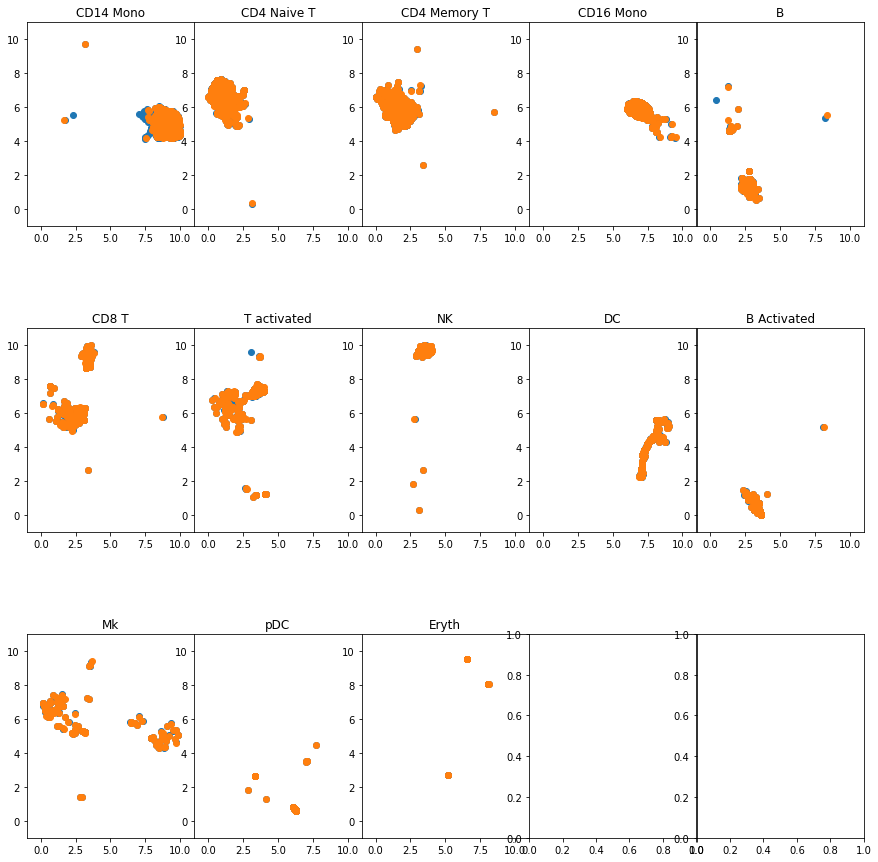

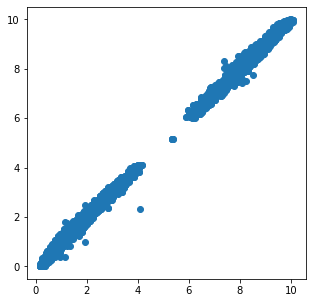

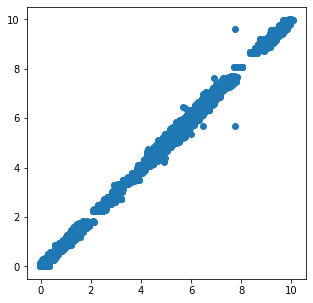

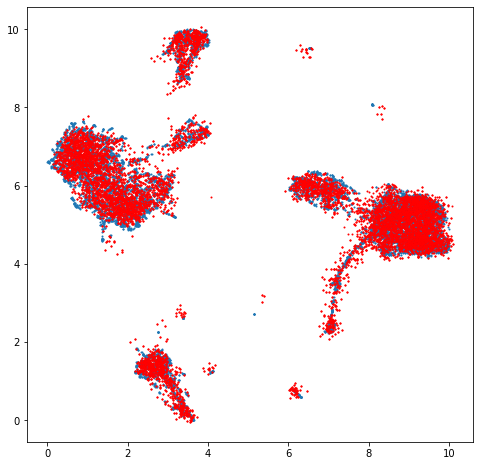

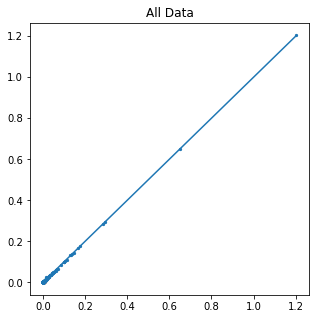

...

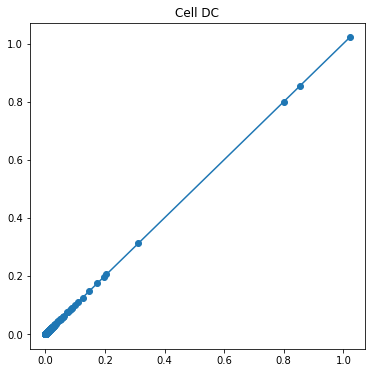

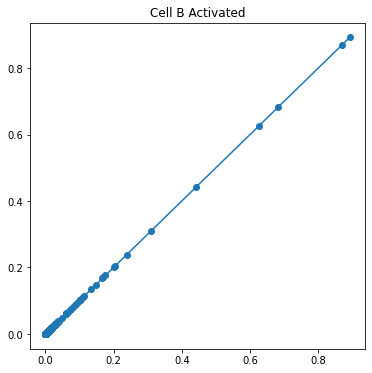

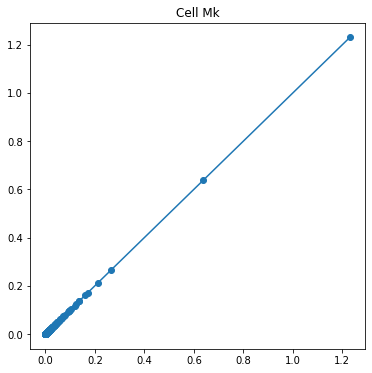

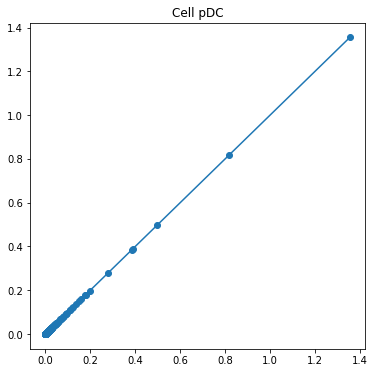

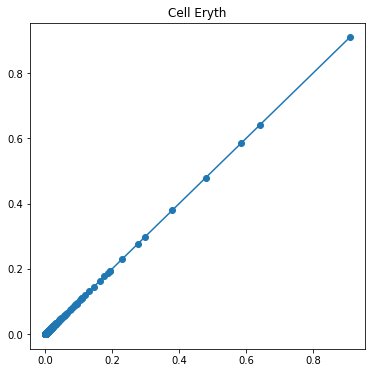

-------------------------------------------------------------------
15


Transforming to str index.


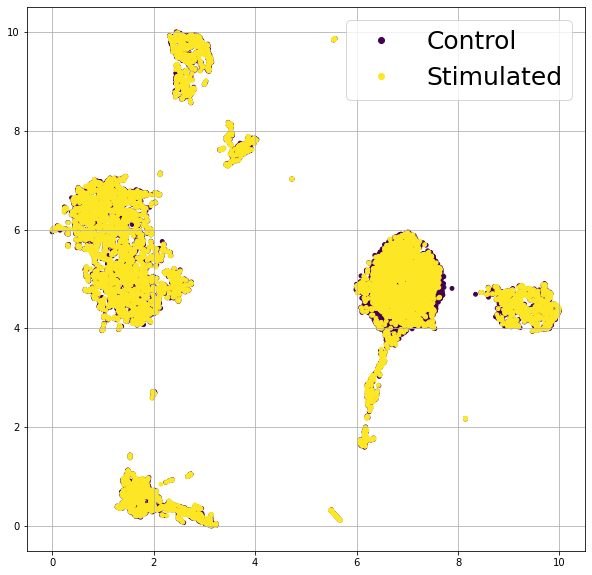

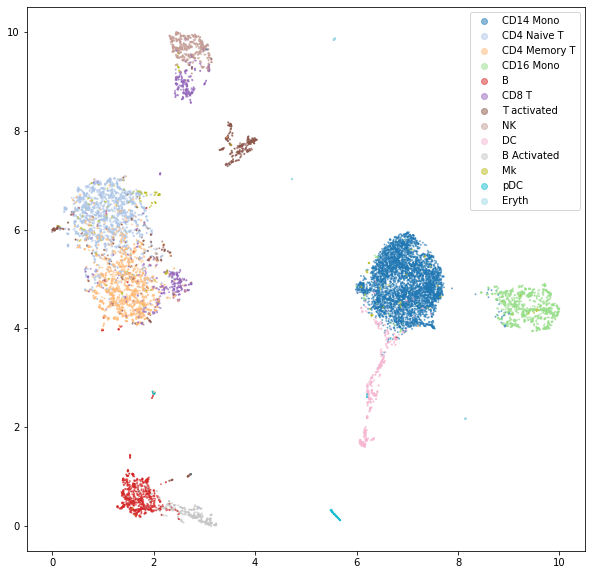

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13090/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


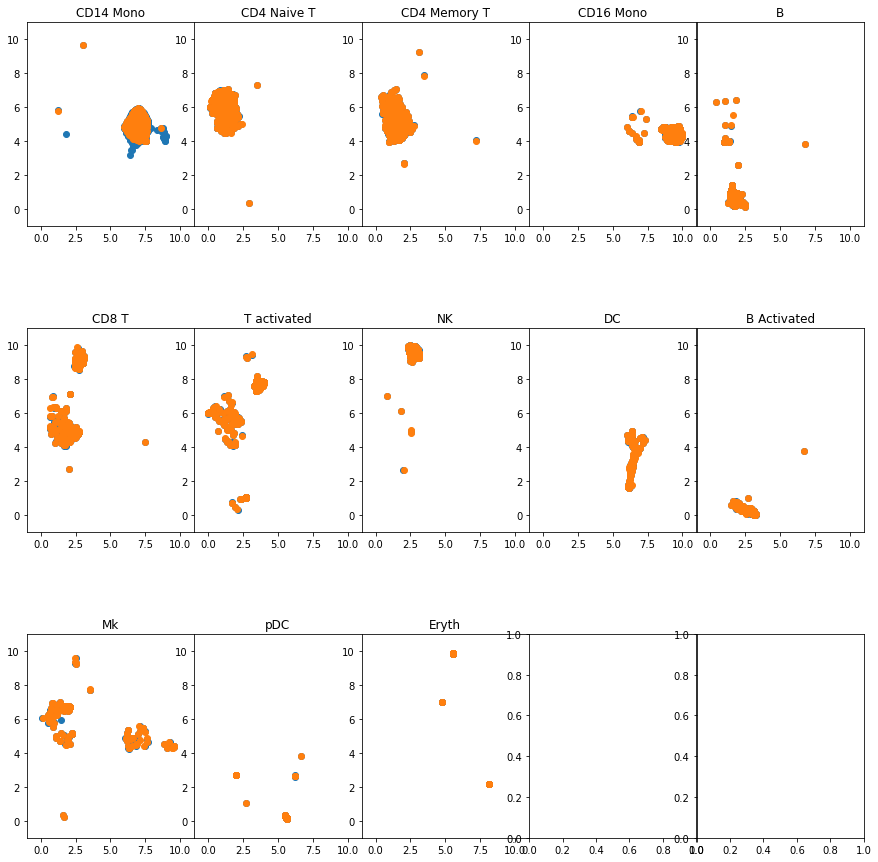

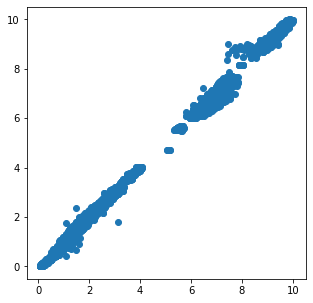

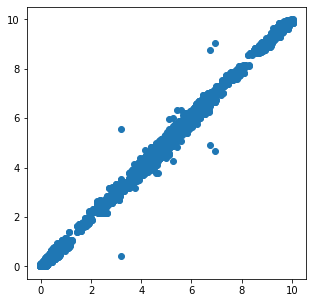

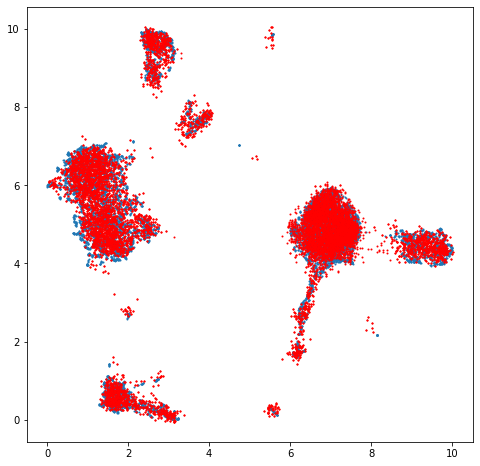

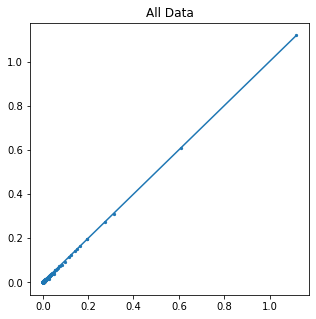

...

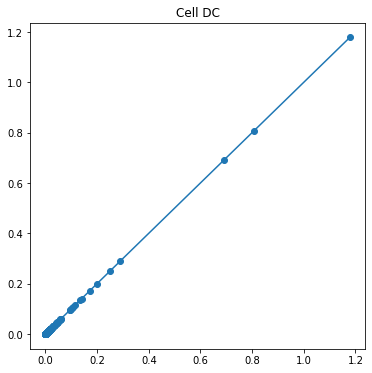

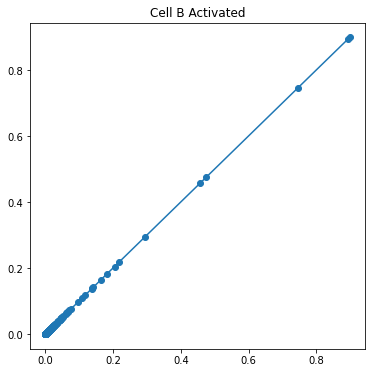

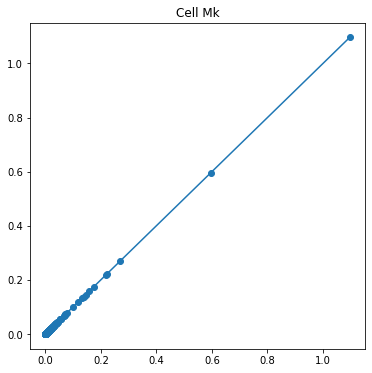

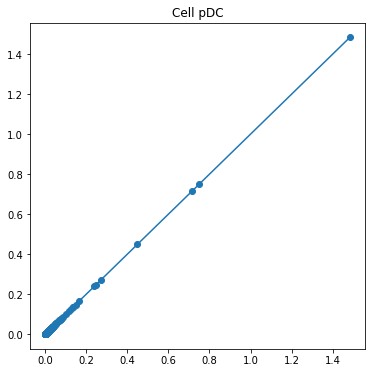

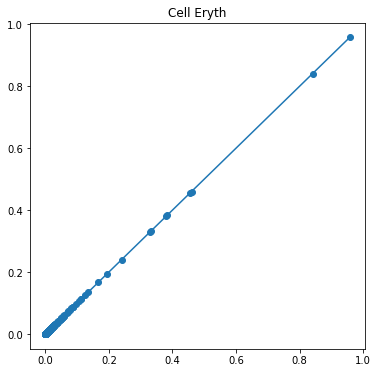

-------------------------------------------------------------------
20


Transforming to str index.


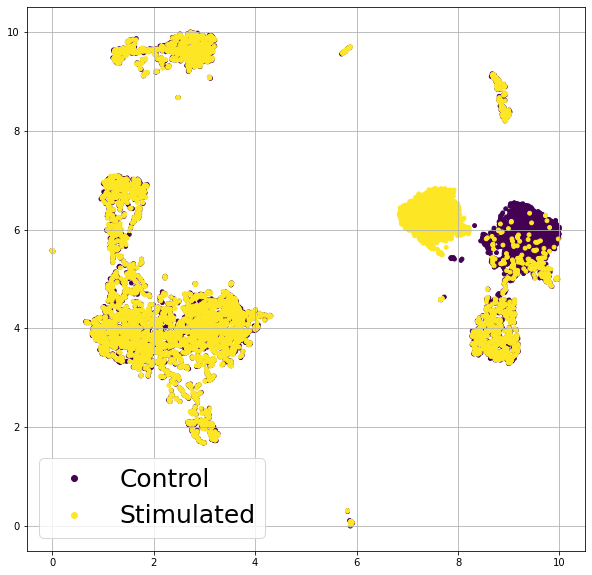

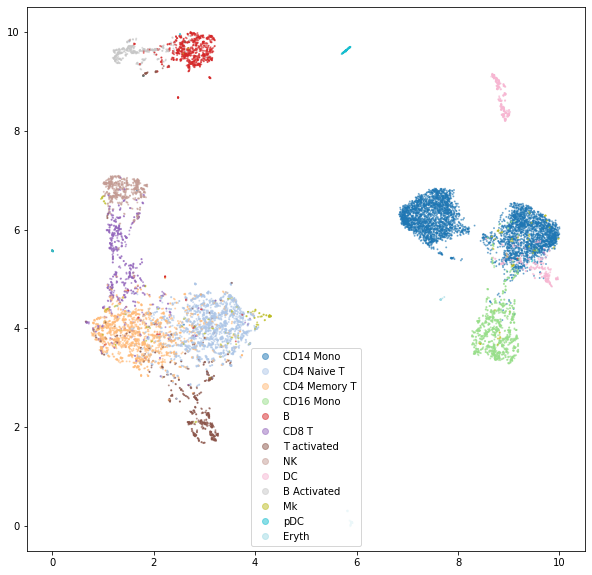

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13090/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


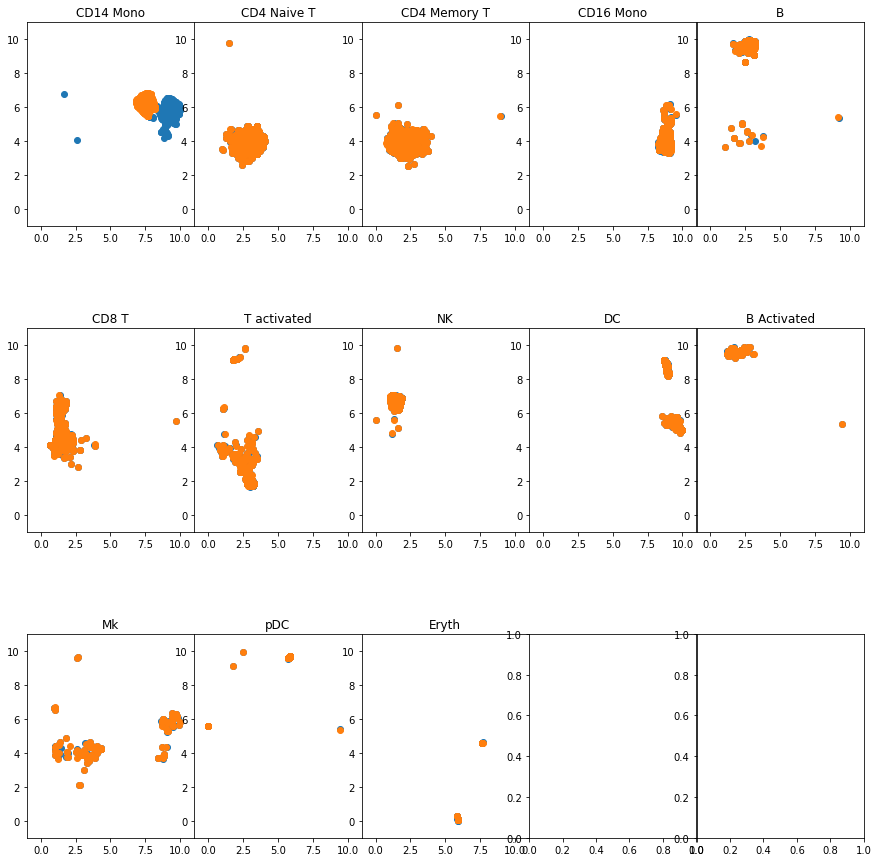

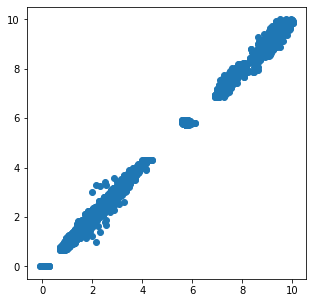

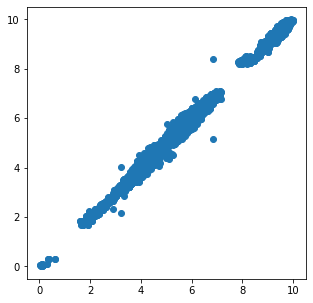

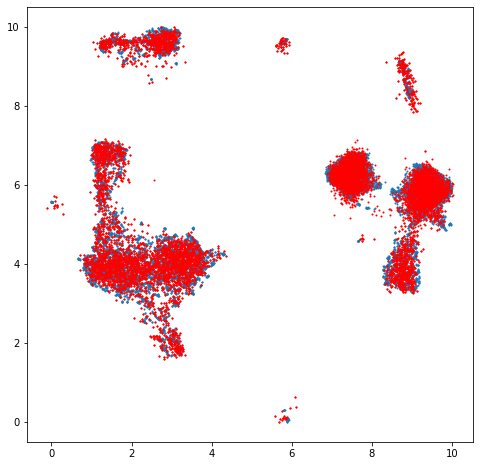

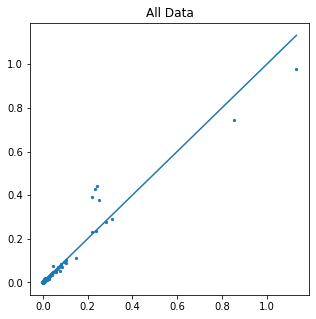

...

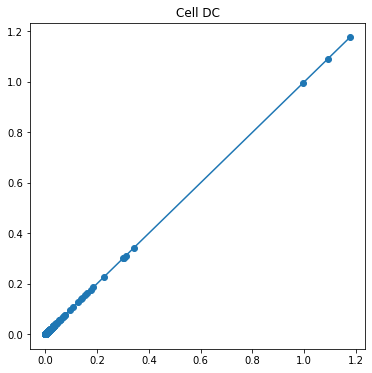

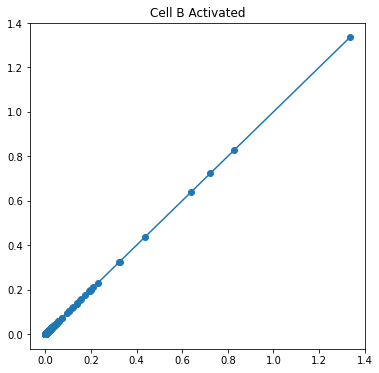

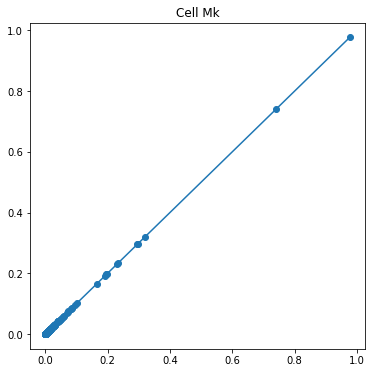

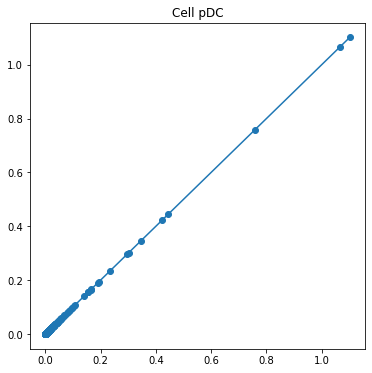

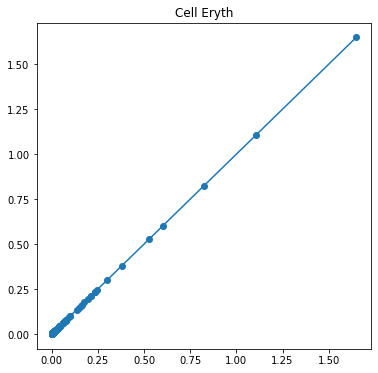

-------------------------------------------------------------------
25


Transforming to str index.


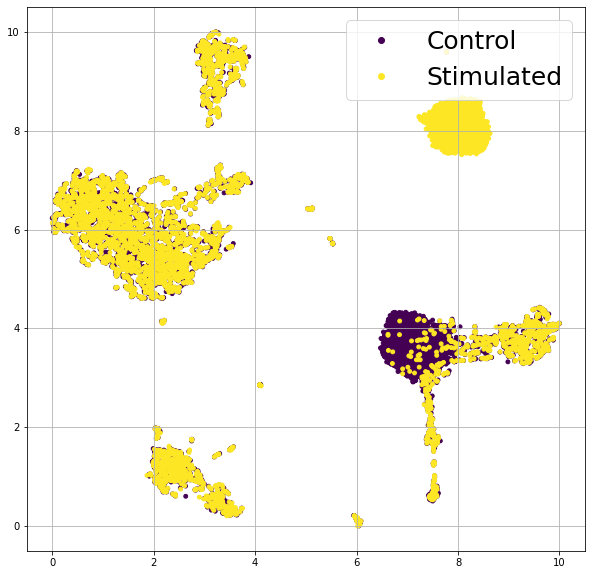

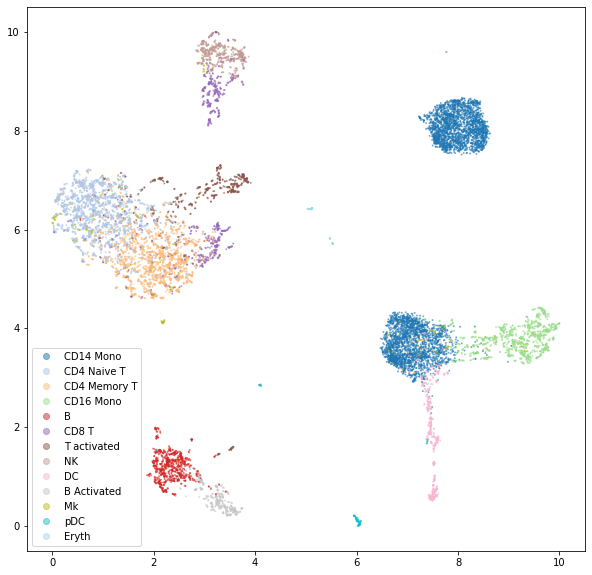

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13025/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


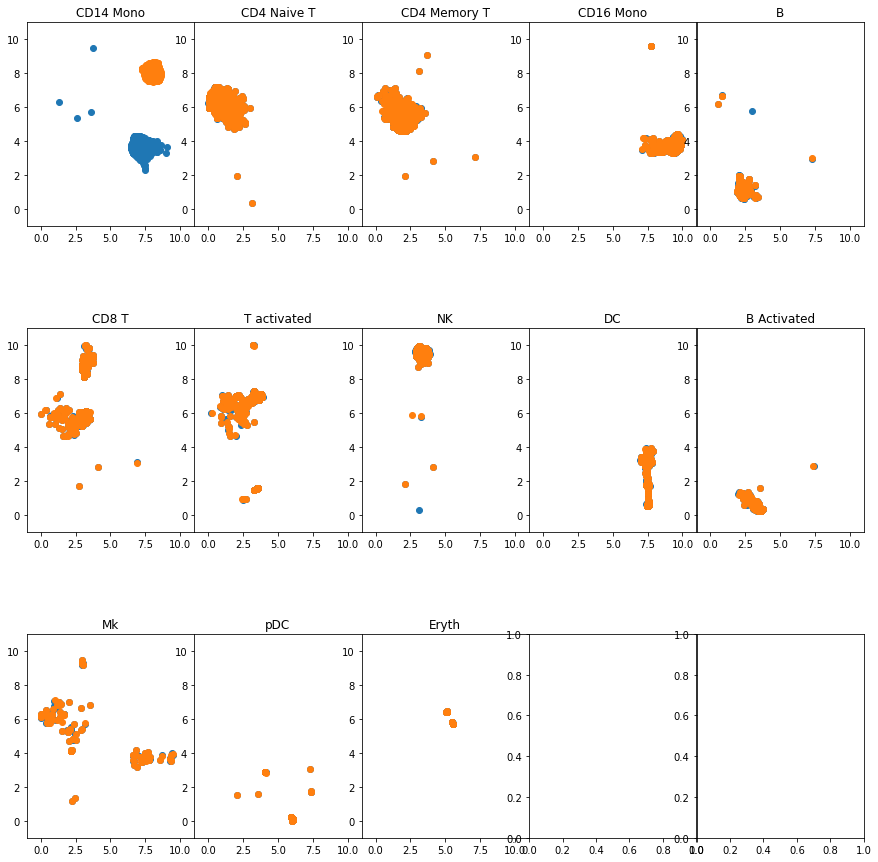

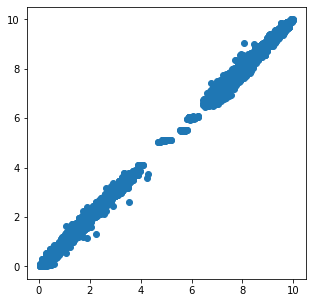

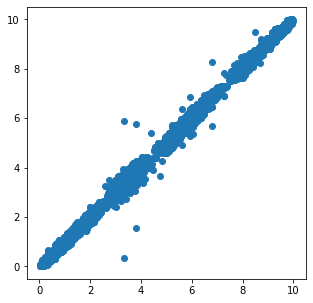

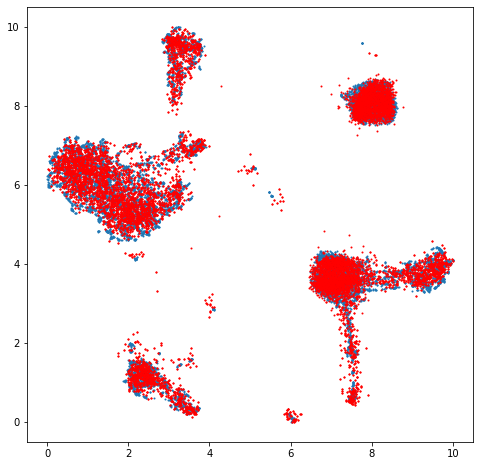

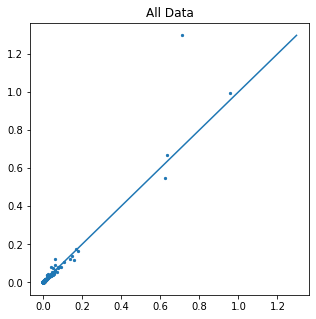

...

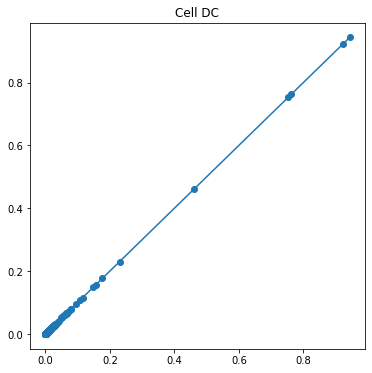

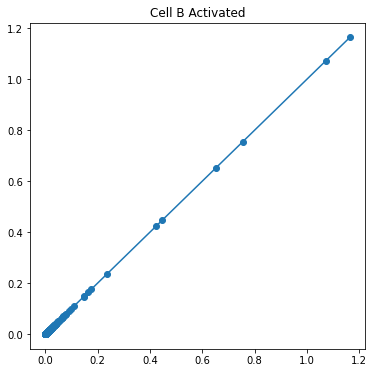

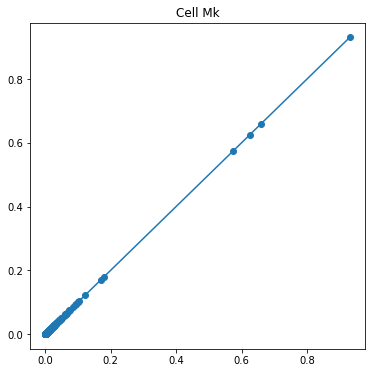

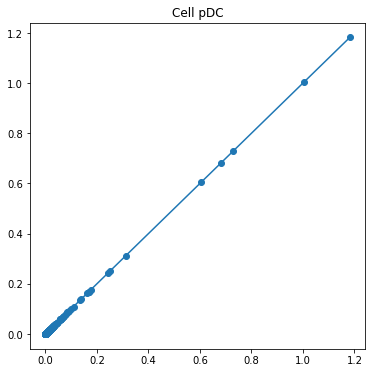

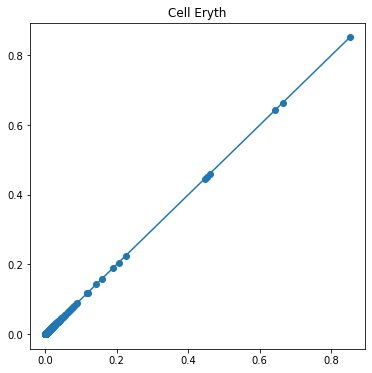

-------------------------------------------------------------------
30


Transforming to str index.


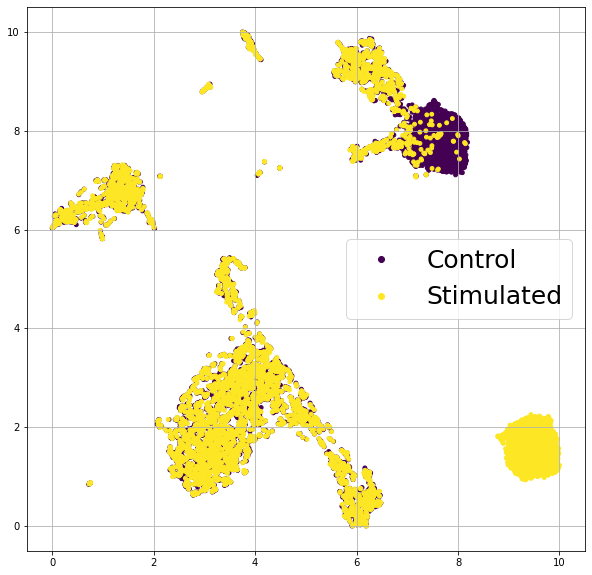

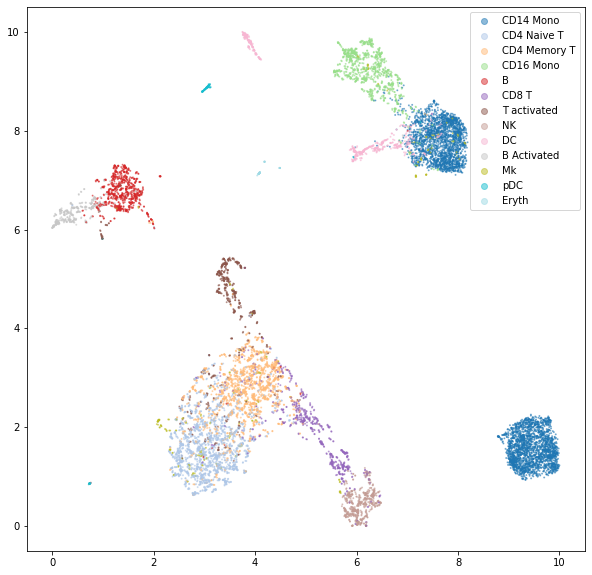

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13080/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


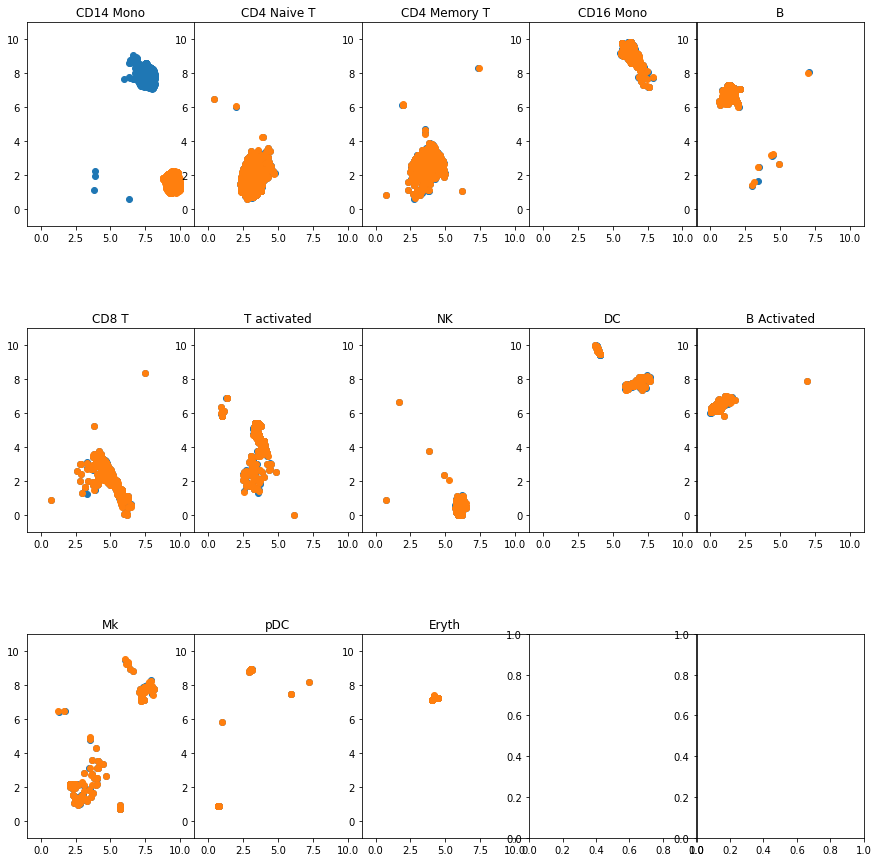

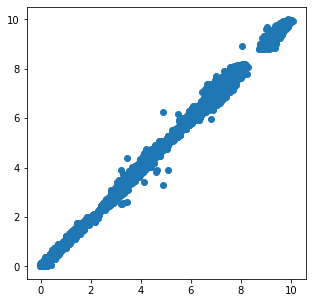

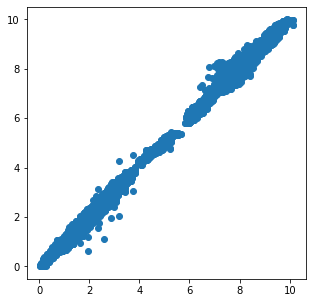

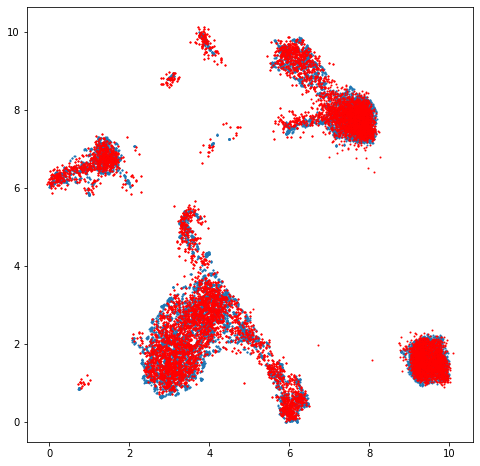

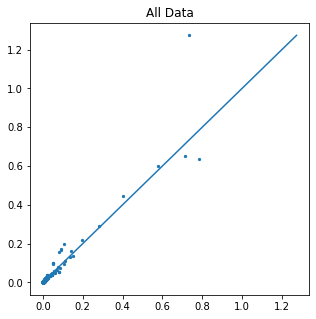

...

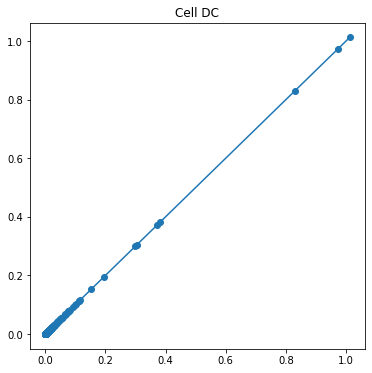

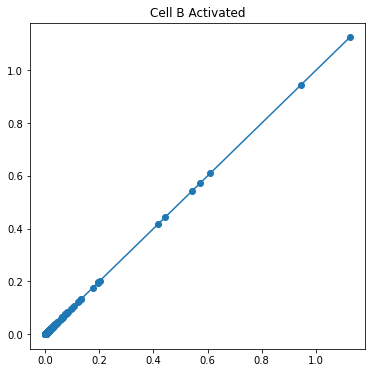

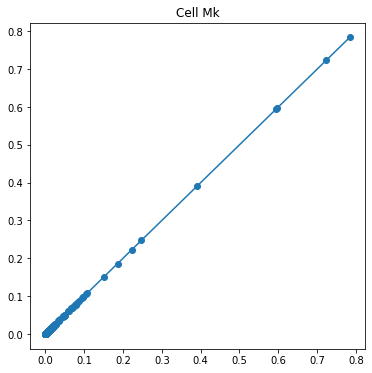

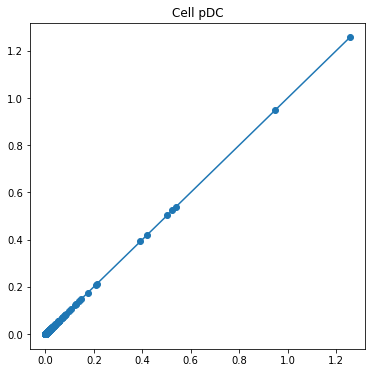

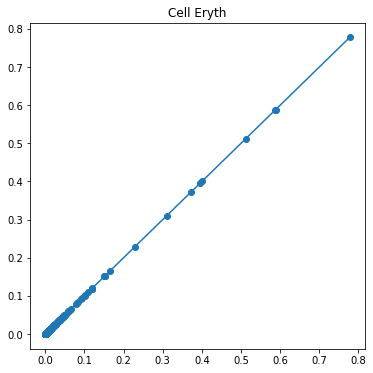

-------------------------------------------------------------------
35


Transforming to str index.


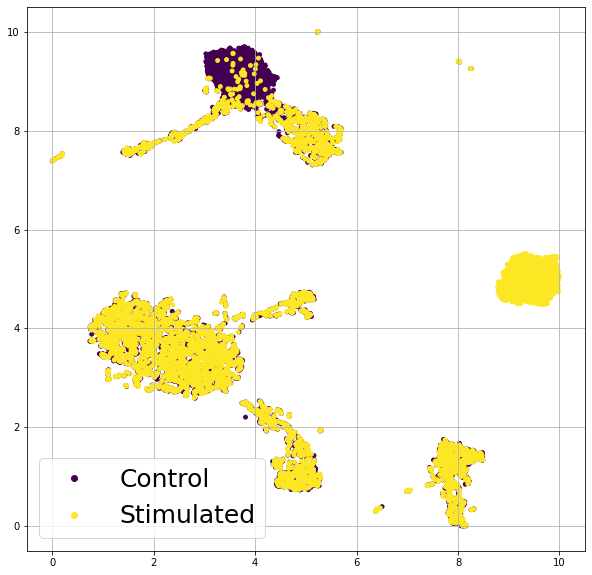

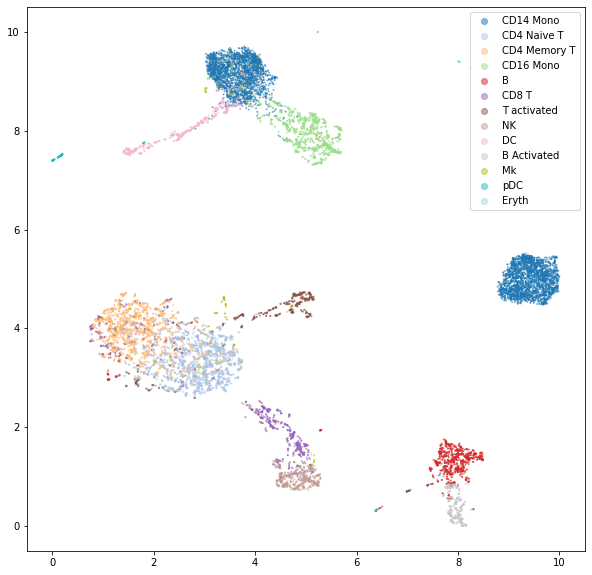

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13075/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


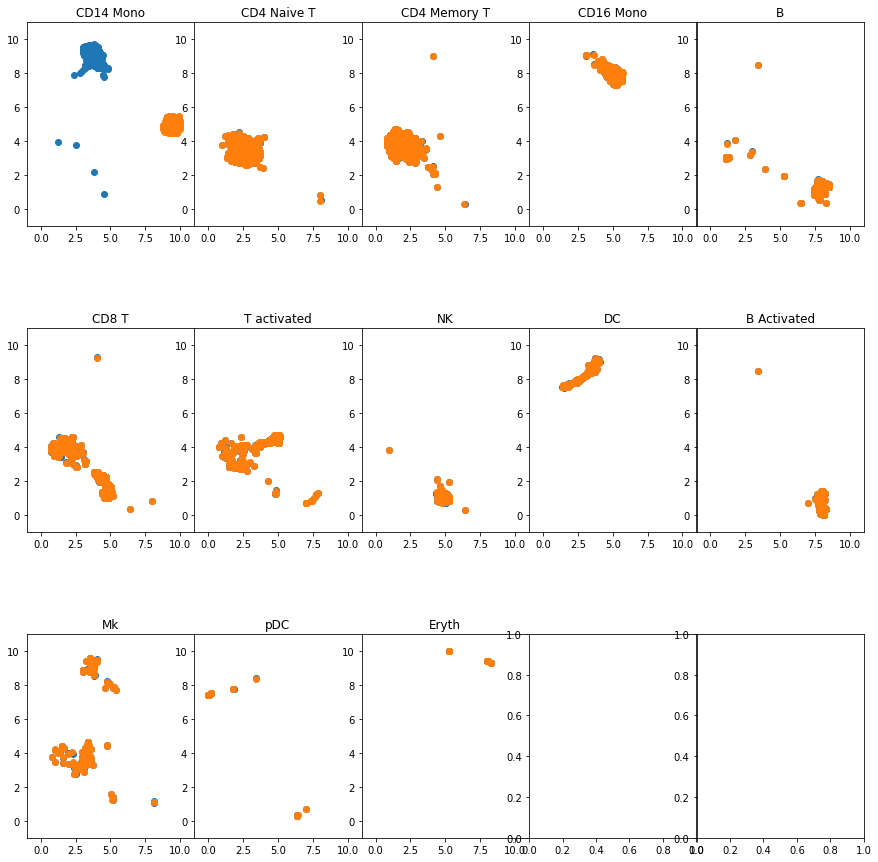

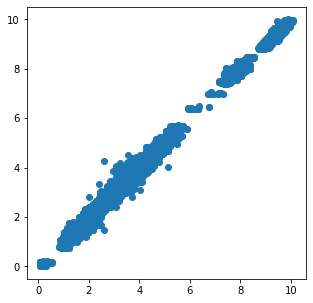

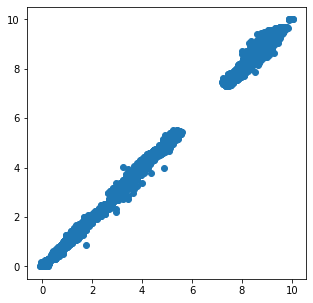

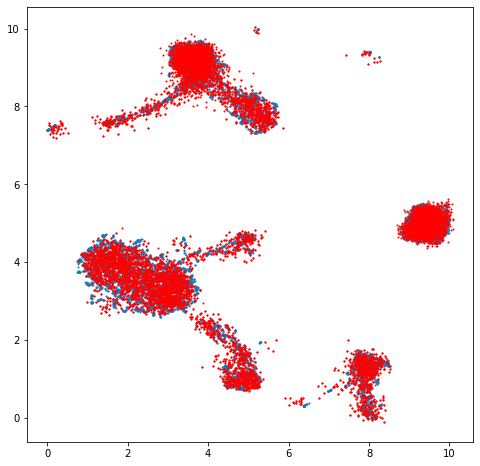

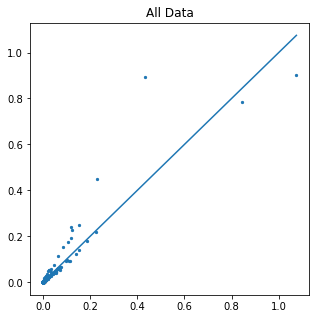

...

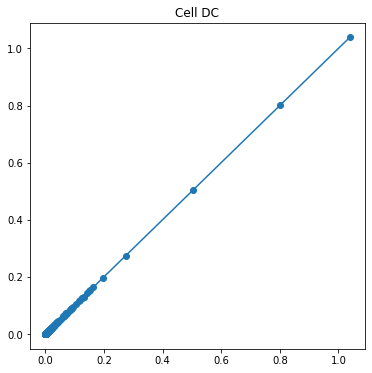

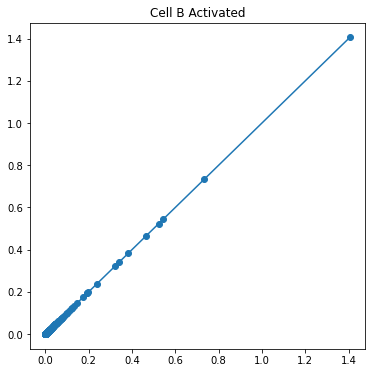

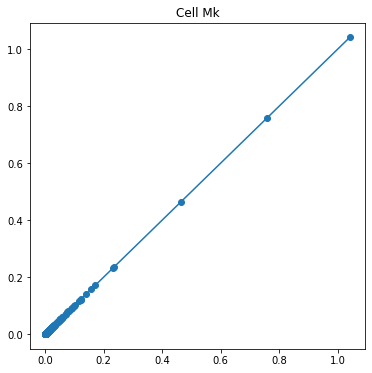

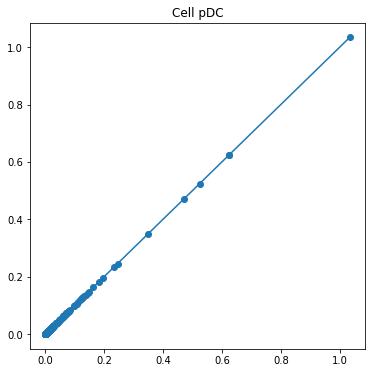

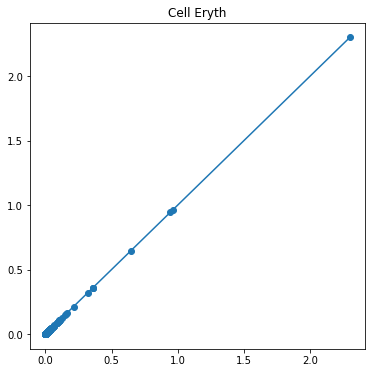

-------------------------------------------------------------------
40


Transforming to str index.


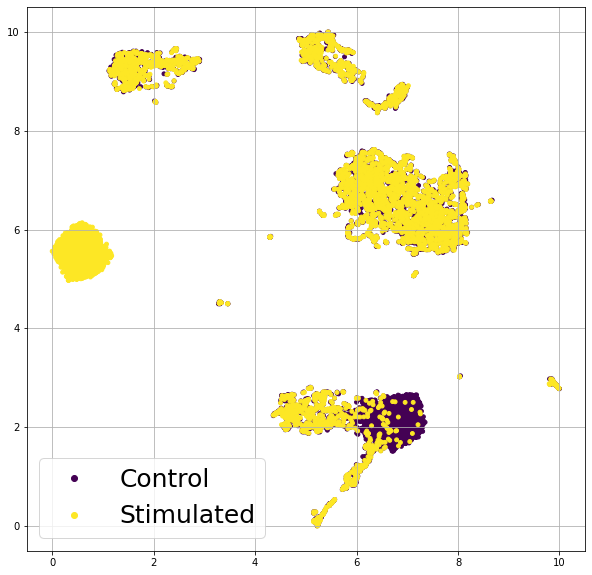

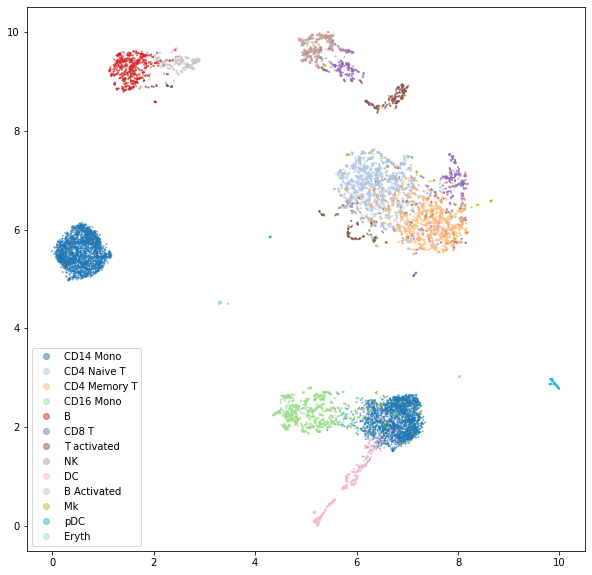

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13084/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


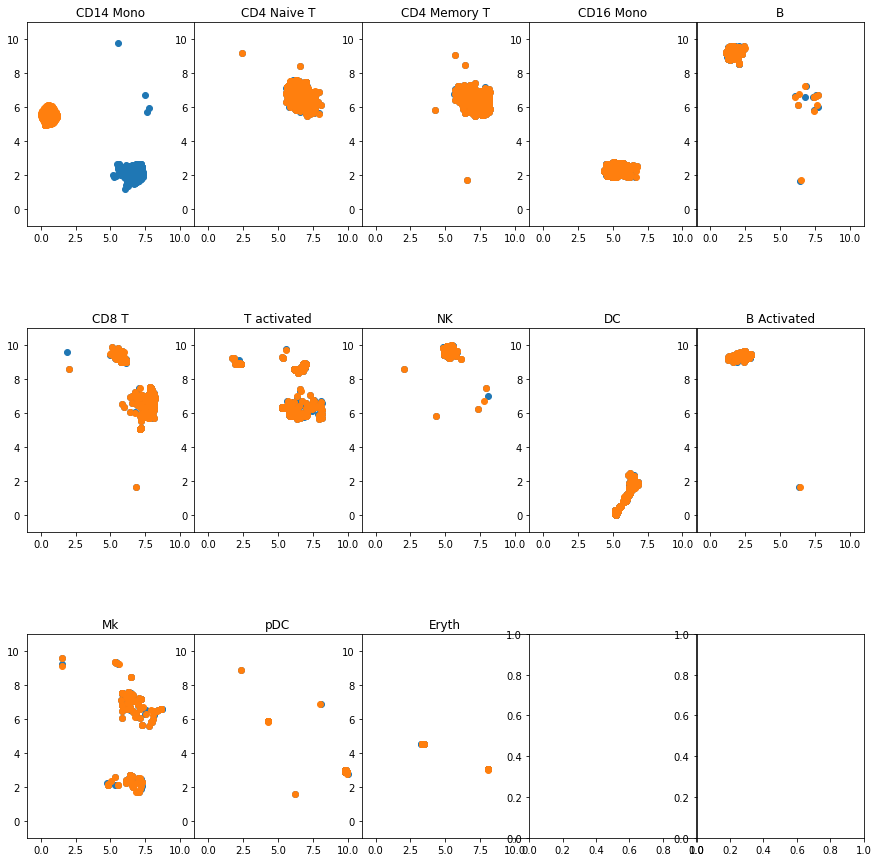

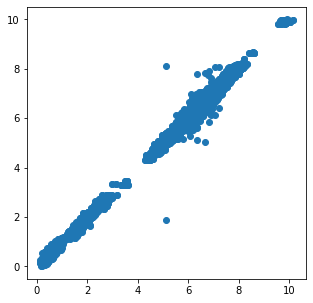

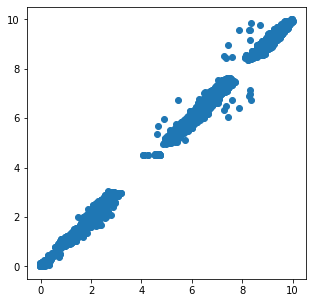

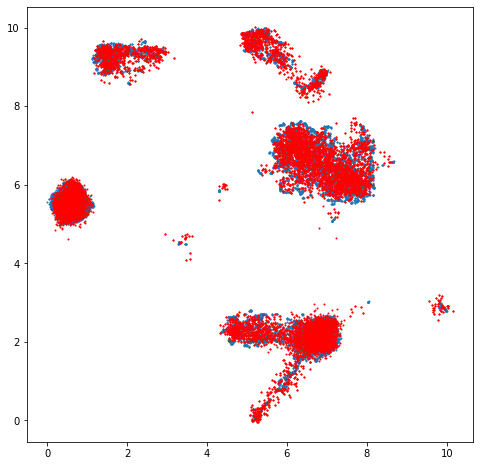

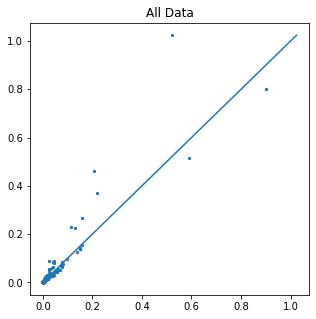

...

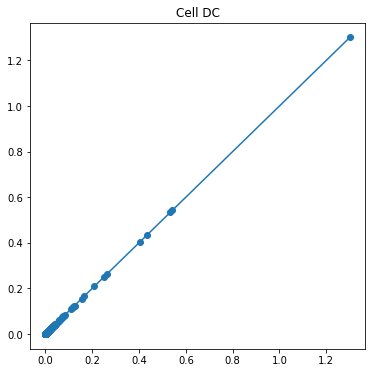

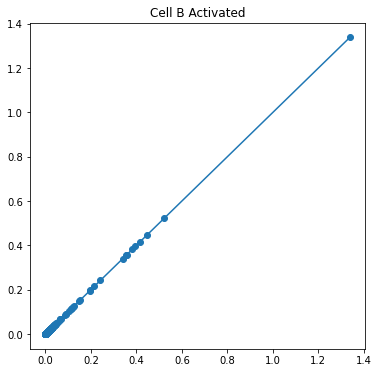

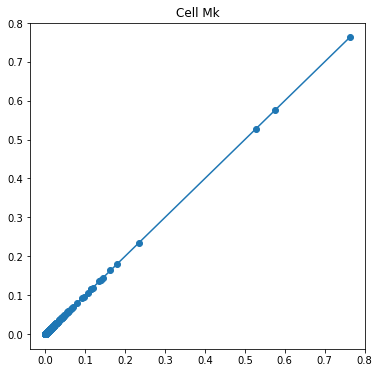

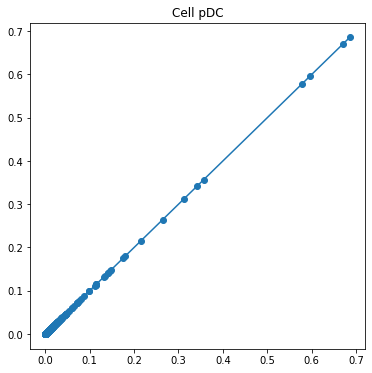

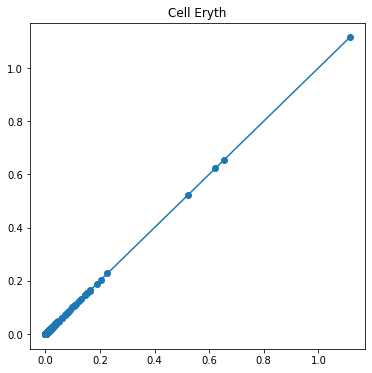

-------------------------------------------------------------------
45


Transforming to str index.


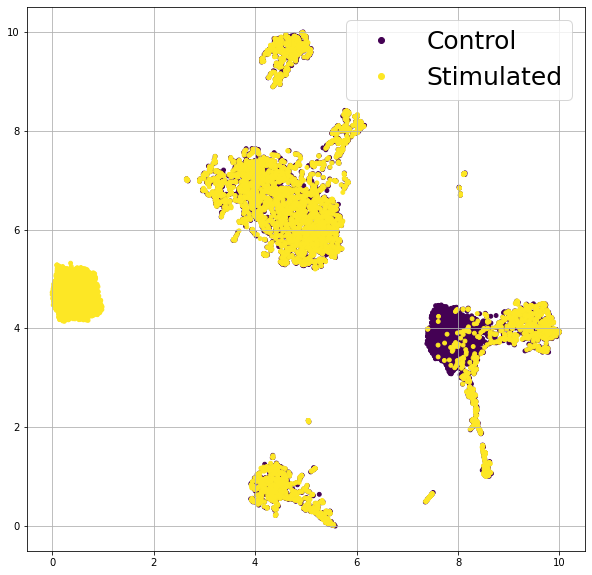

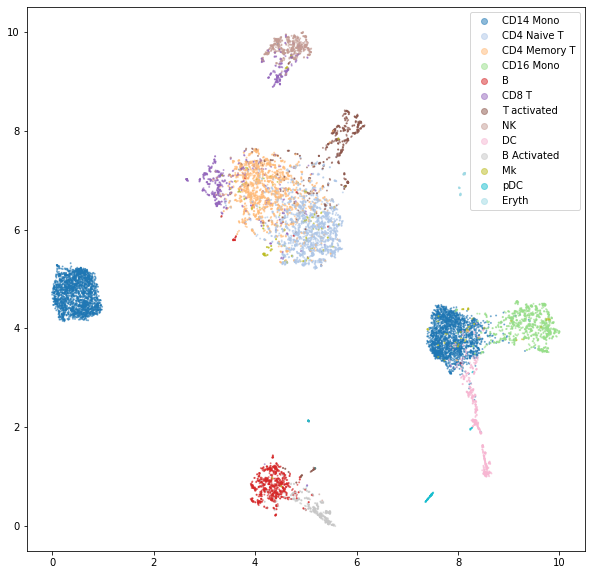

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13000/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


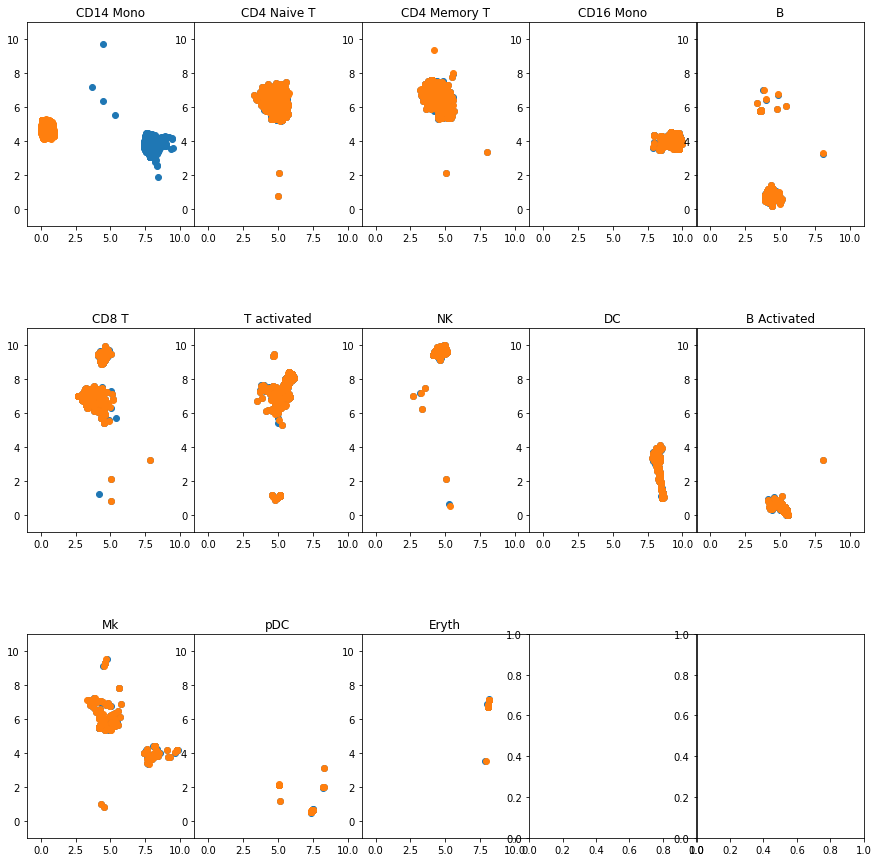

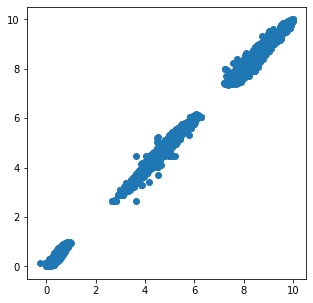

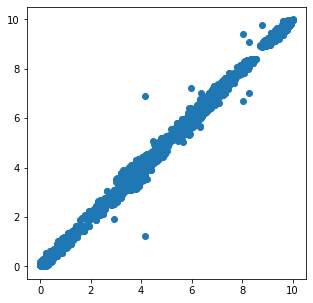

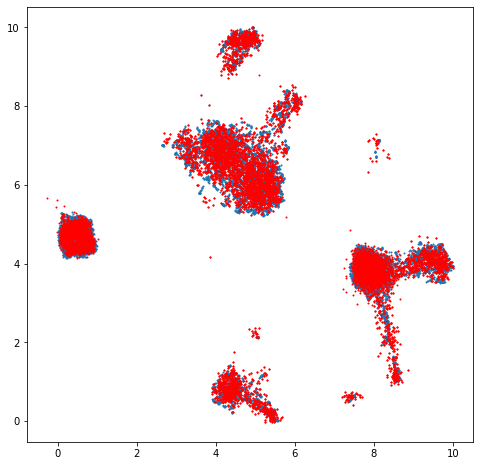

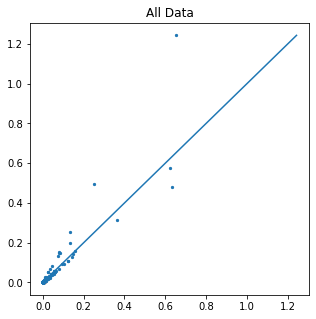

...

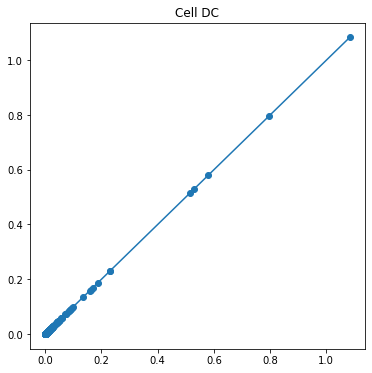

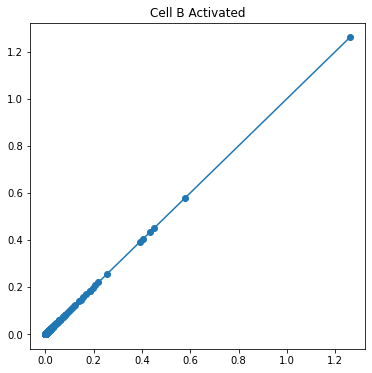

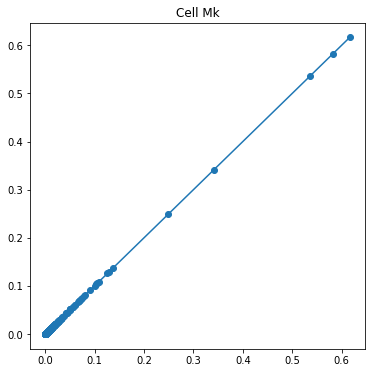

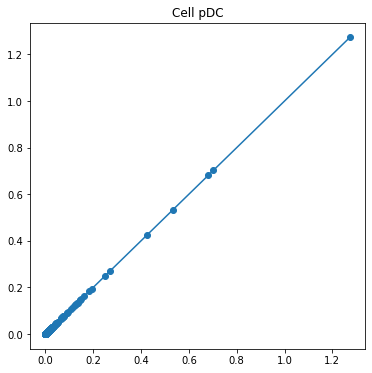

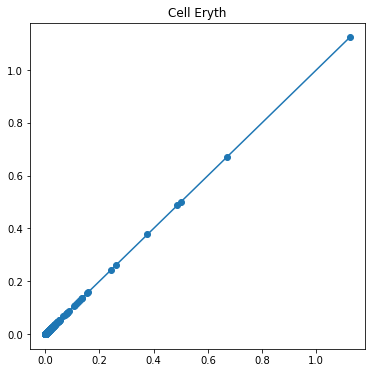

-------------------------------------------------------------------
50


Transforming to str index.


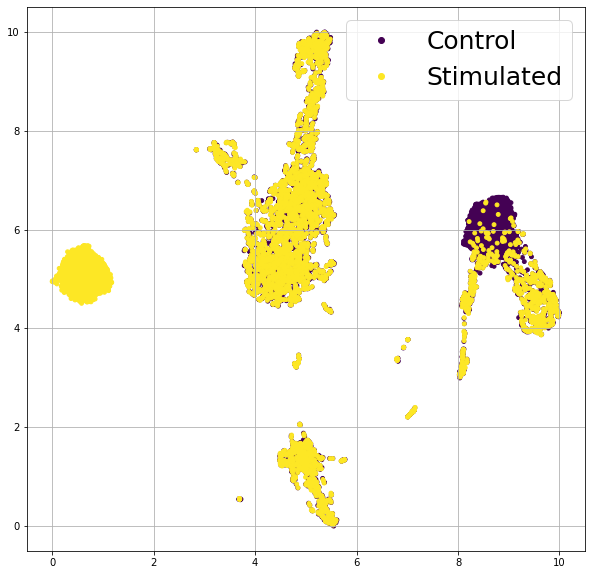

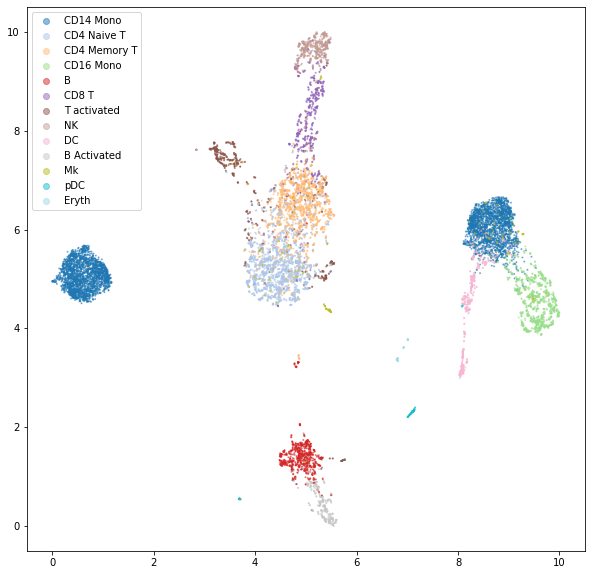

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13004/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


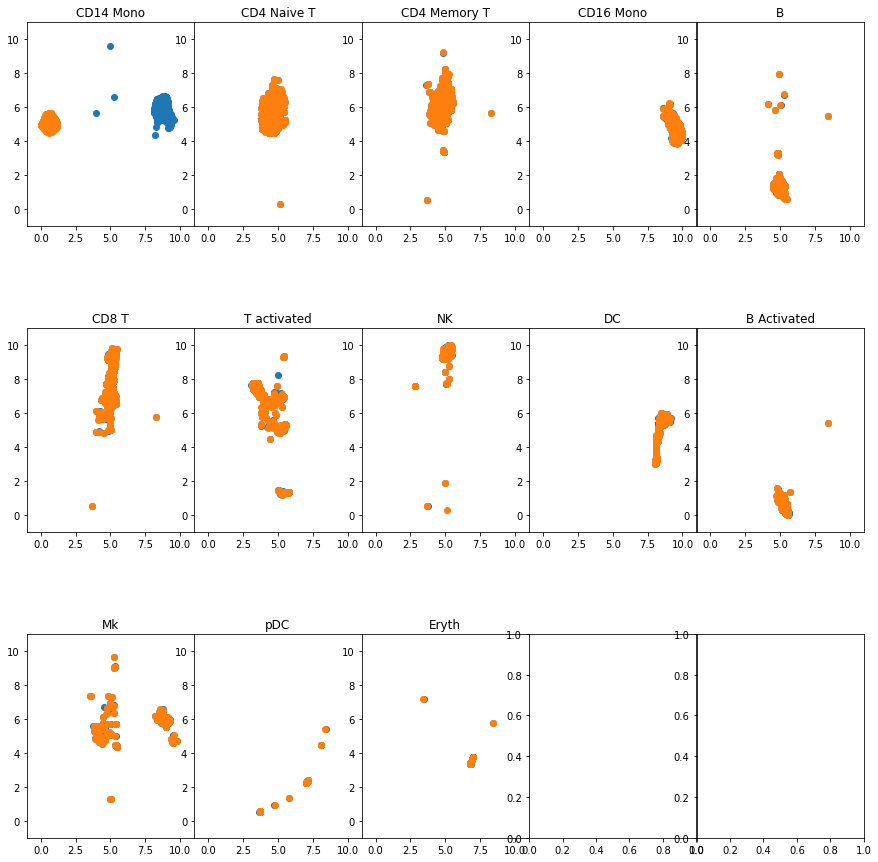

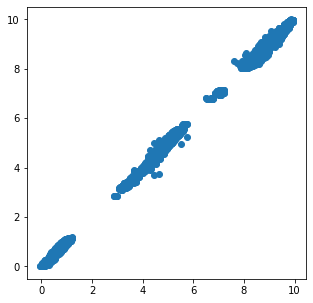

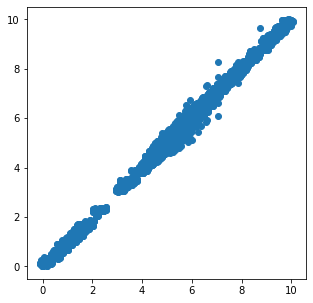

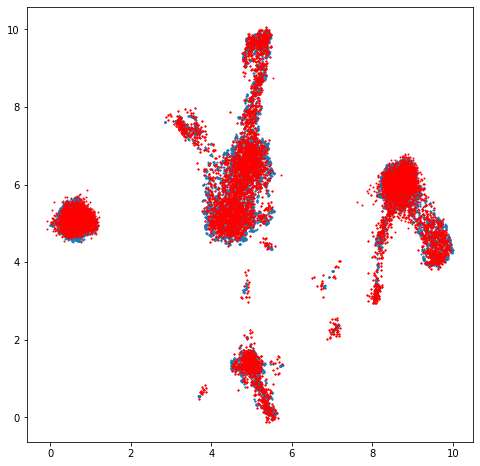

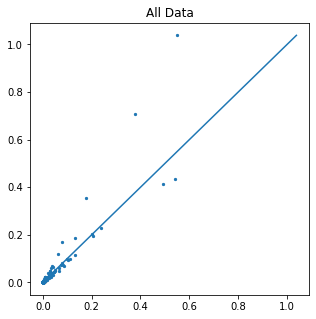

...

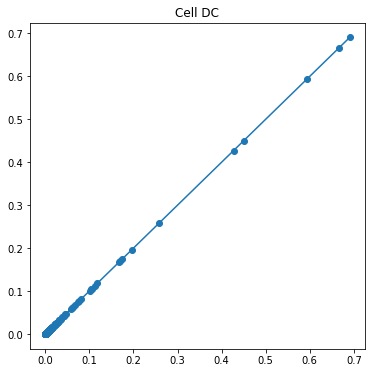

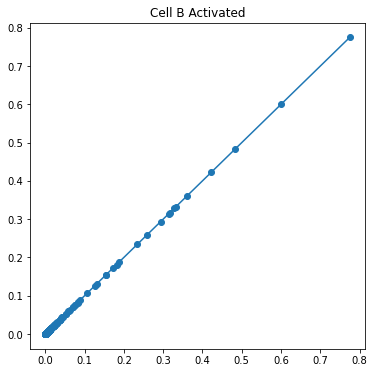

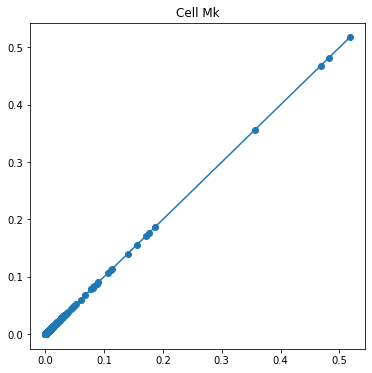

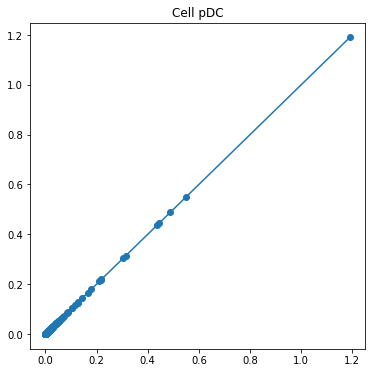

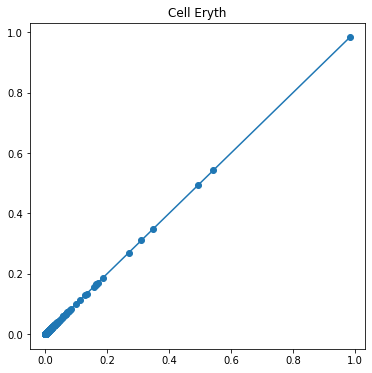

-------------------------------------------------------------------


is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


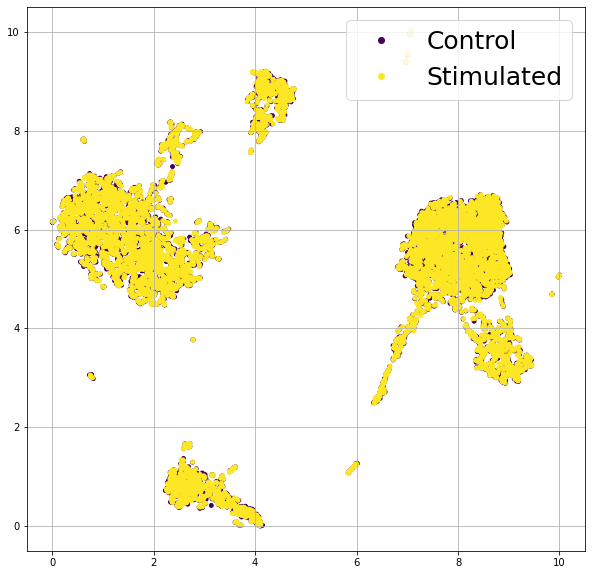

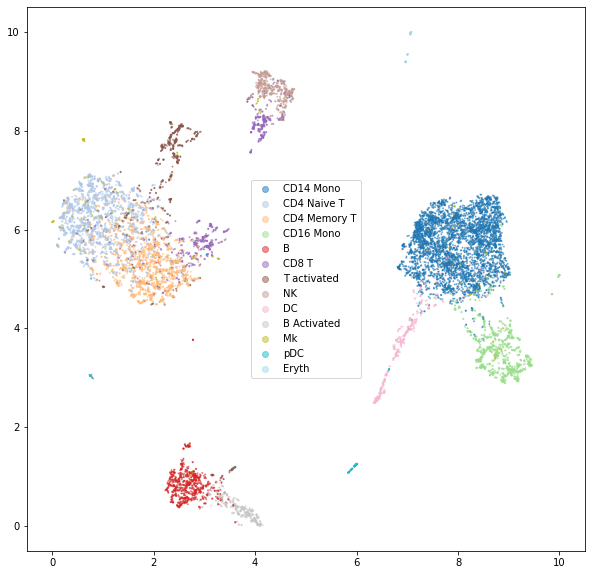

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13070/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


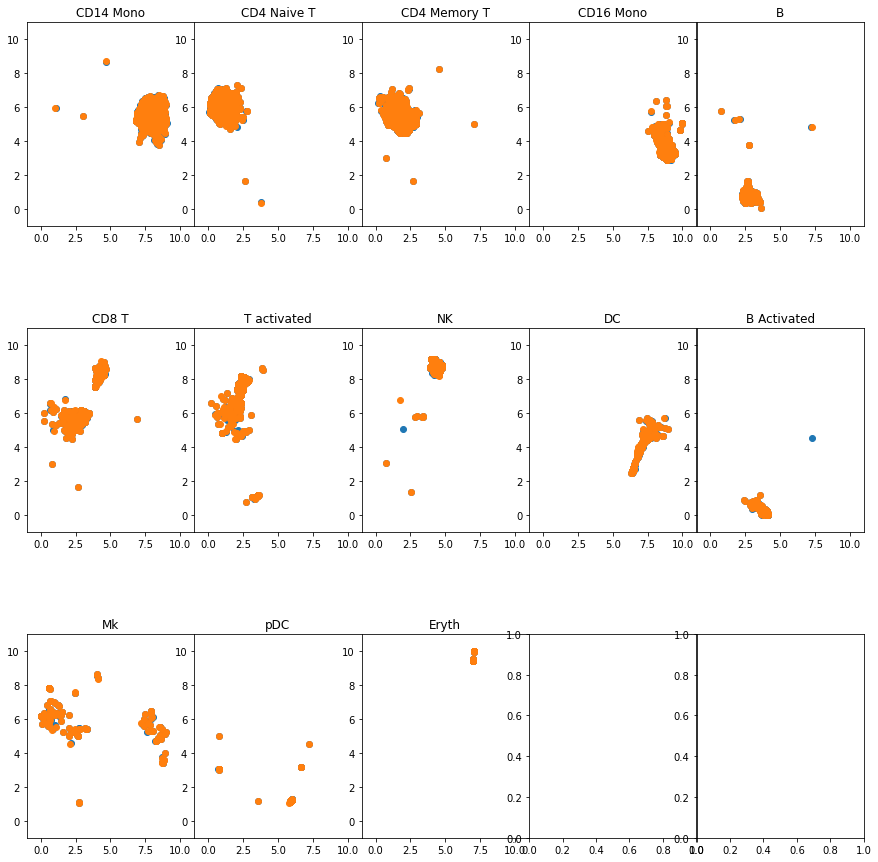

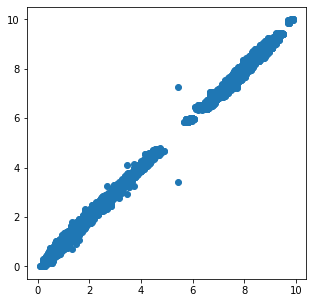

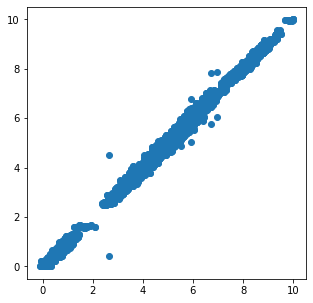

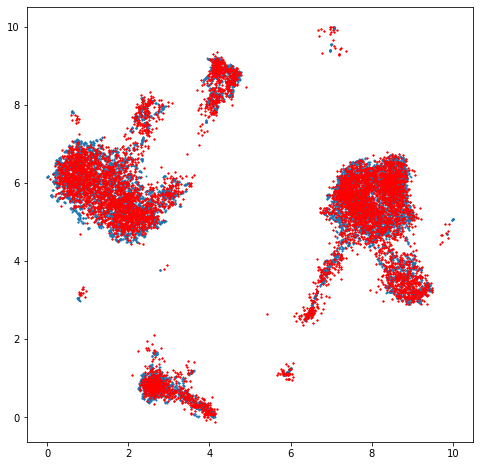

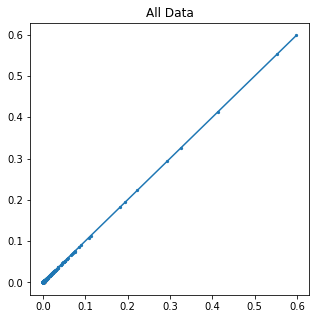

...

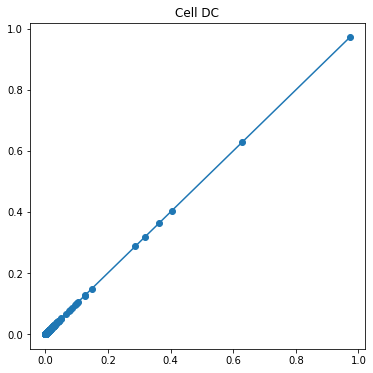

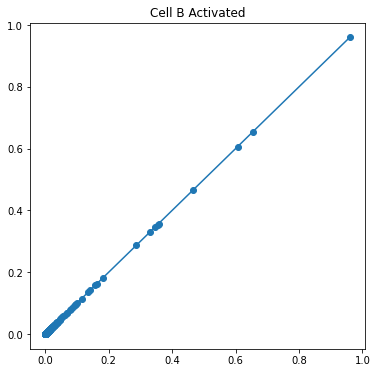

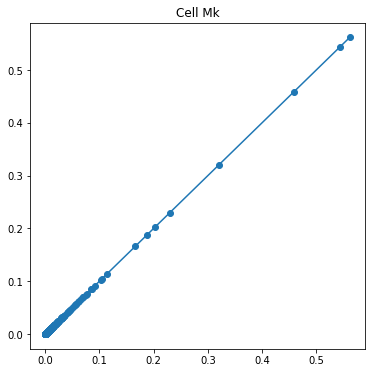

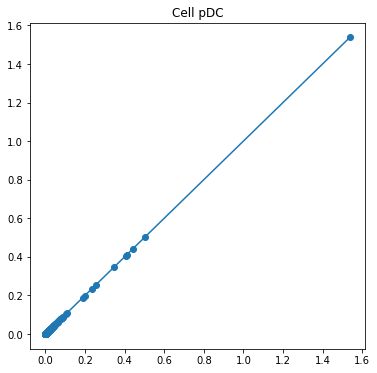

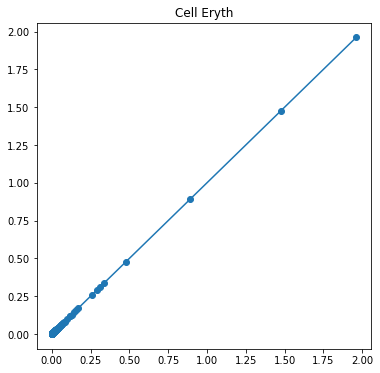

-------------------------------------------------------------------
5


Transforming to str index.


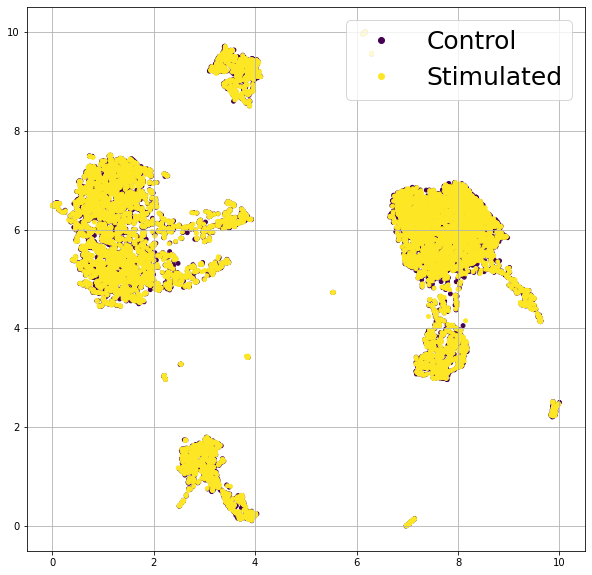

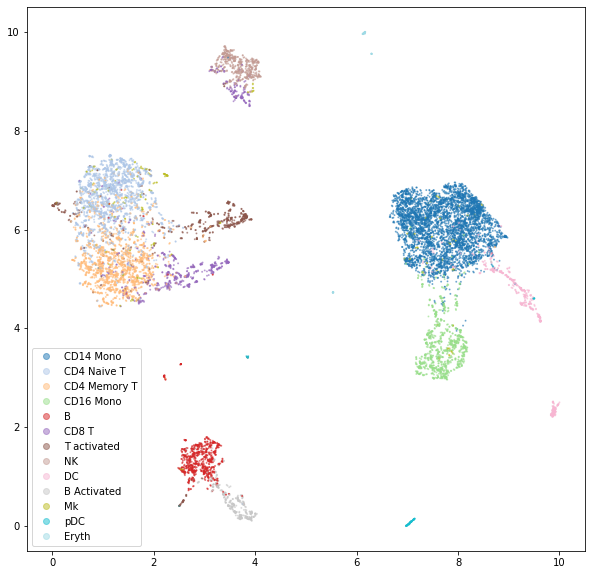

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13070/13096 [02:04<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


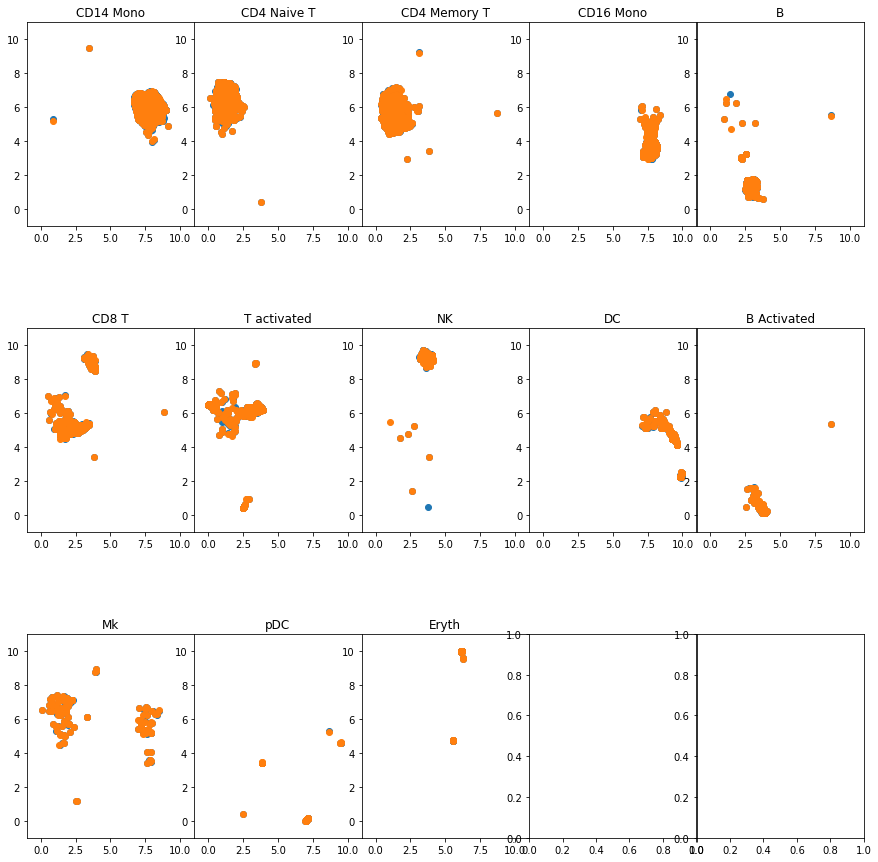

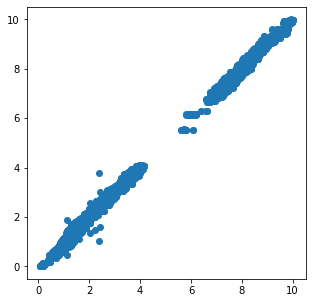

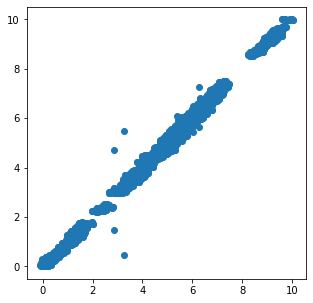

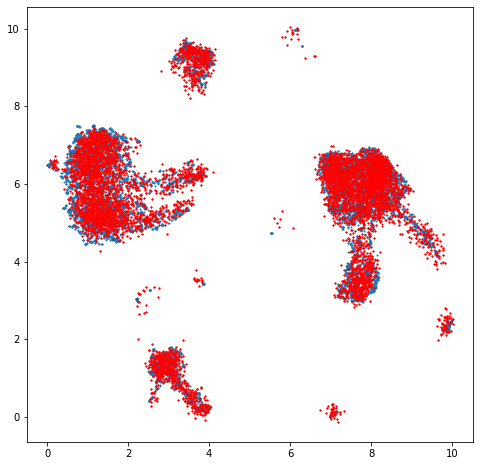

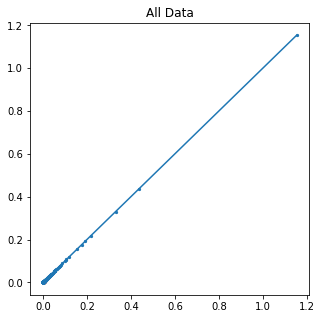

...

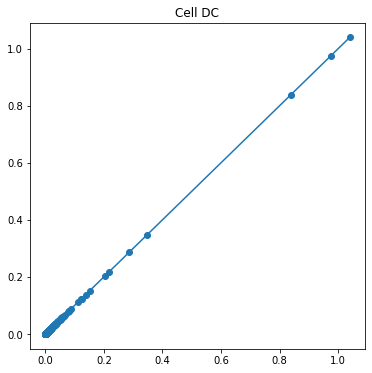

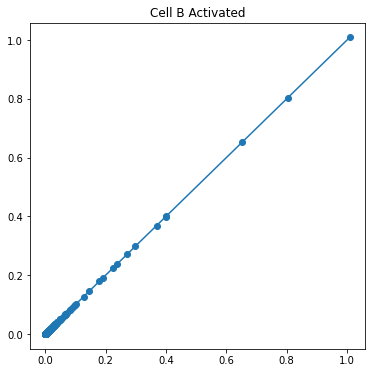

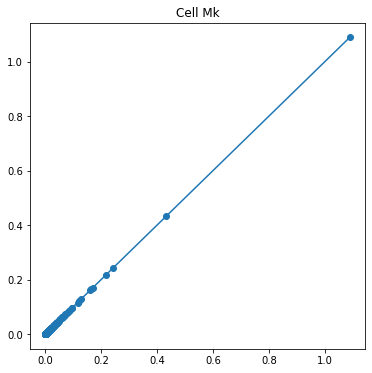

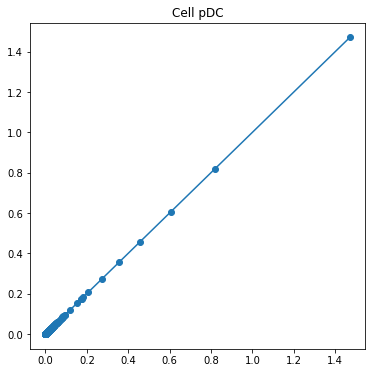

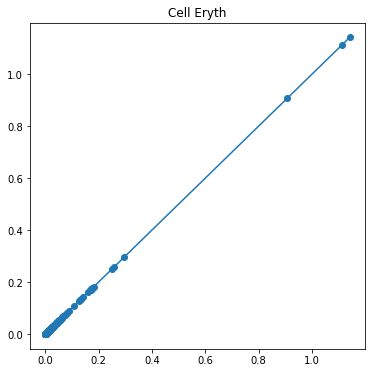

-------------------------------------------------------------------
10


Transforming to str index.


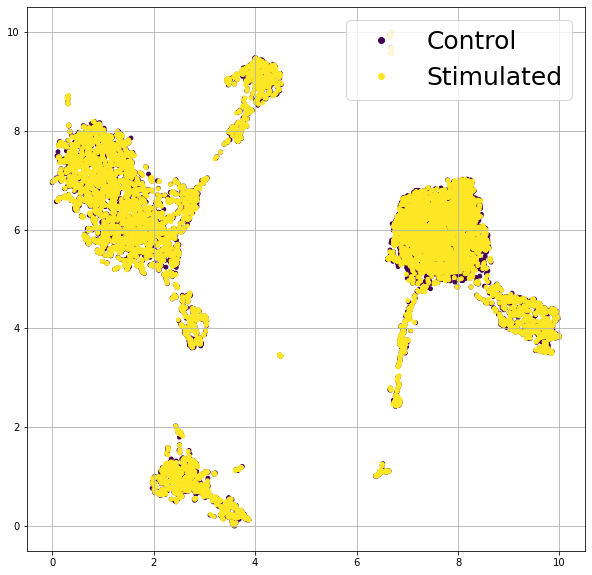

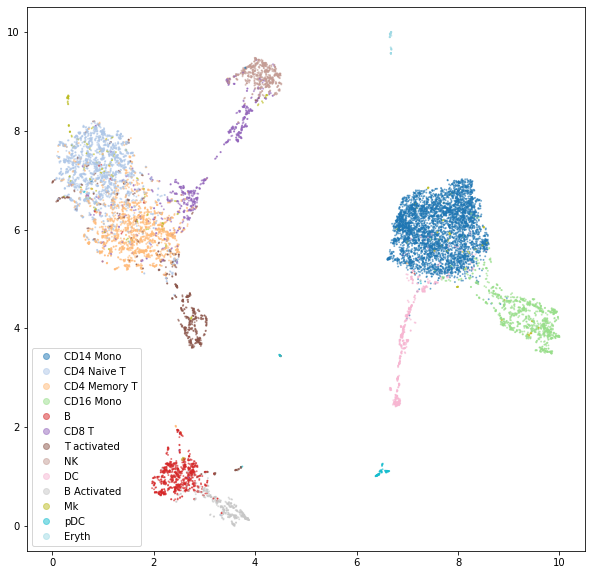

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13073/13096 [02:05<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


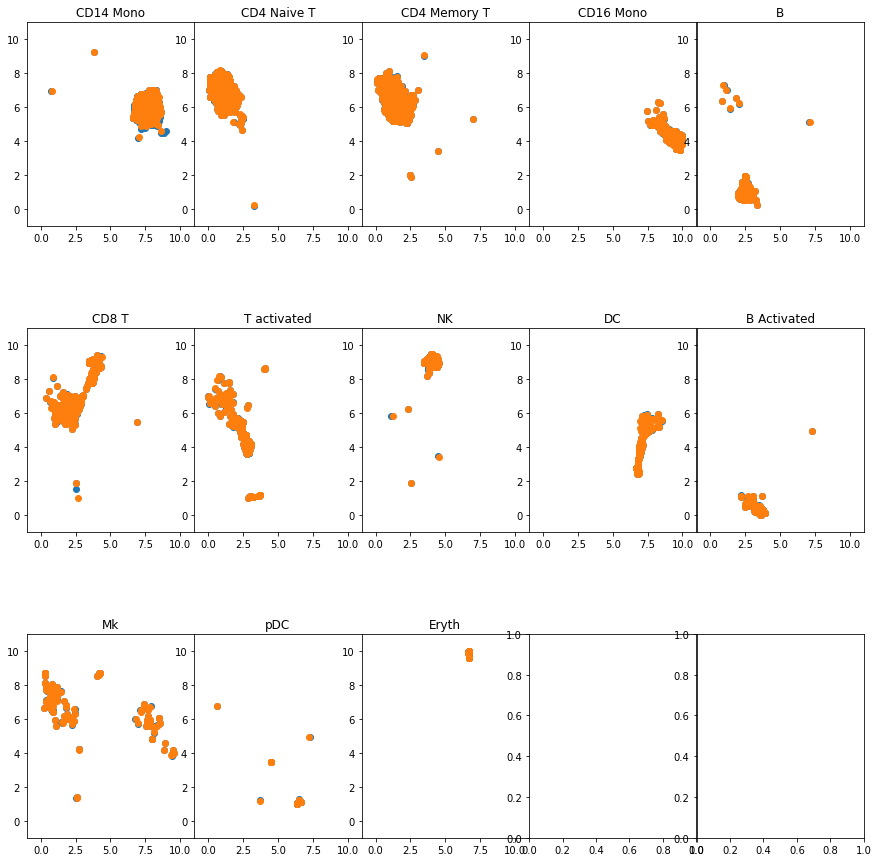

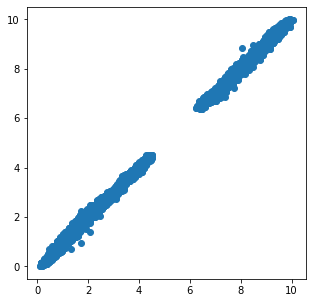

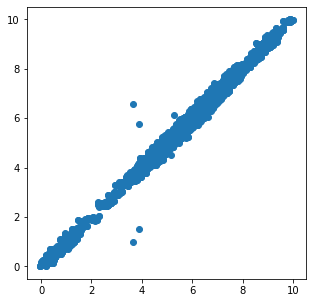

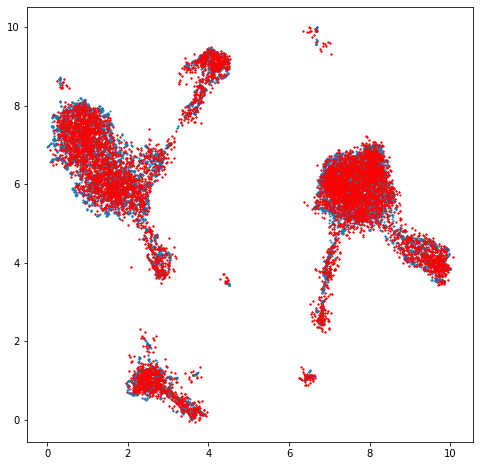

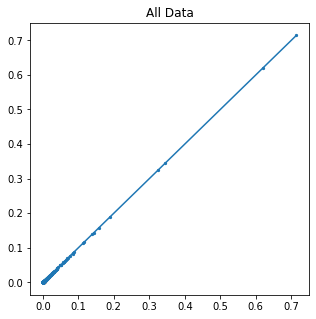

...

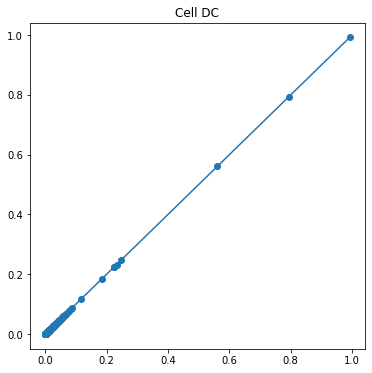

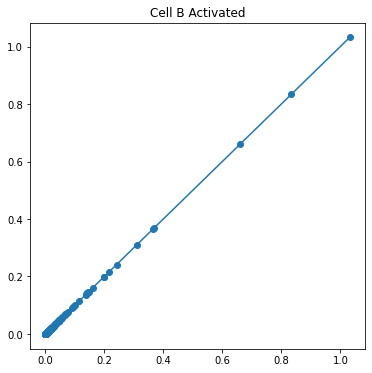

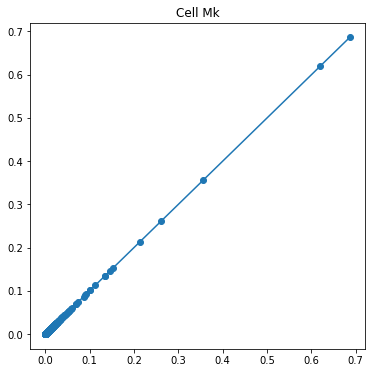

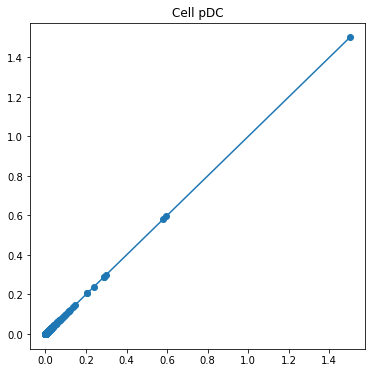

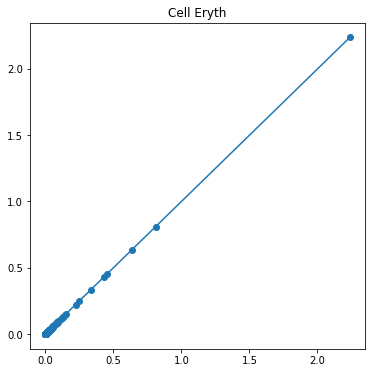

-------------------------------------------------------------------
15


Transforming to str index.


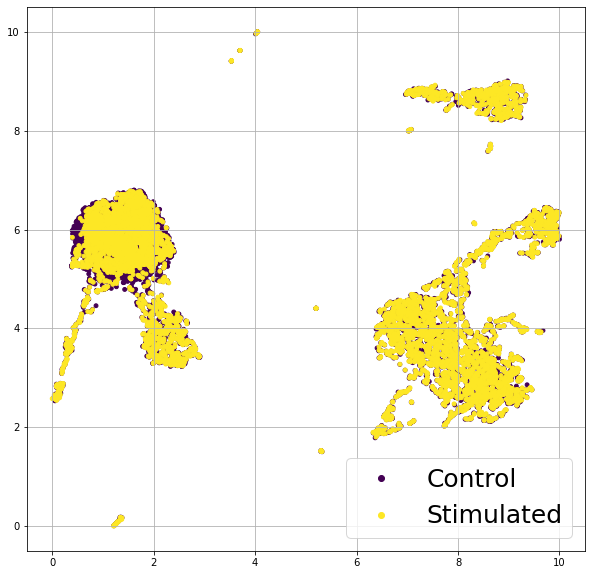

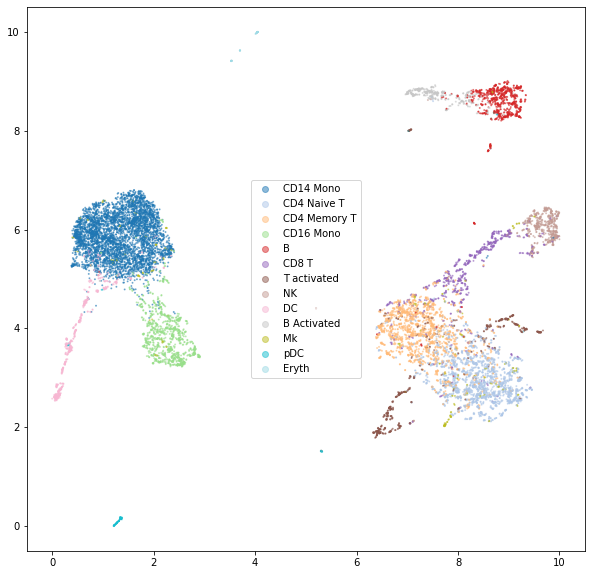

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13039/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


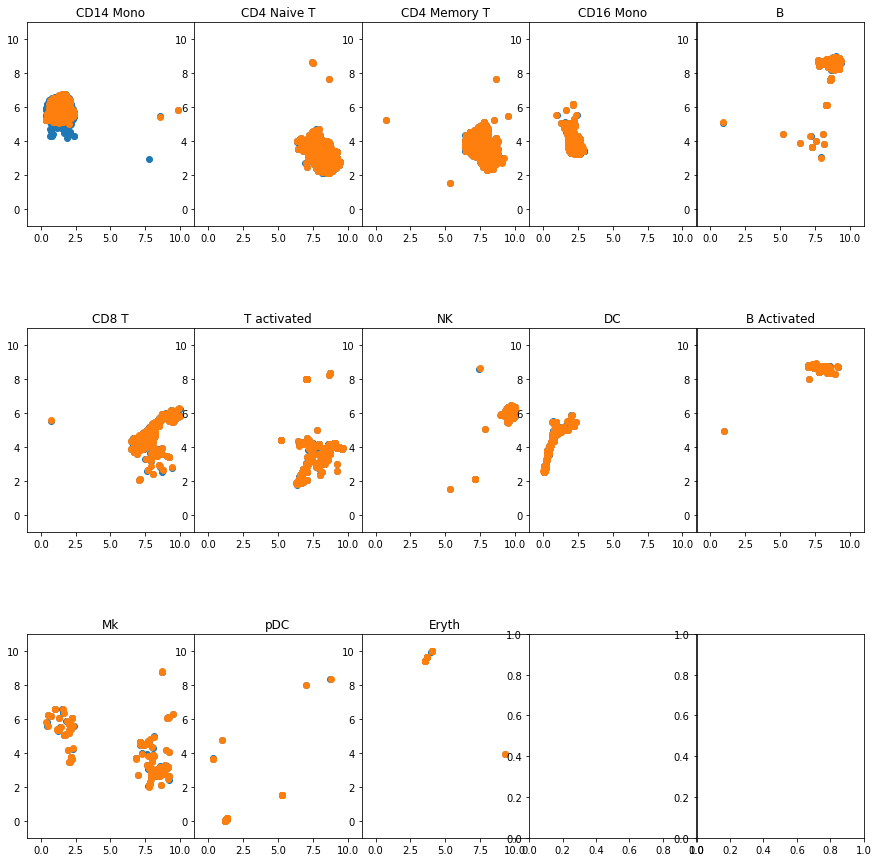

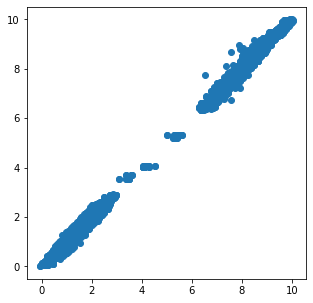

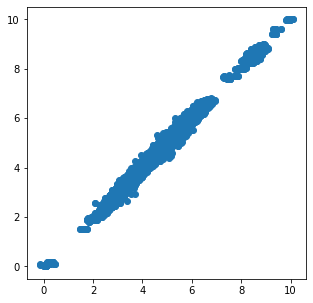

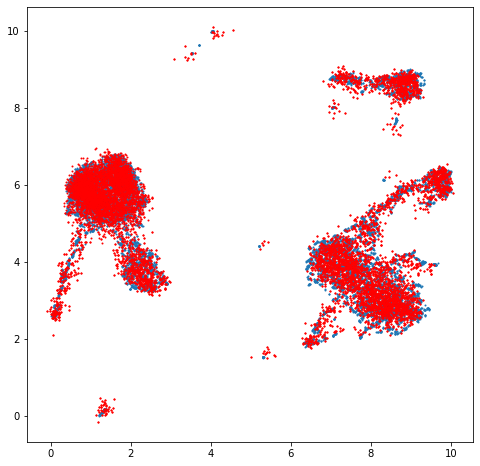

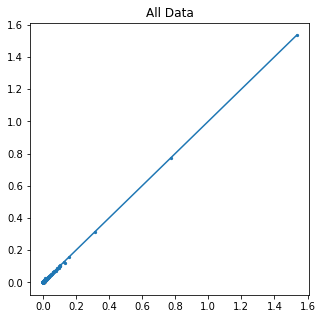

...

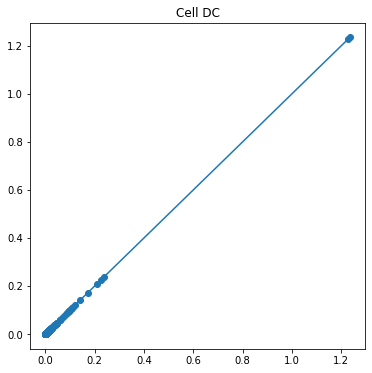

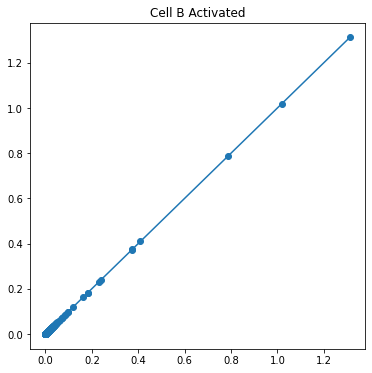

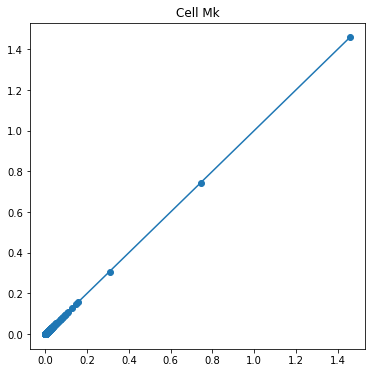

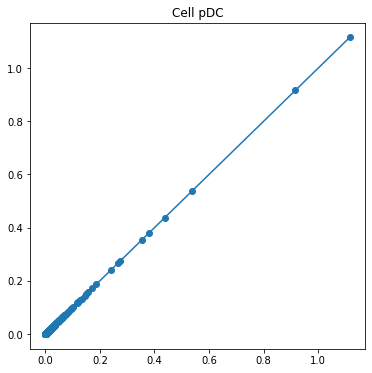

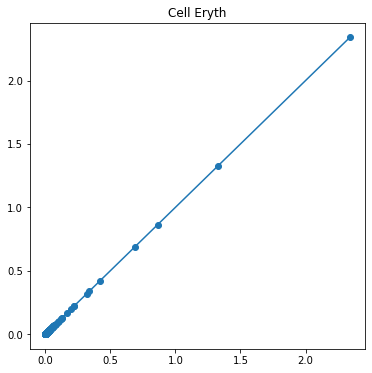

-------------------------------------------------------------------
20


Transforming to str index.


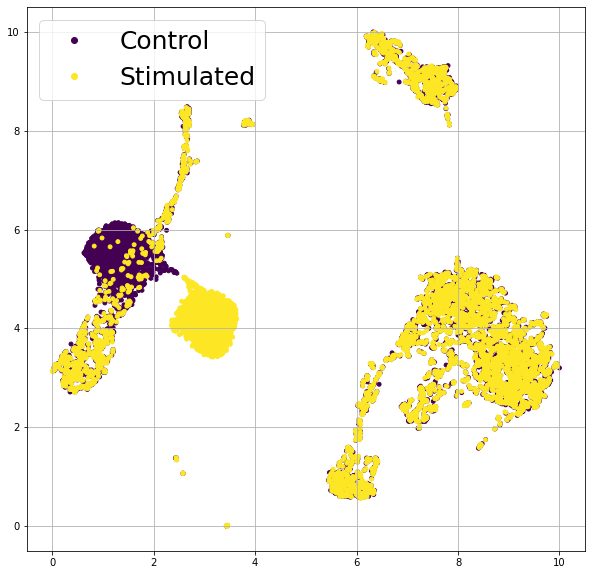

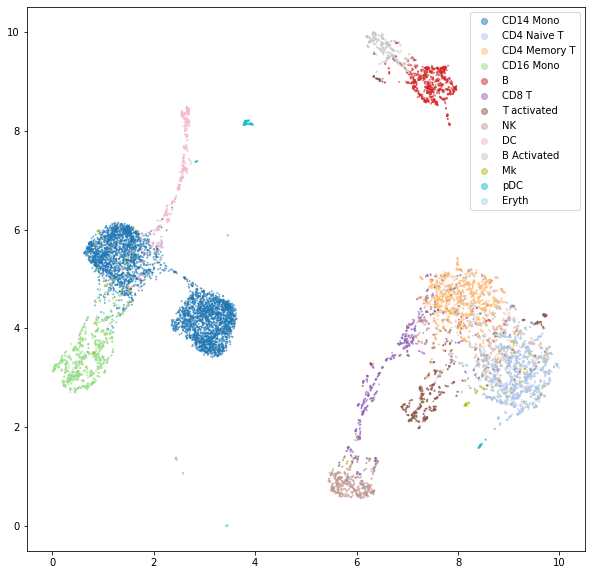

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13046/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


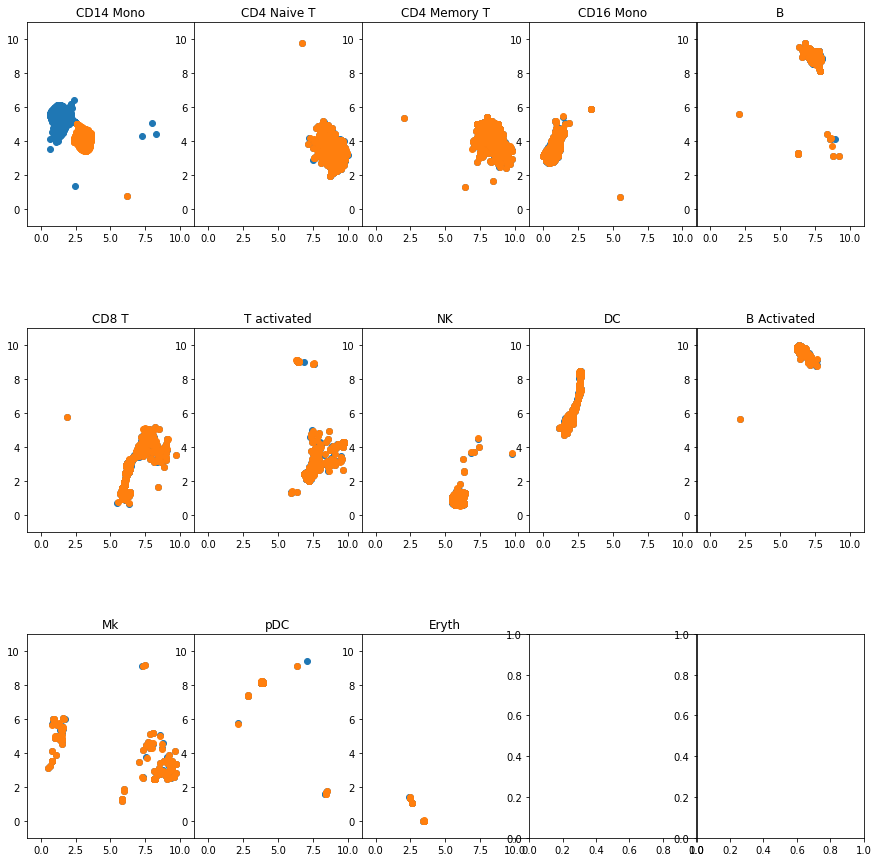

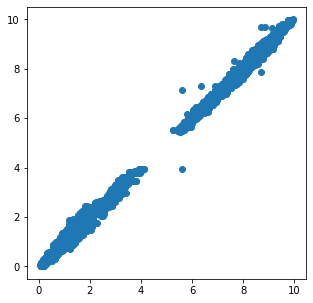

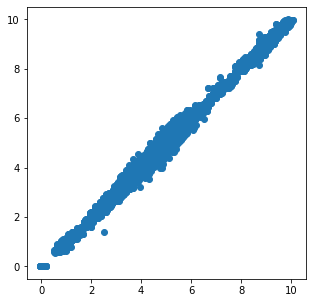

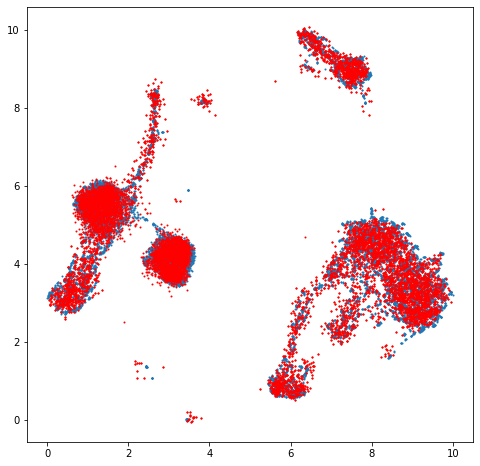

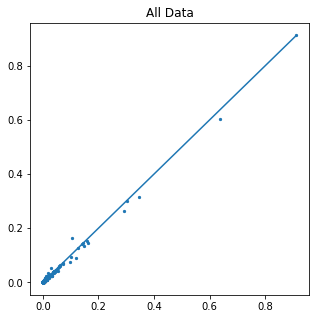

...

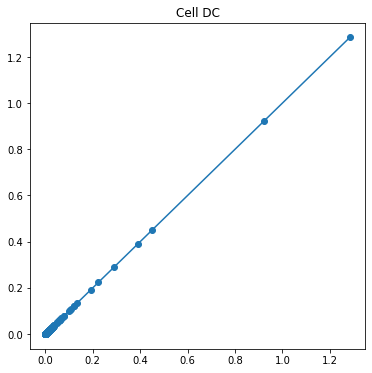

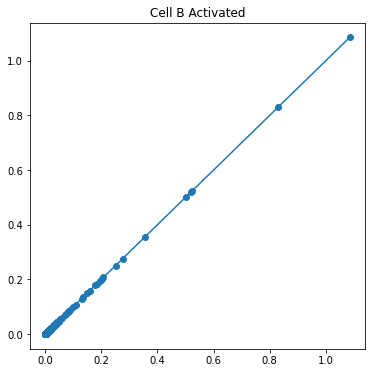

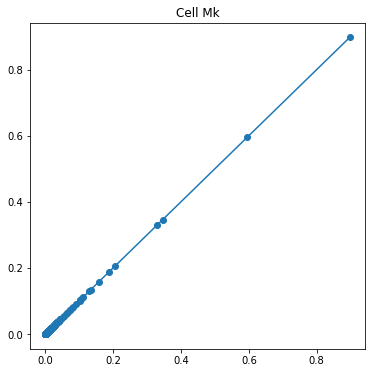

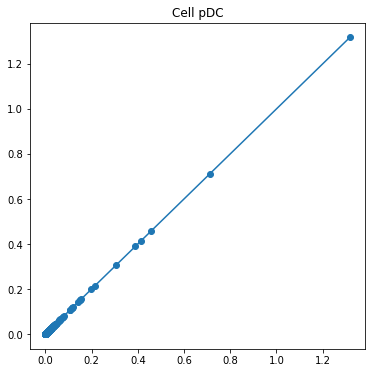

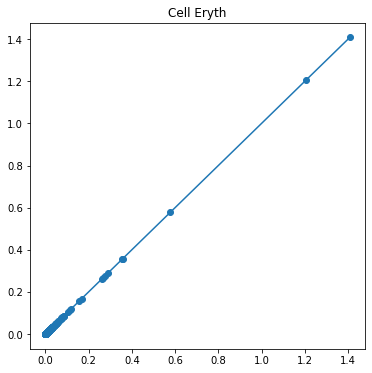

-------------------------------------------------------------------
25


Transforming to str index.


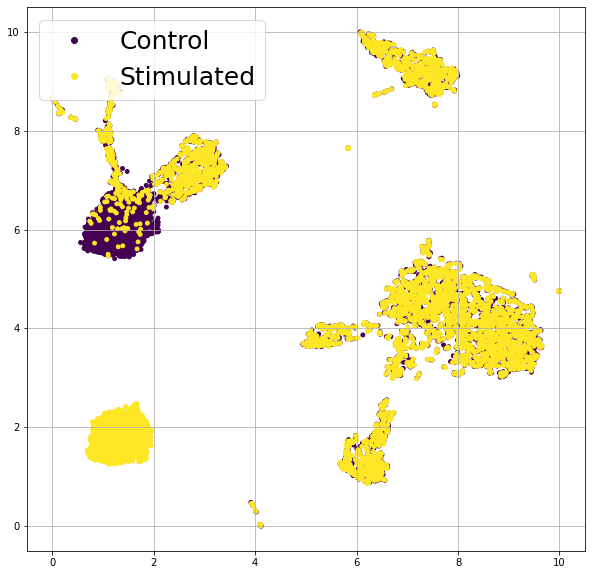

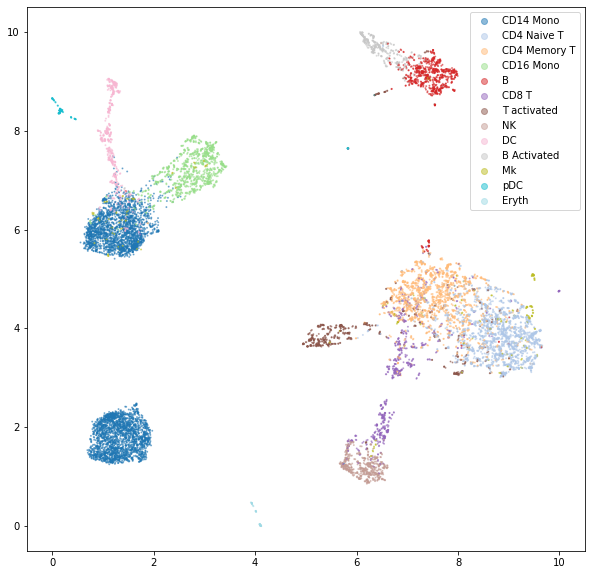

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13016/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


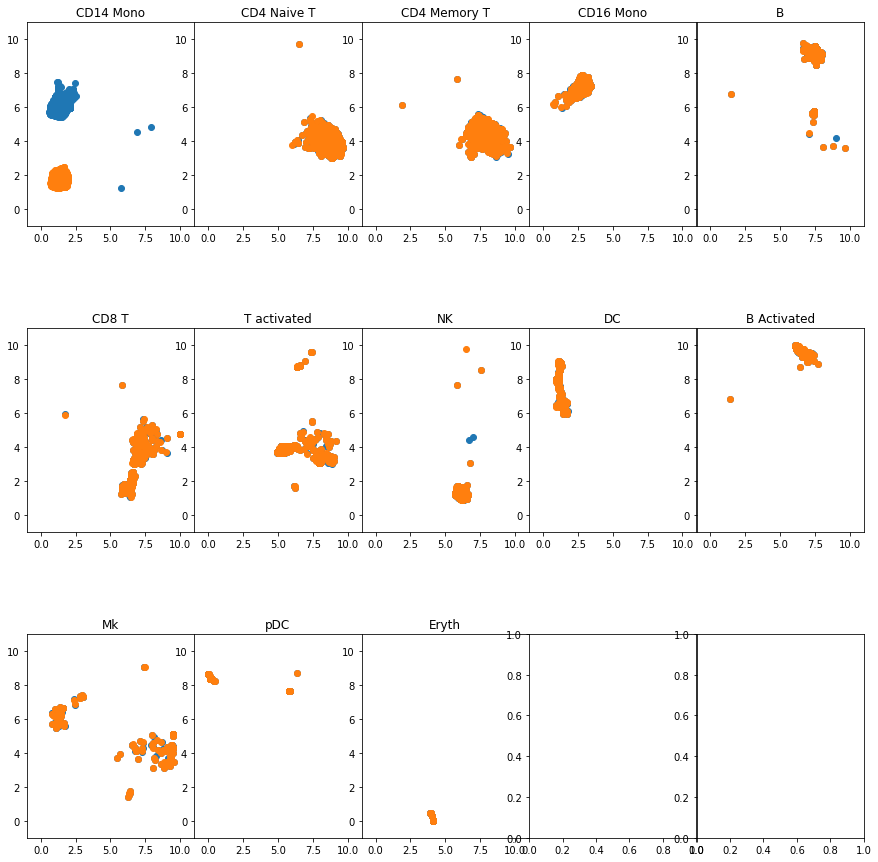

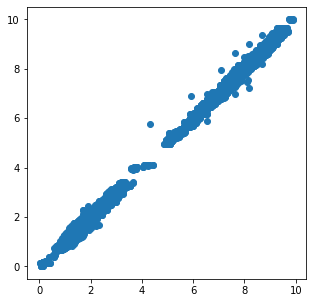

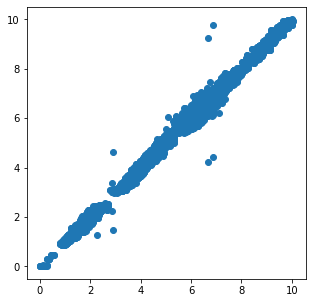

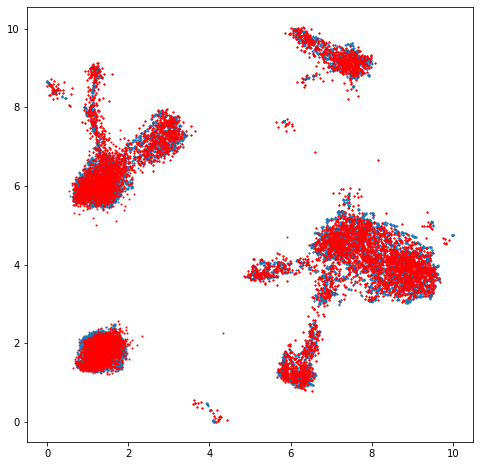

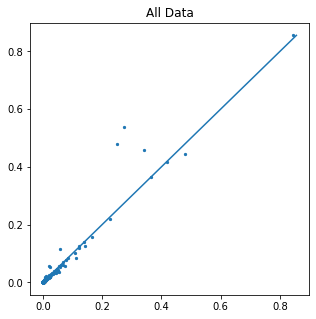

...

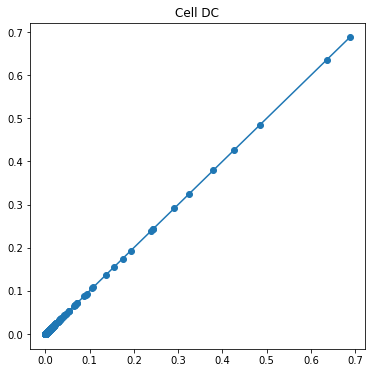

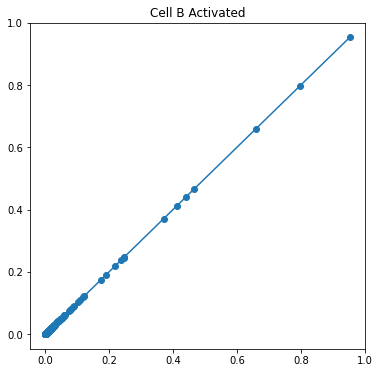

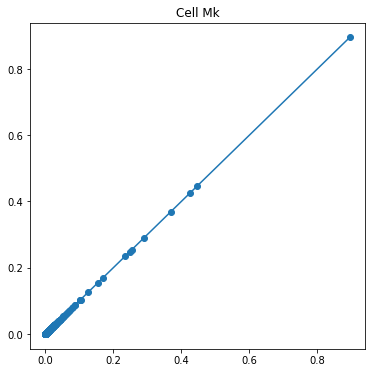

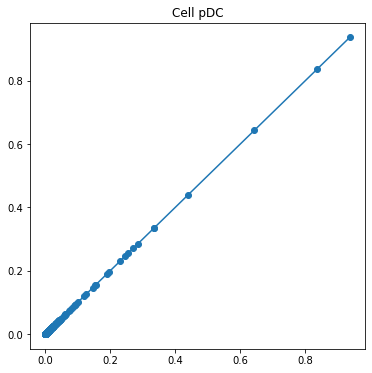

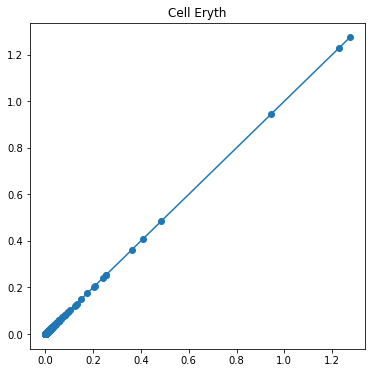

-------------------------------------------------------------------
30


Transforming to str index.


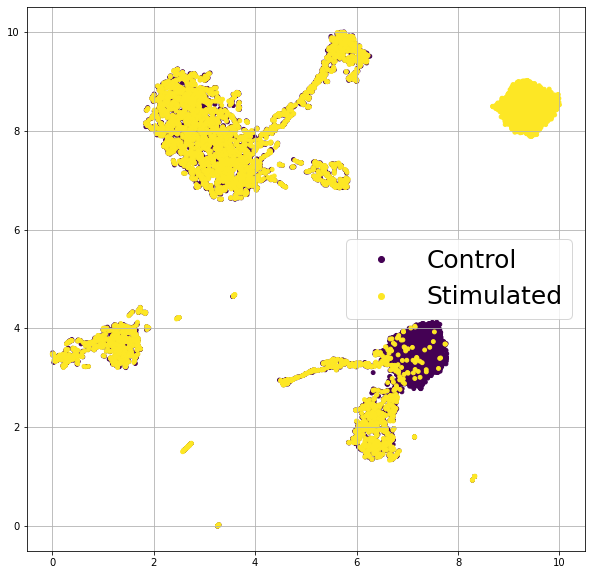

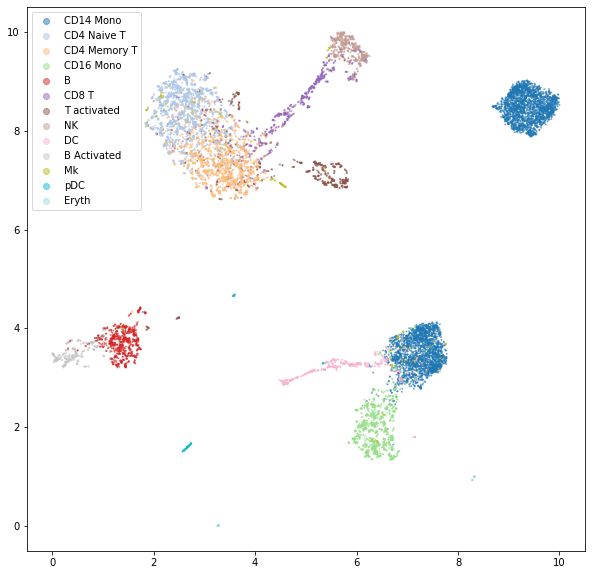

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13022/13096 [01:59<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


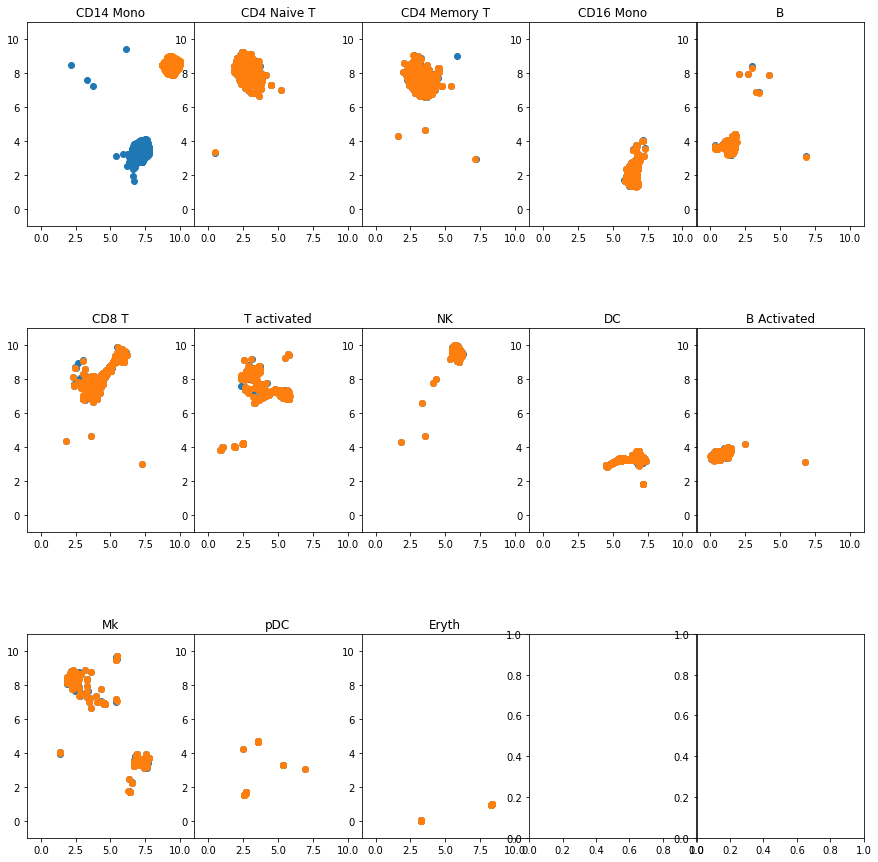

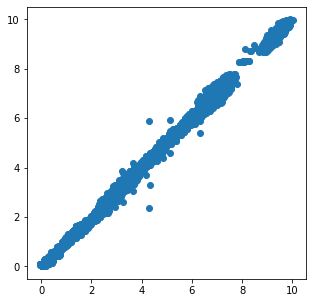

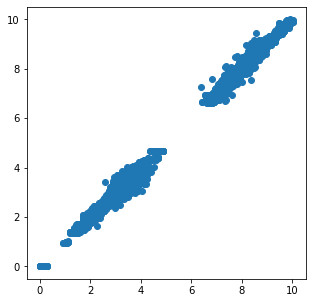

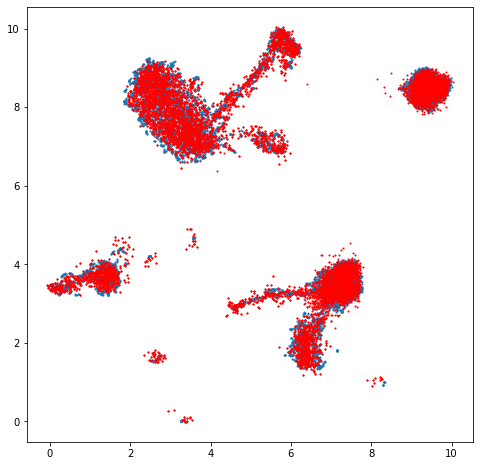

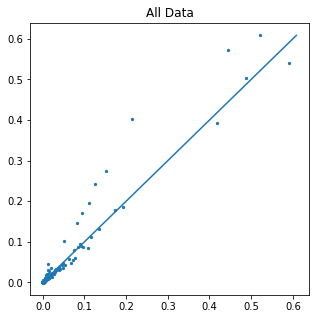

...

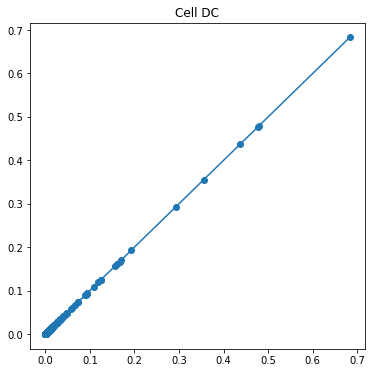

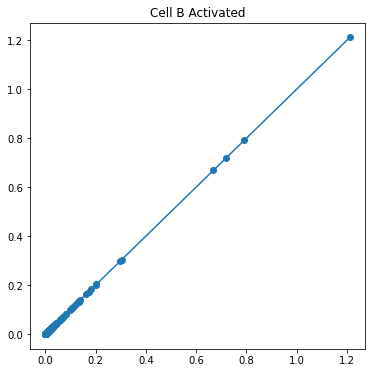

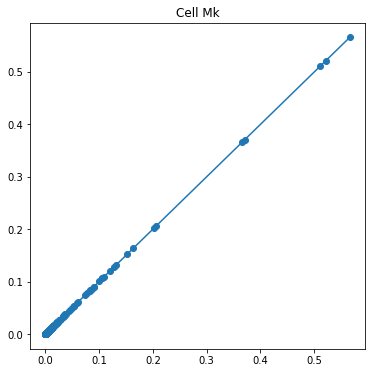

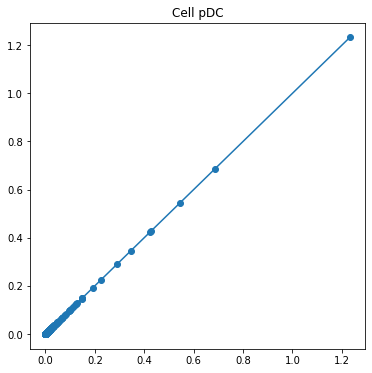

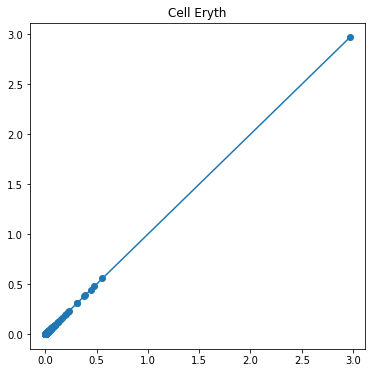

-------------------------------------------------------------------
35


Transforming to str index.


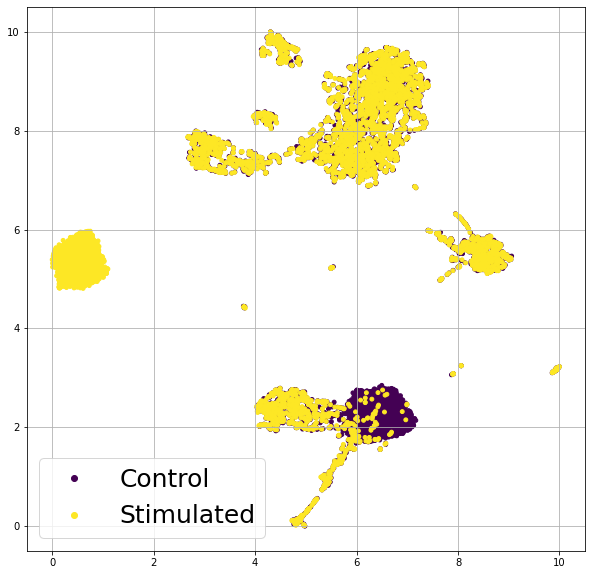

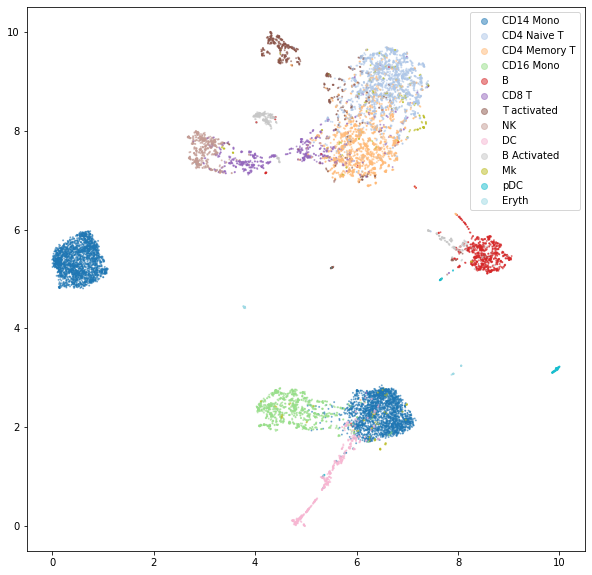

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13070/13096 [02:08<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


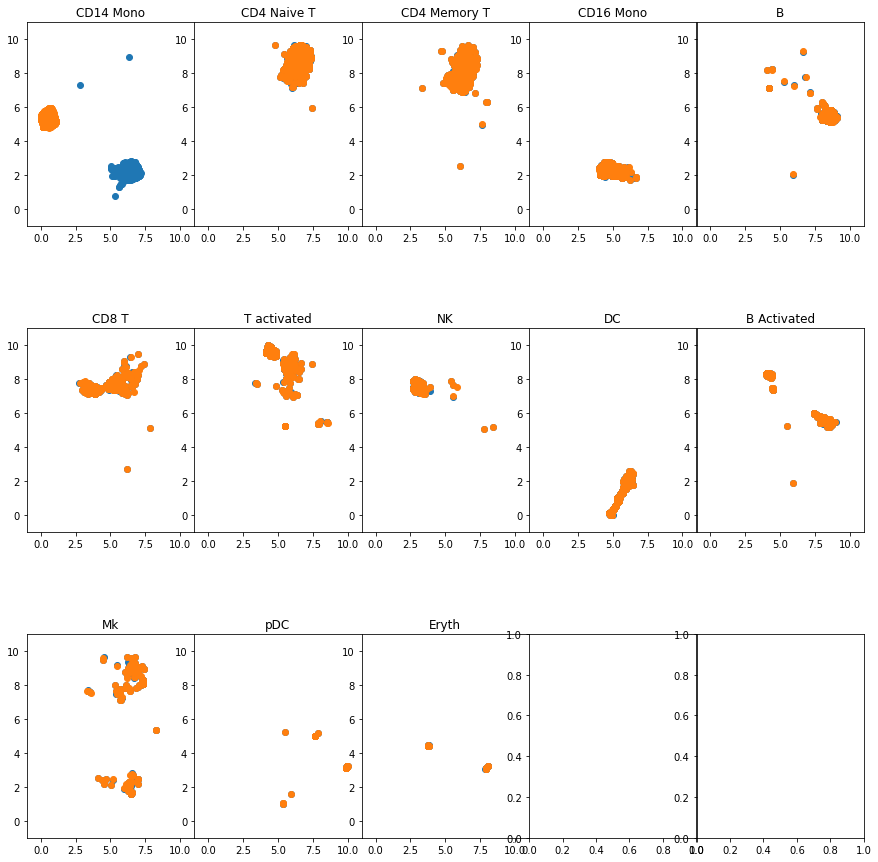

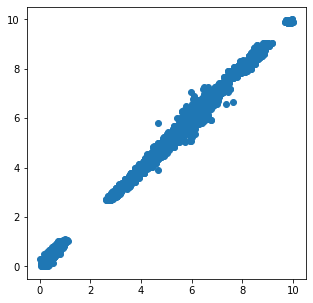

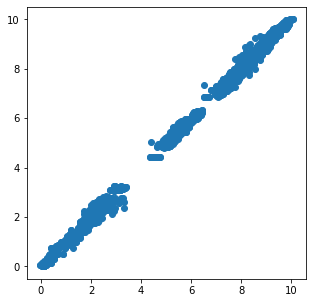

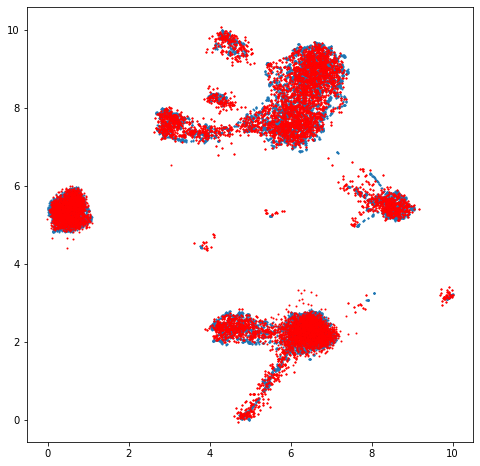

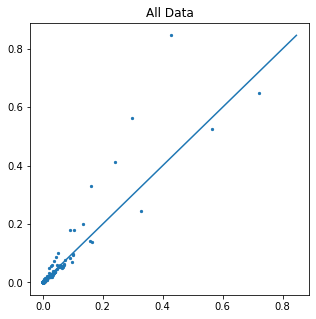

...

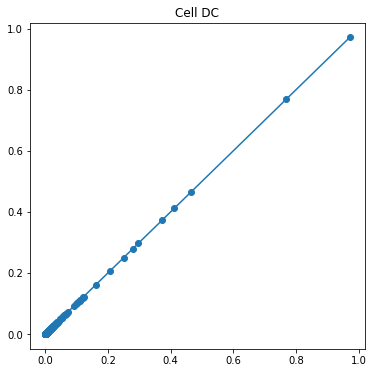

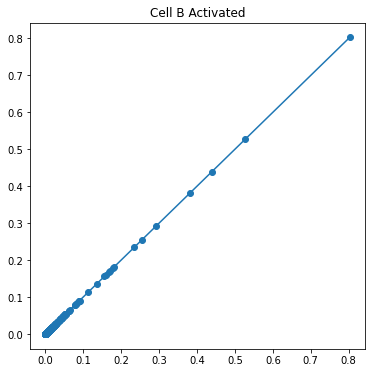

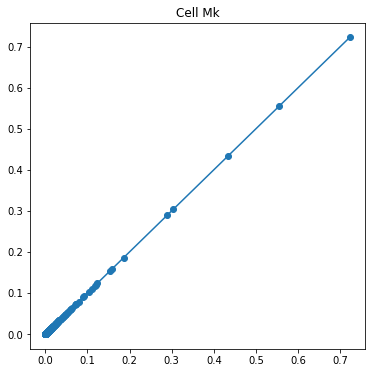

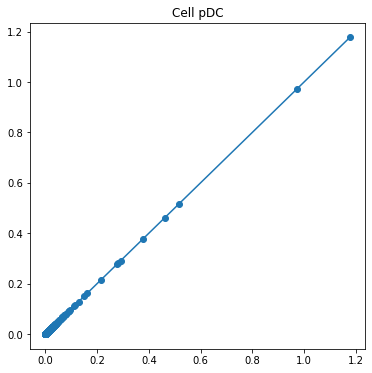

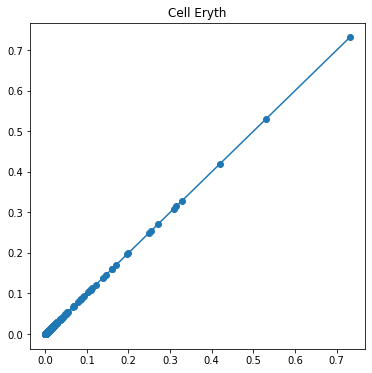

-------------------------------------------------------------------
40


Transforming to str index.


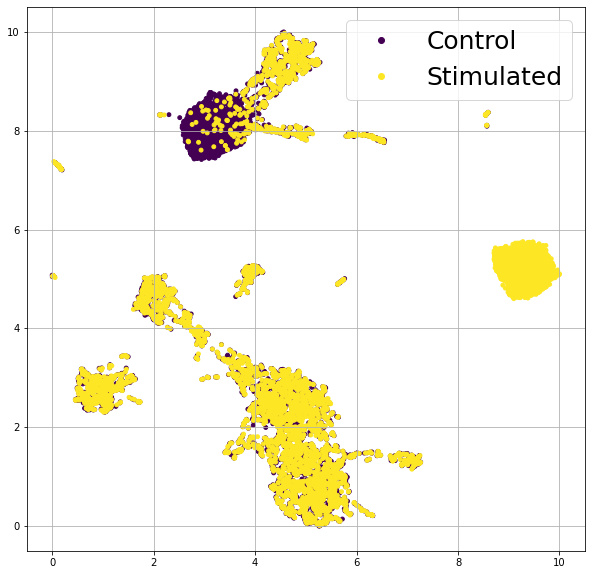

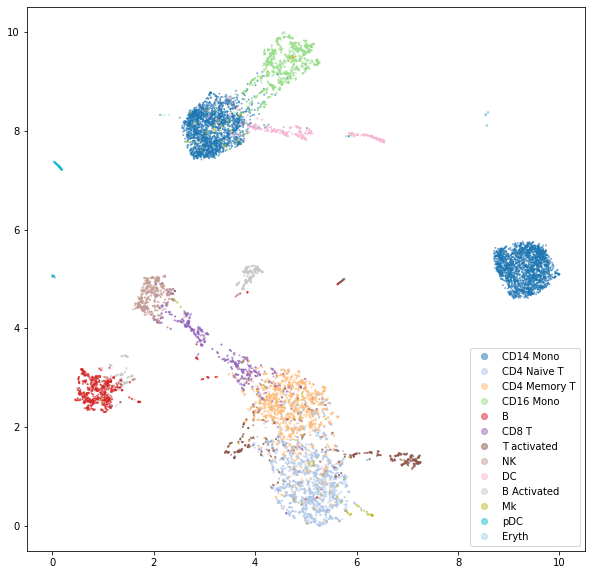

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13016/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


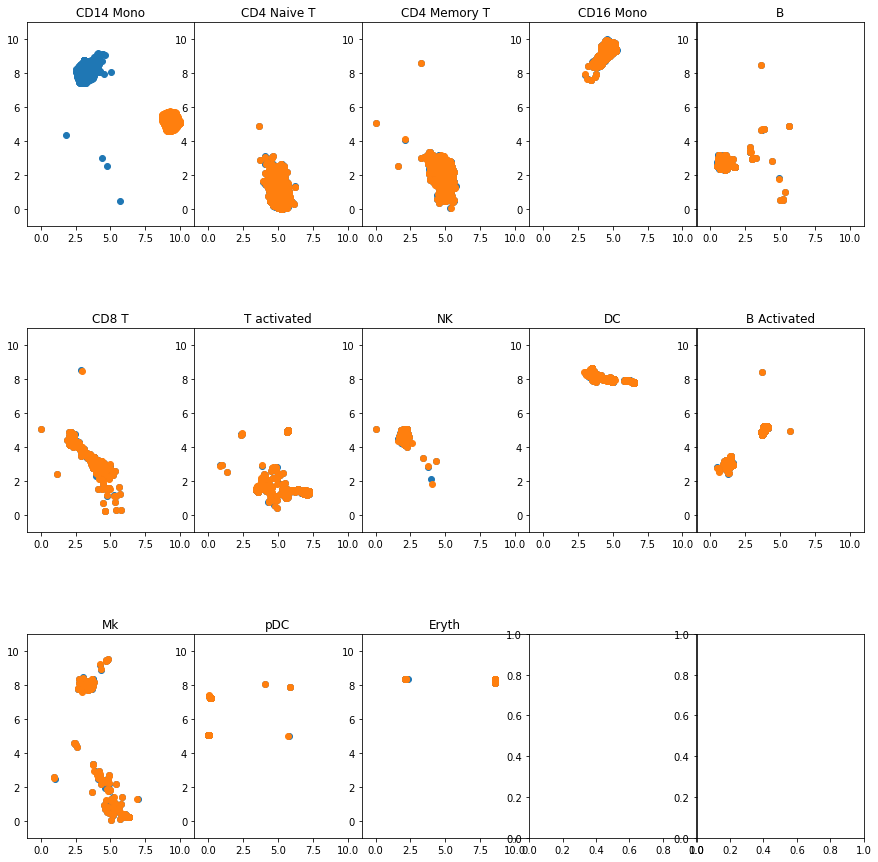

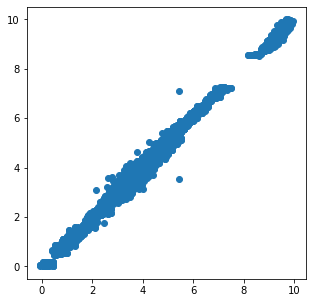

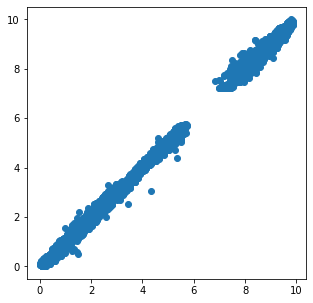

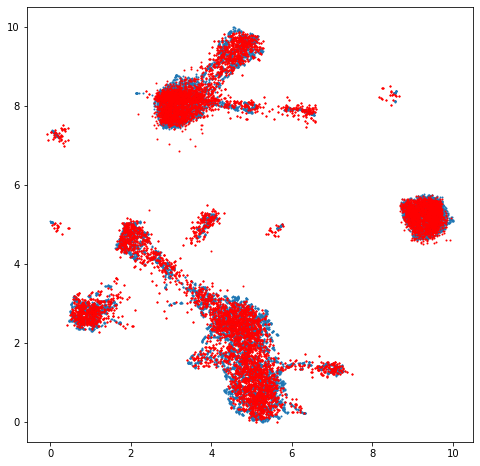

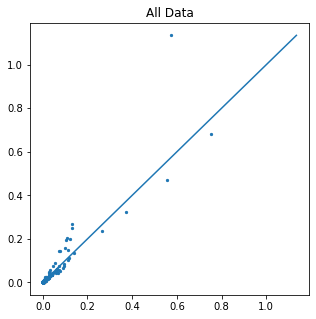

...

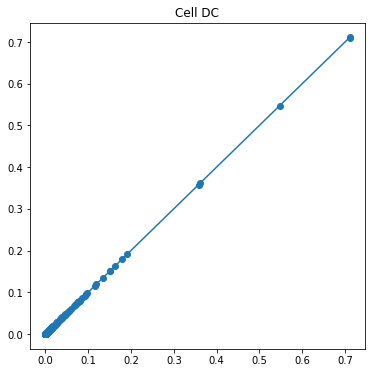

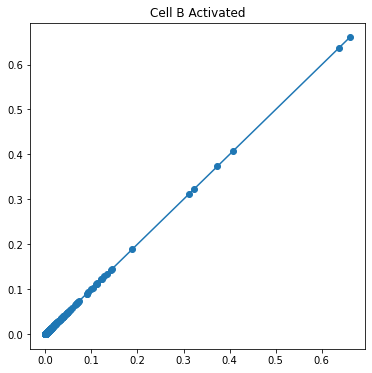

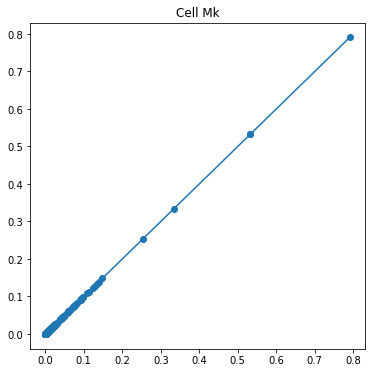

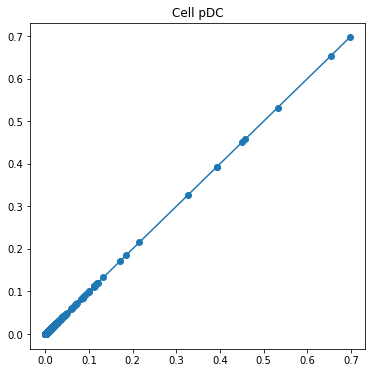

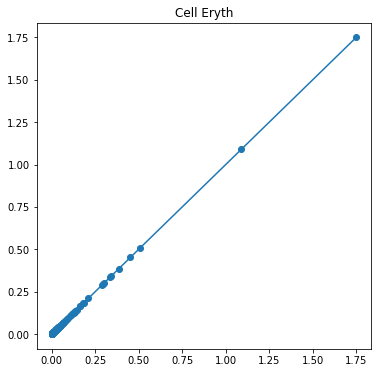

-------------------------------------------------------------------
45


Transforming to str index.


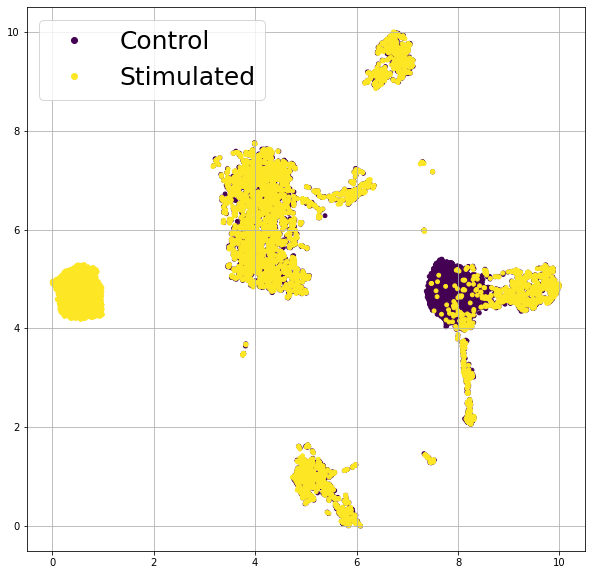

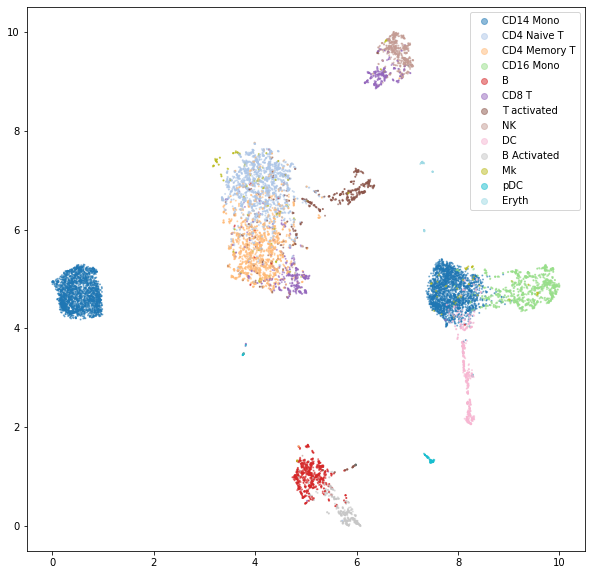

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13061/13096 [02:10<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


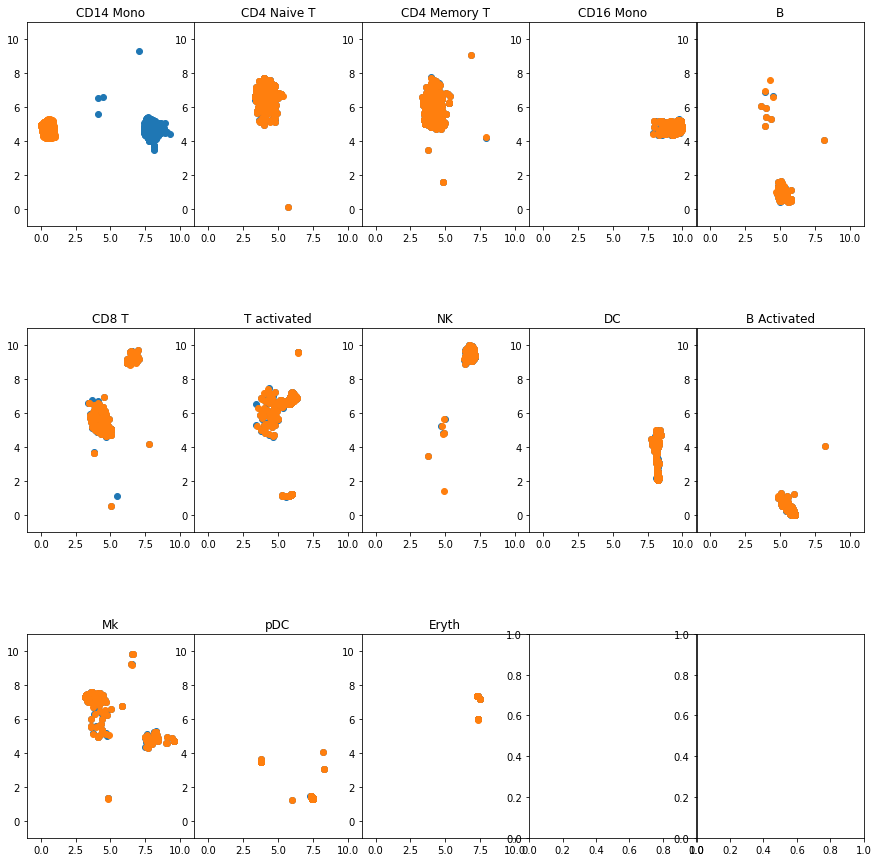

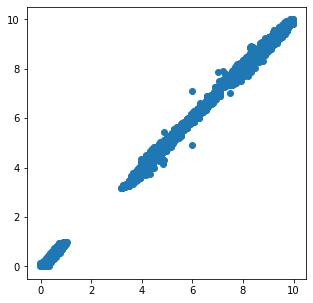

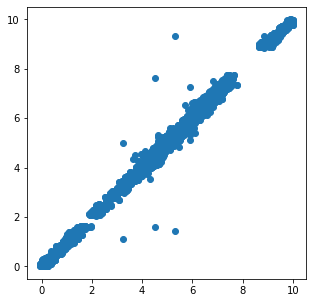

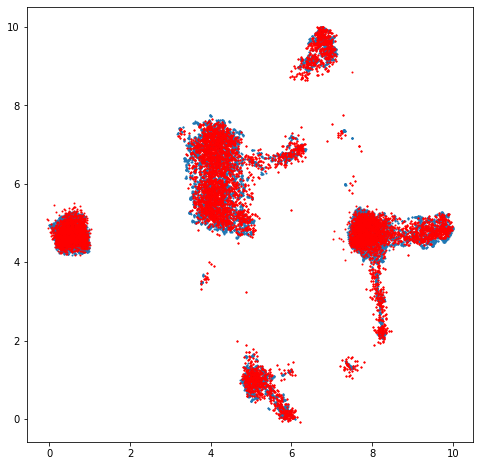

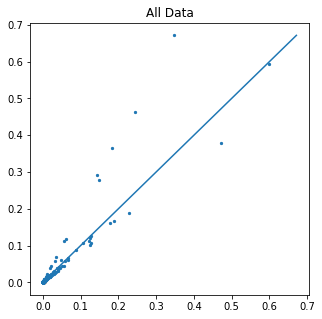

...

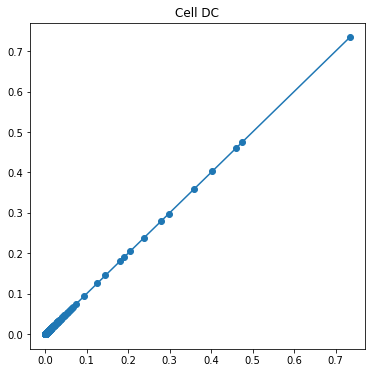

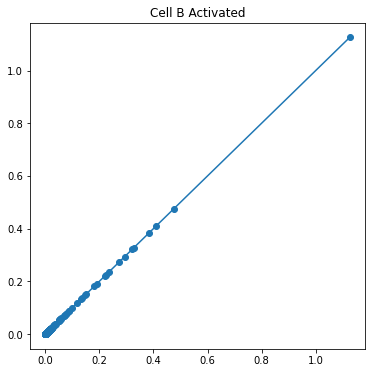

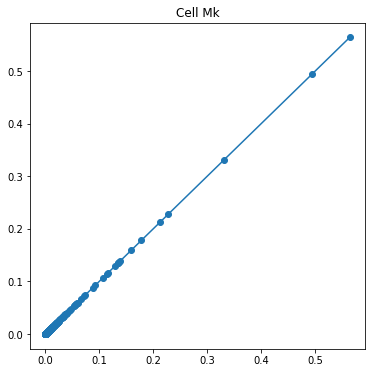

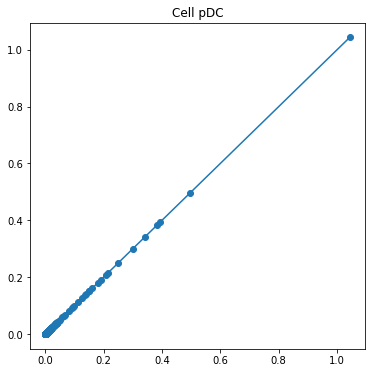

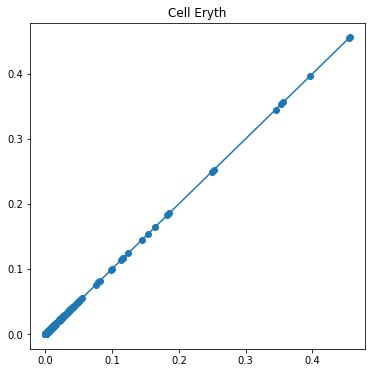

-------------------------------------------------------------------
50


Transforming to str index.


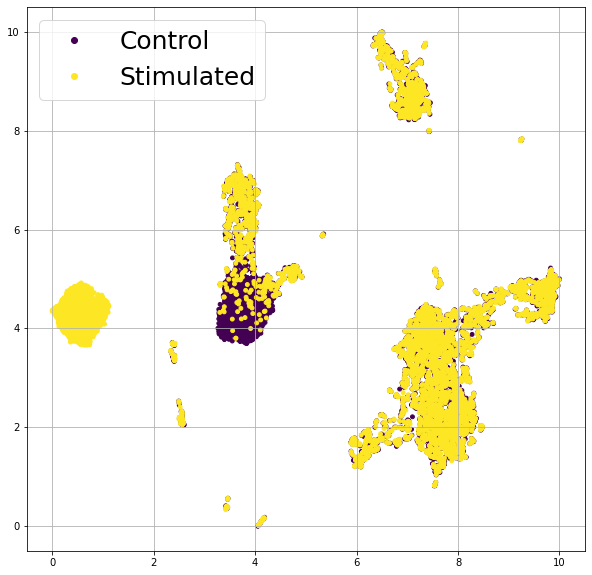

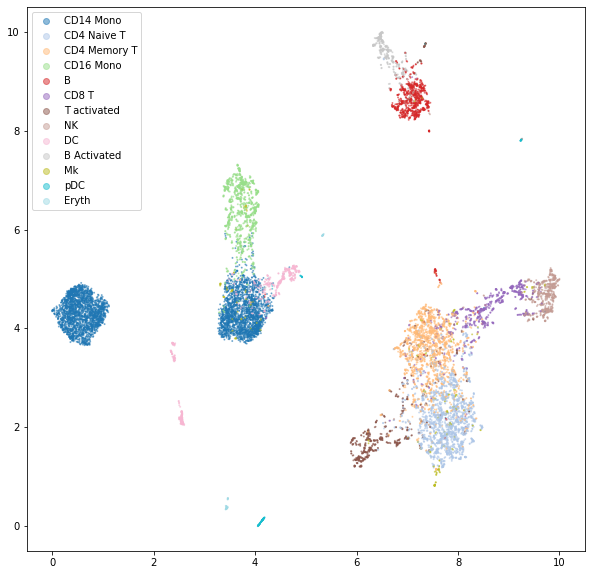

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13053/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


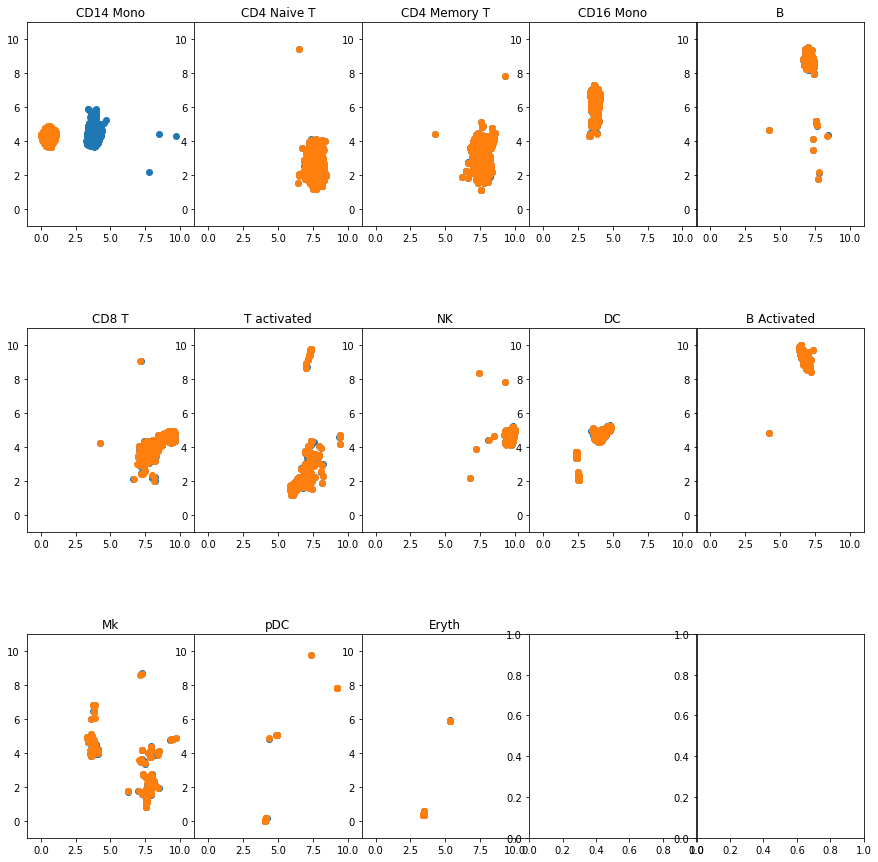

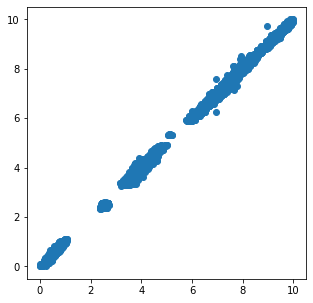

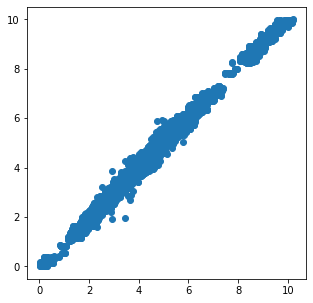

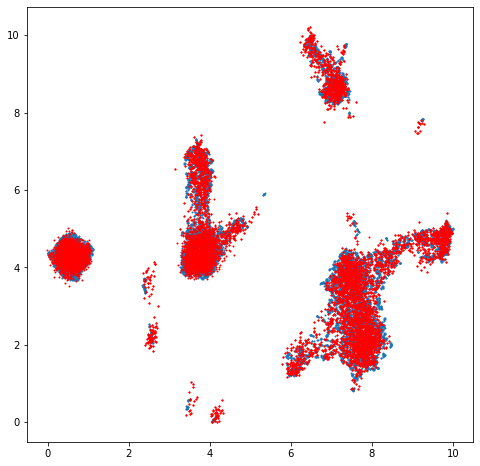

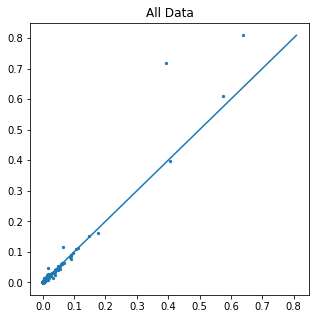

...

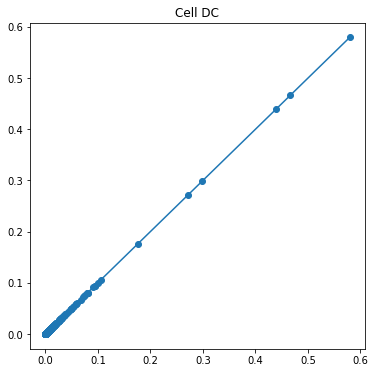

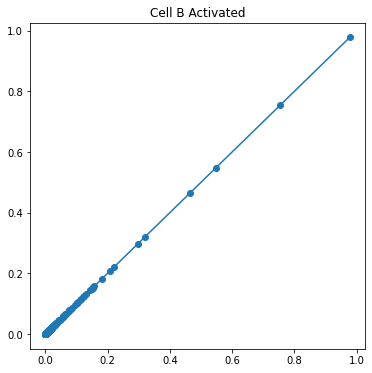

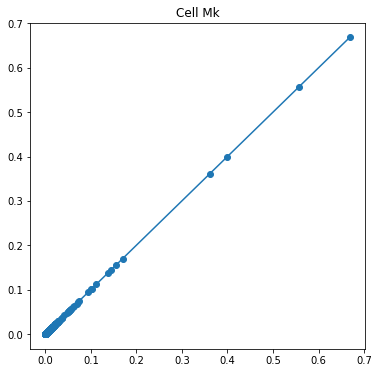

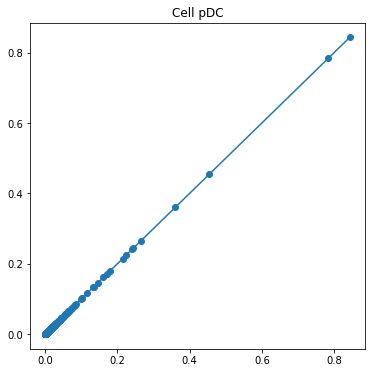

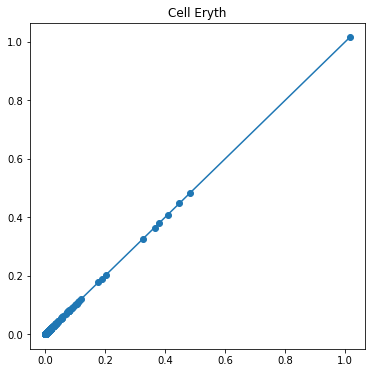

-------------------------------------------------------------------


is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


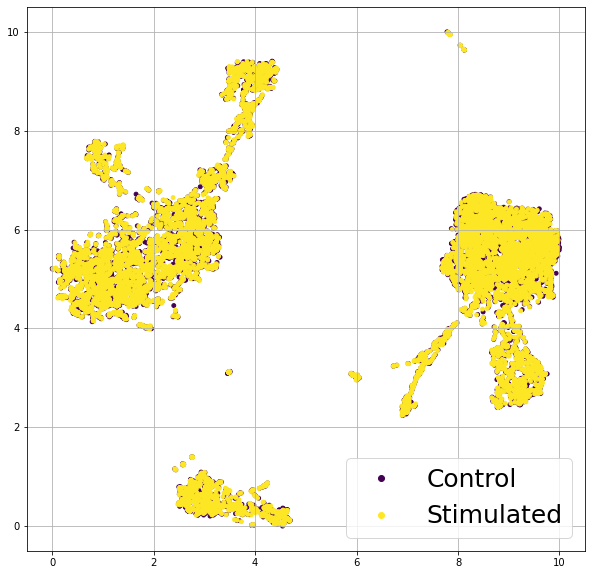

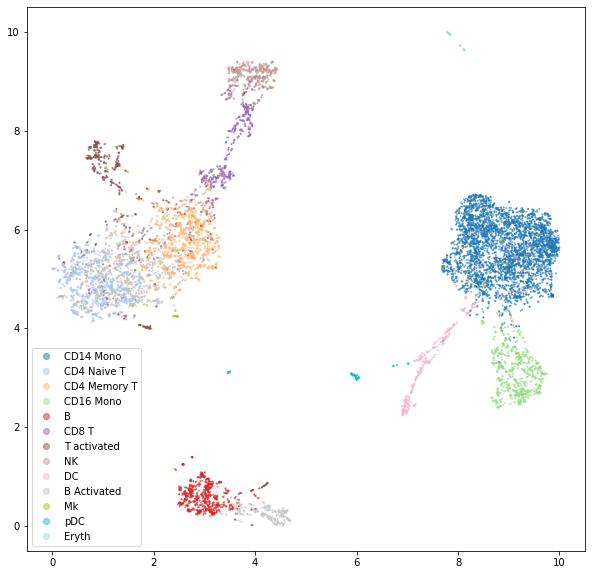

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13020/13096 [02:14<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


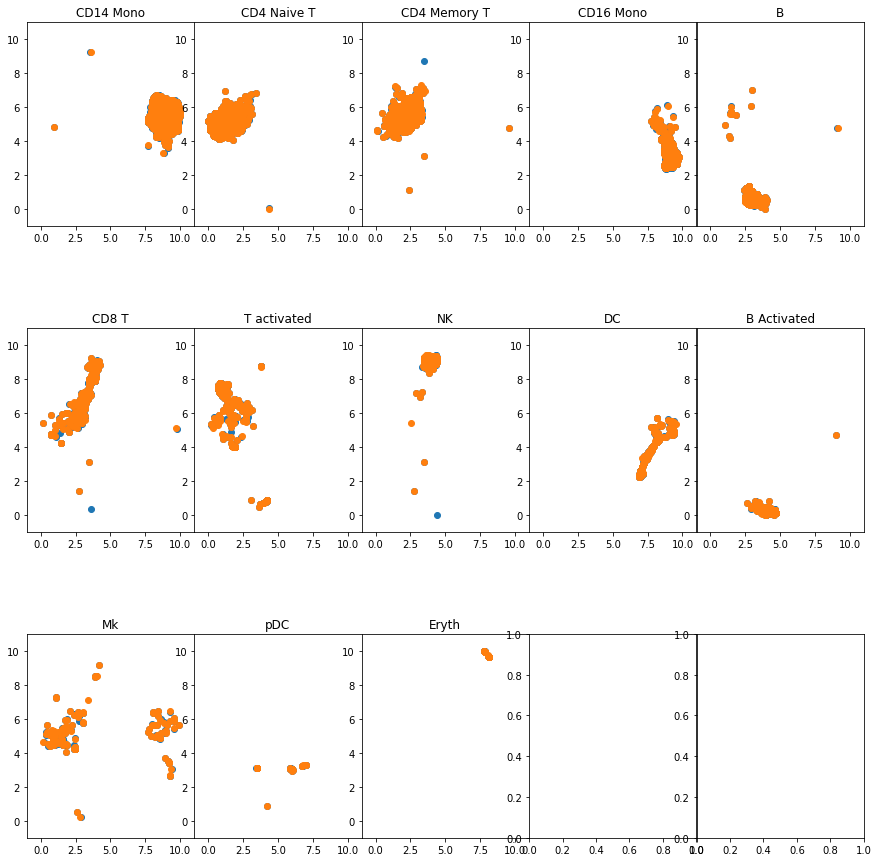

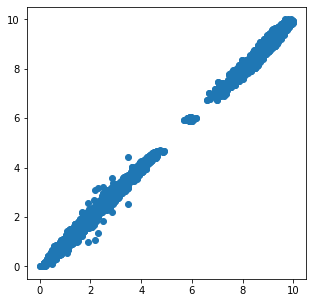

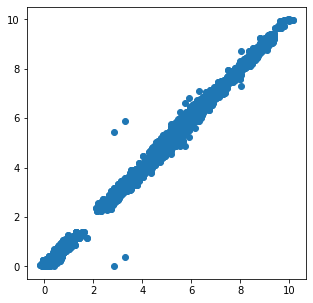

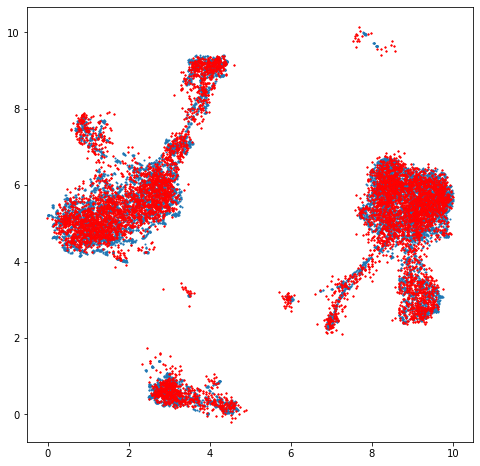

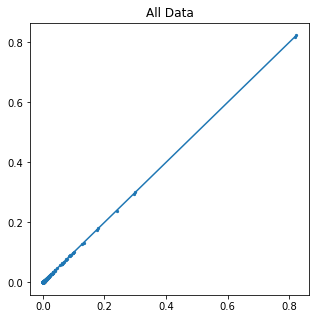

...

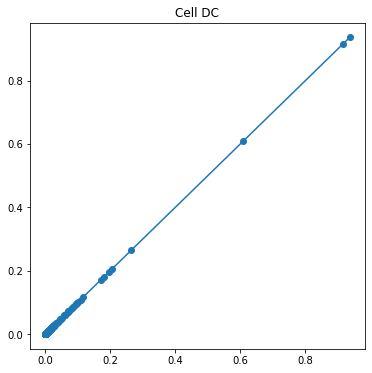

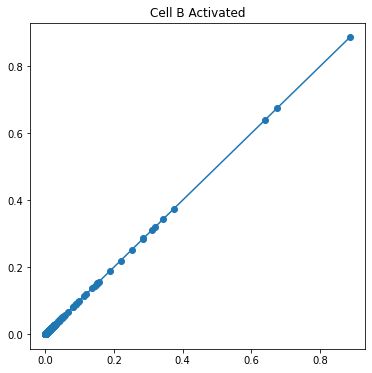

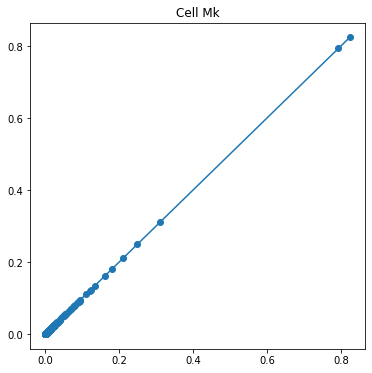

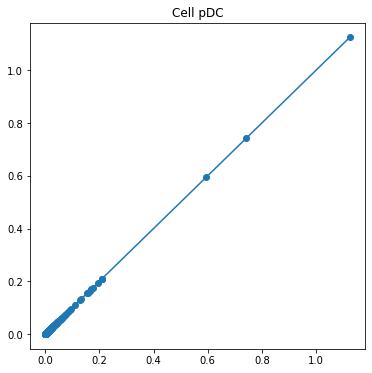

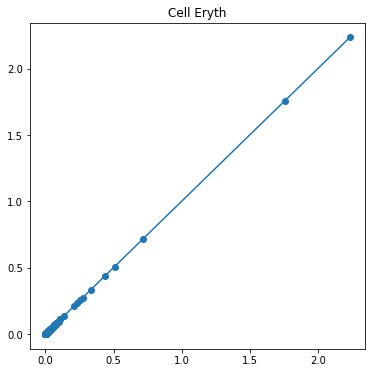

-------------------------------------------------------------------
5


Transforming to str index.


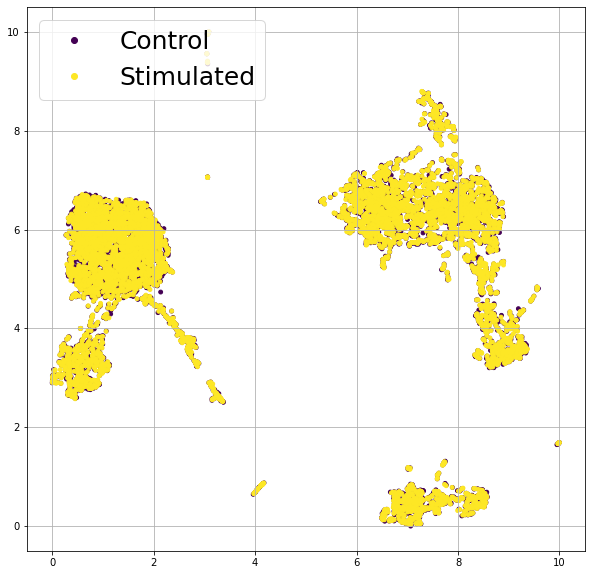

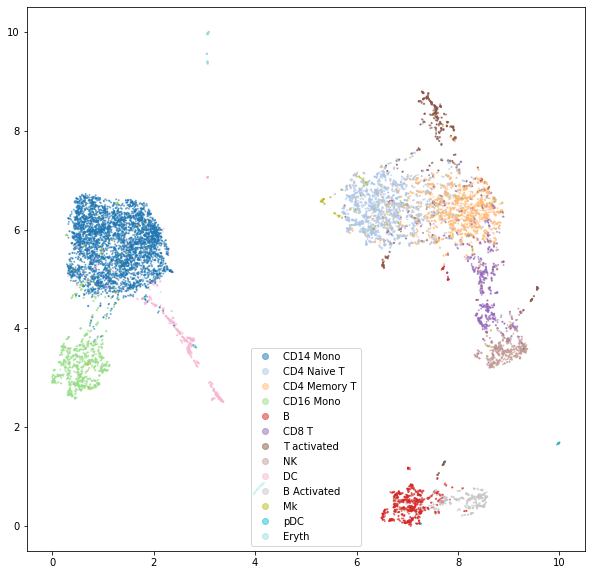

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13094/13096 [02:09<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


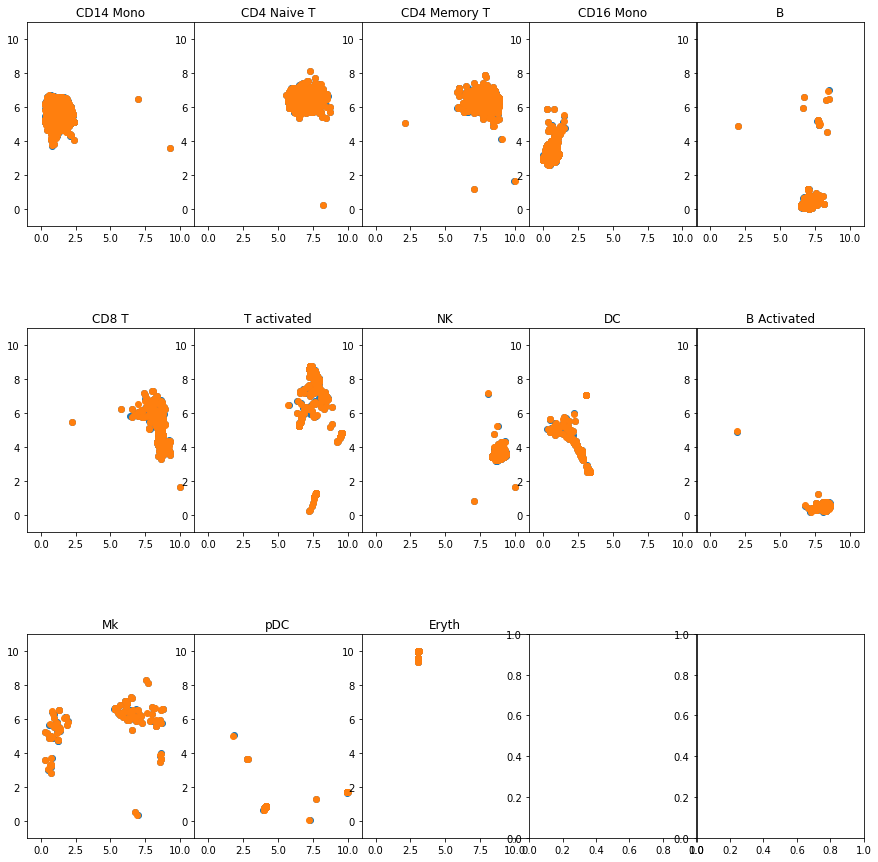

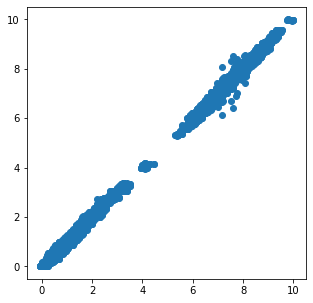

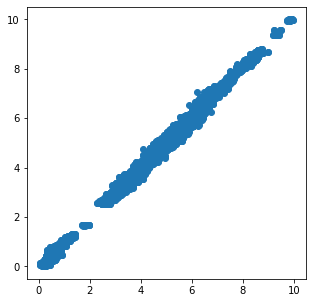

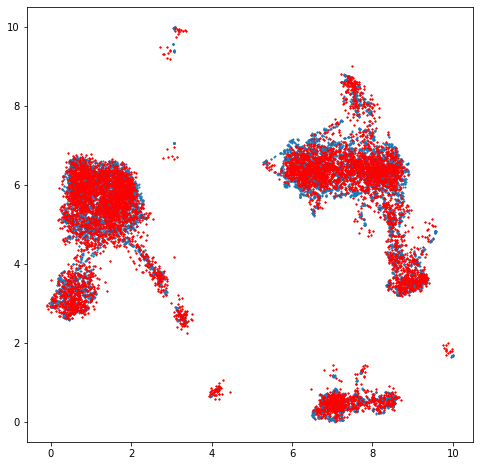

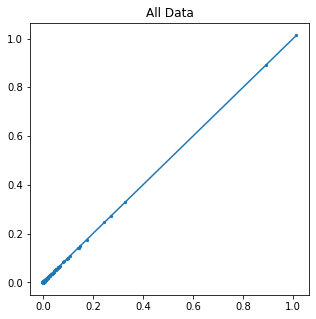

...

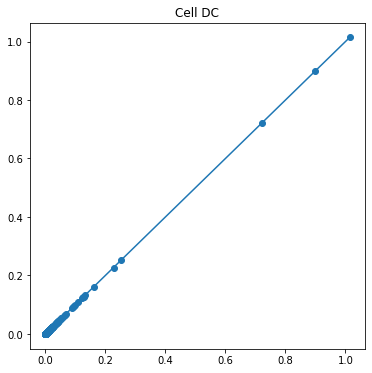

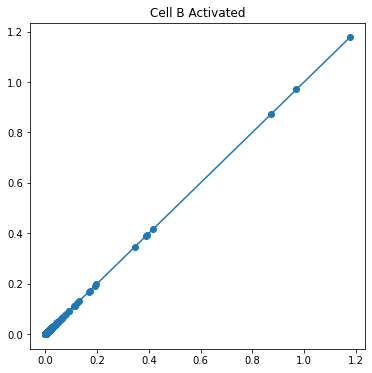

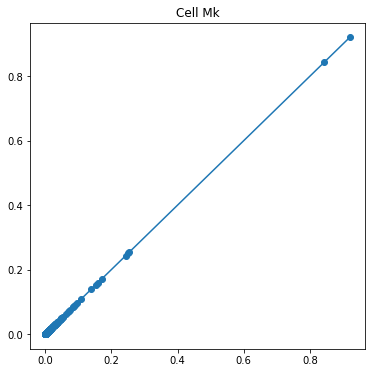

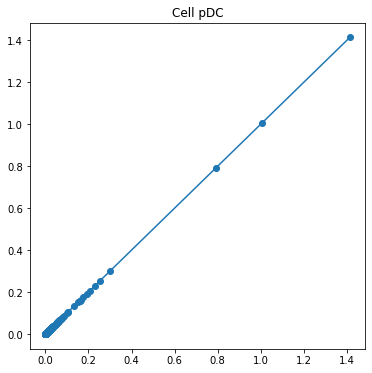

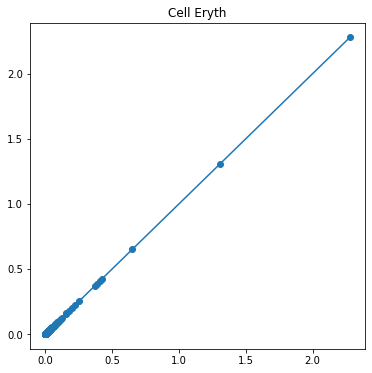

-------------------------------------------------------------------
10


Transforming to str index.


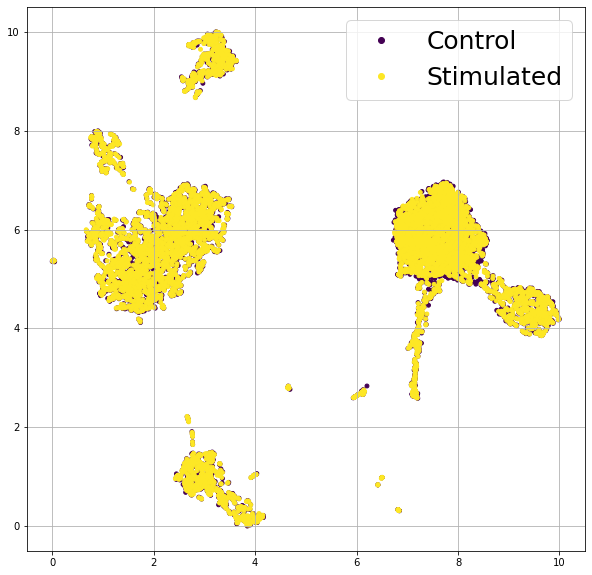

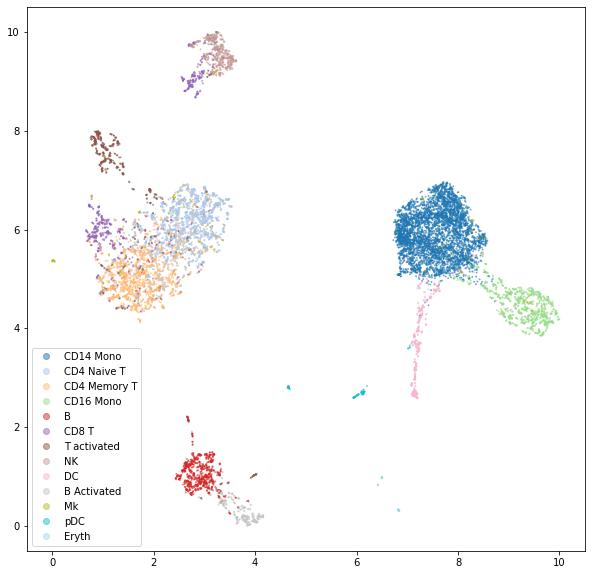

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13030/13096 [02:14<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


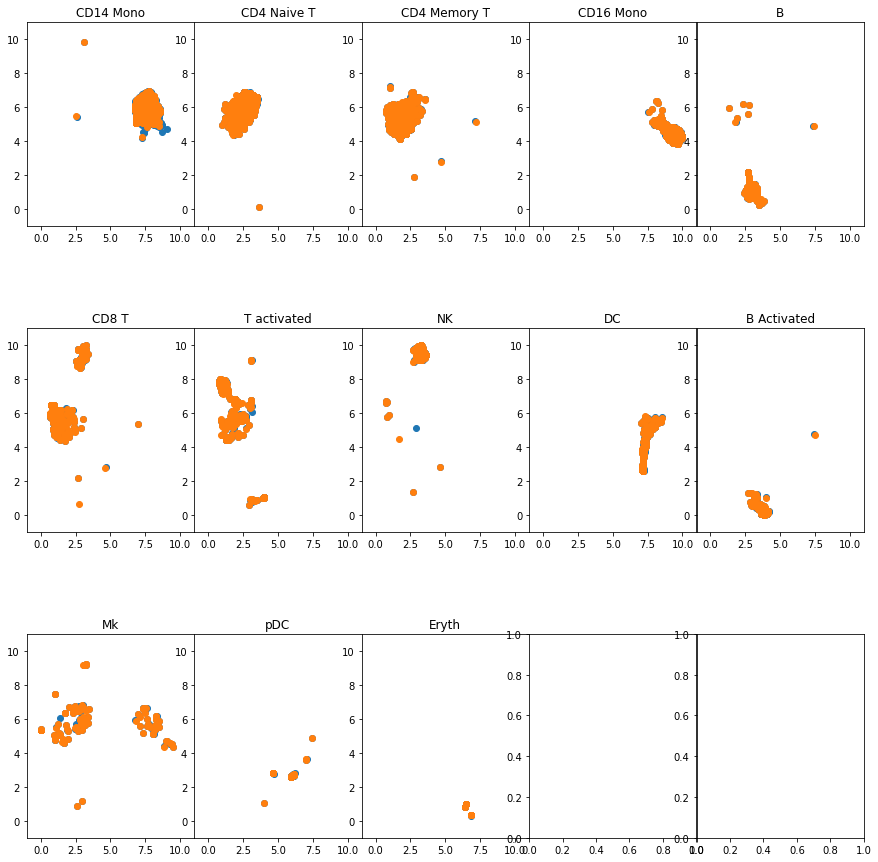

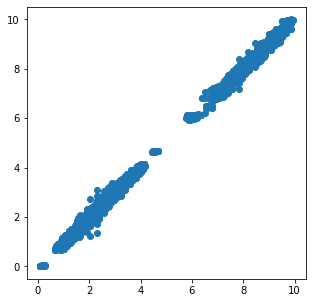

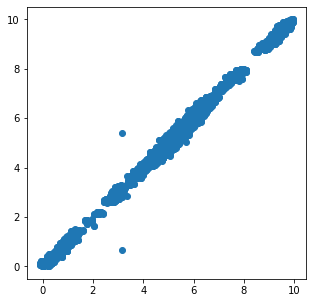

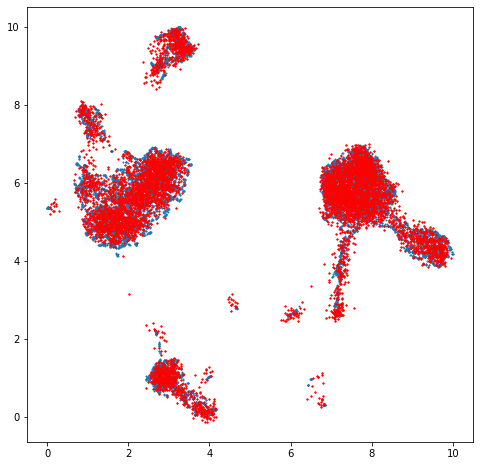

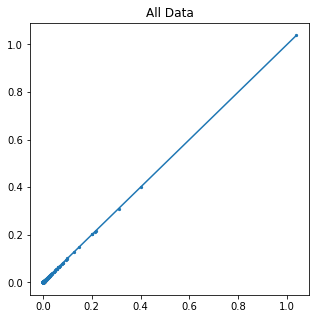

...

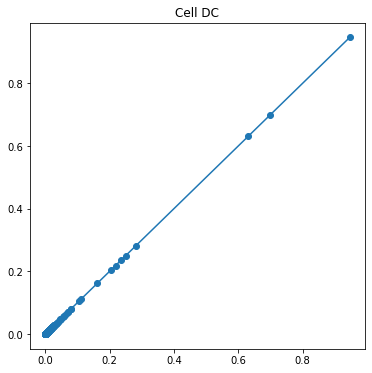

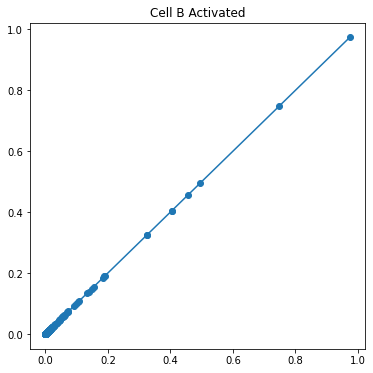

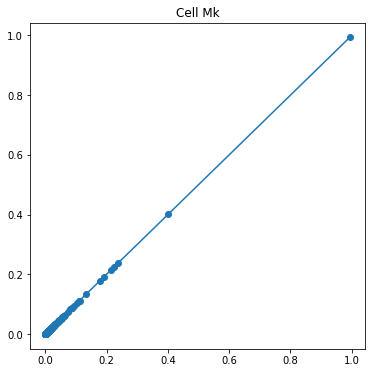

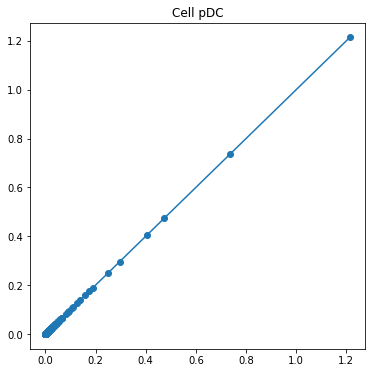

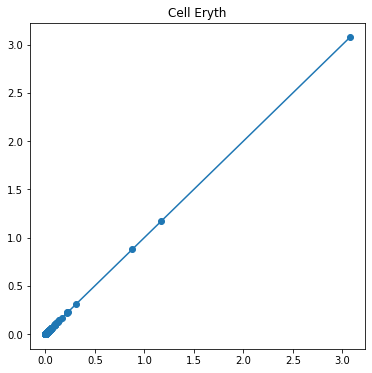

-------------------------------------------------------------------
15


Transforming to str index.


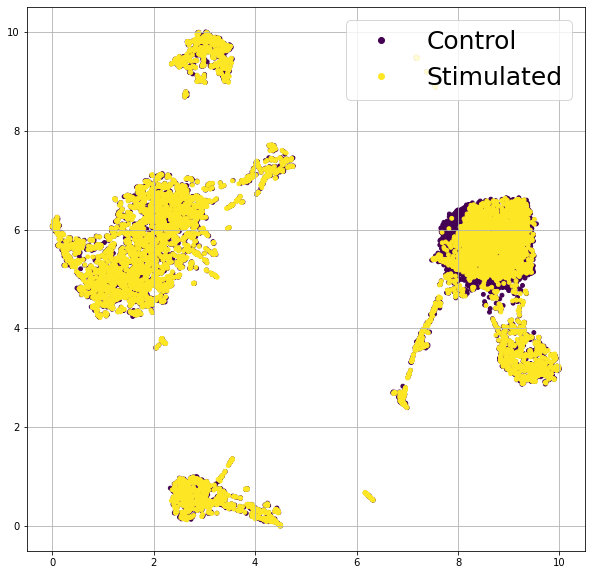

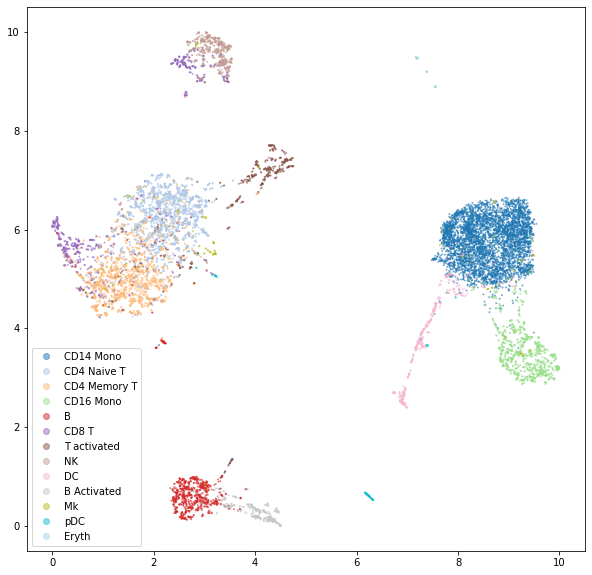

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13003/13096 [02:08<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


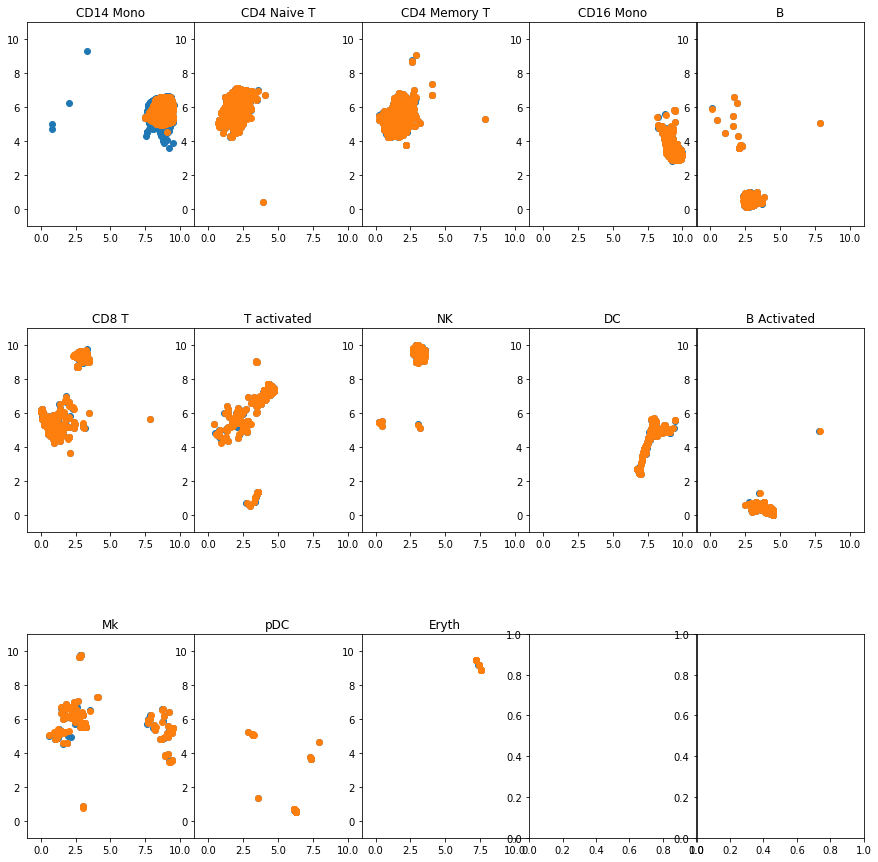

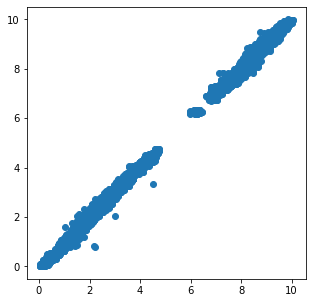

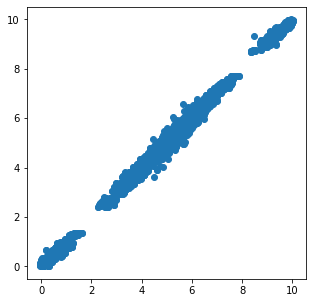

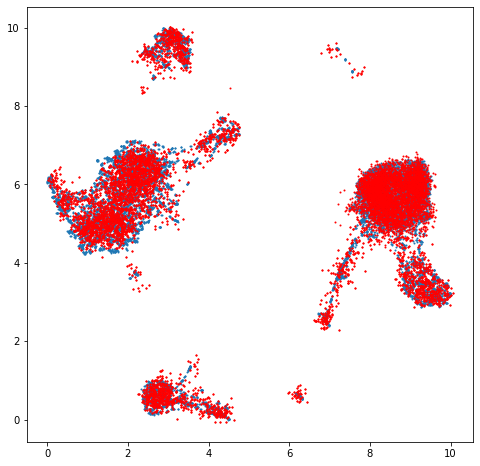

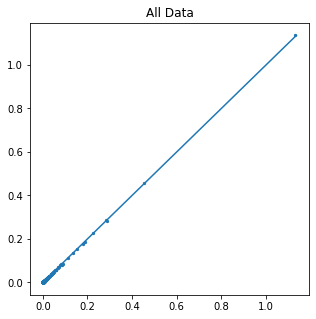

...

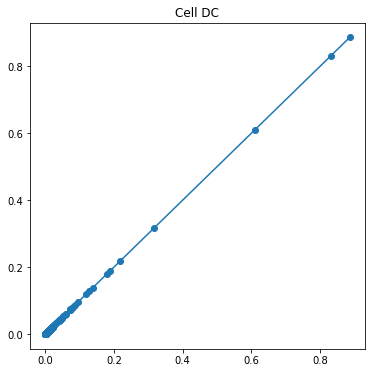

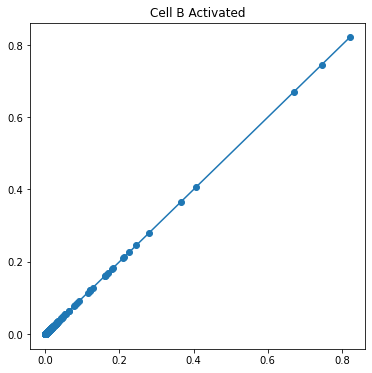

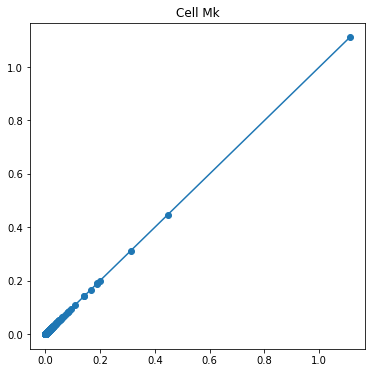

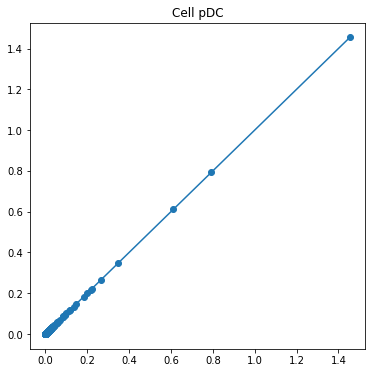

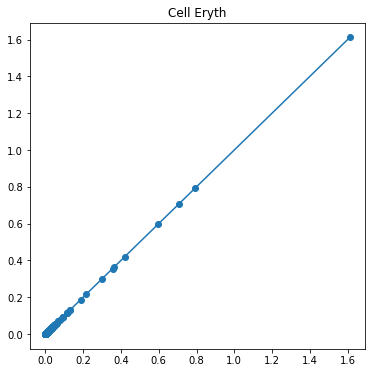

-------------------------------------------------------------------
20


Transforming to str index.


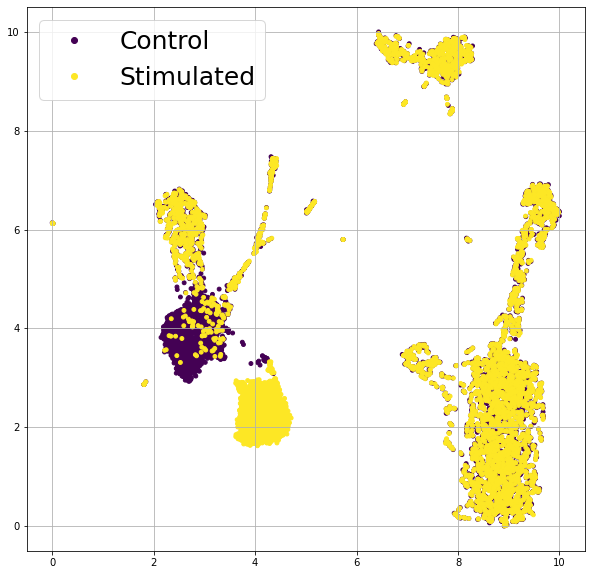

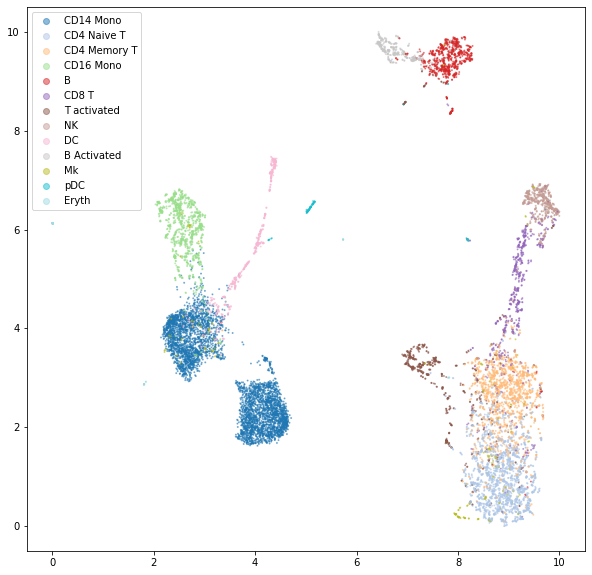

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13093/13096 [02:05<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


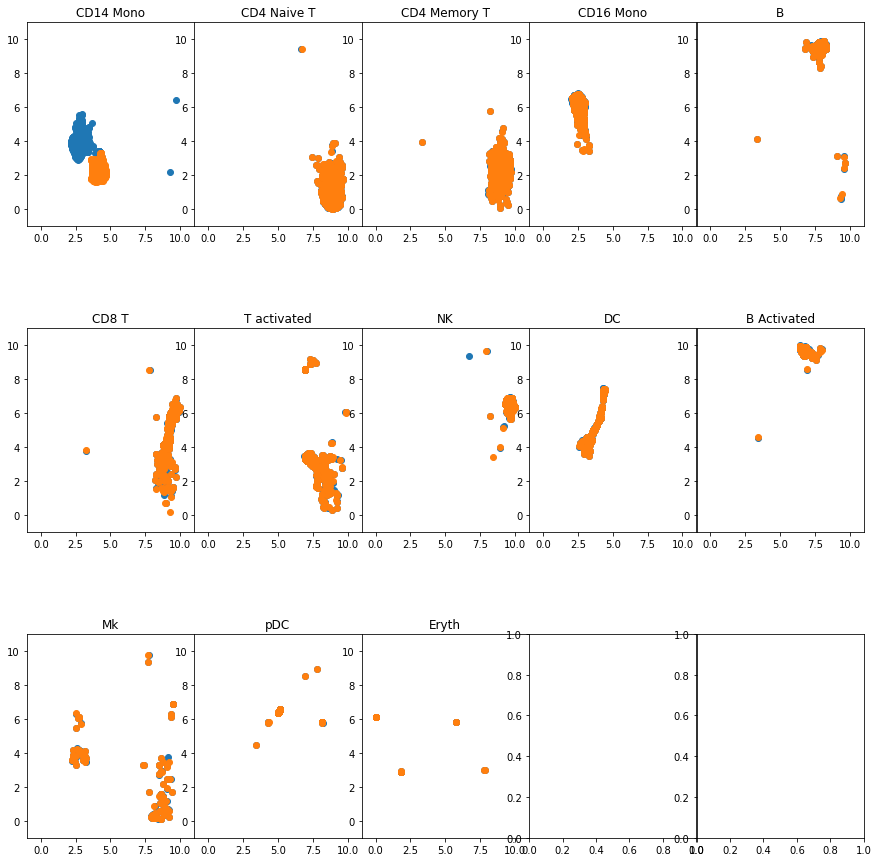

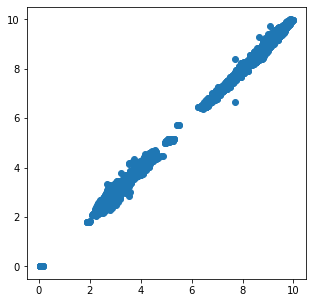

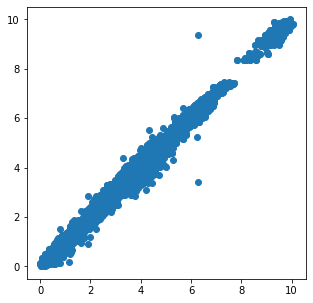

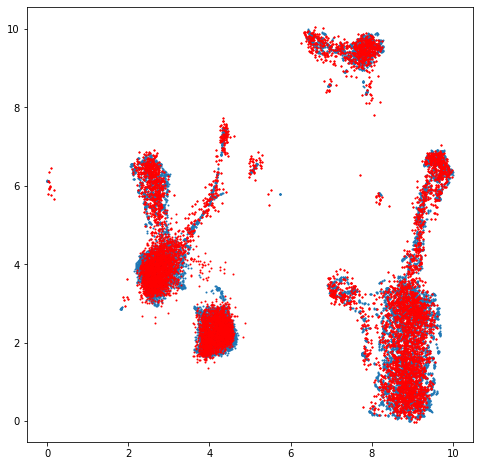

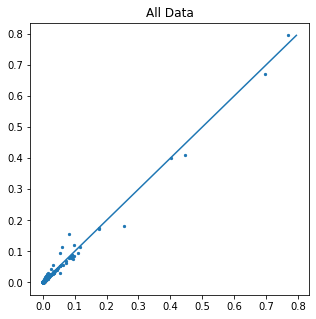

...

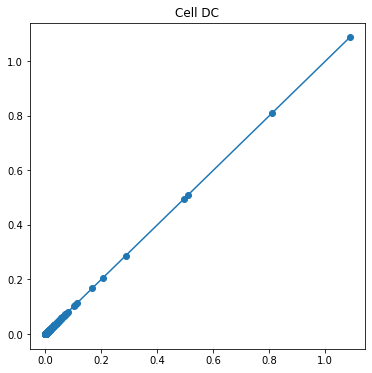

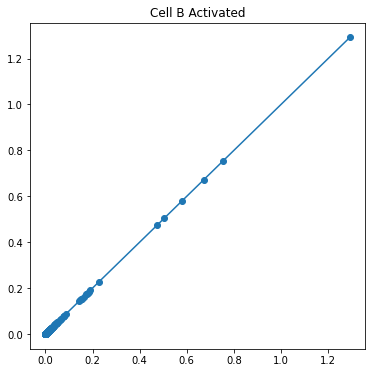

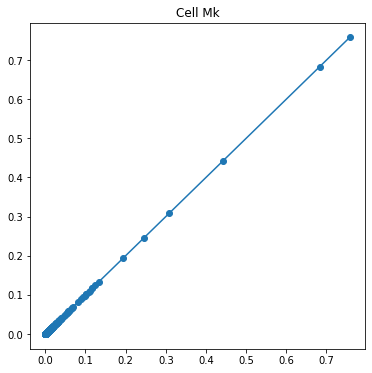

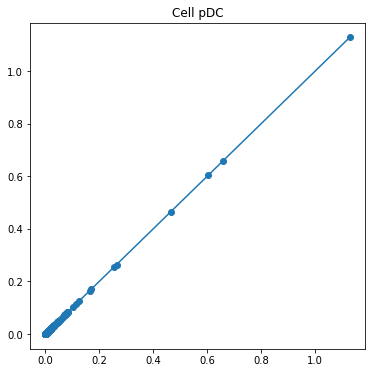

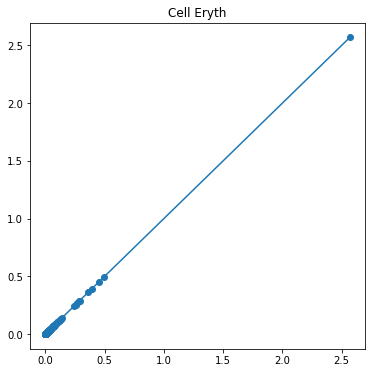

-------------------------------------------------------------------
25


Transforming to str index.


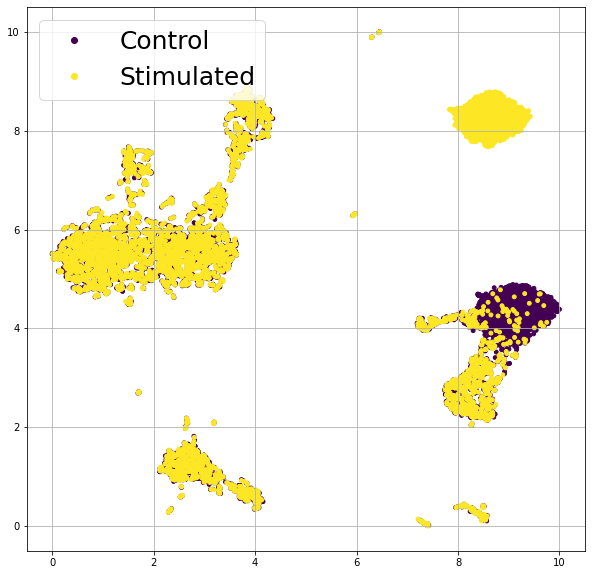

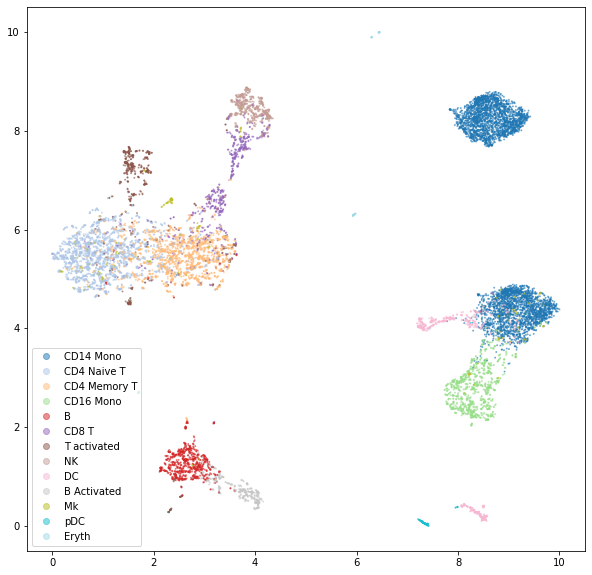

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13032/13096 [02:07<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


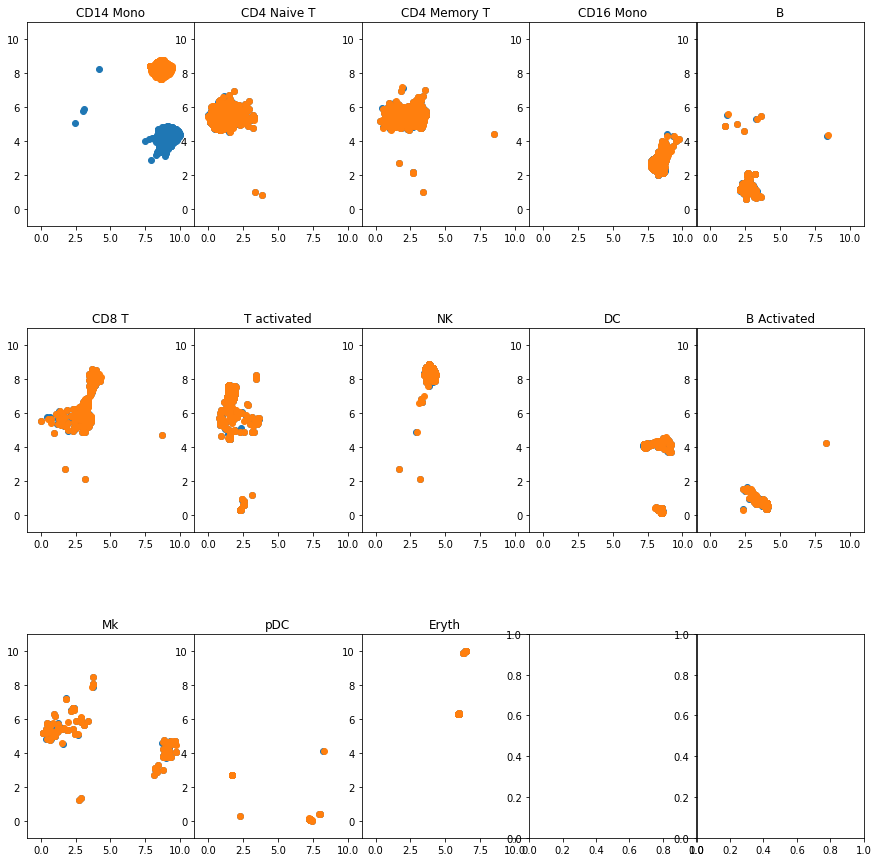

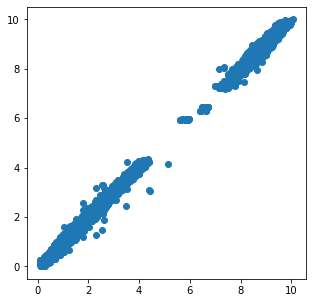

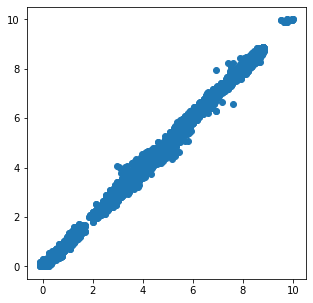

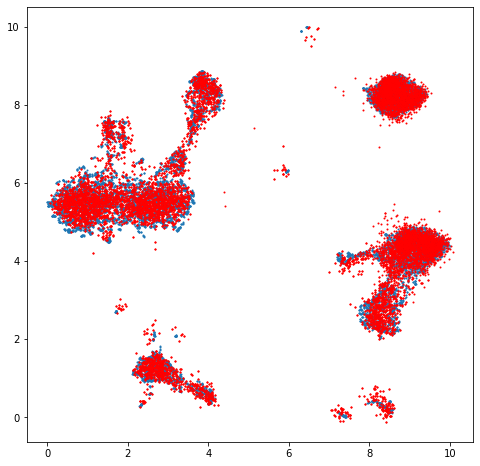

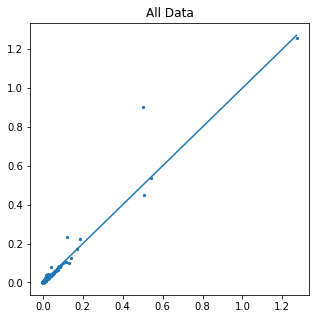

...

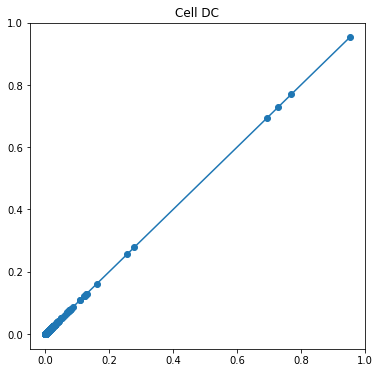

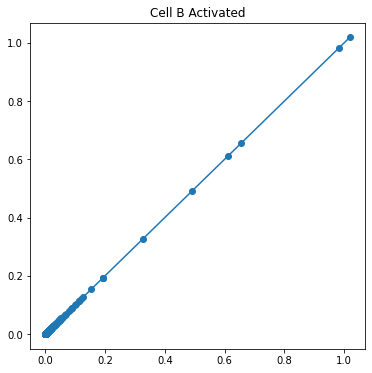

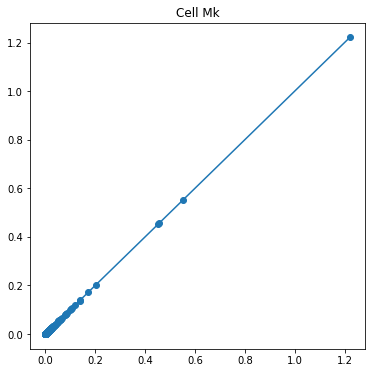

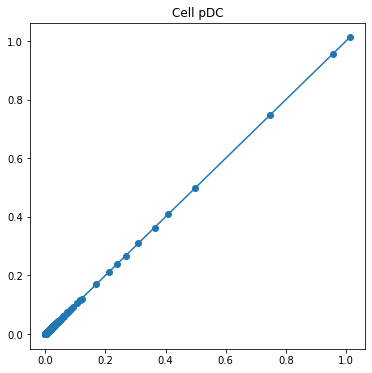

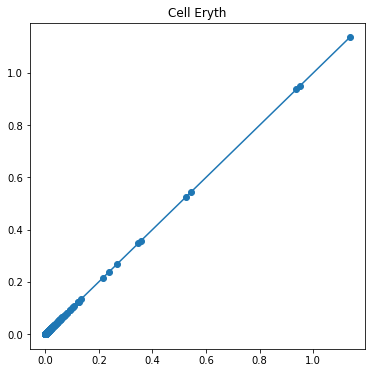

-------------------------------------------------------------------
30


Transforming to str index.


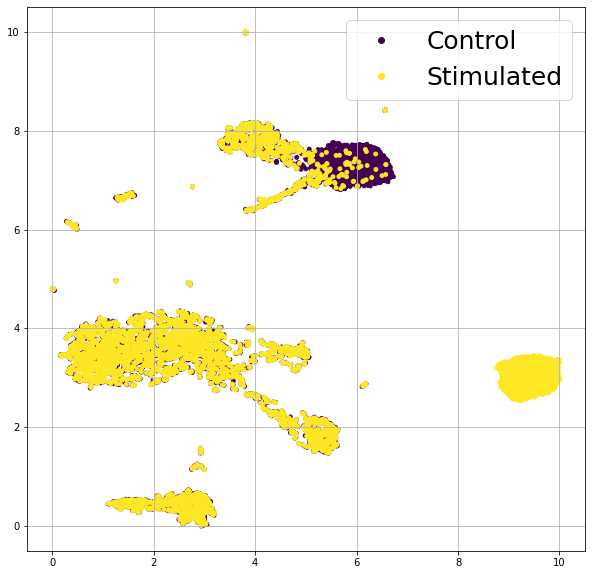

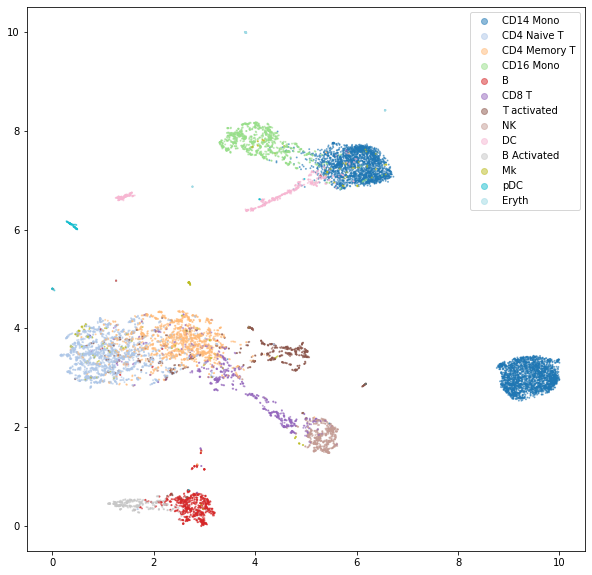

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13026/13096 [02:10<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


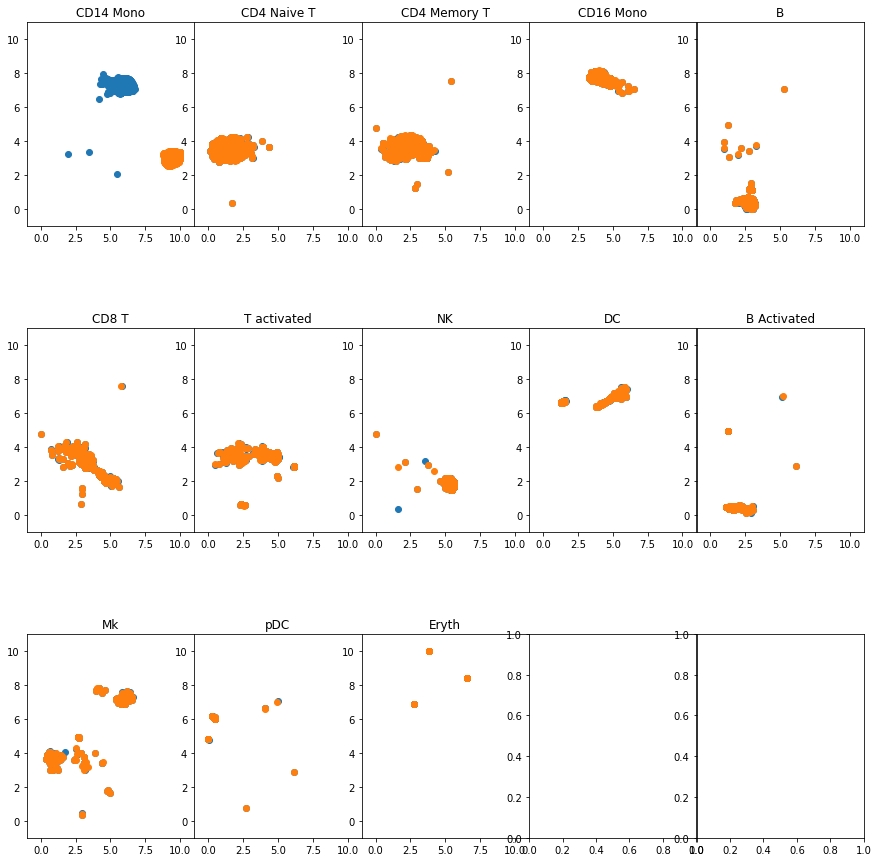

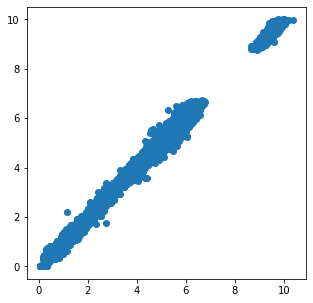

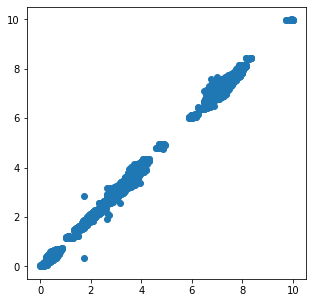

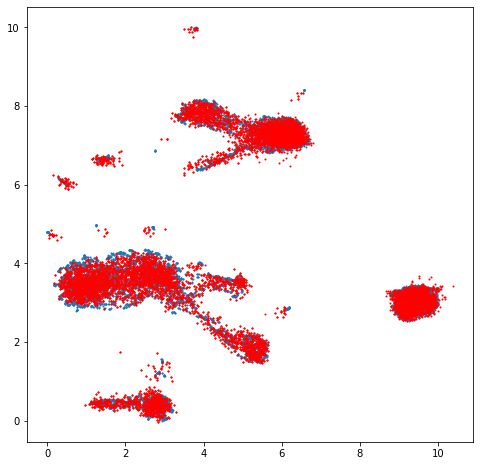

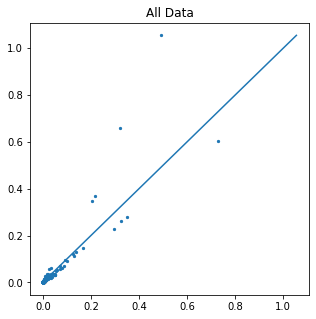

...

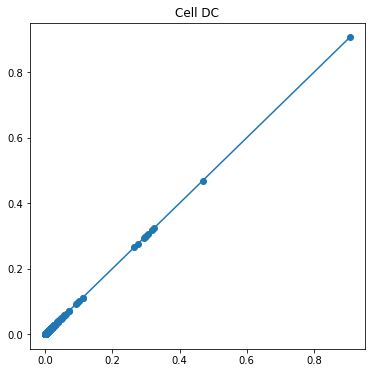

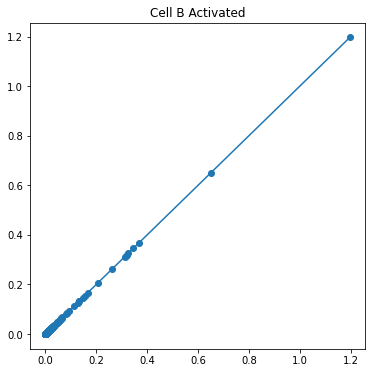

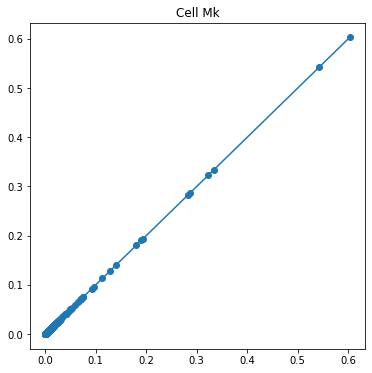

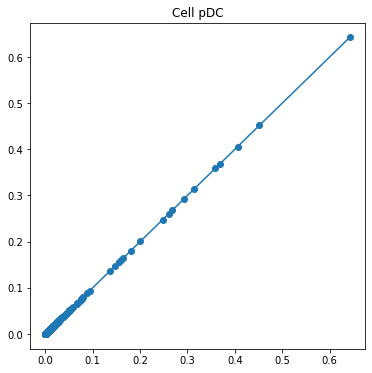

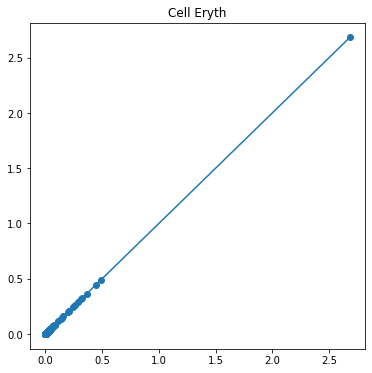

-------------------------------------------------------------------
35


Transforming to str index.


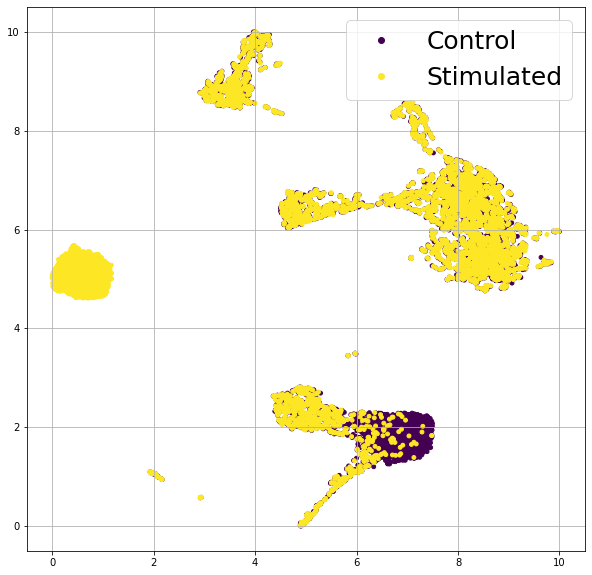

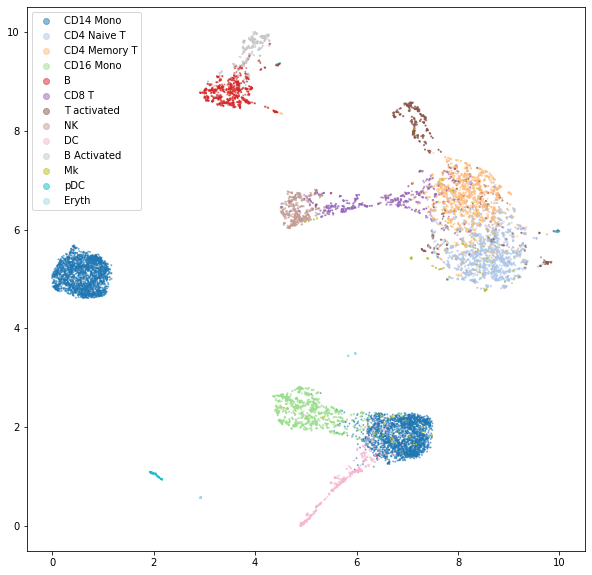

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13014/13096 [02:11<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


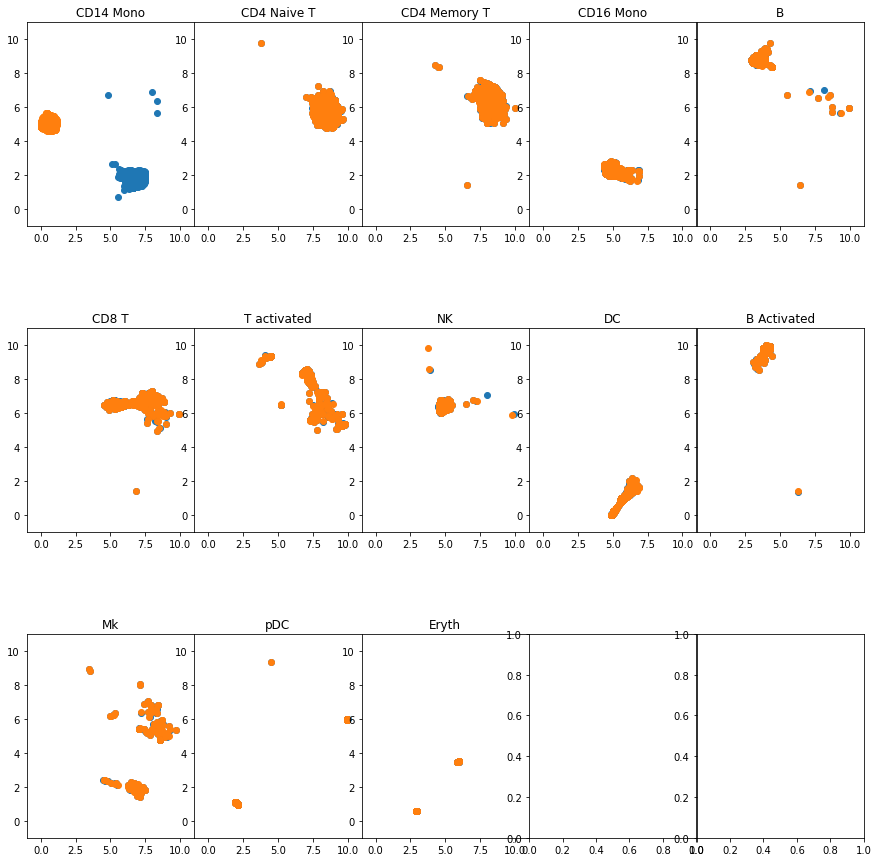

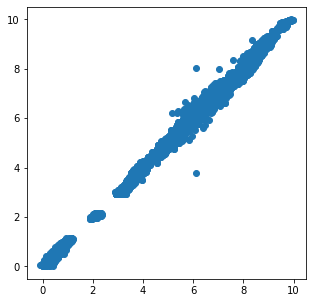

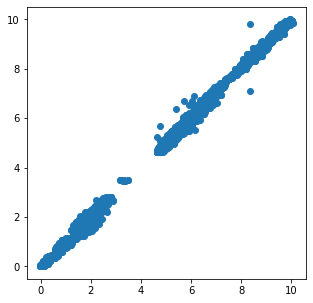

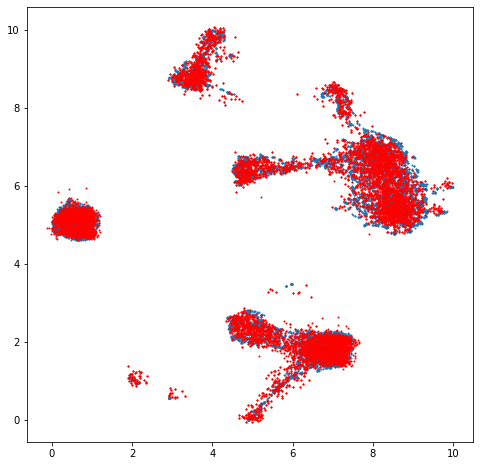

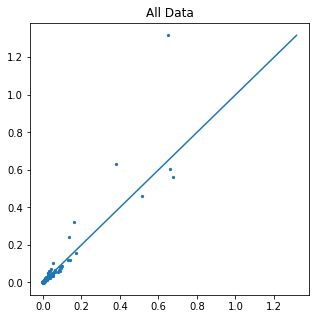

...

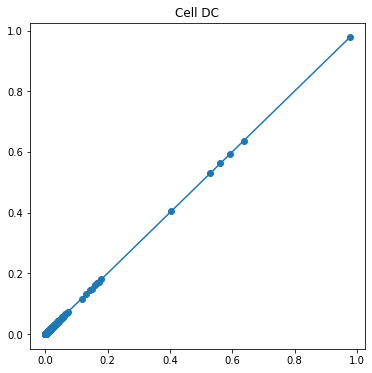

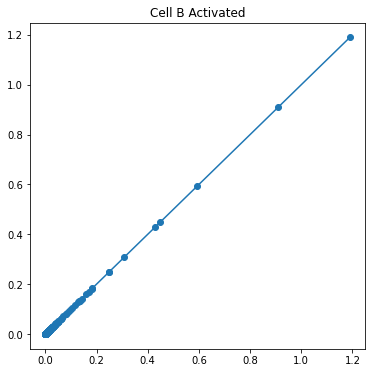

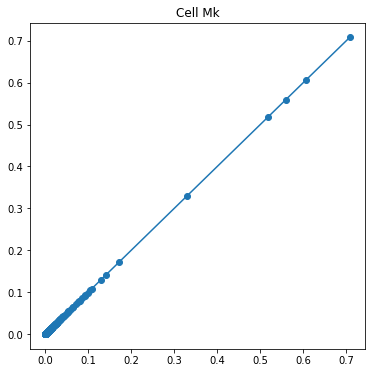

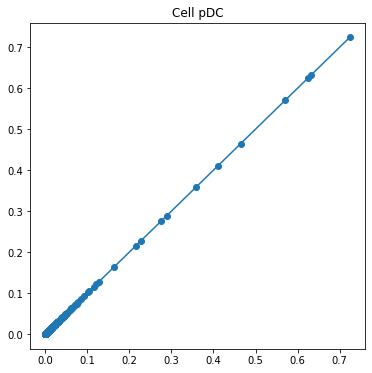

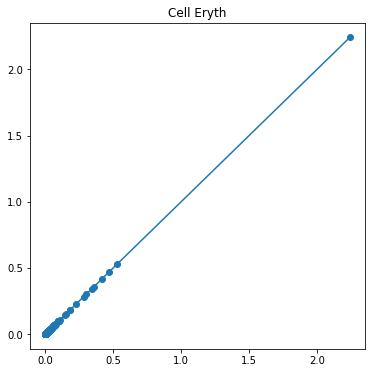

-------------------------------------------------------------------
40


Transforming to str index.


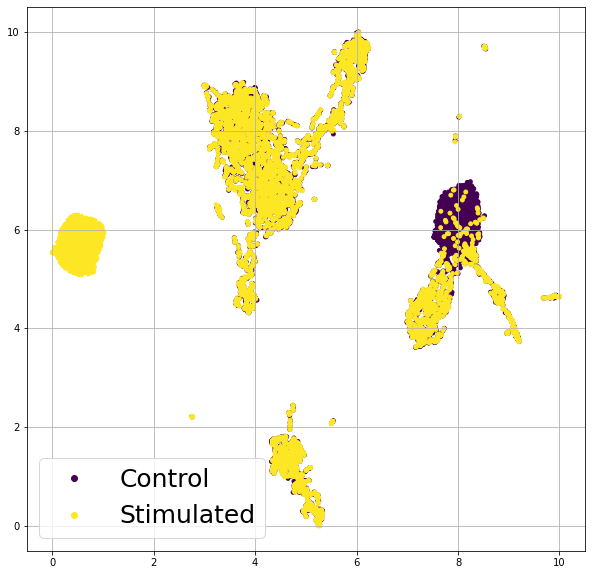

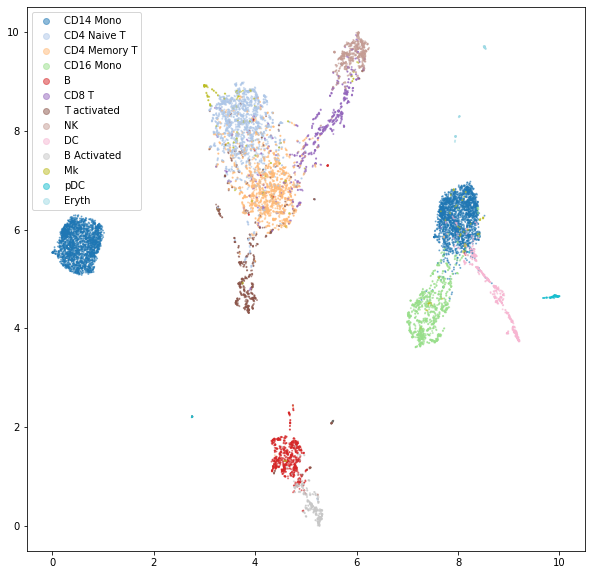

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 13028/13096 [02:13<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


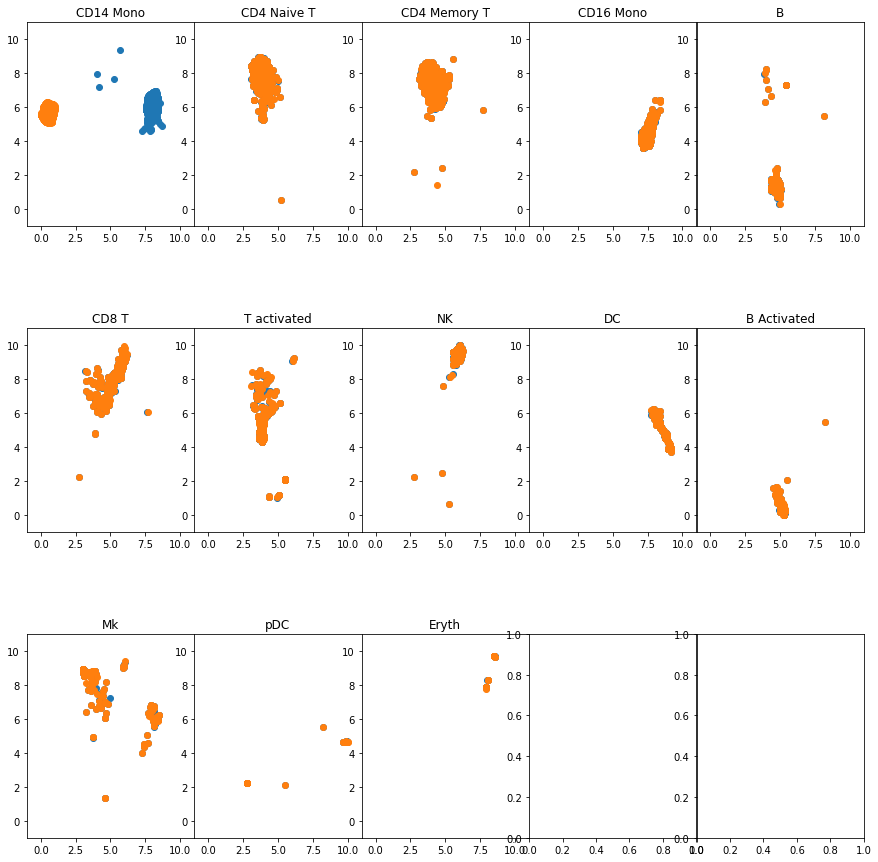

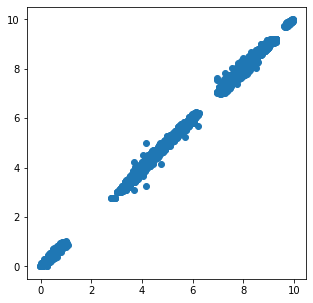

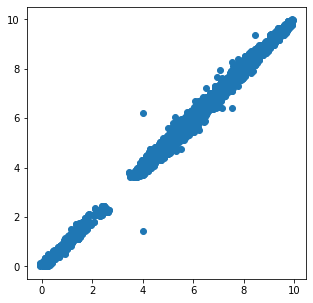

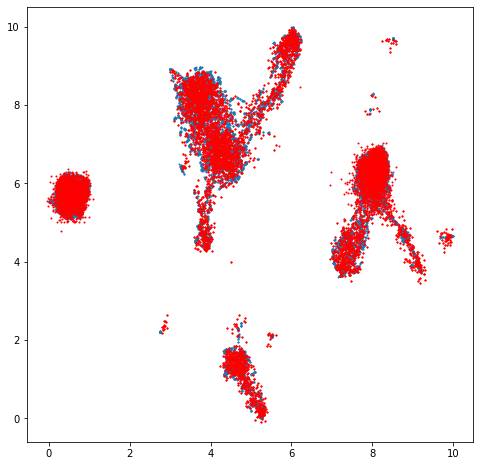

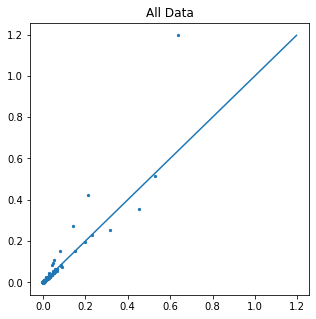

...

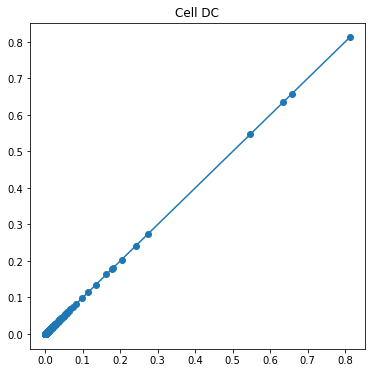

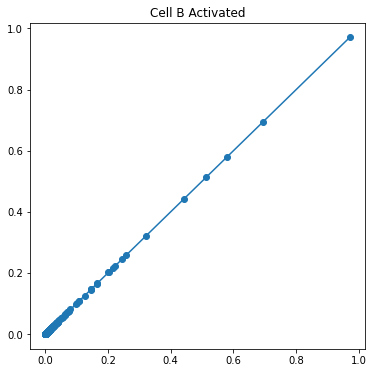

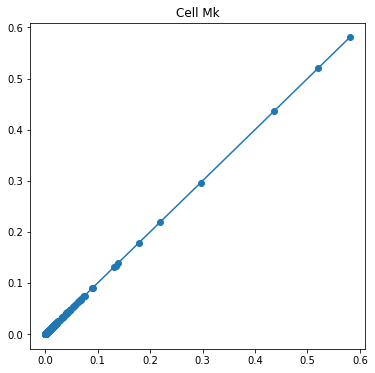

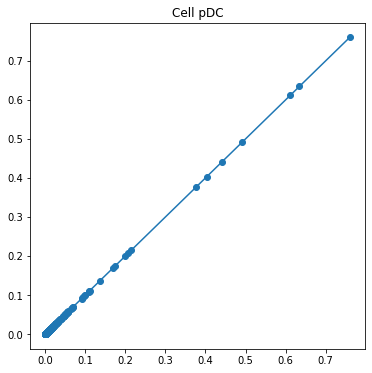

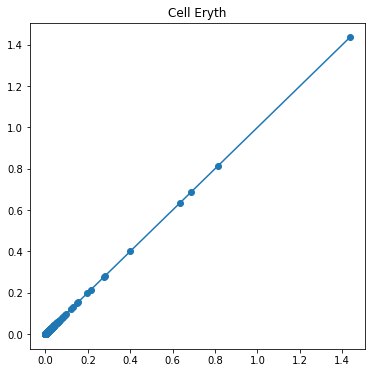

-------------------------------------------------------------------
45


Transforming to str index.


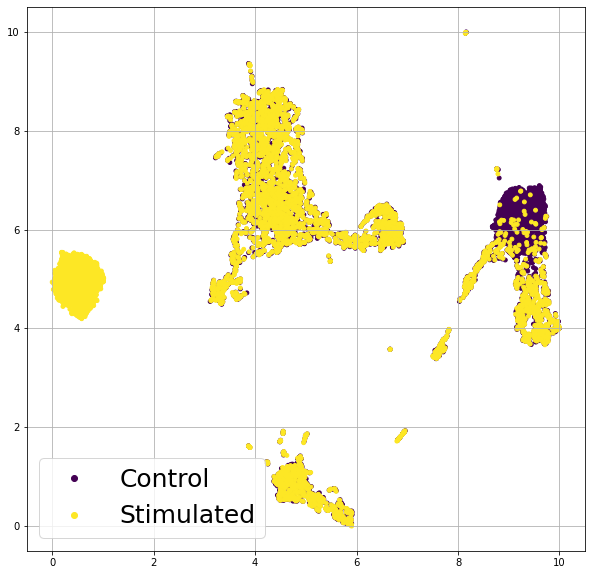

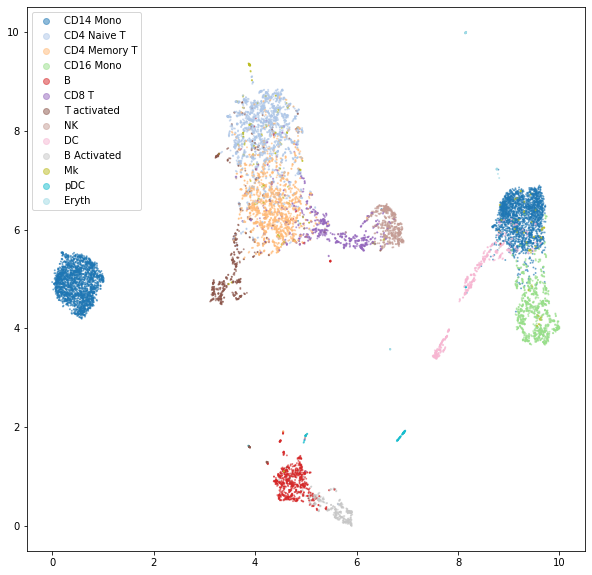

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
 99%|===================| 12993/13096 [02:07<00:01]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


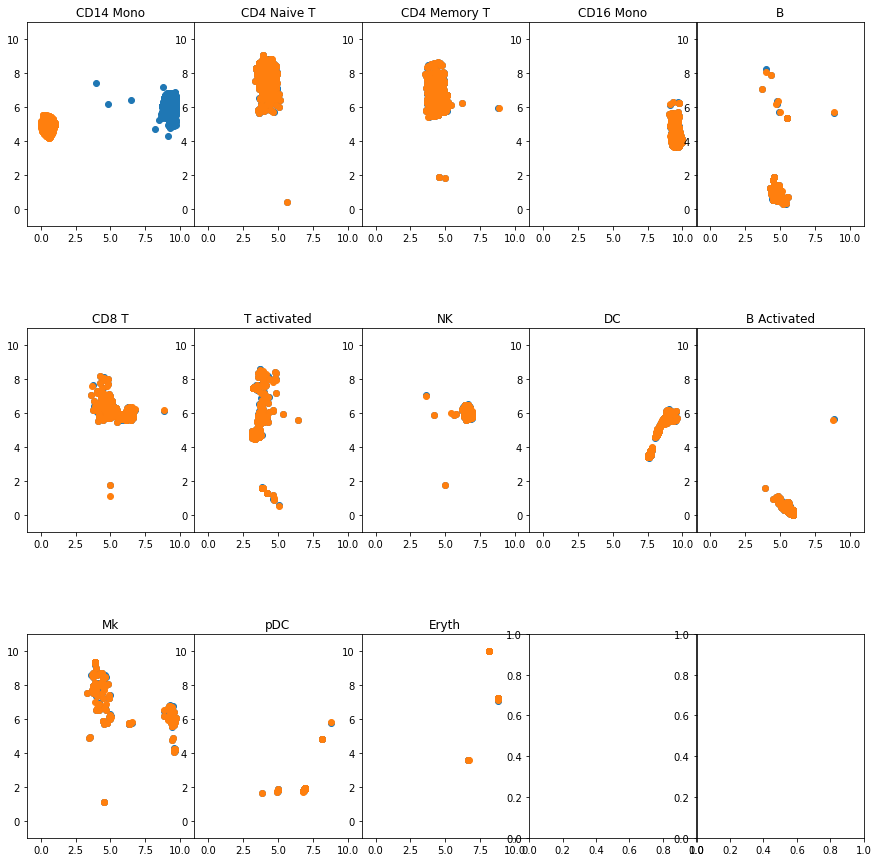

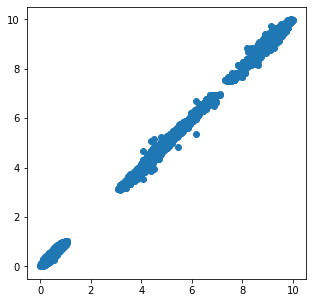

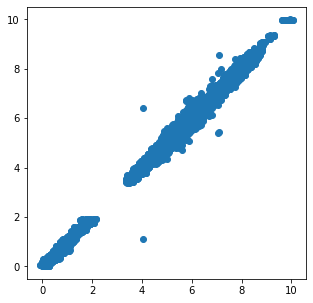

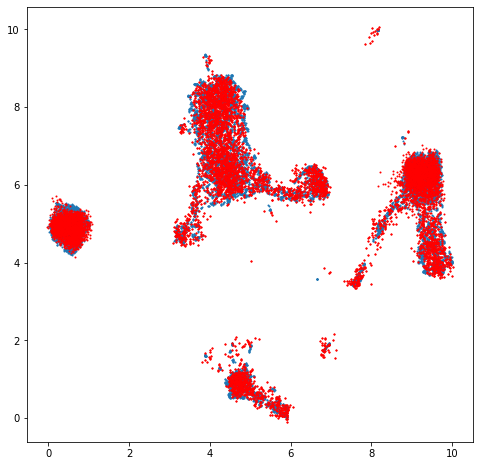

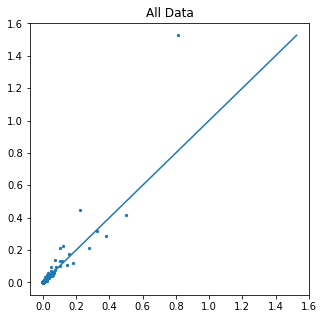

...

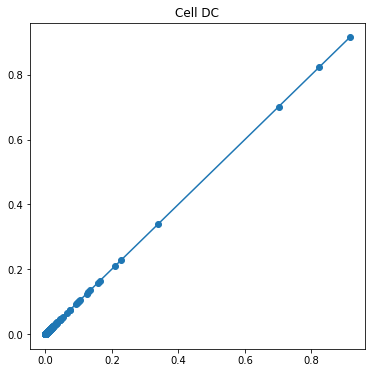

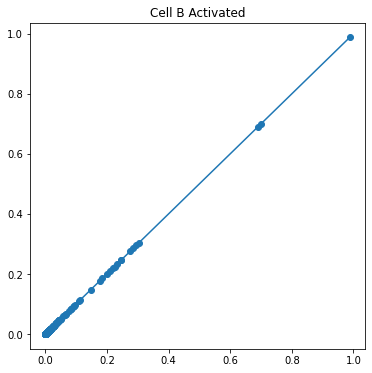

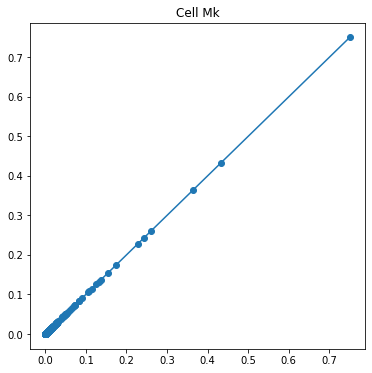

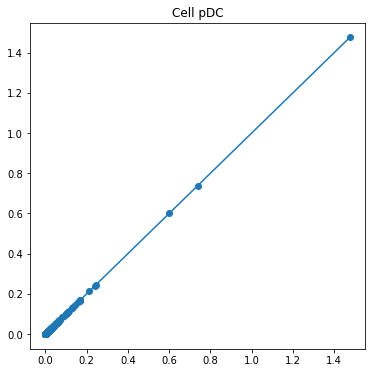

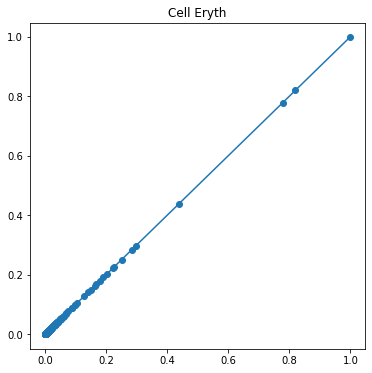

-------------------------------------------------------------------
50


Transforming to str index.


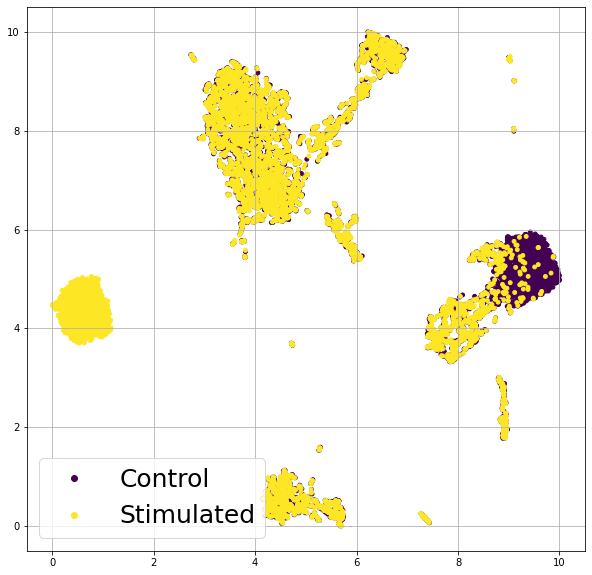

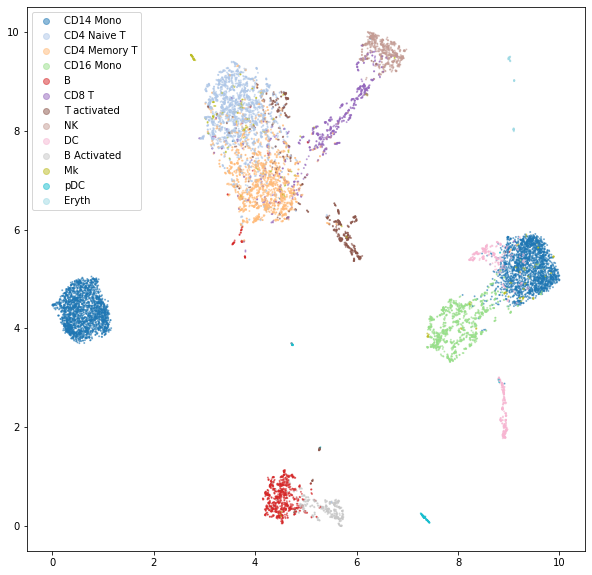

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption
100%|===================| 13067/13096 [02:12<00:00]        

(13096, 13744)
(6548, 13744) (6548, 13744)
[2208, 977, 860, 507, 406, 352, 300, 298, 265, 186, 115, 51, 23]


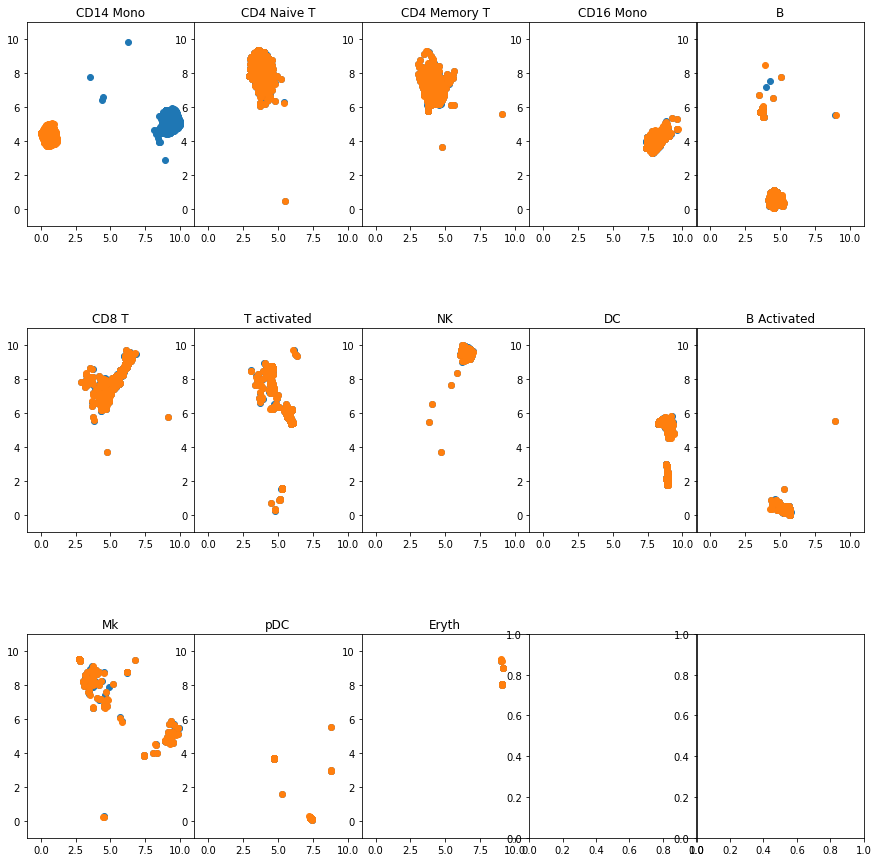

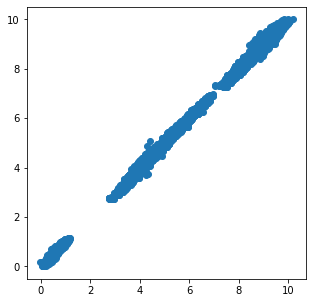

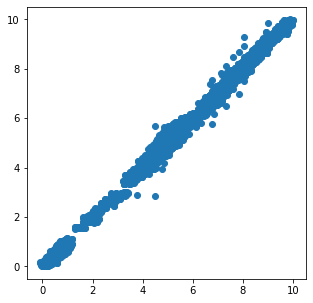

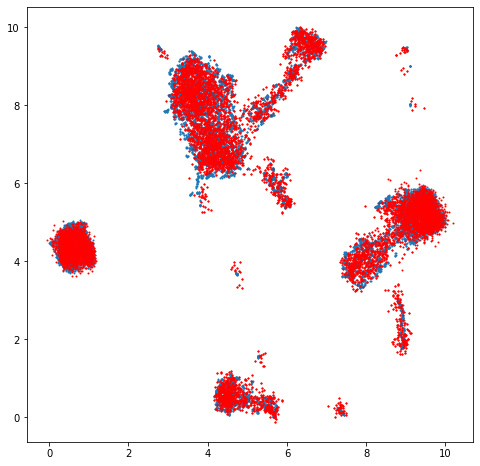

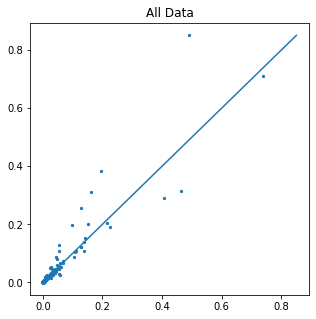

...

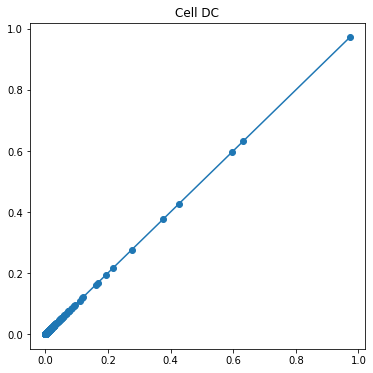

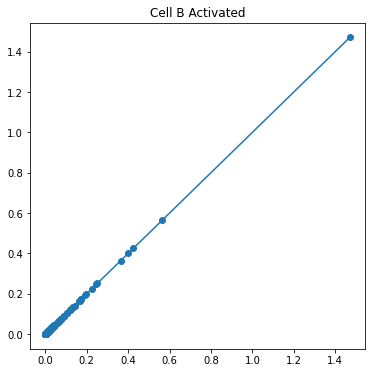

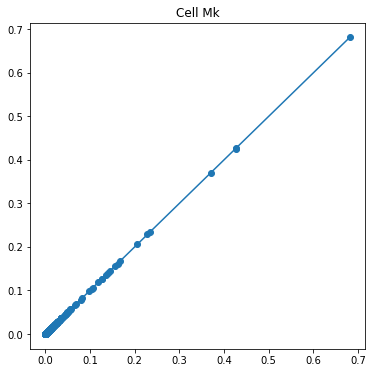

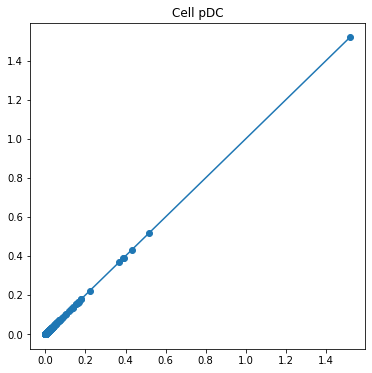

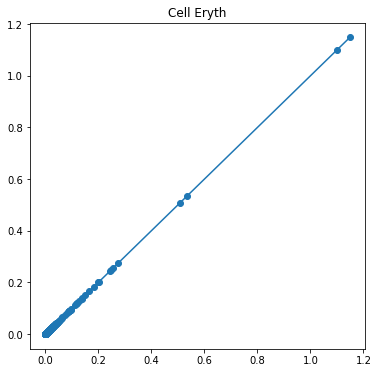

-------------------------------------------------------------------


is_categorical is deprecated and will be removed in a future version. Use is_categorical_dtype instead.


(6548, 2093) (6548, 2093) (6548, 11651) (6548, 11651)
1


Transforming to str index.


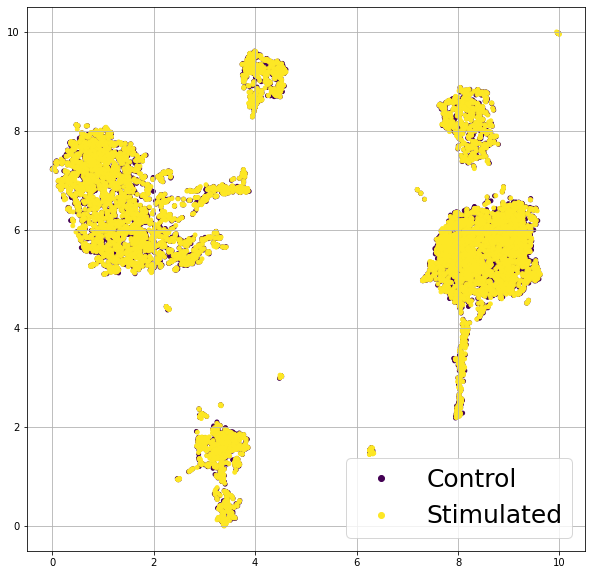

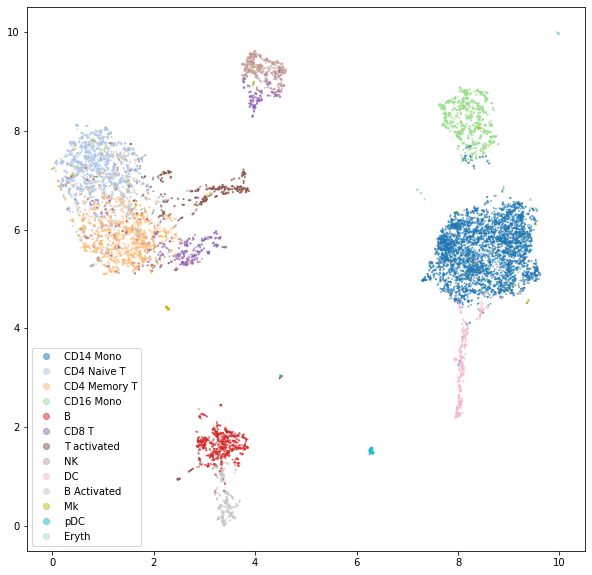

Use subset (sliced data) of np.ndarray is not recommended because it will generate extra copies and increase memory consumption


KeyboardInterrupt: 

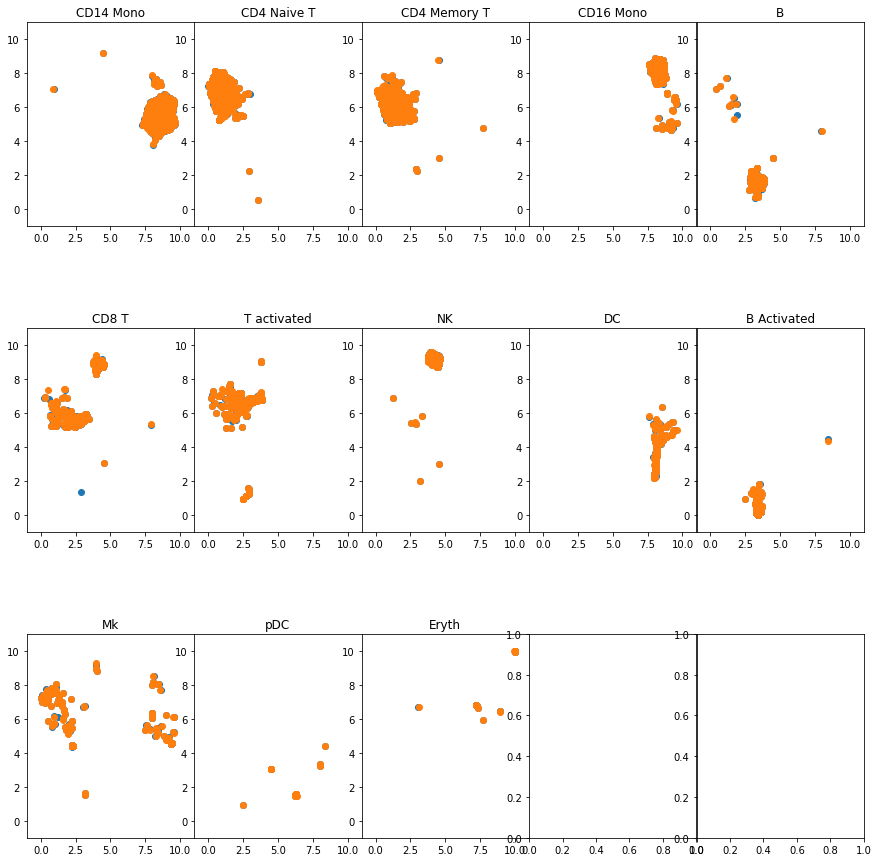

In [71]:
a,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
b,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)

union_hvg = np.intersect1d(a,b)
_,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
_,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)
adata_hvg_ctrl = adata_ctrl[:, idx_ctrl]
adata_hvg_stim = adata_stim[:, idx_stim]
adata_non_hvg_ctrl = adata_ctrl[:, np.array(non_hvg_idx)]
adata_non_hvg_stim = adata_stim[:, np.array(non_hvg_idx)]
print(adata_hvg_ctrl.shape,adata_hvg_stim.shape,adata_non_hvg_ctrl.shape,adata_non_hvg_stim.shape)

non_hvg = np.vstack((np.array(adata_non_hvg_ctrl.X),np.array(adata_non_hvg_stim.X)))
hvg = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
tmp_combined_df = np.hstack((hvg,non_hvg))
tmp_combined_df = pd.DataFrame(tmp_combined_df,columns=ordered_genes)

META_SCORES = []
META_GENES = []
CHANGED_GENES = []
NUM_GENES = []
for ml in range(5):
    a,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
    b,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)

    union_hvg = np.intersect1d(a,b)
    _,idx_ctrl,_=np.intersect1d(adata_ctrl.var.index,union_hvg,return_indices = True)
    _,idx_stim,_=np.intersect1d(adata_stim.var.index,union_hvg,return_indices = True)
    adata_hvg_ctrl = adata_ctrl[:, idx_ctrl]
    adata_hvg_stim = adata_stim[:, idx_stim]
    adata_non_hvg_ctrl = adata_ctrl[:, np.array(non_hvg_idx)]
    adata_non_hvg_stim = adata_stim[:, np.array(non_hvg_idx)]
    print(adata_hvg_ctrl.shape,adata_hvg_stim.shape,adata_non_hvg_ctrl.shape,adata_non_hvg_stim.shape)

    non_hvg = np.vstack((np.array(adata_non_hvg_ctrl.X),np.array(adata_non_hvg_stim.X)))
    hvg = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
    tmp_combined_df = np.hstack((hvg,non_hvg))
    tmp_combined_df = pd.DataFrame(tmp_combined_df,columns=ordered_genes)
    for num_genes in [1,5,10,15,20,25,30,35,40,45,50]:
        print(num_genes)
        NUM_GENES.append(num_genes)
        tmp_df = pd.DataFrame(adata_hvg_stim.X)

        #num_genes = 50
        gene_idx = np.random.randint(2093,size=num_genes)
        CHANGED_GENES.append(union_hvg[gene_idx])
        cd14_idx = np.where(control_labels == 0)[0]

        tmp_df = pd.DataFrame(adata_hvg_stim.X)
        for idx in gene_idx:
            for cd14 in cd14_idx:
                tmp_df.iloc[cd14,idx] = tmp_df.iloc[cd14,idx] + np.random.normal(1, 0.1) #+ med/50

        adata_hvg_stim = sc.AnnData(tmp_df)

        ##  STIM vs. UNSTIM STARTING POINT

        combined = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
        combined_df = pd.DataFrame(combined,columns=union_hvg)
        combined_df

        # PCA TRANSFORMATION
        pca = PCA(n_components=50)
        pca_emb = pca.fit_transform(combined_df)

        # UMAP TRANSFORMATION
        reducer = umap.UMAP(random_state=42)
        embedding = reducer.fit_transform(pca_emb)

        #Scaling so that min and max alwasys be 0 and 10 for both x and y axis
        scaler = MinMaxScaler()
        embedding = 10*scaler.fit_transform(embedding)

        c = [0 for i in range(adata_hvg_ctrl.shape[0])] + [1 for i in range(adata_hvg_stim.shape[0])]
        classes = ['Control','Stimulated']

        fig, ax = plt.subplots(figsize=(10,10))
        scatter = ax.scatter(embedding[:,0],embedding[:,1],c=c, s=15)
        plt.legend(handles=scatter.legend_elements()[0], labels=classes,fontsize=25)
        plt.grid(True)

        cell_classes = ["CD14 Mono","CD4 Naive T", "CD4 Memory T","CD16 Mono","B","CD8 T","T activated","NK","DC","B Activated", 
            "Mk", "pDC", "Eryth", "Mono/Mk Doublets"]

        seurat_labels = list(control_labels) + list(stimulated_labels)
        fig, ax = plt.subplots(figsize=(10,10))
        scatter = ax.scatter(embedding[:,0],embedding[:,1],c=seurat_labels, alpha = 0.5, s=1, cmap='tab20')
        plt.legend(handles=scatter.legend_elements()[0], labels=cell_classes)
        plt.show()
        ctrl_emb = embedding[:len(control_labels),:]
        stim_emb = embedding[len(control_labels):,:]

        ctrl_emb_pca = pca_emb[:len(control_labels),:]
        stim_emb_pca = pca_emb[len(control_labels):,:]

        unq_labels = np.unique(control_labels)
        fig, axs = plt.subplots(3,5, figsize=(15, 15), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .5, wspace=.001)

        axs = axs.ravel()

        for label in unq_labels:
            tmp_ctrl=ctrl_emb[control_labels == label,:]
            tmp_stim=stim_emb[stimulated_labels == label,:]

            axs[label].scatter(tmp_ctrl[:,0],tmp_ctrl[:,1])
            axs[label].scatter(tmp_stim[:,0],tmp_stim[:,1])
            axs[label].set_xlim(np.min(embedding,axis=0)[0]-1, np.max(embedding,axis=0)[0]+1)
            axs[label].set_ylim(np.min(embedding,axis=0)[1]-1, np.max(embedding,axis=0)[1]+1)
            axs[label].set_title(cell_classes[label])

        ### Fitting XGBoost with the bigger gene list 
        non_hvg = np.vstack((np.array(adata_non_hvg_ctrl.X),np.array(adata_non_hvg_stim.X)))
        hvg = np.vstack((np.array(adata_hvg_ctrl.X),np.array(adata_hvg_stim.X)))
        tmp_combined_df = np.hstack((hvg,non_hvg))
        tmp_combined_df = pd.DataFrame(tmp_combined_df,columns=ordered_genes)

        X = tmp_combined_df
        y0 = embedding[:,0]
        X_train, X_test, y_train, y_test = train_test_split(X.values, y0, test_size=0.2, random_state=5)

        model_x = XGBRegressor()
        model_x.fit(X.values, y0)

        predicted_x = model_x.predict(X.values)
        plt.figure(figsize=(5,5))
        plt.scatter(predicted_x, y0)
        mean_squared_error(predicted_x, y0)

        y1 = embedding[:,1]
        X_train, X_test, y_train, y_test = train_test_split(X.values, y1, test_size=0.2, random_state=5)

        model_y = XGBRegressor()
        model_y.fit(X.values, y1)
        predicted_y = model_y.predict(X.values)
        plt.figure(figsize=(5,5))
        plt.scatter(predicted_y, y1)
        mean_squared_error(predicted_y, y1)

        _, _, _, real_y = train_test_split(X.values, embedding, test_size=0.2, random_state=5)
        plt.figure(figsize=(8,8))
        plt.scatter(y0,y1,s=1)
        plt.scatter(predicted_x,predicted_y,c='r',s=1)

        # SHAP ANALYSIS on X
        explainer = shap.TreeExplainer(model_x,X.values)
        shap_value_x = explainer.shap_values(X.values)

        # # SHAP ANALYSIS on Y
        explainer = shap.TreeExplainer(model_y,X.values)
        shap_value_y = explainer.shap_values(X.values)

        comb_shap_values = np.sqrt((shap_value_x**2 + shap_value_y**2))
        print(comb_shap_values.shape)

        batch1_shap = comb_shap_values[:len(control_labels),:]
        batch2_shap = comb_shap_values[len(control_labels):,:]
        print(batch1_shap.shape, batch2_shap.shape)

        mean_feature1 = np.mean(batch1_shap,axis=0)
        mean_feature2 = np.mean(batch2_shap,axis=0)
        diag = np.linspace(0,np.max(np.concatenate([mean_feature1,mean_feature2])))
        plt.figure(figsize=(5,5))
        plt.scatter(mean_feature1,mean_feature2,s=5)
        plt.plot(diag,diag)
        plt.title('All Data')
        eval_score_sum(mean_feature1,mean_feature2)


        # Per Different Labels

        cell_num = []
        for label in unq_labels:
            a=np.sum(control_labels == label)
            b=np.sum(stimulated_labels == label)
            cell_num.append(min(a,b))
        print(cell_num)
        cell_orders = unq_labels[np.argsort(-1*np.array(cell_num))]

        fig, axs = plt.subplots(3,5, figsize=(15, 15), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .3, wspace=.2)
        axs = axs.ravel()
        scores_stunst1 = []
        for ct,label in enumerate(cell_orders):
            tmp_batch1_shap = batch1_shap[control_labels == label, :]
            tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]
            #print(len(tmp_batch1_shap),len(tmp_batch2_shap))

            tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
            tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

            score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
            scores_stunst1.append(score)
            cap = max(np.max(tmp_mean_feature1), np.max(tmp_mean_feature2)) + 0.3
            diag = np.linspace(0,cap)
            axs[ct].scatter(tmp_mean_feature1,tmp_mean_feature2)
            axs[ct].plot(diag,diag)
            axs[ct].set_xlim(0,cap)
            axs[ct].set_ylim(0,cap)
            axs[ct].set_title(cell_classes[label]+' \n ' + str(score),fontsize=15)

        axs[13].set_axis_off()
        axs[14].set_axis_off()
        META_SCORES.append(scores_stunst1)
        from tqdm import tqdm

        comb_label = list(control_labels) + list(stimulated_labels)

    #     LABEL_SCORES_COMB = []
    #     for label in tqdm(cell_orders):
    #         label_score = []
    #         for i in range(100):
    #             tmp_batch = comb_shap_values[np.array(comb_label) == label, :]

    #             tmp_batch1_shap = tmp_batch[np.random.randint(0, tmp_batch.shape[0],int(tmp_batch.shape[0]/2)),:]
    #             tmp_batch2_shap = tmp_batch[np.random.randint(0, tmp_batch.shape[0],int(tmp_batch.shape[0]/2)),:]

    #             tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
    #             tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

    #             score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
    #             label_score.append(score)
    #         LABEL_SCORES_COMB.append(label_score)

    #     ct = 0

    #     fig, axs = plt.subplots(3,5, figsize=(15, 10), facecolor='w', edgecolor='k')
    #     fig.subplots_adjust(hspace = .5, wspace=.4)
    #     axs = axs.ravel()

    #     for scores in LABEL_SCORES_COMB:
    #         axs[ct].hist(scores)
    #         tmp = scores + [scores_stunst1[ct]]
    #         zscores = stats.zscore(tmp)
    #         p_values = 1 - scipy.special.ndtr(zscores)
    #         axs[ct].set_title('{} \n p_val:{}'.format(cell_classes[cell_orders[ct]],'{:.1e}'.format(p_values[-1])),fontsize=20)
    #     #     axs[ct].set_title('{} \n p_val:{}'.format(cell_classes[cell_orders[ct]],str(p_values[-1])[:5]),fontsize=18)

    #         axs[ct].set_xlim([min(scores),scores_stunst1[ct] + 0.2])
    #         axs[ct].axvline(scores_stunst1[ct], color='r', linestyle='dashed', linewidth=3)
    #         ct += 1

    #     axs[13].set_axis_off()
    #     axs[14].set_axis_off()

    #     mean_perms = []
    #     for scores in LABEL_SCORES_COMB:
    #         mean_perms.append(np.nanmean(scores))

    #     fig, axs = plt.subplots(3,5, figsize=(15, 10), facecolor='w', edgecolor='k')
    #     fig.subplots_adjust(hspace = .5, wspace=.4)
    #     axs = axs.ravel()
    #     scores_stunst1 = []
    #     for ct,label in enumerate(cell_orders):
    #         tmp_batch1_shap = batch1_shap[control_labels == label, :]
    #         tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]
    #         #print(len(tmp_batch1_shap),len(tmp_batch2_shap))

    #         tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
    #         tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)

    #         score = eval_score_sum(tmp_mean_feature1, tmp_mean_feature2)
    #         #scores_stunst1.append(score)
    #         cap = max(np.max(tmp_mean_feature1), np.max(tmp_mean_feature2)) + 0.3
    #         diag = np.linspace(0,cap)
    #         axs[ct].scatter(tmp_mean_feature1,tmp_mean_feature2)
    #         axs[ct].plot(diag,diag)
    #         axs[ct].set_xlim(0,cap)
    #         axs[ct].set_ylim(0,cap)
    #         axs[ct].set_title(cell_classes[label]+'\n' + str(np.round(score-mean_perms[ct],2)),fontsize=22)
    #         scores_stunst1.append(score-mean_perms[ct])
    #     axs[13].set_axis_off()
    #     axs[14].set_axis_off()
        #META_SCORES.append(scores_stunst1)
        unq_labels = np.unique(control_labels)
        scores = []
        gene_ranks = []
        for label in unq_labels:

            tmp_batch1_shap = batch1_shap[control_labels == label, :]
            tmp_batch2_shap = batch2_shap[stimulated_labels == label, :]

            tmp_mean_feature1 = np.mean(tmp_batch1_shap,axis=0)
            tmp_mean_feature2 = np.mean(tmp_batch2_shap,axis=0)
            diag = np.linspace(0,np.max(np.concatenate([tmp_mean_feature1, tmp_mean_feature2])))
            plt.figure(figsize=(6,6))
            plt.scatter(tmp_mean_feature1,tmp_mean_feature2)
            plt.plot(diag,diag)
            plt.title('Cell {}'.format(cell_classes[label]))
            plt.show()

            diff = np.abs(tmp_mean_feature1 + tmp_mean_feature2)
            score_by_feat = np.around(np.sum(diff),3)
            scores.append(score_by_feat)

            #print('TOP DIFFERENTIAL GENES : {}'.format(intersect[np.argsort(np.abs(tmp_mean_feature1 + tmp_mean_feature2))[-25:]]))

            if label == 0:
                gene_ranks.append(np.array(ordered_genes)[np.argsort(np.abs(tmp_mean_feature1 + tmp_mean_feature2))])
        META_GENES.append(gene_ranks)
        print('-------------------------------------------------------------------')

In [76]:
tmp = np.array(META_SCORES)
tmp.shape

(44, 13)

In [91]:
np.unique(NUM_GENES)

array([ 1,  5, 10, 15, 20, 25, 30, 35, 40, 45, 50])

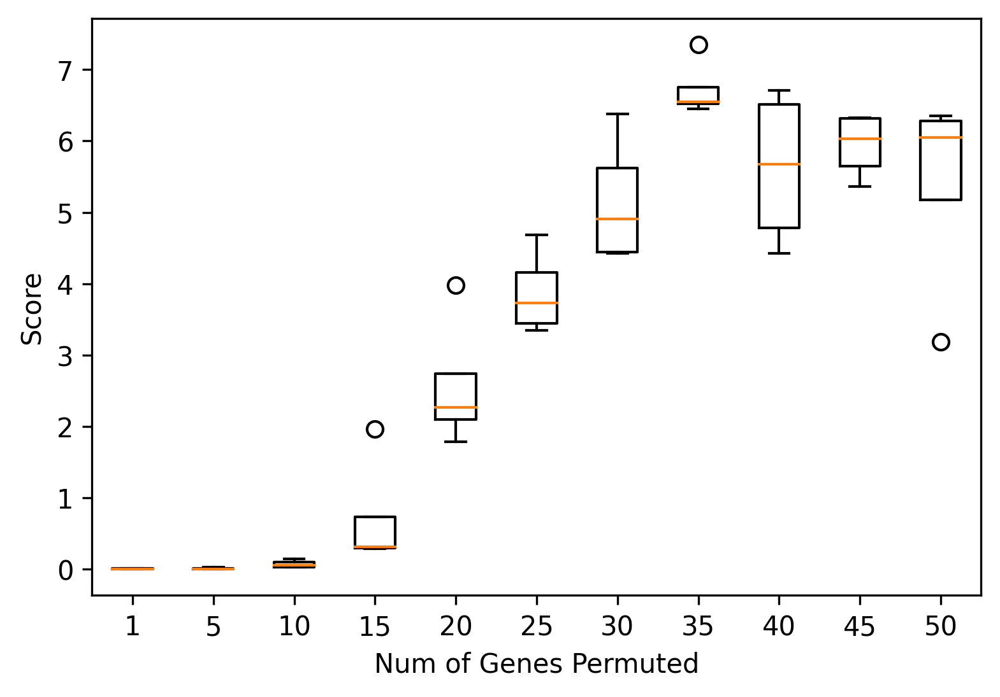

In [93]:
BP = []
for ng in np.unique(NUM_GENES):
    BP.append(tmp[np.where(np.array(NUM_GENES) == ng)[0],0])
plt.figure(dpi=300)
plt.boxplot(BP)
plt.ylabel('Score')
plt.xticks(np.arange(len(RANKS))+1,[1,5,10,15,20,25,30,35,40,45,50])
plt.xlabel('Num of Genes Permuted')
plt.show()


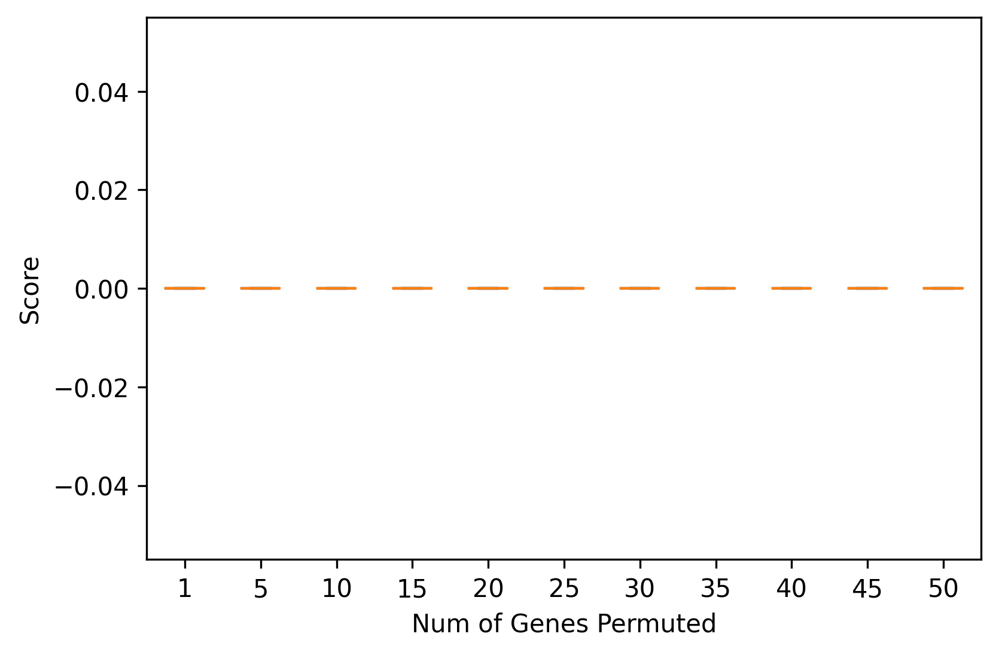

In [94]:
BP2 = []
for ng in np.unique(NUM_GENES):
    BP2.append(tmp[np.where(np.array(NUM_GENES) == ng)[0],1])
plt.figure(dpi=300)
plt.boxplot(BP2)
plt.ylabel('Score')
plt.xticks(np.arange(len(RANKS))+1,[1,5,10,15,20,25,30,35,40,45,50])
plt.xlabel('Num of Genes Permuted')
plt.show()
